In [1]:
import pandas as pd  
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.optimize as sco
import os
import plotly.graph_objects as go
from itertools import combinations
from sklearn.preprocessing import StandardScaler
from pathlib import Path

scaler = StandardScaler()

desired_path="/k_means_cluster_analysis/Results_with_sentiment/cluster_df_cl4/"

qtfilename="_qt_result.csv"

path = Path(os.getcwd())

dir1=path.parent.parent.parent.parent

final_path=str(dir1)+desired_path

## Efficient Frontier portfolio allocation technique.

In [2]:
def portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len):
    returns = np.sum(mean_returns*weights ) * df_len
    std = np.sqrt(np.dot(weights.T, np.dot(cov_matrix, weights))) * np.sqrt(df_len)
    return std, returns

def random_portfolios(num_portfolios, mean_returns, cov_matrix, risk_free_rate, stocks_len, df_len):
    results = np.zeros((3,num_portfolios))
    weights_record = []
    for i in range(num_portfolios):
        weights = np.random.random(stocks_len)
        weights /= np.sum(weights)
        weights_record.append(weights)
        portfolio_std_dev, portfolio_return_var = portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)
        results[0,i] = portfolio_std_dev
        results[1,i] = portfolio_return_var
        results[2,i] = (portfolio_return_var - risk_free_rate) / portfolio_std_dev
        
    #max_sharpe = max(results[2])
    #for i in range(len(results[2])):
        #if results[2, i] == max_sharpe:
            #print("index {} and weights are {} max sharpe value {}".format(i, weights_record[i], max_sharpe))
            
    return results, weights_record

def pos_sharpe_ratio(weights, mean_returns, cov_matrix, risk_free_rate, df_len):
    p_var, p_ret = portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)
    return (p_ret - risk_free_rate) / p_var

def neg_sharpe_ratio(weights, mean_returns, cov_matrix, risk_free_rate, df_len):
    p_var, p_ret = portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)
    return -(p_ret - risk_free_rate) / p_var

def max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, df_len):
    num_assets = len(mean_returns)
    args = (mean_returns, cov_matrix, risk_free_rate, df_len)
    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
    bound = (0.0,1.0)
    bounds = tuple(bound for asset in range(num_assets))
    result = sco.minimize(neg_sharpe_ratio, num_assets*[1./num_assets,], args=args,
                        method='SLSQP', bounds=bounds, constraints=constraints)
    return result

def portfolio_volatility(weights, mean_returns, cov_matrix, df_len): 
    return portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)[0]

def min_variance(mean_returns, cov_matrix, df_len):
    num_assets = len(mean_returns)
    args = (mean_returns, cov_matrix, df_len)
    constraints = ({'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
    bound = (0.0,1.0)
    bounds = tuple(bound for asset in range(num_assets))

    result = sco.minimize(portfolio_volatility, num_assets*[1./num_assets,], args=args,
                        method='SLSQP', bounds=bounds, constraints=constraints)

    return result

def efficient_return(mean_returns, cov_matrix, target, df_len):
    num_assets = len(mean_returns)
    args = (mean_returns, cov_matrix, df_len)
    
    def portfolio_return(weights, df_len):
        return portfolio_annualised_performance(weights, mean_returns, cov_matrix, df_len)[1]

    constraints = ({'type': 'eq', 'fun': lambda x: portfolio_return(x, df_len) - target},
                   {'type': 'eq', 'fun': lambda x: np.sum(x) - 1})
    bounds = tuple((0,1) for asset in range(num_assets))
    result = sco.minimize(portfolio_volatility, num_assets*[1./num_assets,], args=args, method='SLSQP', bounds=bounds, constraints=constraints)
    return result


def efficient_frontier(mean_returns, cov_matrix, returns_range, df_len):
    efficients = []
    for ret in returns_range:
        efficients.append(efficient_return(mean_returns, cov_matrix, ret, df_len))
    return efficients


def display_calculated_ef_with_random(mean_returns, cov_matrix, num_portfolios, risk_free_rate, table, stocks_len, df_len):
    results, _ = random_portfolios(num_portfolios,mean_returns, cov_matrix, risk_free_rate, stocks_len, df_len)
    #print("results == \n", max(results[2]))
    max_sharpe = max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, df_len) 
    pos_sharpe = pos_sharpe_ratio(max_sharpe['x'], mean_returns, cov_matrix, risk_free_rate, df_len)
    #print("pos_sharpe == \n", pos_sharpe)
    
    sdp, rp = portfolio_annualised_performance(max_sharpe['x'], mean_returns, cov_matrix, df_len)
    max_sharpe_allocation = pd.DataFrame(max_sharpe.x,index=table.columns,columns=['allocation'])
    max_sharpe_allocation.allocation = [round(i*100,2)for i in max_sharpe_allocation.allocation]
    max_sharpe_allocation = max_sharpe_allocation.T
    max_sharpe_allocation

    min_vol = min_variance(mean_returns, cov_matrix, df_len)
    sdp_min, rp_min = portfolio_annualised_performance(min_vol['x'], mean_returns, cov_matrix, df_len)
    min_vol_allocation = pd.DataFrame(min_vol.x,index=table.columns,columns=['allocation'])
    min_vol_allocation.allocation = [round(i*100,2)for i in min_vol_allocation.allocation]
    min_vol_allocation = min_vol_allocation.T
    
    print("-"*80)
    print( "Maximum Sharpe Ratio Portfolio Allocation\n")
    print( "Annualised Return:", round(rp,2))
    print( "Annualised Volatility:", round(sdp,2))
    print ("\n")
    print (max_sharpe_allocation)
    print( "-"*80)
    print ("Minimum Volatility Portfolio Allocation\n")
    print( "Annualised Return:", round(rp_min,2))
    print( "Annualised Volatility:", round(sdp_min,2))
    print ("\n")
    print (min_vol_allocation)
    
    plt.figure(figsize=(10, 7))
    plt.scatter(results[0,:],results[1,:],c=results[2,:],cmap='YlGnBu', marker='o', s=10, alpha=0.3)
    plt.colorbar()
    plt.scatter(sdp,rp,marker='*',color='r',s=500, label='Maximum Sharpe ratio')
    plt.scatter(sdp_min,rp_min,marker='*',color='g',s=500, label='Minimum volatility')

    target = np.linspace(rp_min, 0.32, 50)
    efficient_portfolios = efficient_frontier(mean_returns, cov_matrix, target, df_len)
    plt.plot([p['fun'] for p in efficient_portfolios], target, linestyle='-.', color='black', label='efficient frontier')
    plt.title('Calculated Portfolio Optimization based on Efficient Frontier')
    plt.xlabel('annualised volatility')
    plt.ylabel('annualised returns')
    plt.legend(labelspacing=0.8)
    plt.show()
    return (pos_sharpe, round(rp,2), round(sdp,2), max_sharpe_allocation.values)


def display_ef_with_selected(mean_returns, cov_matrix, risk_free_rate,table, df_len):
    returns = table.pct_change()
    max_sharpe = max_sharpe_ratio(mean_returns, cov_matrix, risk_free_rate, df_len)
    #print("Max Sharpe ==\n", max_sharpe)
    sdp, rp = portfolio_annualised_performance(max_sharpe['x'], mean_returns, cov_matrix, df_len)
    max_sharpe_allocation = pd.DataFrame(max_sharpe.x,index=table.columns,columns=['allocation'])
    max_sharpe_allocation.allocation = [round(i*100,2)for i in max_sharpe_allocation.allocation]
    max_sharpe_allocation = max_sharpe_allocation.T
    max_sharpe_allocation
    

    min_vol = min_variance(mean_returns, cov_matrix, df_len)
    sdp_min, rp_min = portfolio_annualised_performance(min_vol['x'], mean_returns, cov_matrix, df_len)
    min_vol_allocation = pd.DataFrame(min_vol.x,index=table.columns,columns=['allocation'])
    min_vol_allocation.allocation = [round(i*100,2)for i in min_vol_allocation.allocation]
    min_vol_allocation = min_vol_allocation.T
    
    an_vol = np.std(returns) * np.sqrt(df_len)
    an_rt = mean_returns * df_len
    
    print ("-"*80)
    print ("Individual Stock Returns and Volatility\n")
    for i, txt in enumerate(table.columns):
        print (txt,":","annuaised return",round(an_rt[i],2),", annualised volatility:",round(an_vol[i],2))
    print ("-"*80)
    
    fig, ax = plt.subplots(figsize=(10, 7))
    ax.scatter(an_vol,an_rt,marker='o',s=200)

    for i, txt in enumerate(table.columns):
        ax.annotate(txt, (an_vol[i],an_rt[i]), xytext=(10,0), textcoords='offset points')
    ax.scatter(sdp,rp,marker='*',color='r',s=500, label='Maximum Sharpe ratio')
    ax.scatter(sdp_min,rp_min,marker='*',color='g',s=500, label='Minimum volatility')

    target = np.linspace(rp_min, 0.34, 50)
    efficient_portfolios = efficient_frontier(mean_returns, cov_matrix, target, df_len)
    ax.plot([p['fun'] for p in efficient_portfolios], target, linestyle='-.', color='black', label='efficient frontier')
    ax.set_title('Portfolio Optimization with Individual Stocks')
    ax.set_xlabel('annualised volatility')
    ax.set_ylabel('annualised returns')
    ax.legend(labelspacing=0.8)
    plt.show()

# display_calculated_ef_with_random(mean_returns, cov_matrix, num_portfolios, risk_free_rate)
# call this for different portfolios
# display_ef_with_selected(mean_returns, cov_matrix, risk_free_rate)
# call this for the companies selected for the portfolio

def efficient_frontier_stock_portfolio(stocks, stocks_len, risk_free_rate_in, start_date, end_date):
    data_temp = pd.read_csv('../../../../../Data-Acquisition/ohlcv-data/ohlcv.csv') 
    #print(data_temp)
    data_temp["time"] = pd.to_datetime(data_temp.time, format='%d/%m/%Y')
    start_date = pd.to_datetime(start_date)
    end_date = pd.to_datetime(end_date)
    data = data_temp[(data_temp["time"] >= start_date) & (data_temp["time"]< end_date)]
    #print(data)
    data["time"] = pd.to_datetime(data.time, format='%d/%m/%Y')
    data = data[['time','adjusted_close', 'symbol']]
    data = data.rename(columns={'time': 'date', 'adjusted_close': 'adj_close', 'symbol': 'ticker'})
    data = data[data['ticker'].isin(stocks)]
    #print(data)
    df_len = len(data.groupby("date"))
    #print("\nShape of the df {}, df len {}".format(df_len,data.shape))

    df = data.set_index('date')
    table = df.pivot(columns='ticker')
    # By specifying col[1] in below list comprehension
    # You can select the stock names under multi-level column
    table.columns = [col[1] for col in table.columns]
    table.head()

    plt.figure(figsize=(16, 9))
    for c in table.columns.values:
        plt.plot(table.index, table[c], lw=2, alpha=0.8,label=c)
    plt.legend(loc='upper right', fontsize=12)
    plt.ylabel('price in $')
    plt.title('Stocks Closing price in $')
    plt.show()

    returns = table.pct_change()
    plt.figure(figsize=(14, 7))
    for c in returns.columns.values:
        plt.plot(returns.index, returns[c], lw=3, alpha=0.8,label=c)
    plt.legend(loc='upper left', fontsize=12)
    plt.ylabel('daily returns')
    plt.title('Stocks Closing daily returns variation')
    plt.show()
    
    returns = table.pct_change()
    mean_returns = returns.mean()
    cov_matrix = returns.cov()
    num_portfolios = 25000
    risk_free_rate = 0.0095
    

    pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights = display_calculated_ef_with_random(mean_returns, cov_matrix, num_portfolios, risk_free_rate, table, stocks_len, df_len)
    display_ef_with_selected(mean_returns, cov_matrix, risk_free_rate, table, df_len)
    
    return (pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights)

In [3]:
def check_cor_cov_relation(covariance, correlation, mean_covariance, stocks):
    paired_stocks = np.zeros(covariance.shape)

    for i in range(len(stocks)):
        for j in range(len(stocks)-i):
            if(covariance[i,j] > mean_covariance[i] or covariance[i,j] > mean_covariance[j] or correlation[i][j]>0.5):
                paired_stocks[i,j] = 0
            else:
                paired_stocks[i,j] = 1

    return paired_stocks

In [4]:
def stocks_pair_lookup(stockspair, stocks_range_values, paired_stocks):
    nostockspair = []
    for i in stocks_range_values:
        if(i not in stockspair):
            nostockspair.append(i)
        else:
            continue
            
    for stock_ticker in nostockspair:
        cummulative_stockpair = len(stockspair)
        for i in stockspair:
            if(paired_stocks[stock_ticker,i]!=1 or paired_stocks[i,stock_ticker]!=1):
                cummulative_stockpair -= 1
        if(float(cummulative_stockpair)/len(stockspair) > 0.5):
            stockspair.add(stock_ticker)              
    return stockspair

In [5]:
def make_company_portfolios(stocks_combination, stocks_range, paired_stocks, portfolio_collection):  
    stockpair = set(stocks_combination)
    stockpair = stocks_pair_lookup(stockpair, stocks_range, paired_stocks)
    if stockpair not in portfolio_collection:
        portfolio_collection.append(stockpair)
    return portfolio_collection

In [6]:
def generate_portfolio_pairs(stocks):
    print(stocks)
    data = pd.read_csv('../../../../../Data-Acquisition/ohlcv-data/ohlcv.csv')  
    data["time"] = pd.to_datetime(data.time, format='%d/%m/%Y')
    data = data[['time','adjusted_close', 'symbol']]
    data = data.rename(columns={'time': 'date', 'adjusted_close': 'adj_close', 'symbol': 'ticker'})
    data = data[data['ticker'].isin(stocks)]

    df = data.set_index('date')
    table = df.pivot(columns='ticker')
    # By specifying col[1] in below list comprehension
    # You can select the stock names under multi-level column
    table.columns = [col[1] for col in table.columns]
    
    returns = table.pct_change()
    mean_returns = returns.mean()
    cov_matrix = returns.cov()
    correlation_matrix = returns.corr()
    np.round(correlation_matrix,3)
    mean_covariance = cov_matrix.mean()

    paired_stocks = check_cor_cov_relation(np.array(cov_matrix), np.array(correlation_matrix), mean_covariance, stocks)
    
    return paired_stocks

In [7]:
def get_portfolio_pairs(stocks):
    paired_stocks = generate_portfolio_pairs(stocks)
    stocks_range_values = range(len(stocks))
    count=0
    port_list = list(combinations(stocks_range_values,2))
    portfolio_collection = []
    for stocks_combination in port_list:
        count +=1
        if(paired_stocks[stocks_combination[0],stocks_combination[1]]!=1 or paired_stocks[stocks_combination[1],stocks_combination[0]]!=1):
            continue
        else:
            portfolio_collection = make_company_portfolios(stocks_combination, stocks_range_values, paired_stocks, portfolio_collection)

    company_name = []
    for i in portfolio_collection:
        company_name_list =[]
        for j in i:
            company_name_list.append(stocks[j])
        company_name.append(company_name_list)
    
        #print(company_name)
    
    return company_name

In [8]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_roc = df_read.groupby("label")["EMA"].max().reset_index()
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='EMA', right_on='EMA').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset1.csv")

In [9]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_roc = df_read.groupby("label")["ROC"].max().reset_index()
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='ROC', right_on='ROC').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset2.csv")

In [10]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_read = df_read[(df_read["RSI"] >= 30) | (df_read["RSI"] <= 70)]
        df_read = df_read[df_read["ROC"] > 0]
        df_roc = df_read.groupby("label")["ROC"].max().reset_index()
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='ROC', right_on='ROC').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset3.csv")

In [11]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_read = df_read[(df_read["RSI"] >= 30) | (df_read["RSI"] <= 70)]
        df_read = df_read[df_read["ROC"] > 0]
        df_roc = df_read.groupby("label")["EMA"].max().reset_index()
        #Inner join on the values to identify the stock with max EMA for the cluster.
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='EMA', right_on='EMA').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset4.csv")

In [12]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for i in range (1,9):
        df_read = pd.read_csv(final_path+str(i)+qtfilename)
        df_read = df_read[(df_read["RSI"] >= 30) | (df_read["RSI"] <= 70)]
        #having a +ve ROC ensures "risk" of losing out on profit is taken into consideration.
        df_read = df_read[df_read["ROC"] > 0]
        #higher value of ATR says that the volitility is more.
        #high value of the ATR and positive ROC indicates that the stock is on increasing trend and also return can be higher.
        df_roc = df_read.groupby("label")["ATR"].max().reset_index()
        #Inner join on the values to identify the stock with max EMA for the cluster.
        df_companies = pd.merge(left=df_roc, right=df_read, left_on='ATR', right_on='ATR').drop(["label_x"], axis=1)
        potential_comp = df_companies[["symbol", "start_date", "sector"]]
        new_df = new_df.append(potential_comp, ignore_index="true")

new_df.sort_values("start_date").to_csv("ohlcnews_stocks_subset5.csv")

In [13]:
new_df = pd.DataFrame(columns=["symbol", "start_date", "sector"])
for filename in os.listdir():
    if filename.startswith("ohlcnews_stocks"):
        df_read = pd.read_csv(filename)
        #combine all the stocks taken into a dataframe and take the unique set from it to arrive 
        #at your stock portfolio.
        new_df = new_df.append(df_read, ignore_index="true")
        
portfolio_list = new_df["symbol"].unique()
print("These are the best stocks to be from among the 200 companies for the 2 year period data")
print("using the linear methods of stock portfolio creation:")
print(portfolio_list)

These are the best stocks to be from among the 200 companies for the 2 year period data
using the linear methods of stock portfolio creation:
['BA' 'AZO' 'AMZN' 'AMD' 'CMG' 'BKNG' 'CXO' 'SHW' 'EQIX' 'AMGN' 'AAPL'
 'BIIB' 'BLK' 'ALGN' 'MMM' 'ANTM' 'AYI' 'ECL' 'CVS' 'DVN' 'PCG' 'NEM'
 'COP' 'COTY' 'ABC' 'APC' 'DHI' 'ALXN' 'GOOGL' 'CTXS' 'BAC' 'GOOG' 'APD'
 'HST' 'PPG' 'BMY']


/home/abhishek/anaconda3/anaconda/lib/python3.7/site-packages/pandas/core/frame.py:7138: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




In [14]:
quarter_list=["2018-04-01", "2018-07-01", "2018-10-01", "2019-01-01", "2019-04-01", "2019-07-01", "2019-10-01", "2020-01-01", "2020-04-01"]

for idx in range(1, len(quarter_list)):
    df_quarter_data = new_df[(new_df["start_date"] >= quarter_list[idx-1]) & (new_df["start_date"]< quarter_list[idx])]
    print("Companies listed in quarter {} which is between {} and {}".format(idx, quarter_list[idx-1], quarter_list[idx]))
    list_of_companies = df_quarter_data["symbol"].unique()
    df_read = pd.read_csv(final_path+str(idx)+qtfilename)
    df_unscaled = df_read.copy()
    df_unscaled_required = df_unscaled[["RSI", "ROC", "ADOSC", "ATR", "EMA", "Sharpe_ratio", "wtd_sentiment"]]
    df_read_scaled = pd.DataFrame(scaler.fit_transform(df_unscaled_required))
    df_read_scaled.columns = list(df_unscaled_required)
    df_read_scaled["symbol"] = df_unscaled["symbol"]
    rsi_list = []
    roc_list = []
    adosc_list = []
    atr_list = []
    ema_list = []
    sharpe_list = []
    avgret_list = []
    wt_senti_list = []
    for comp in list_of_companies:
        df_comp = df_read_scaled[df_read_scaled["symbol"] == comp]
        rsi_list.append(df_comp["RSI"].values[0])
        roc_list.append(df_comp["ROC"].values[0])
        adosc_list.append(df_comp["ADOSC"].values[0])
        atr_list.append(df_comp["ATR"].values[0])
        ema_list.append(df_comp["EMA"].values[0])
        sharpe_list.append(df_comp["Sharpe_ratio"].values[0])
        wt_senti_list.append(df_comp["wtd_sentiment"].values[0])
    
    fig = go.Figure(data=[
        go.Bar(name='RSI', x=list_of_companies, y=rsi_list),
        go.Bar(name='ROC', x=list_of_companies, y=roc_list),
        go.Bar(name='ADOSC', x=list_of_companies, y=adosc_list),
        go.Bar(name='ATR', x=list_of_companies, y=atr_list),
        go.Bar(name='EMA', x=list_of_companies, y=ema_list),
        go.Bar(name='Sharpe_ratio', x=list_of_companies, y=sharpe_list),
        go.Bar(name='wtd_sentiment', x=list_of_companies, y=wt_senti_list)
    ])
    fig.update_layout(
    barmode='group',
    title="Feature distribution for the comapnies selected in the quarter",
    xaxis_title="Company names",
    yaxis_title="Scaled values of the features",
    font=dict(
        family="Courier New, monospace",
        size=12,
        color="#7f7f7f"
    ))
        
    fig.show()

Companies listed in quarter 1 which is between 2018-04-01 and 2018-07-01


Companies listed in quarter 2 which is between 2018-07-01 and 2018-10-01


Companies listed in quarter 3 which is between 2018-10-01 and 2019-01-01


Companies listed in quarter 4 which is between 2019-01-01 and 2019-04-01


Companies listed in quarter 5 which is between 2019-04-01 and 2019-07-01


Companies listed in quarter 6 which is between 2019-07-01 and 2019-10-01


Companies listed in quarter 7 which is between 2019-10-01 and 2020-01-01


Companies listed in quarter 8 which is between 2020-01-01 and 2020-04-01


Companies listed in quarter 1 which is between 2018-04-01 and 2018-07-01
['BA' 'AZO' 'AMZN' 'AMD' 'BLK' 'BKNG' 'CVS' 'DVN']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'AMZN']


/home/abhishek/anaconda3/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/home/abhishek/anaconda3/anaconda/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning:

Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()



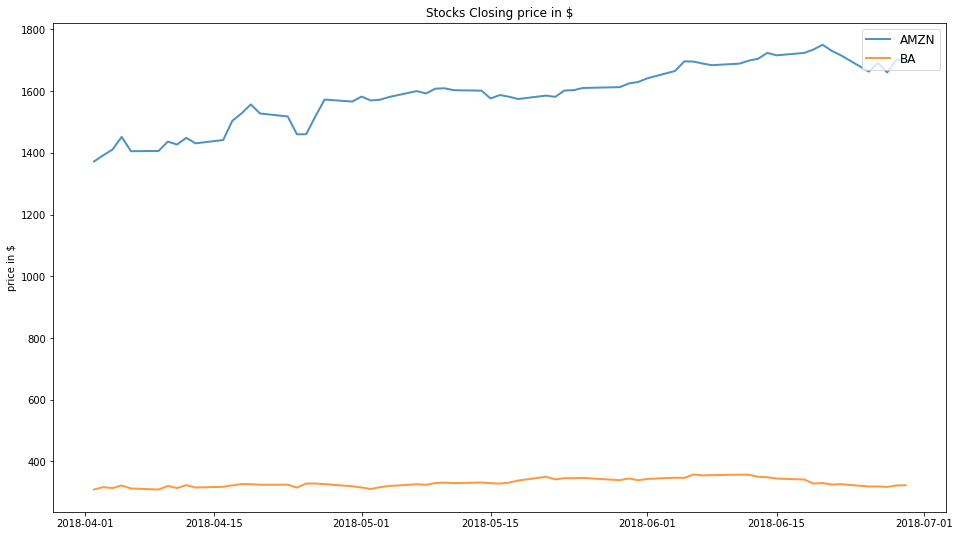

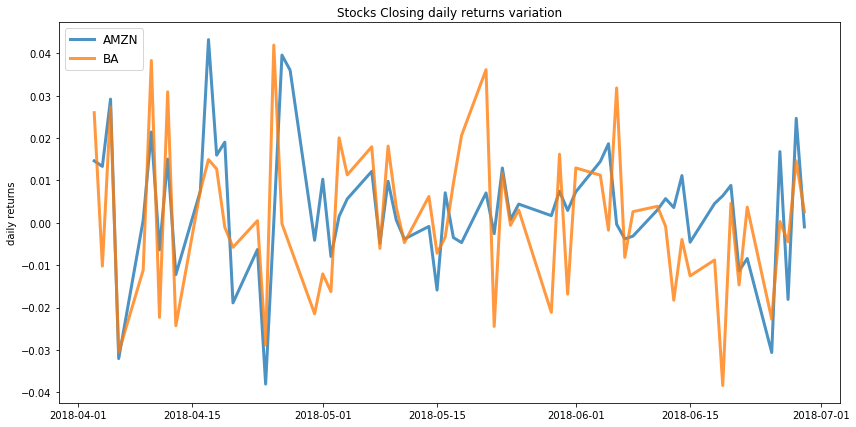

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.23
Annualised Volatility: 0.12


             AMZN   BA
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.11


             AMZN     BA
allocation  64.92  35.08


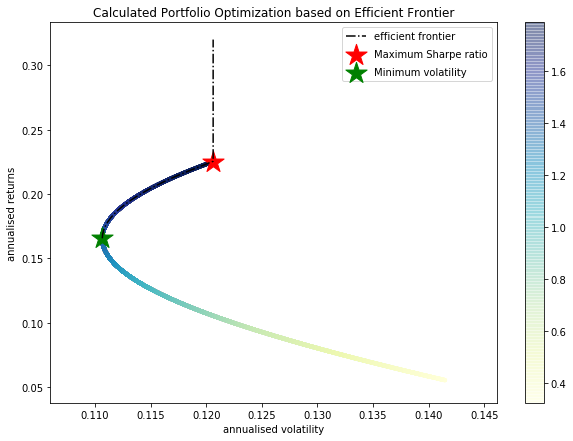

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.23 , annualised volatility: 0.12
BA : annuaised return 0.06 , annualised volatility: 0.14
--------------------------------------------------------------------------------


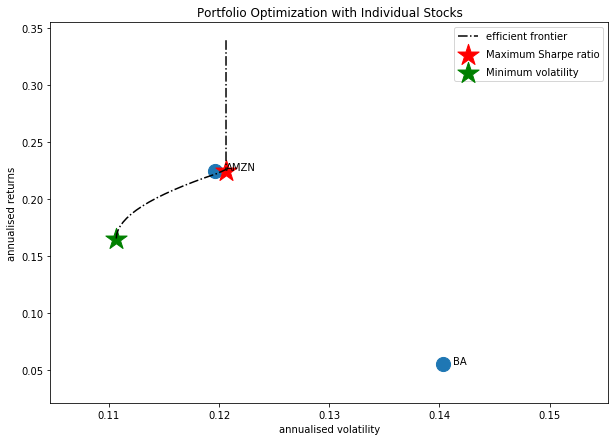

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'AMD']


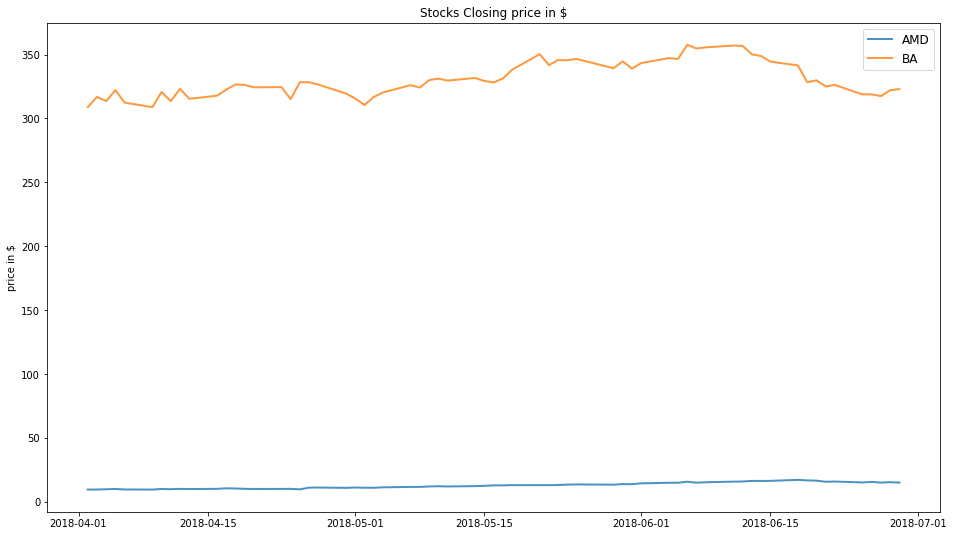

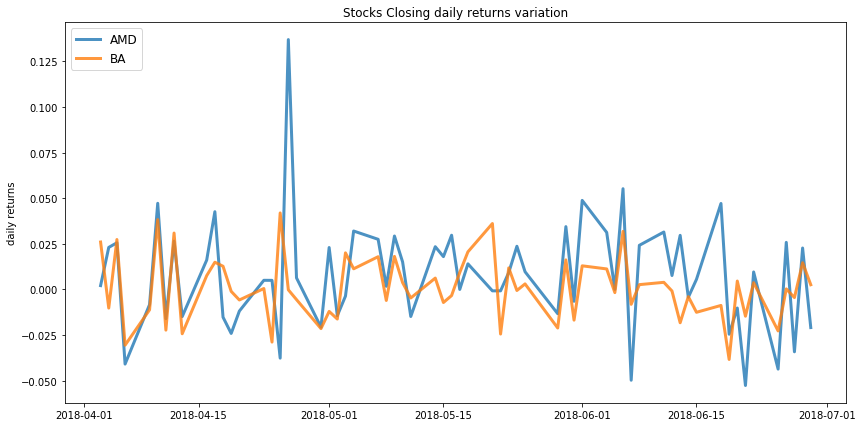

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.49
Annualised Volatility: 0.24


              AMD   BA
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.12
Annualised Volatility: 0.14


              AMD     BA
allocation  14.01  85.99


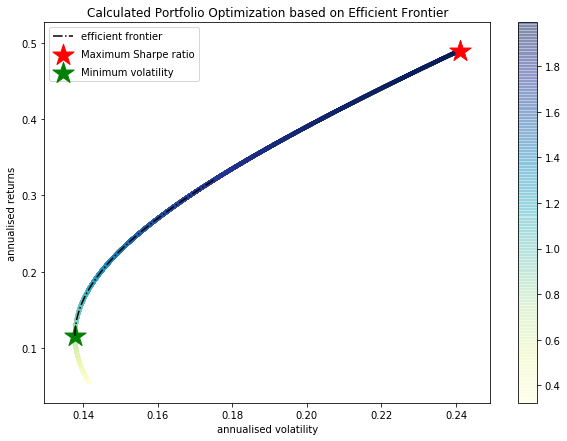

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 0.49 , annualised volatility: 0.24
BA : annuaised return 0.06 , annualised volatility: 0.14
--------------------------------------------------------------------------------


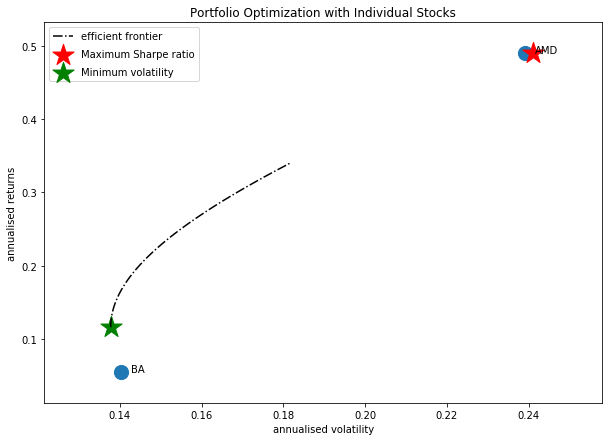

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AMZN']


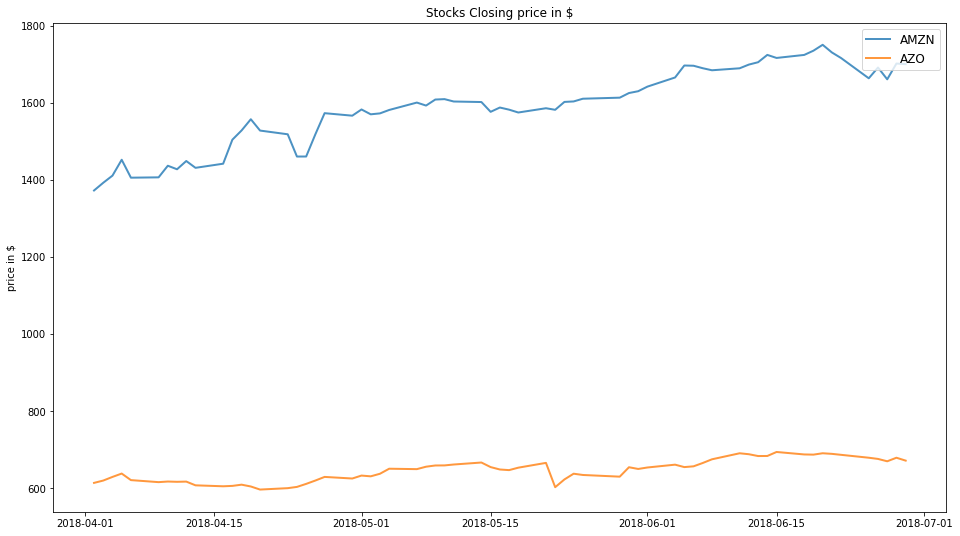

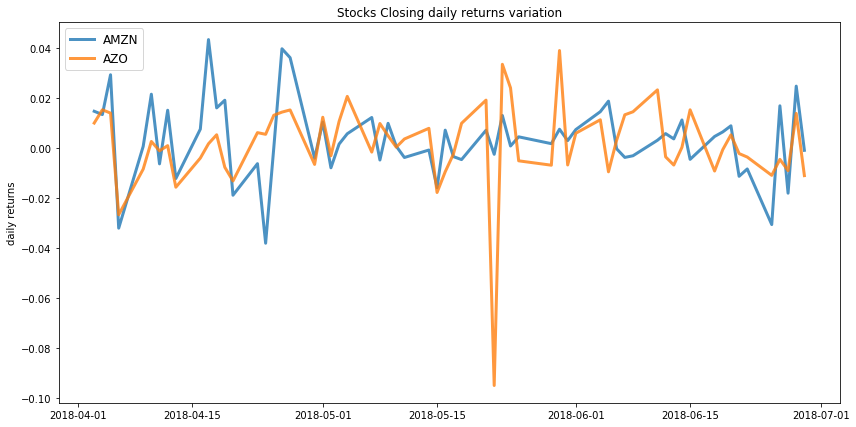

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.22
Annualised Volatility: 0.12


             AMZN   AZO
allocation  93.48  6.52
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.18
Annualised Volatility: 0.1


             AMZN    AZO
allocation  59.86  40.14


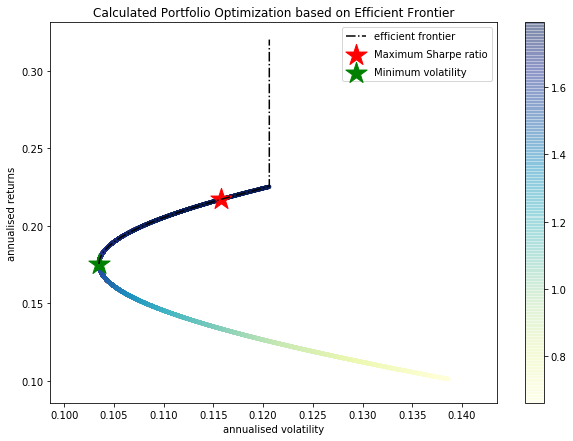

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.23 , annualised volatility: 0.12
AZO : annuaised return 0.1 , annualised volatility: 0.14
--------------------------------------------------------------------------------


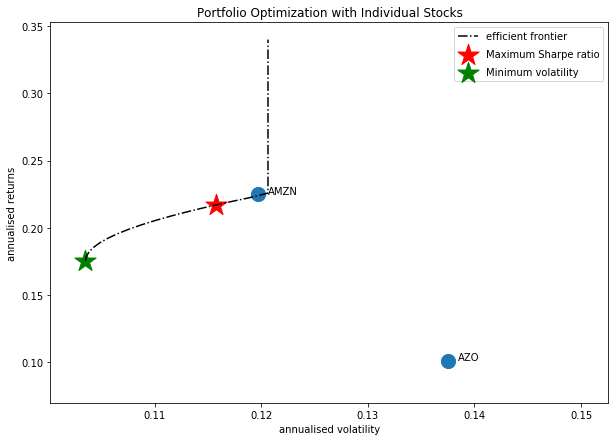

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AMD']


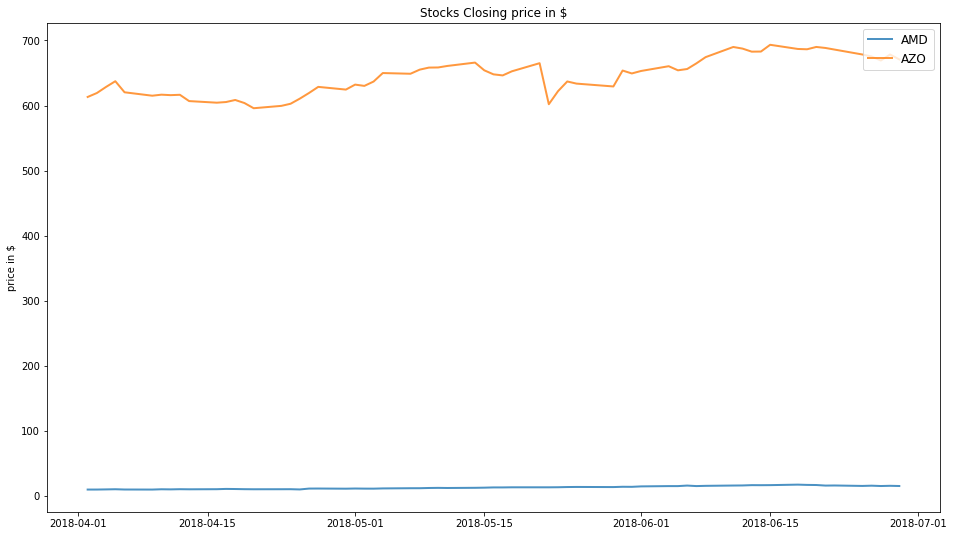

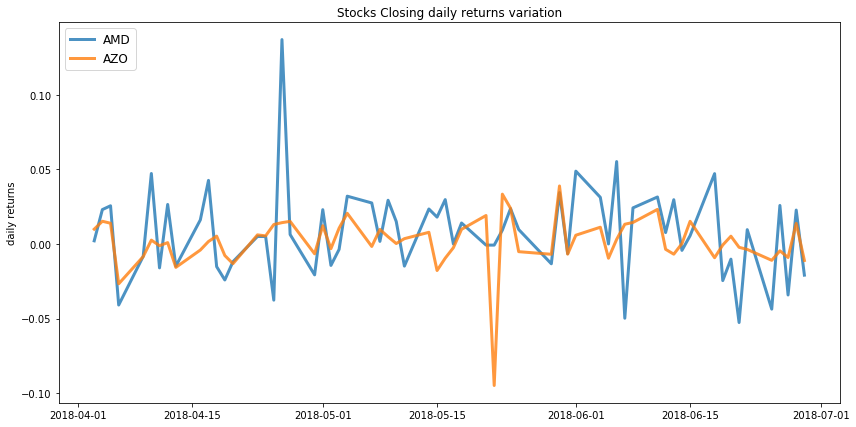

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.45
Annualised Volatility: 0.22


              AMD    AZO
allocation  88.53  11.47
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.13


              AMD    AZO
allocation  17.49  82.51


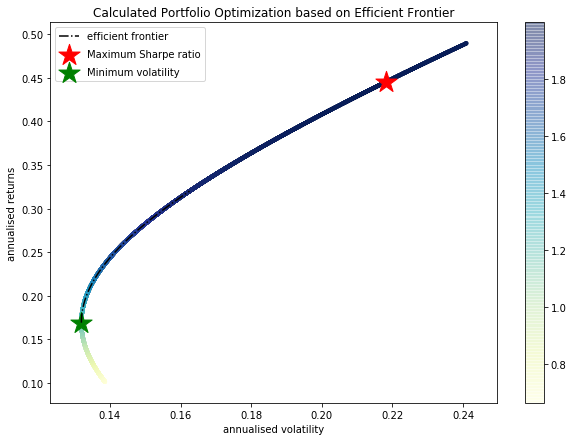

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 0.49 , annualised volatility: 0.24
AZO : annuaised return 0.1 , annualised volatility: 0.14
--------------------------------------------------------------------------------


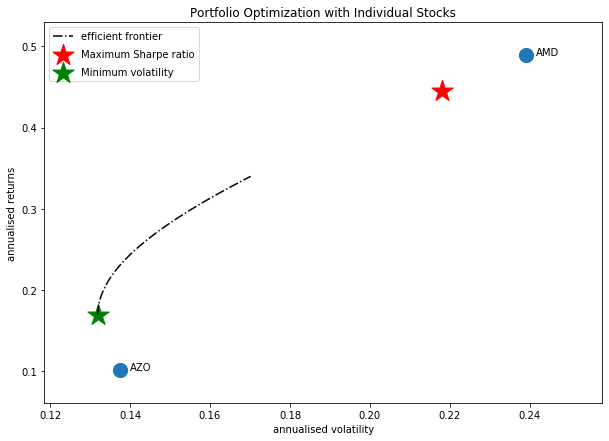

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'CVS']


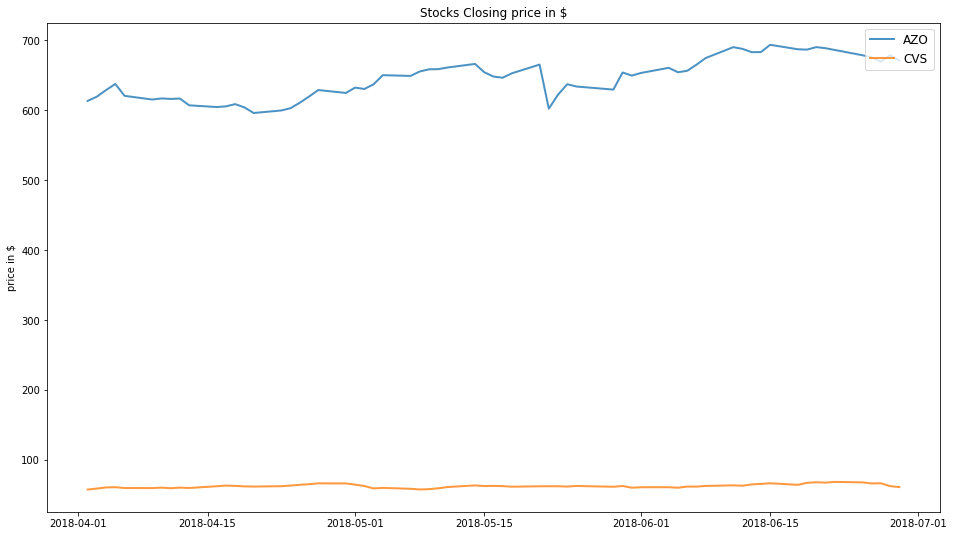

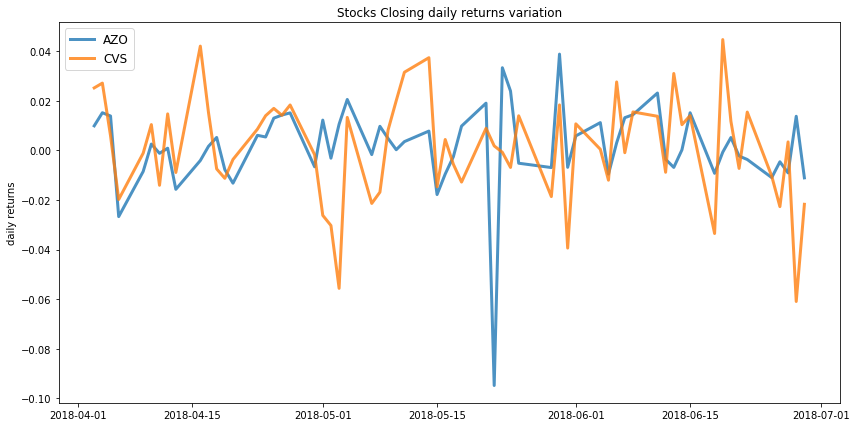

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.09
Annualised Volatility: 0.12


              AZO    CVS
allocation  72.23  27.77
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.09
Annualised Volatility: 0.12


              AZO    CVS
allocation  62.19  37.81


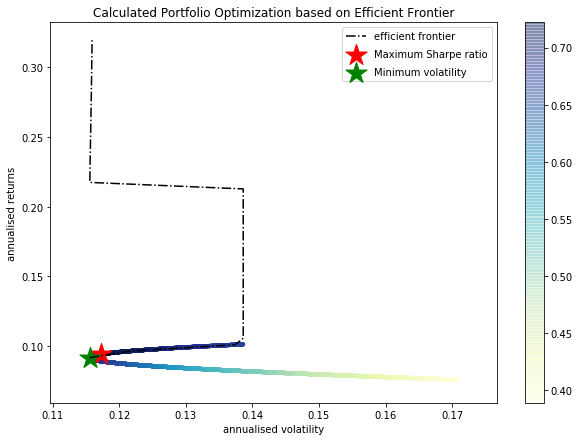

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.1 , annualised volatility: 0.14
CVS : annuaised return 0.08 , annualised volatility: 0.17
--------------------------------------------------------------------------------


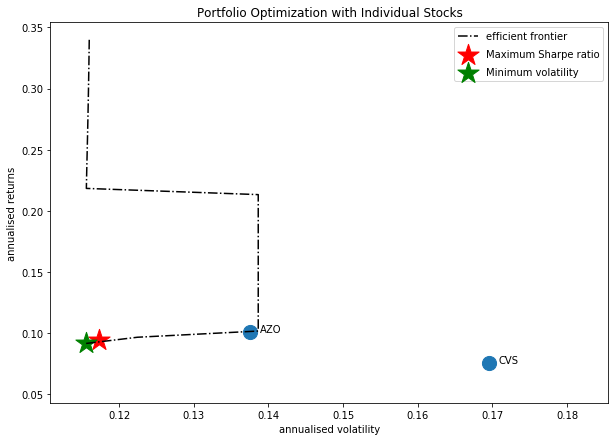

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'BLK']


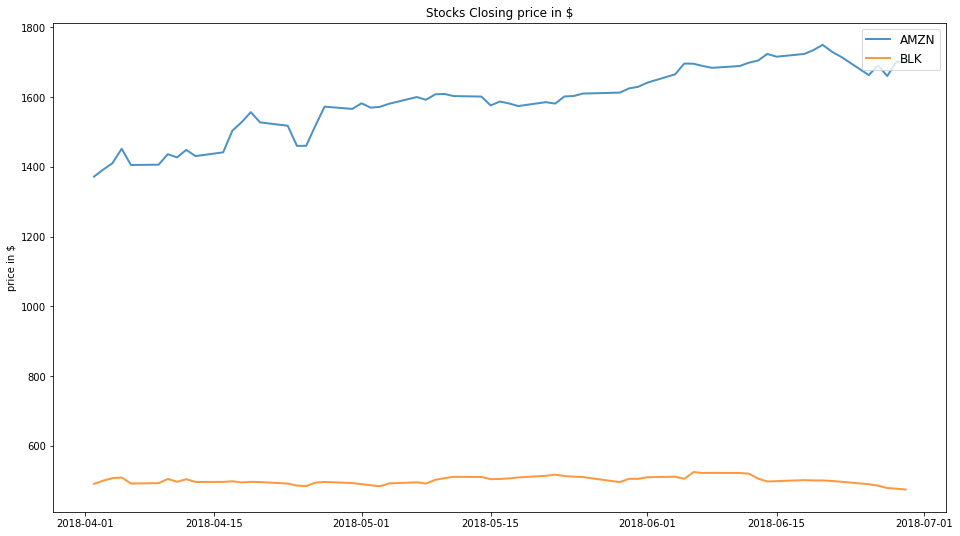

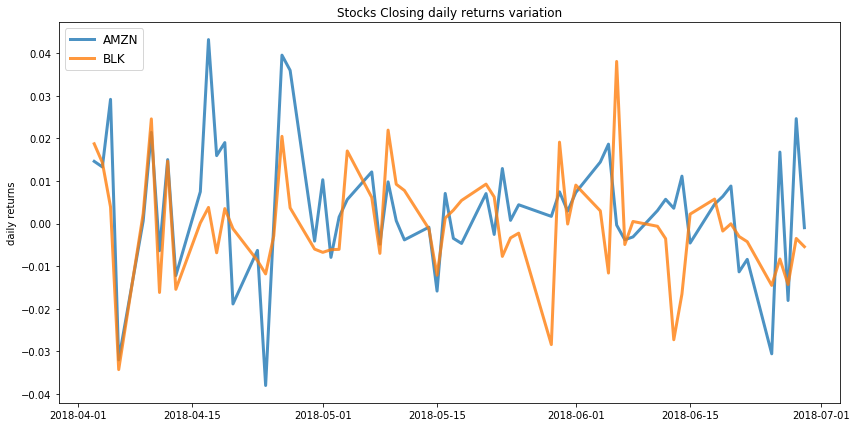

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.23
Annualised Volatility: 0.12


             AMZN  BLK
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.06
Annualised Volatility: 0.09


             AMZN    BLK
allocation  34.22  65.78


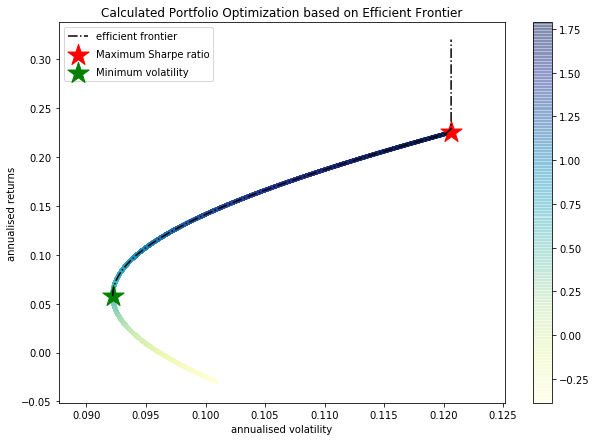

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.23 , annualised volatility: 0.12
BLK : annuaised return -0.03 , annualised volatility: 0.1
--------------------------------------------------------------------------------


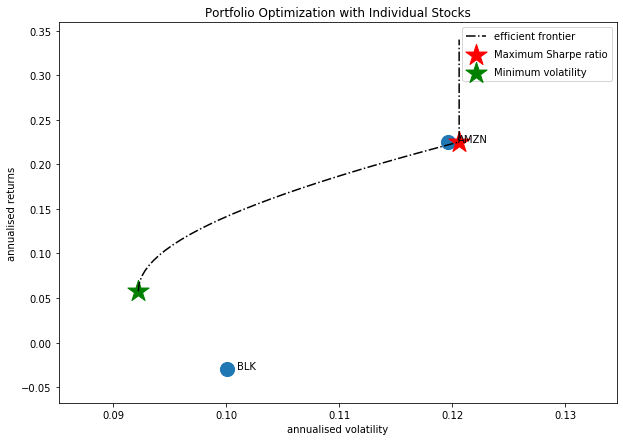

Companies listed in quarter 2 which is between 2018-07-01 and 2018-10-01
['CMG' 'AMZN' 'AMD' 'AZO' 'BLK' 'BKNG' 'PCG' 'AYI']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CMG', 'AYI']


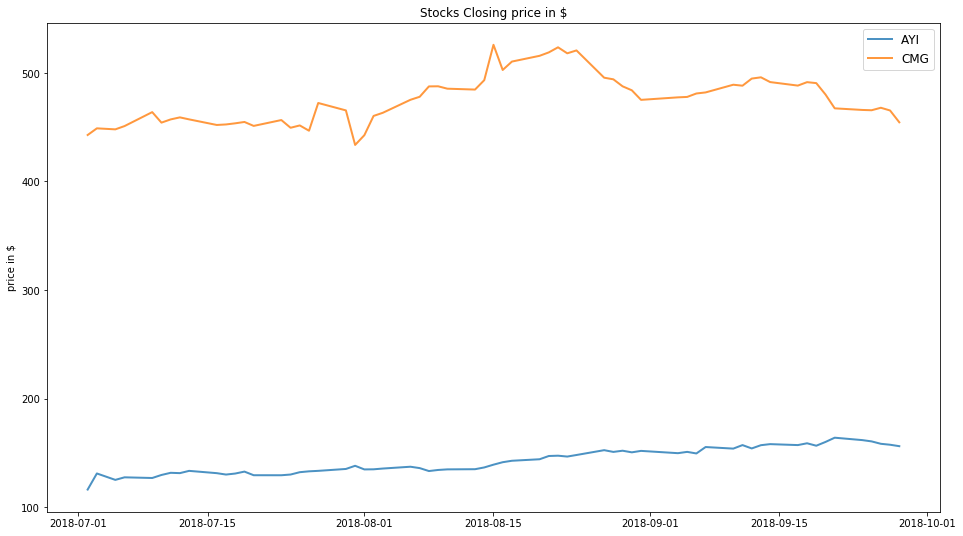

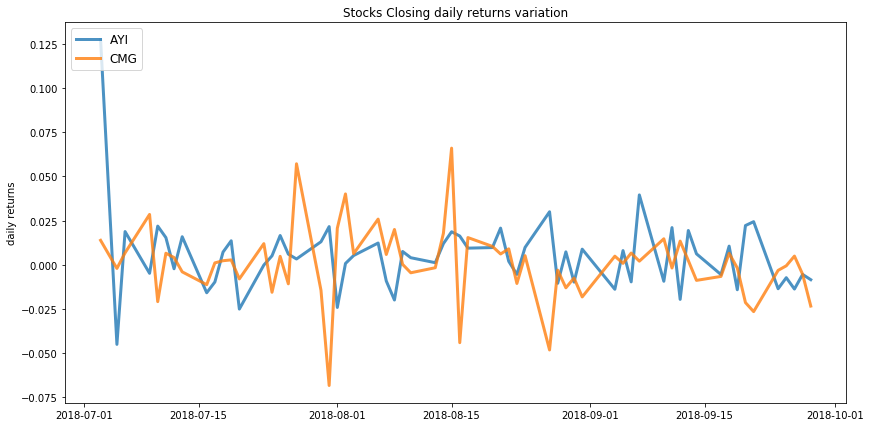

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.27
Annualised Volatility: 0.15


              AYI    CMG
allocation  83.91  16.09
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.12


              AYI    CMG
allocation  47.17  52.83


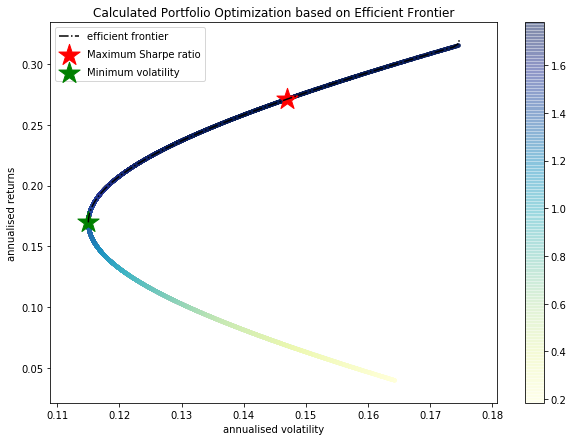

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AYI : annuaised return 0.32 , annualised volatility: 0.17
CMG : annuaised return 0.04 , annualised volatility: 0.16
--------------------------------------------------------------------------------


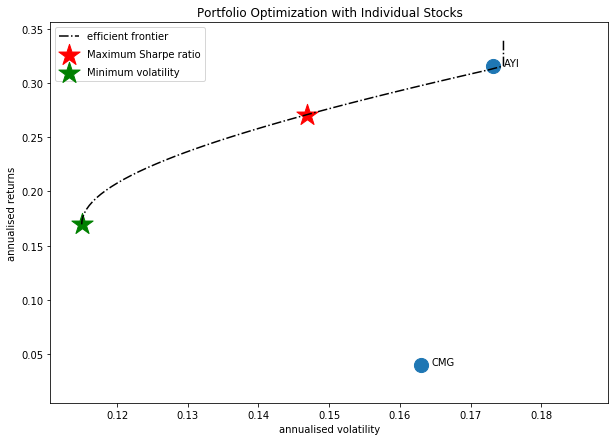

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'AMD']


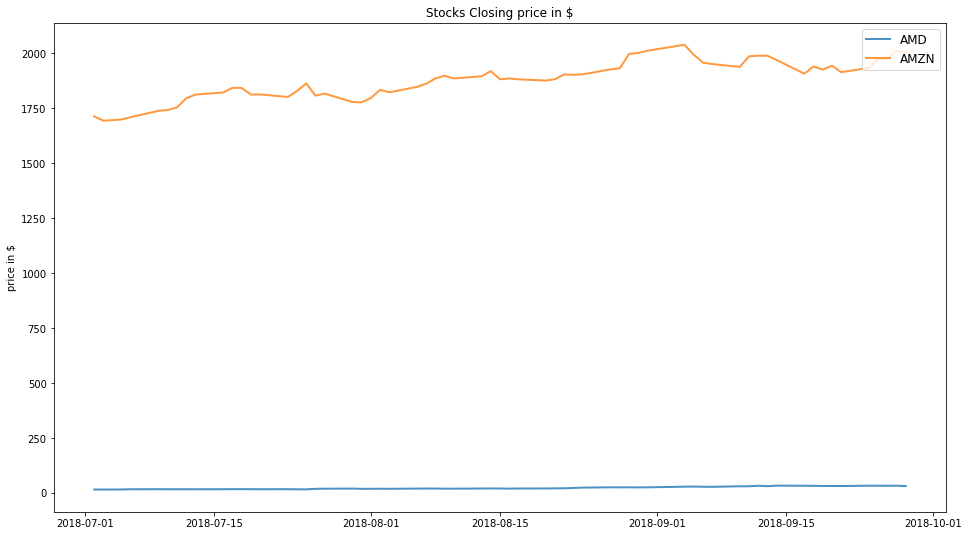

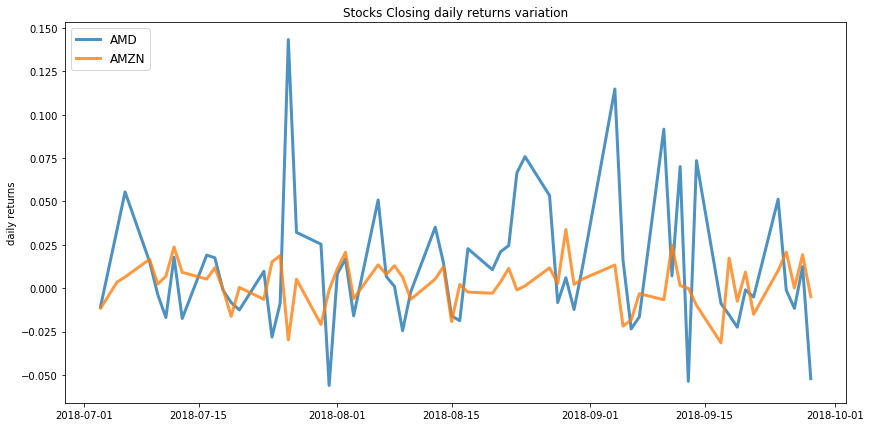

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.39
Annualised Volatility: 0.13


             AMD  AMZN
allocation  36.7  63.3
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.24
Annualised Volatility: 0.1


              AMD   AMZN
allocation  11.72  88.28


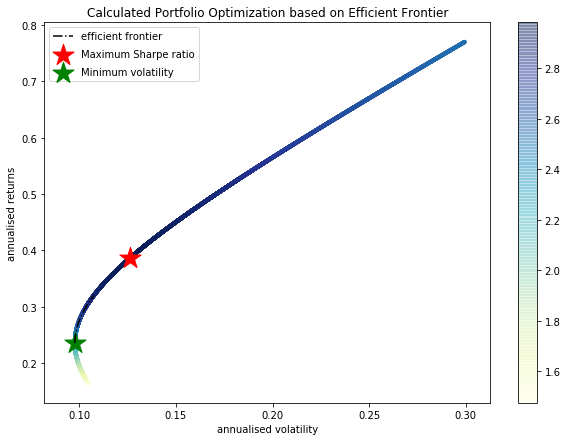

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 0.77 , annualised volatility: 0.3
AMZN : annuaised return 0.16 , annualised volatility: 0.1
--------------------------------------------------------------------------------


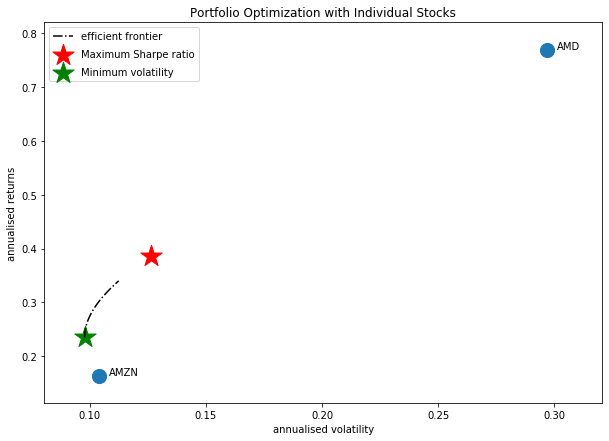

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'AZO']


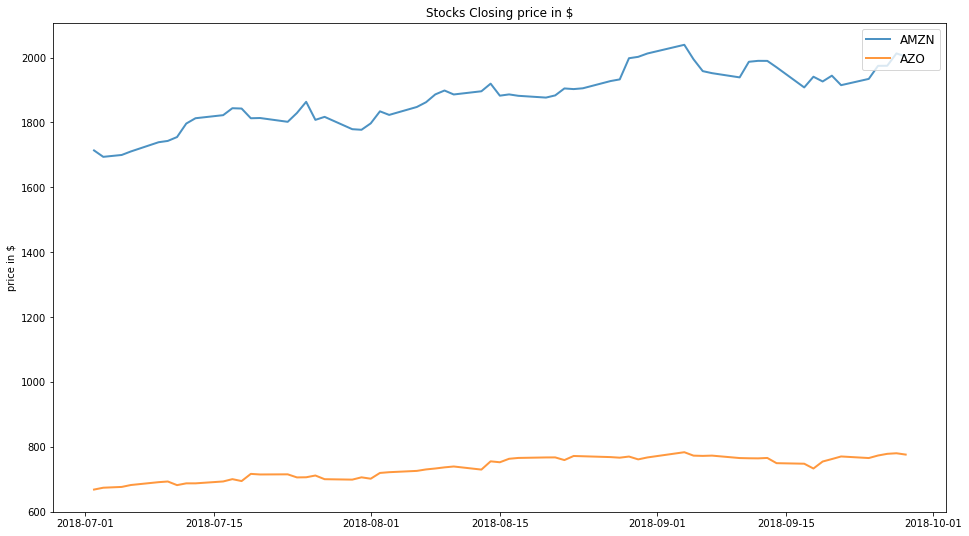

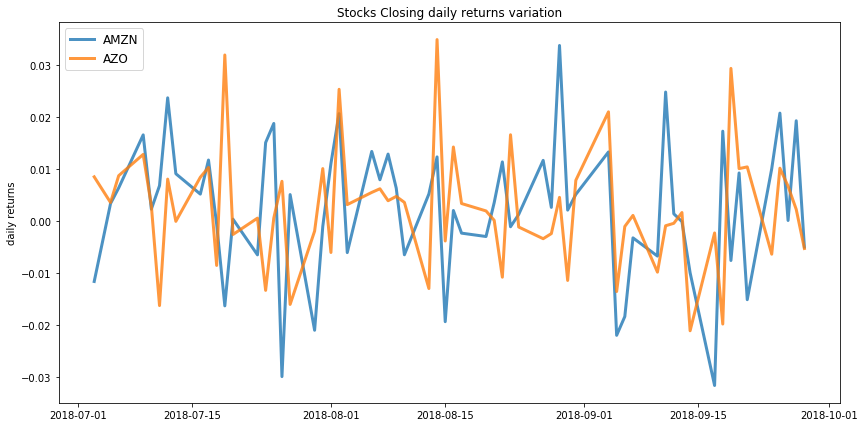

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.16
Annualised Volatility: 0.07


             AMZN    AZO
allocation  44.11  55.89
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.16
Annualised Volatility: 0.07


             AMZN    AZO
allocation  42.67  57.33


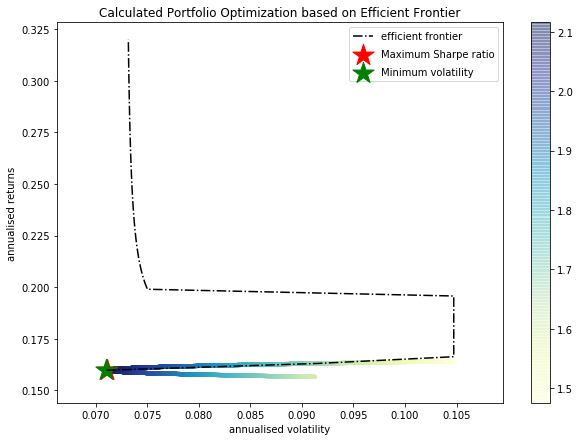

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.16 , annualised volatility: 0.1
AZO : annuaised return 0.16 , annualised volatility: 0.09
--------------------------------------------------------------------------------


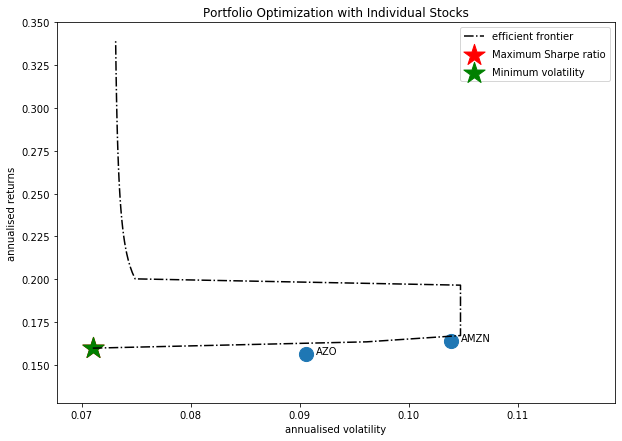

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'PCG']


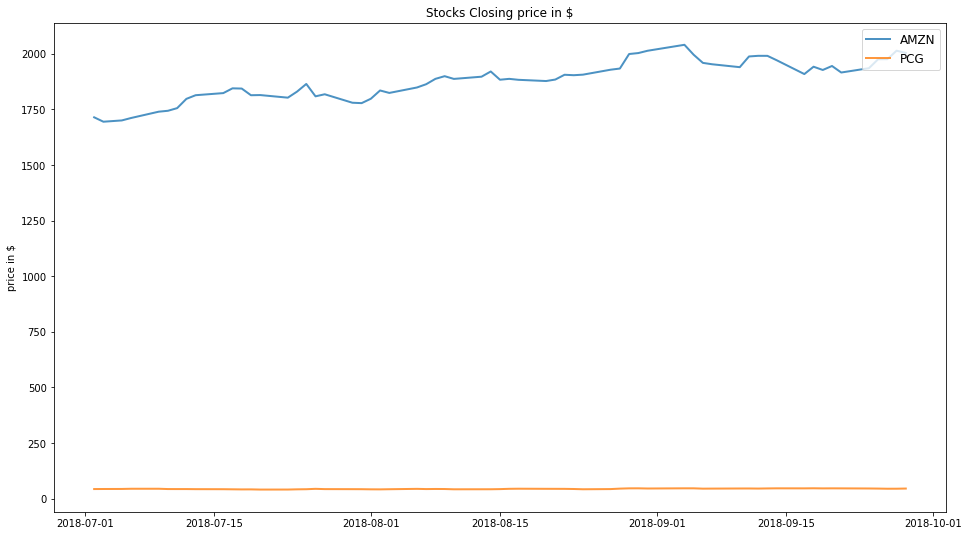

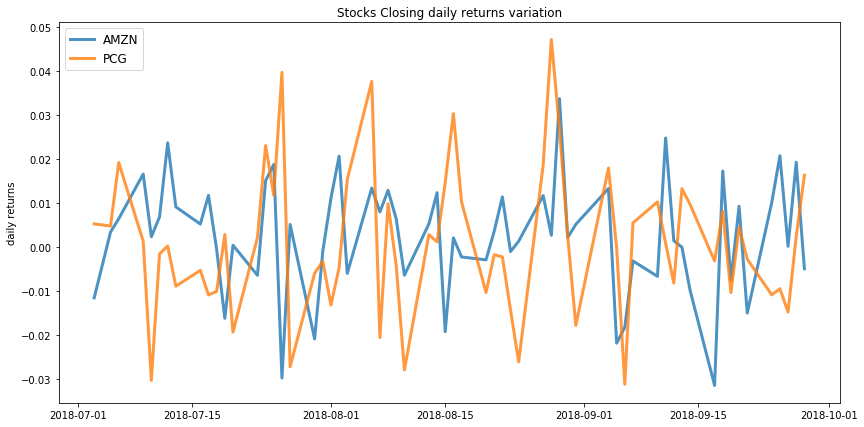

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.15
Annualised Volatility: 0.09


             AMZN    PCG
allocation  86.41  13.59
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.12
Annualised Volatility: 0.08


             AMZN    PCG
allocation  62.11  37.89


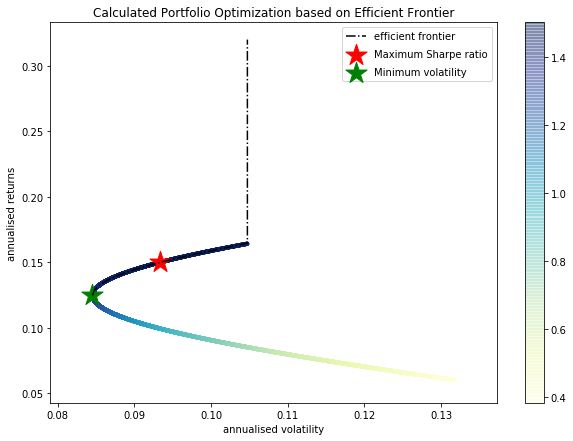

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.16 , annualised volatility: 0.1
PCG : annuaised return 0.06 , annualised volatility: 0.13
--------------------------------------------------------------------------------


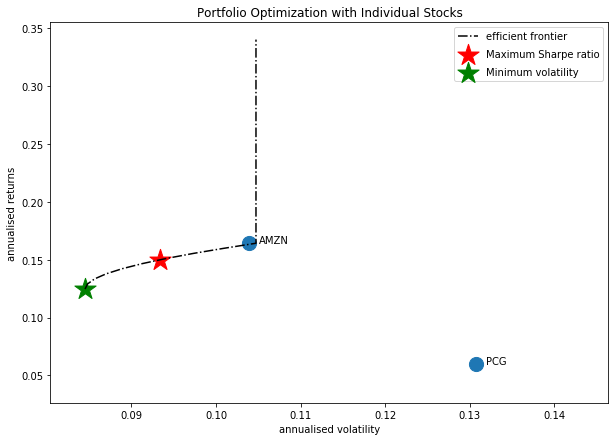

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'BLK']


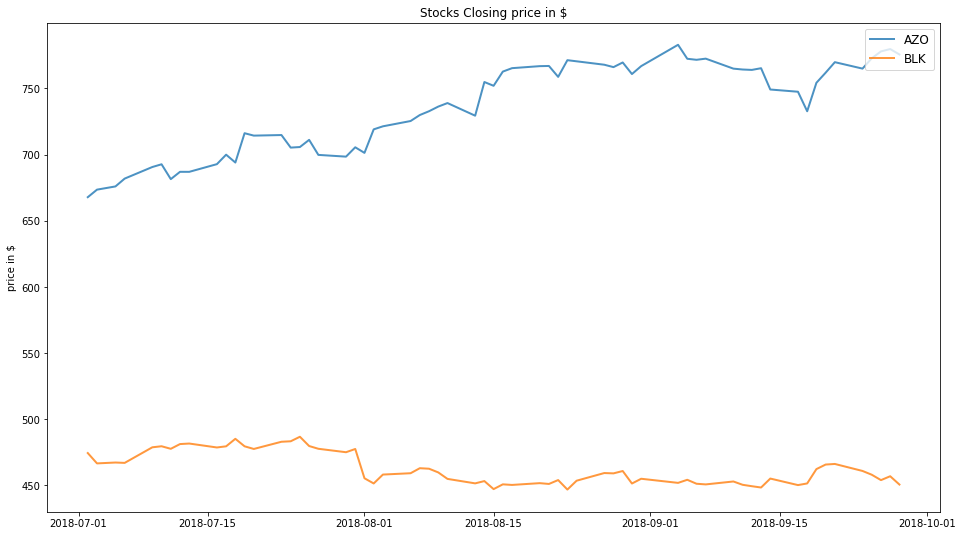

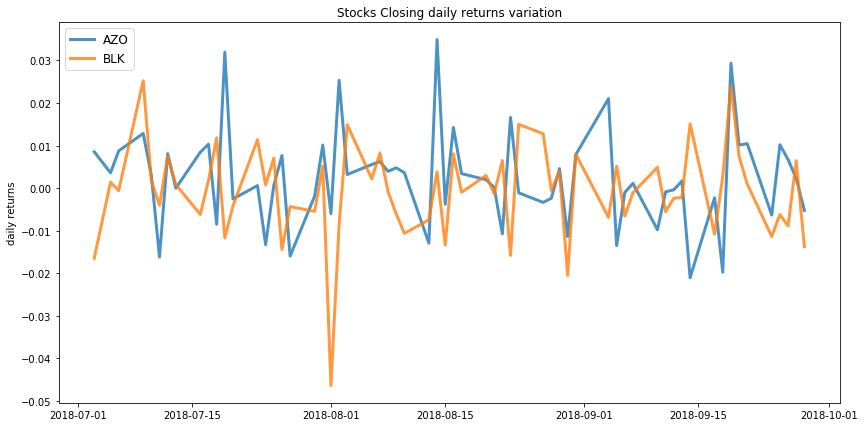

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.16
Annualised Volatility: 0.09


              AZO  BLK
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.07


              AZO    BLK
allocation  48.27  51.73


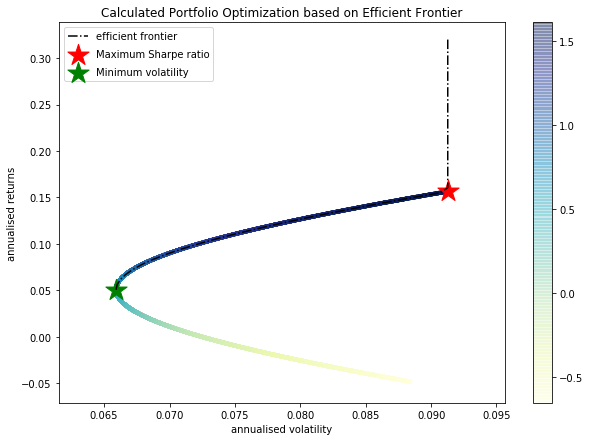

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.16 , annualised volatility: 0.09
BLK : annuaised return -0.05 , annualised volatility: 0.09
--------------------------------------------------------------------------------


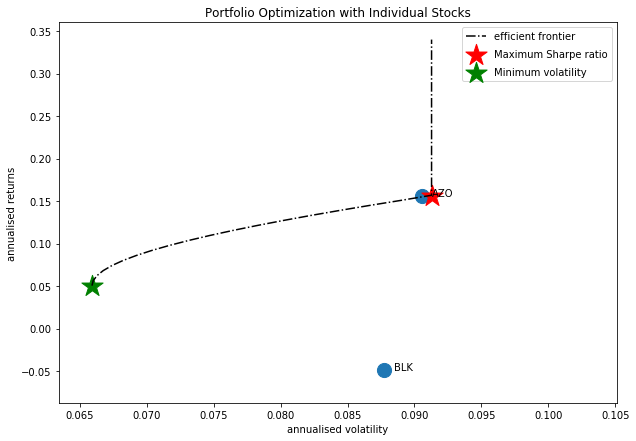

Companies listed in quarter 3 which is between 2018-10-01 and 2019-01-01
['AZO' 'ALGN' 'BKNG' 'BLK' 'NEM' 'BAC' 'GOOG' 'APD']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ALGN', 'BKNG']


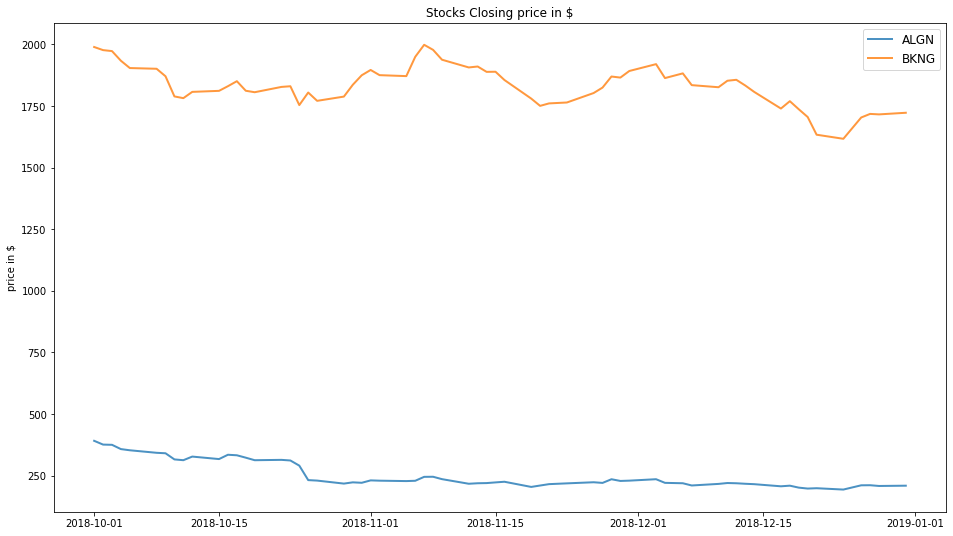

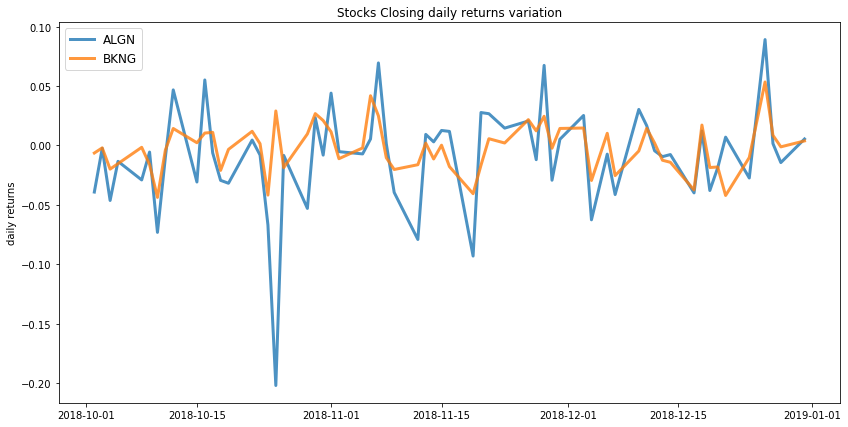

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.13
Annualised Volatility: 0.16


            ALGN   BKNG
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.14
Annualised Volatility: 0.16


            ALGN   BKNG
allocation  1.32  98.68


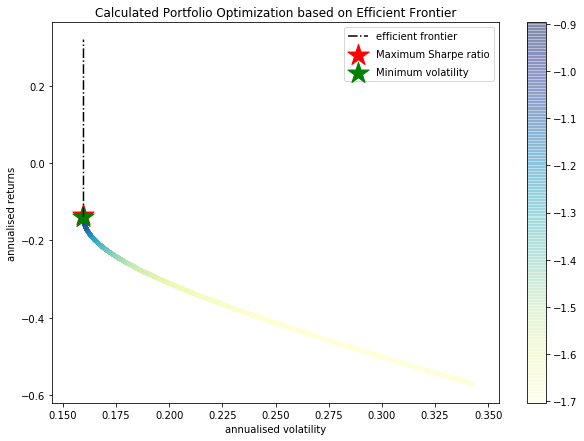

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ALGN : annuaised return -0.57 , annualised volatility: 0.34
BKNG : annuaised return -0.13 , annualised volatility: 0.16
--------------------------------------------------------------------------------


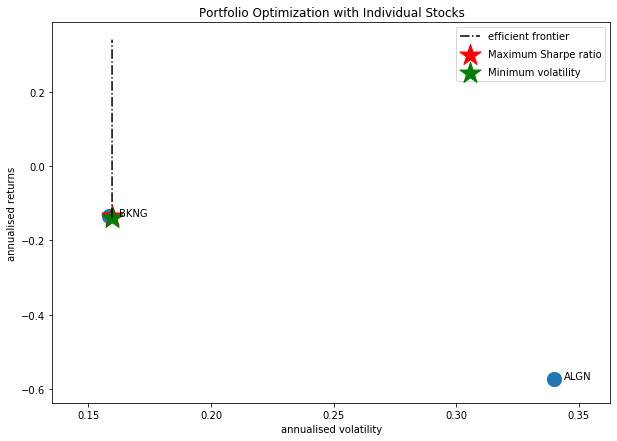

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'BLK']


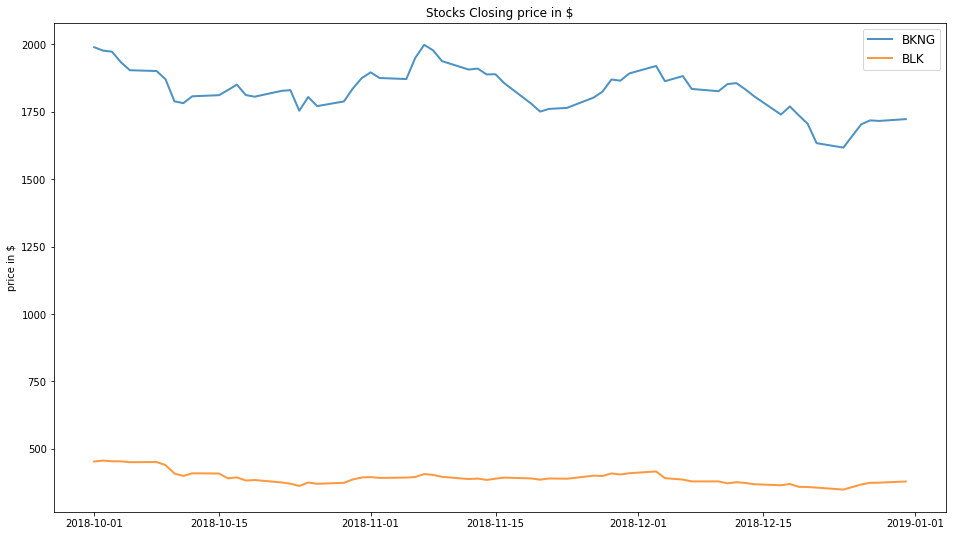

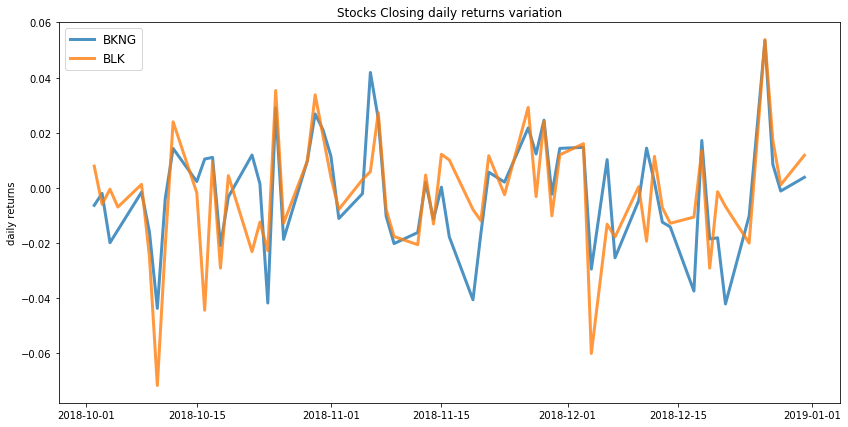

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.13
Annualised Volatility: 0.16


             BKNG  BLK
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.15
Annualised Volatility: 0.15


             BKNG    BLK
allocation  59.55  40.45


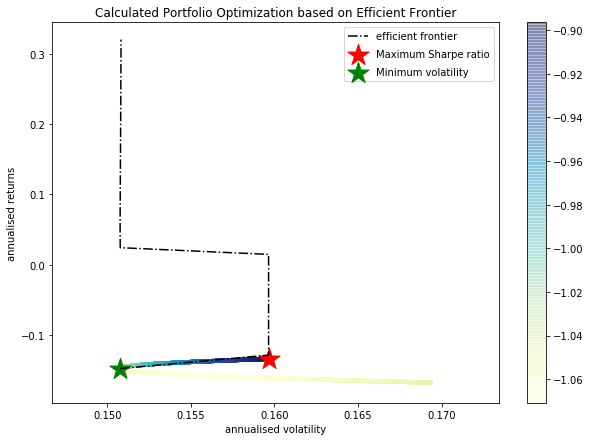

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return -0.13 , annualised volatility: 0.16
BLK : annuaised return -0.17 , annualised volatility: 0.17
--------------------------------------------------------------------------------


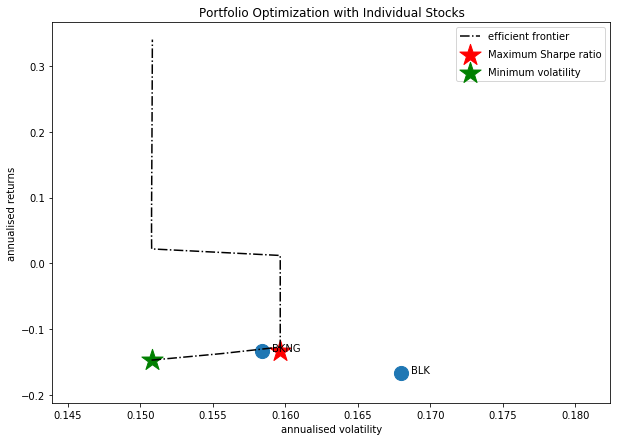

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'NEM']


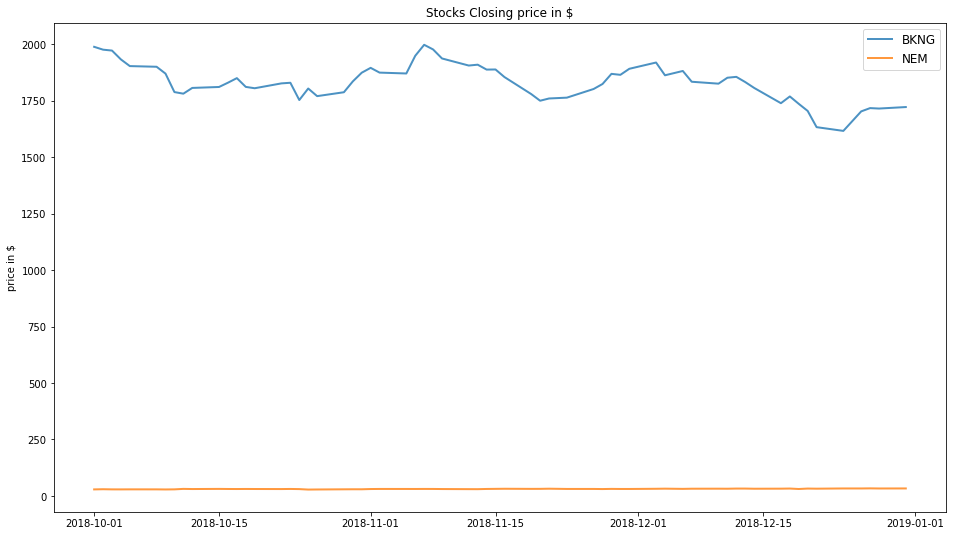

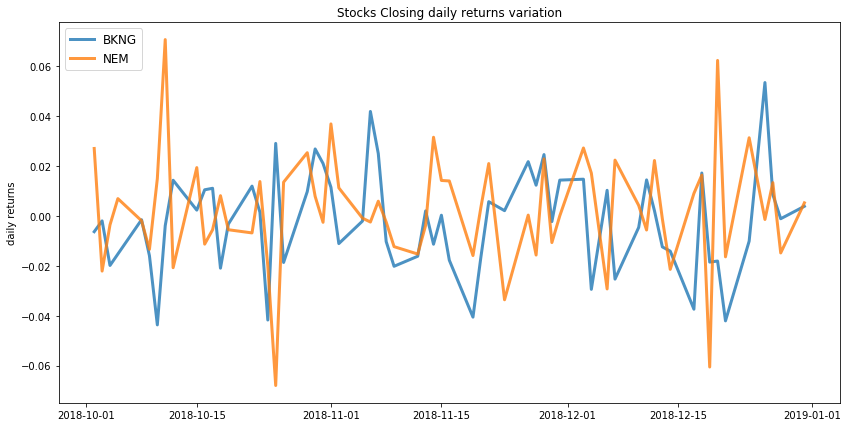

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.16
Annualised Volatility: 0.18


            BKNG    NEM
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.01
Annualised Volatility: 0.12


             BKNG    NEM
allocation  56.68  43.32


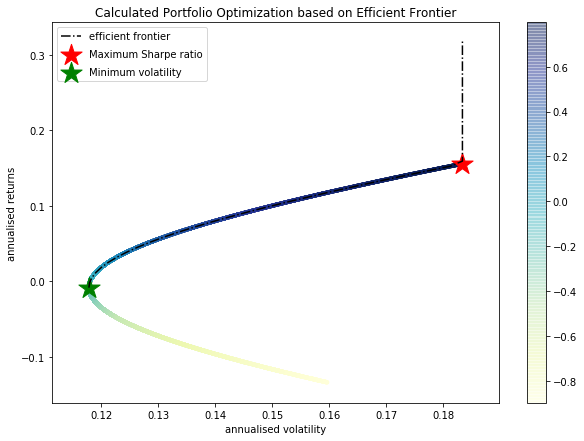

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return -0.13 , annualised volatility: 0.16
NEM : annuaised return 0.16 , annualised volatility: 0.18
--------------------------------------------------------------------------------


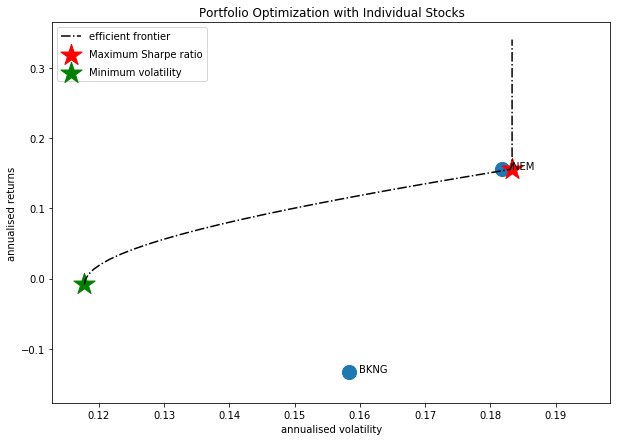

Companies listed in quarter 4 which is between 2019-01-01 and 2019-04-01
['BKNG' 'BA' 'CXO' 'CMG' 'BIIB' 'BLK' 'AYI' 'AZO' 'AMD' 'COP' 'COTY']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'CXO', 'BIIB', 'BLK']


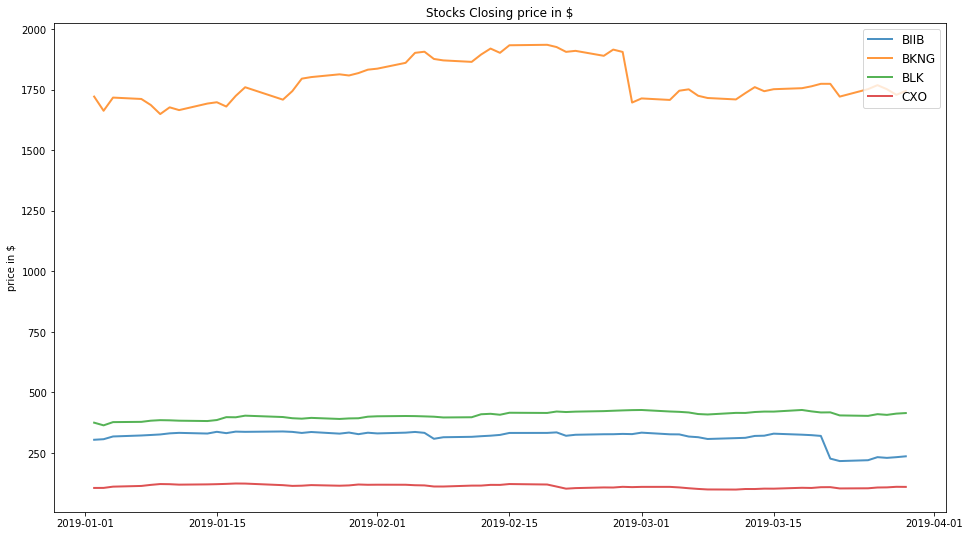

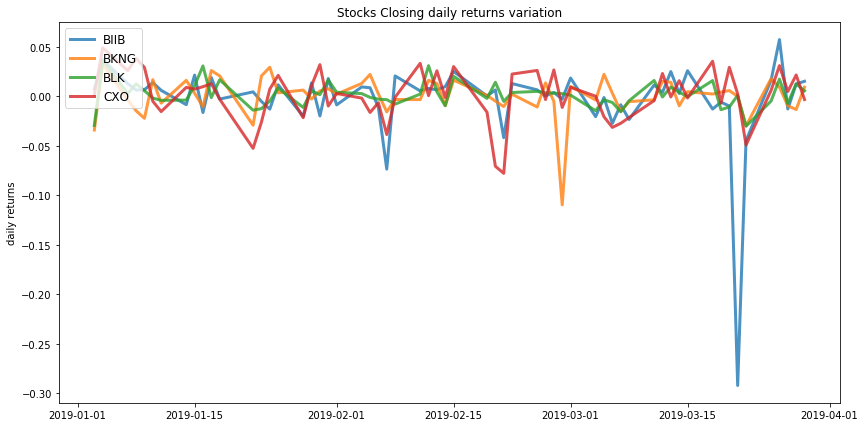

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.11
Annualised Volatility: 0.1


            BIIB  BKNG    BLK  CXO
allocation   0.0   0.0  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.09
Annualised Volatility: 0.09


            BIIB  BKNG    BLK   CXO
allocation  1.48  20.7  77.38  0.45


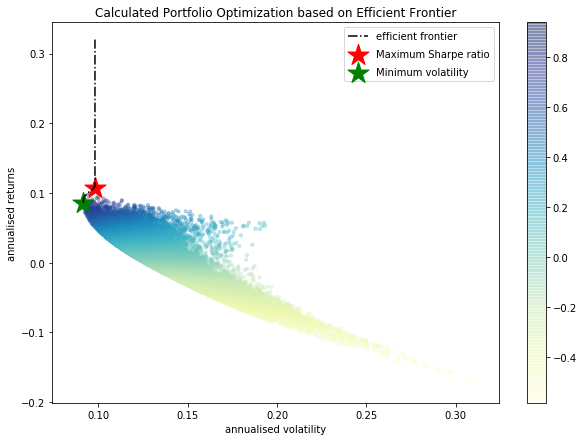

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BIIB : annuaised return -0.19 , annualised volatility: 0.33
BKNG : annuaised return 0.03 , annualised volatility: 0.16
BLK : annuaised return 0.11 , annualised volatility: 0.1
CXO : annuaised return 0.06 , annualised volatility: 0.2
--------------------------------------------------------------------------------


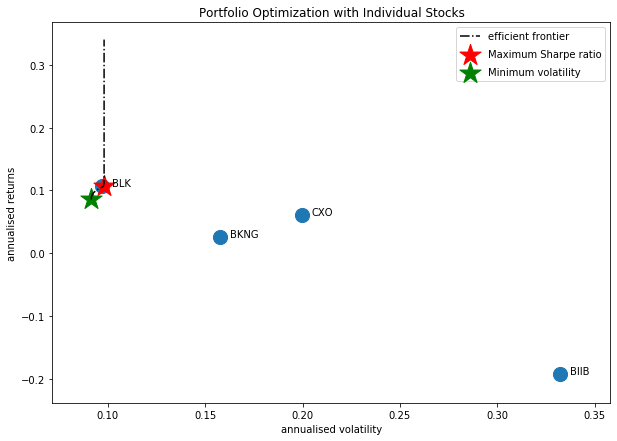

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'CMG']


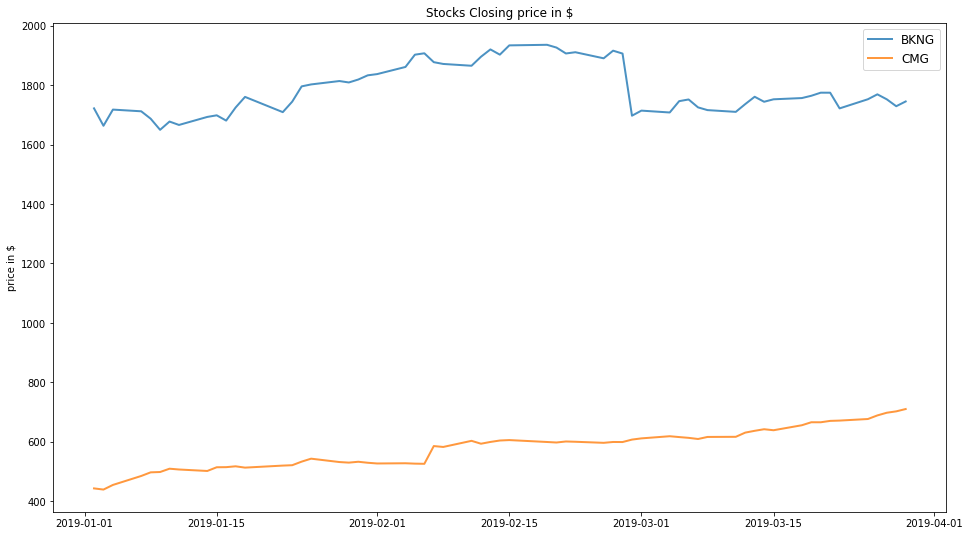

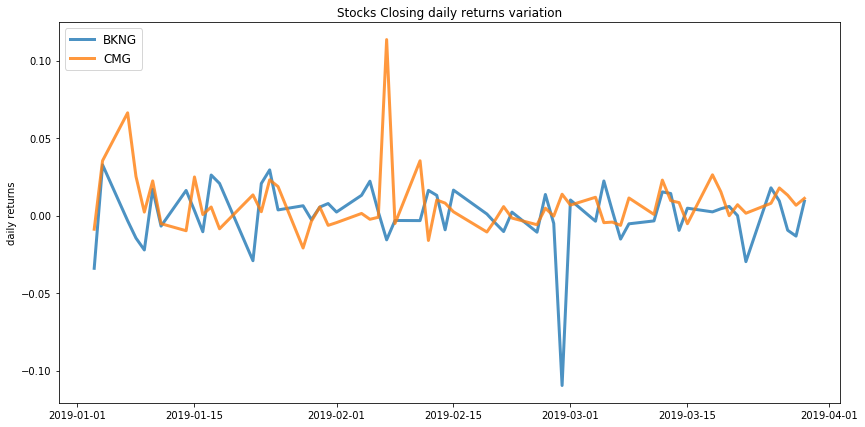

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.45
Annualised Volatility: 0.14


            BKNG    CMG
allocation  9.46  90.54
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.26
Annualised Volatility: 0.11


             BKNG    CMG
allocation  48.83  51.17


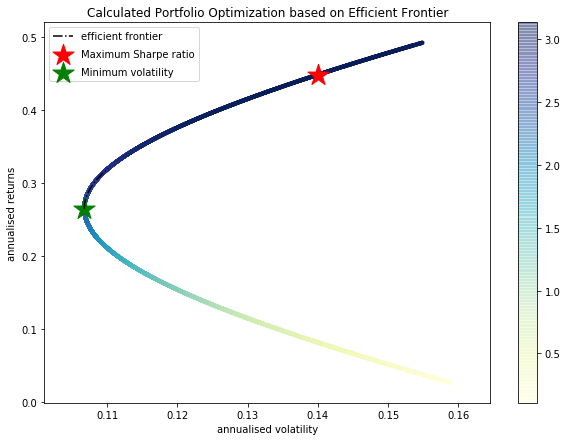

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return 0.03 , annualised volatility: 0.16
CMG : annuaised return 0.49 , annualised volatility: 0.15
--------------------------------------------------------------------------------


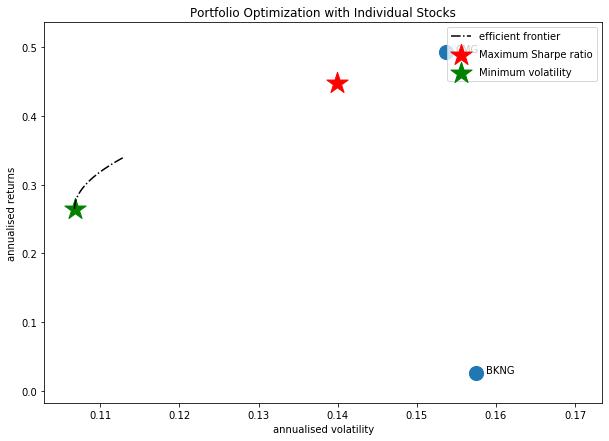

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'COP']


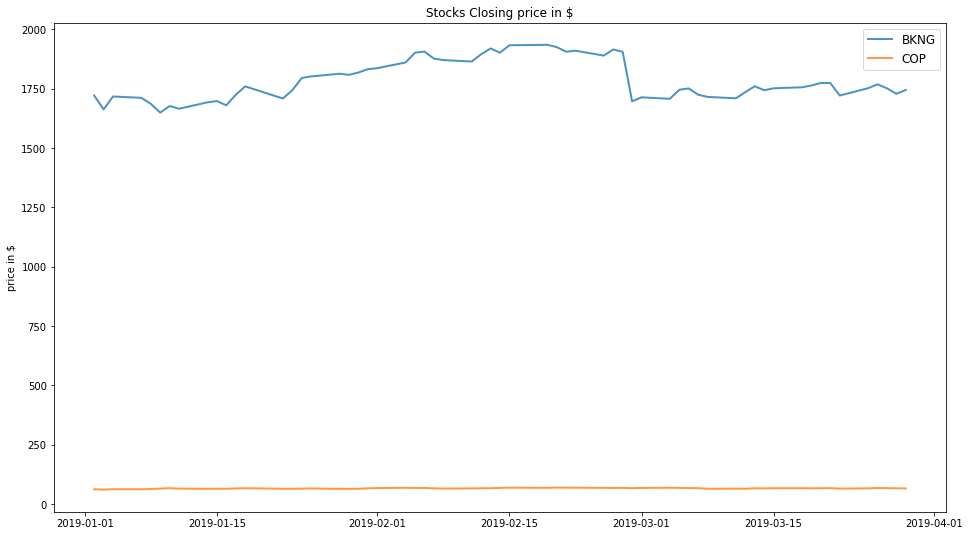

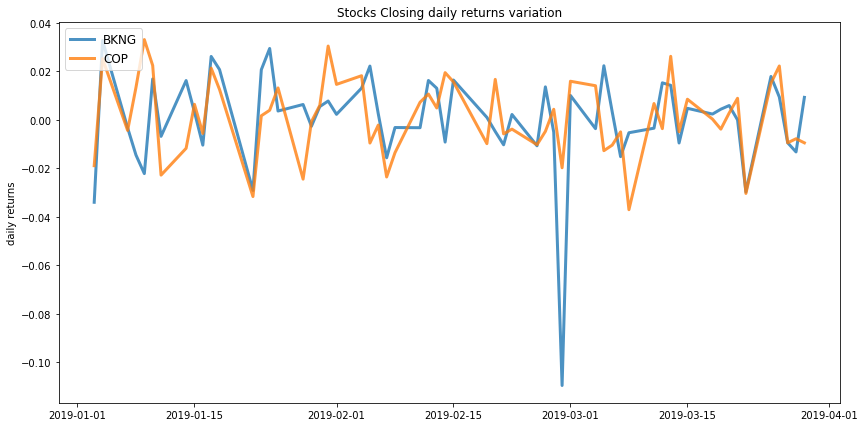

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.06
Annualised Volatility: 0.12


            BKNG    COP
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.12


             BKNG    COP
allocation  29.97  70.03


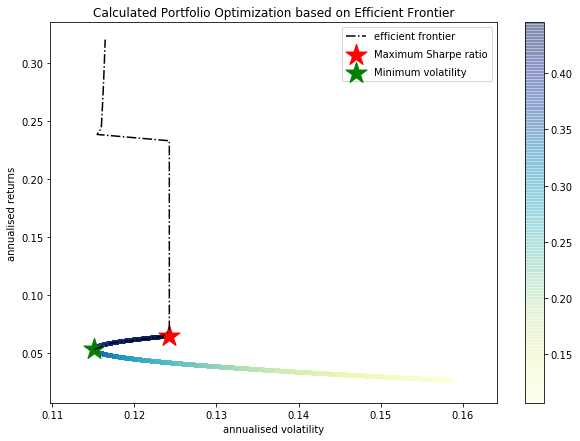

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return 0.03 , annualised volatility: 0.16
COP : annuaised return 0.06 , annualised volatility: 0.12
--------------------------------------------------------------------------------


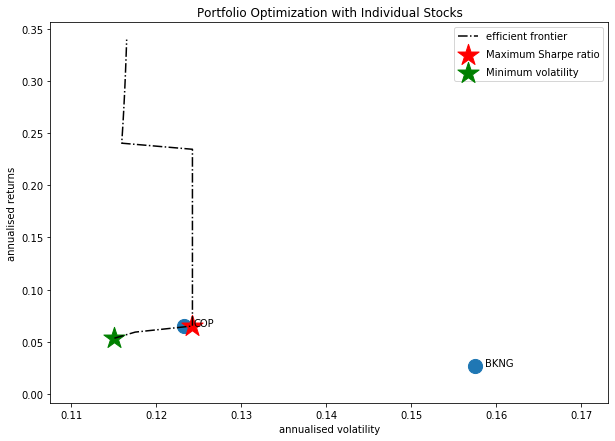

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'BIIB']


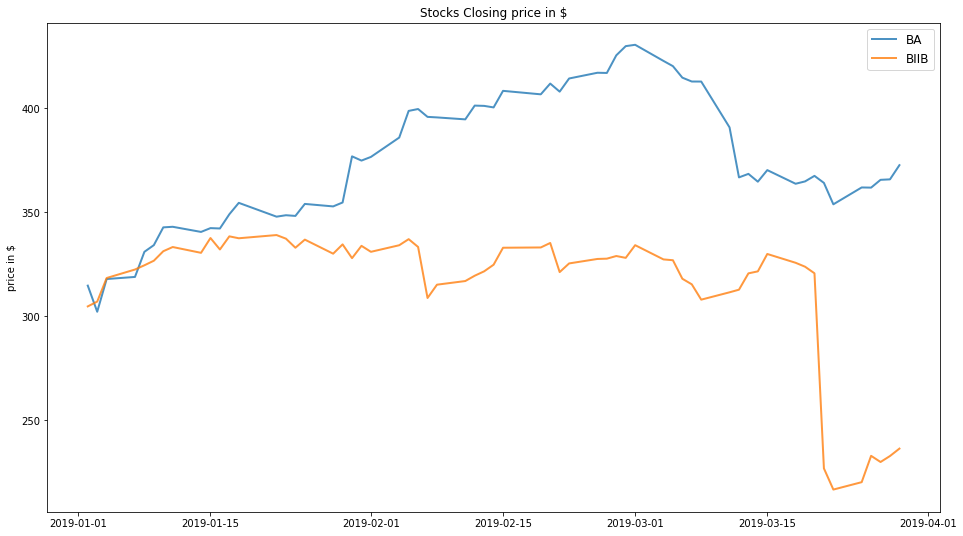

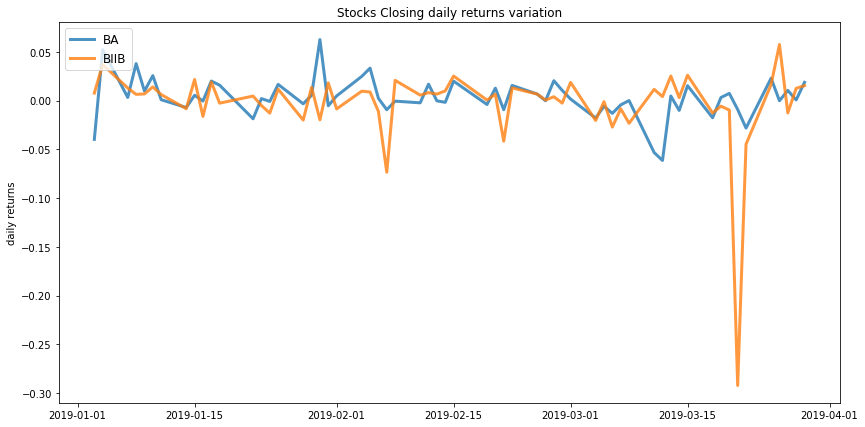

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.18
Annualised Volatility: 0.16


               BA  BIIB
allocation  100.0   0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.14
Annualised Volatility: 0.15


               BA   BIIB
allocation  87.04  12.96


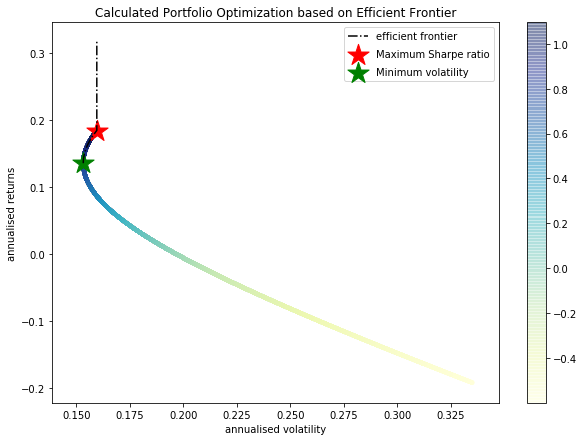

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BA : annuaised return 0.18 , annualised volatility: 0.16
BIIB : annuaised return -0.19 , annualised volatility: 0.33
--------------------------------------------------------------------------------


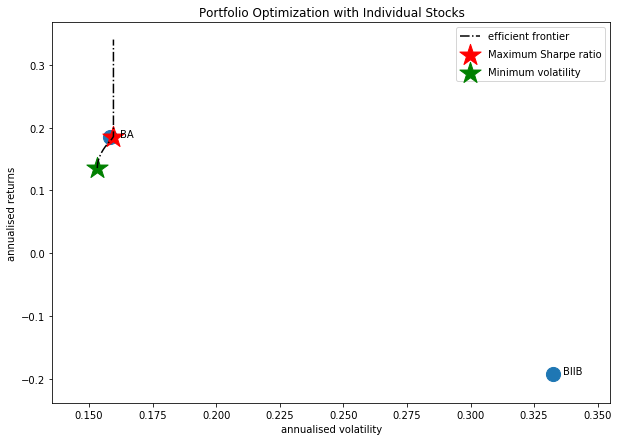

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'AZO']


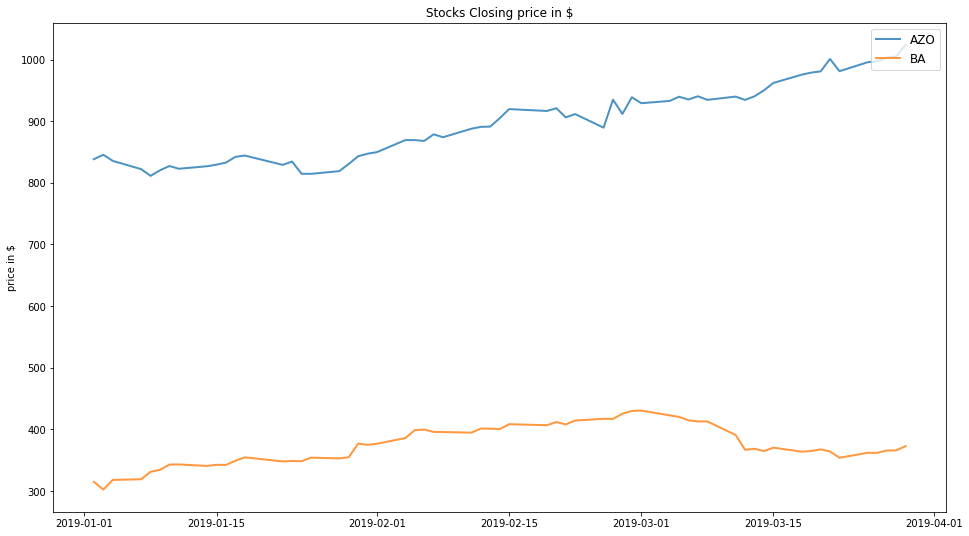

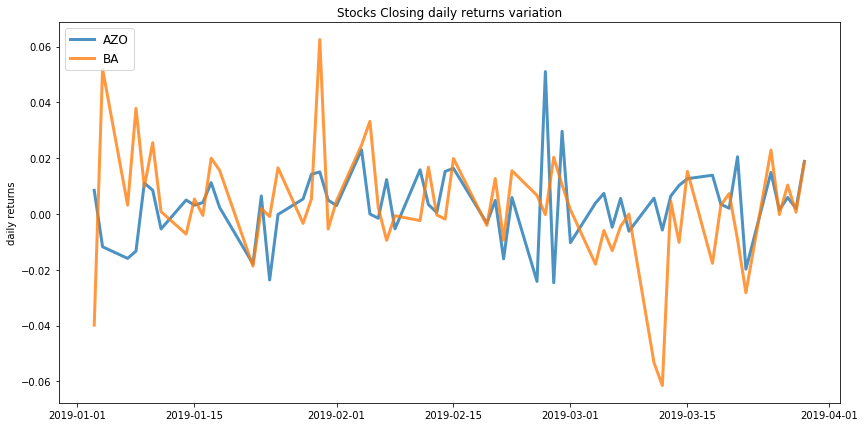

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.2
Annualised Volatility: 0.09


              AZO     BA
allocation  75.11  24.89
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.2
Annualised Volatility: 0.09


              AZO     BA
allocation  71.95  28.05


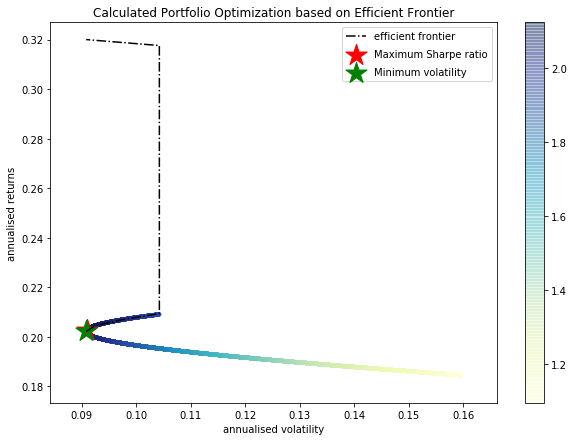

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.21 , annualised volatility: 0.1
BA : annuaised return 0.18 , annualised volatility: 0.16
--------------------------------------------------------------------------------


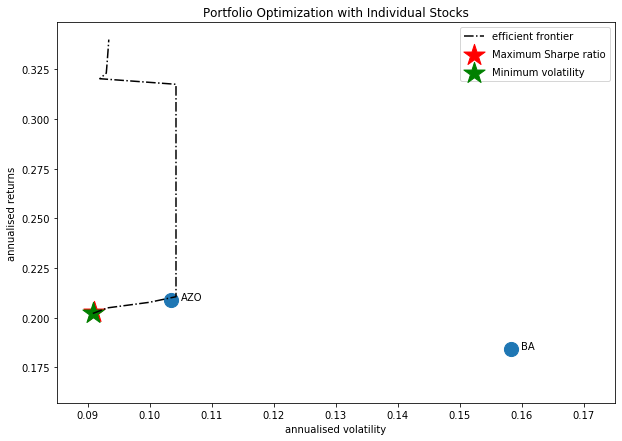

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CXO', 'BIIB', 'BLK']


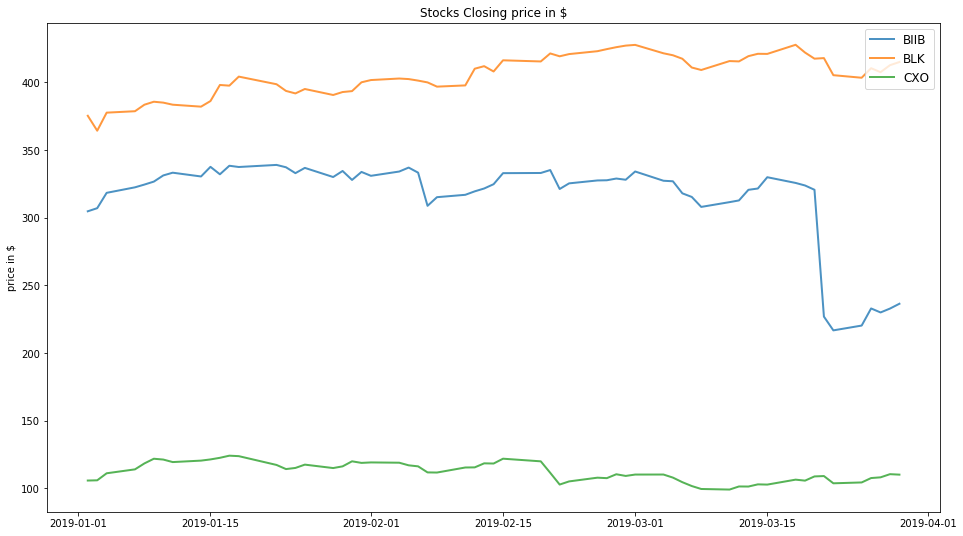

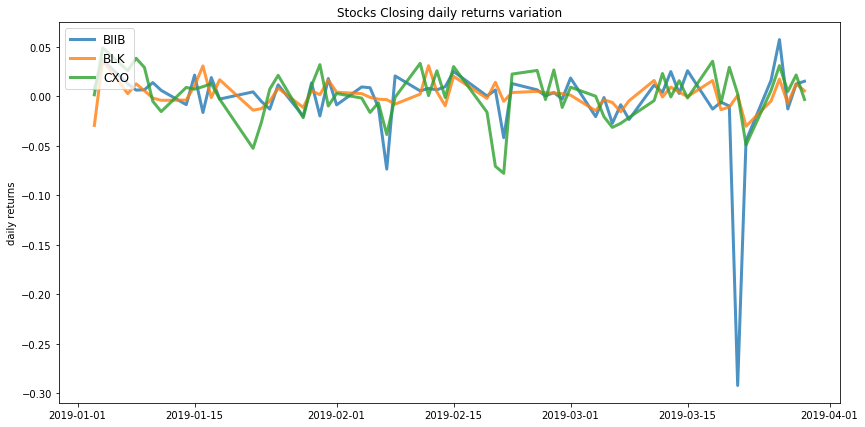

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.11
Annualised Volatility: 0.1


            BIIB    BLK  CXO
allocation   0.0  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.1


            BIIB    BLK   CXO
allocation  2.32  94.77  2.91


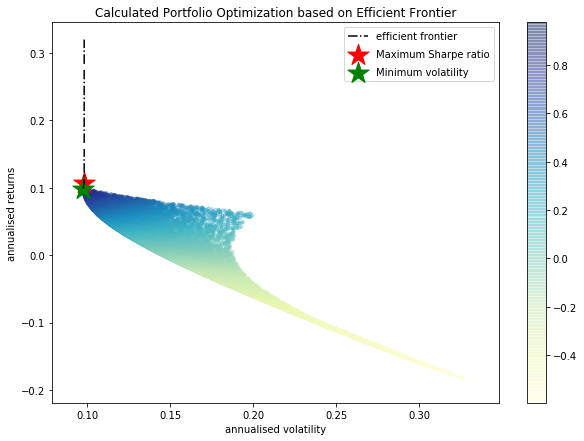

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BIIB : annuaised return -0.19 , annualised volatility: 0.33
BLK : annuaised return 0.11 , annualised volatility: 0.1
CXO : annuaised return 0.06 , annualised volatility: 0.2
--------------------------------------------------------------------------------


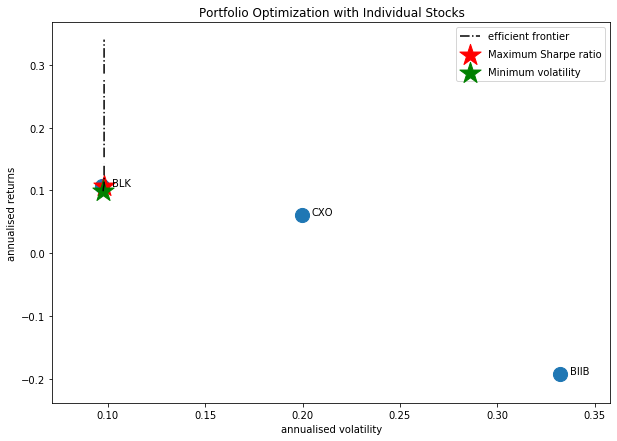

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CXO', 'AZO']


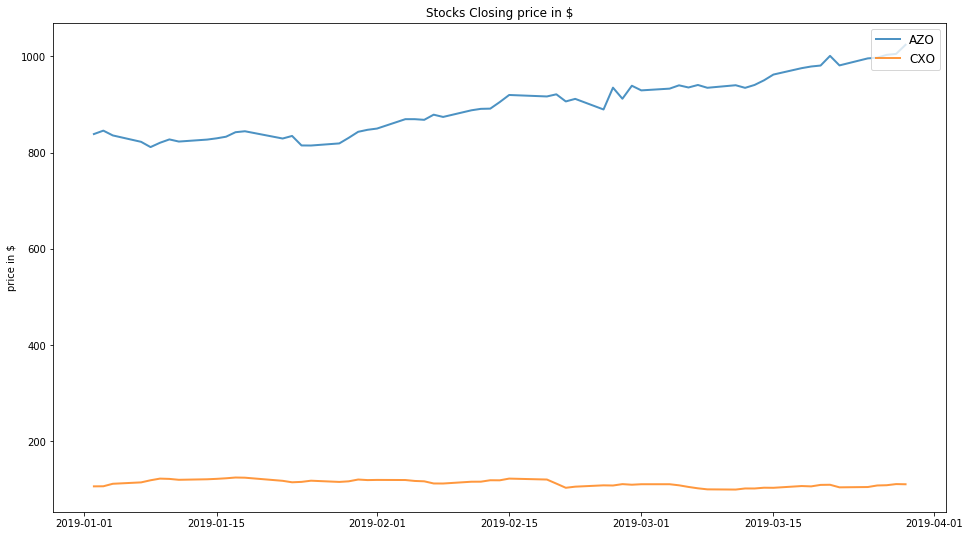

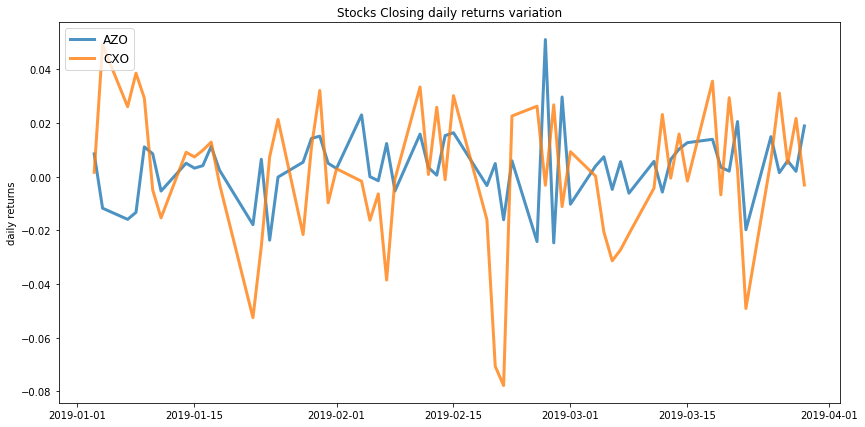

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.2
Annualised Volatility: 0.1


              AZO   CXO
allocation  96.64  3.36
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.18
Annualised Volatility: 0.1


              AZO    CXO
allocation  80.52  19.48


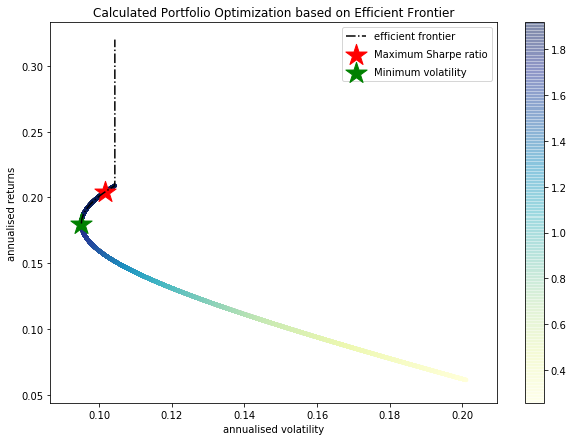

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.21 , annualised volatility: 0.1
CXO : annuaised return 0.06 , annualised volatility: 0.2
--------------------------------------------------------------------------------


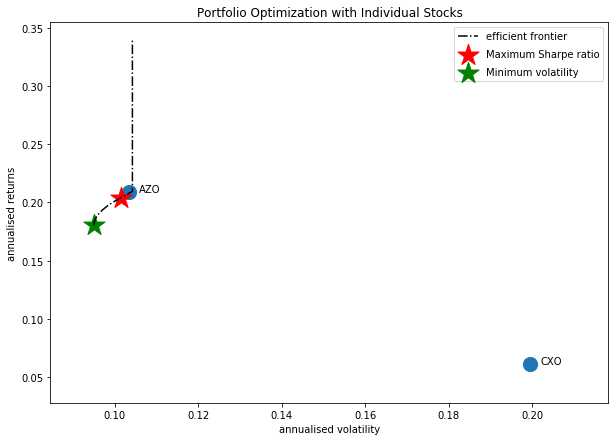

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMD', 'CXO']


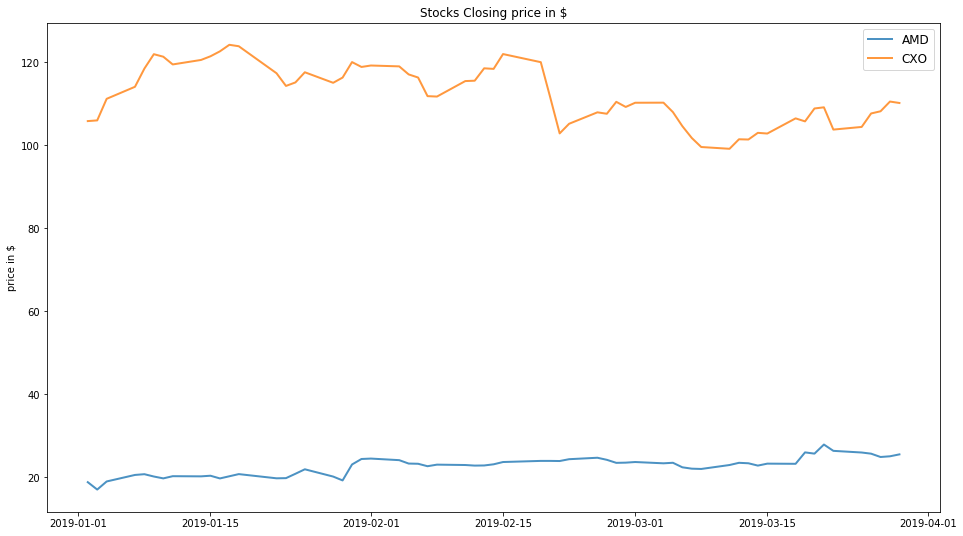

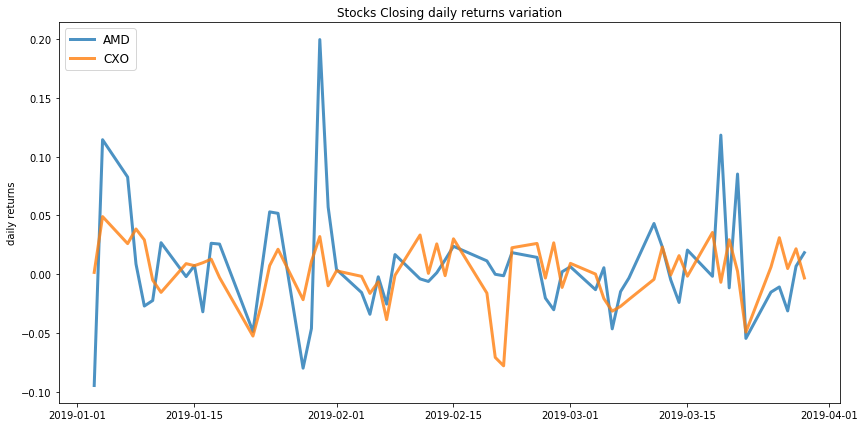

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.37
Annualised Volatility: 0.36


              AMD  CXO
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.2


              AMD    CXO
allocation  13.56  86.44


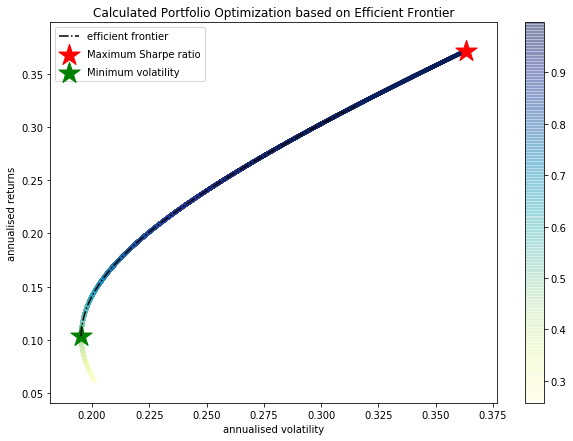

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 0.37 , annualised volatility: 0.36
CXO : annuaised return 0.06 , annualised volatility: 0.2
--------------------------------------------------------------------------------


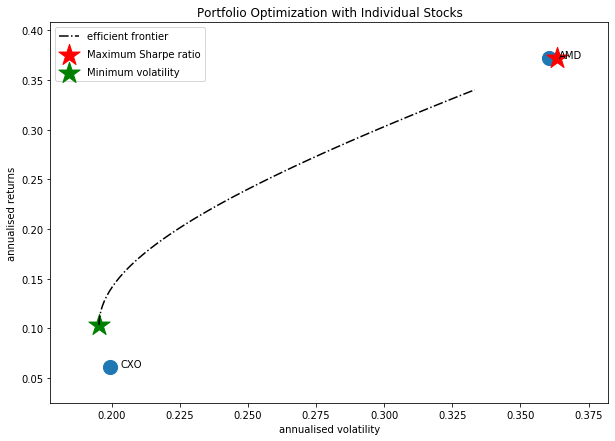

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CMG', 'AZO']


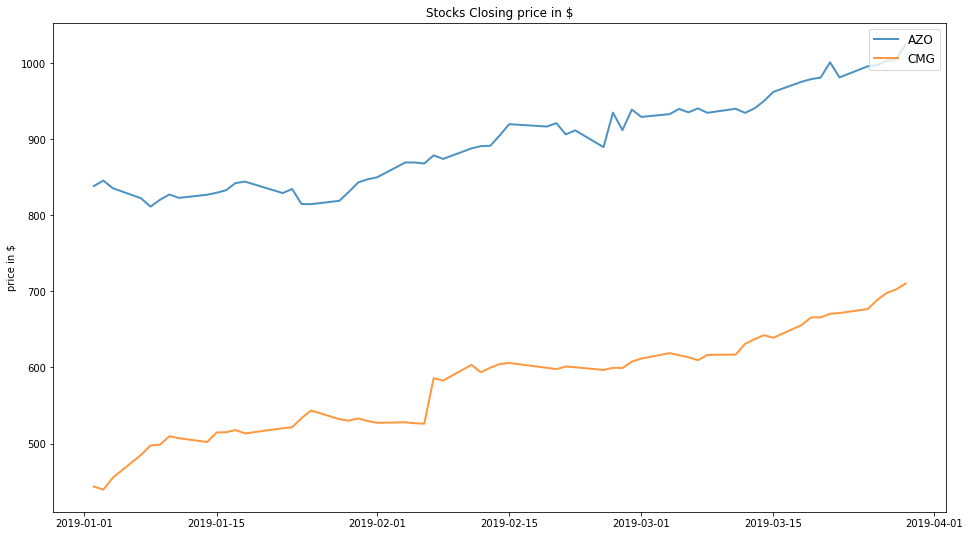

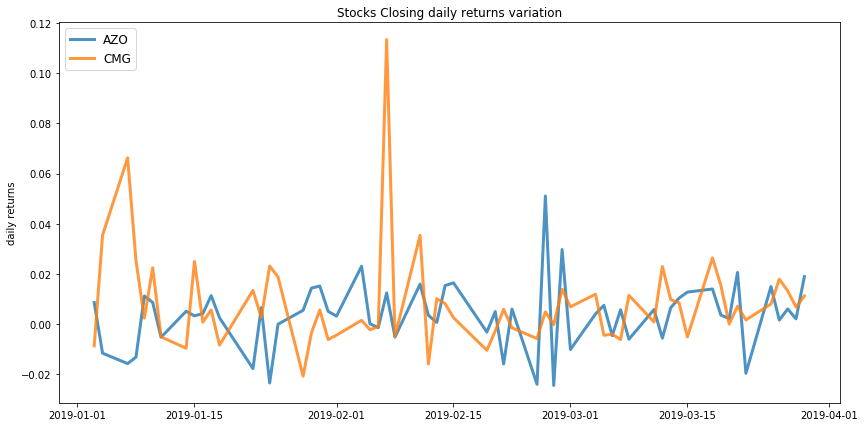

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.36
Annualised Volatility: 0.09


              AZO    CMG
allocation  48.45  51.55
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.3
Annualised Volatility: 0.09


             AZO   CMG
allocation  68.3  31.7


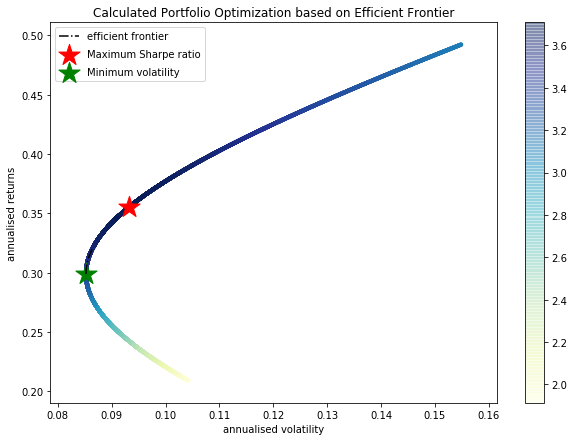

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.21 , annualised volatility: 0.1
CMG : annuaised return 0.49 , annualised volatility: 0.15
--------------------------------------------------------------------------------


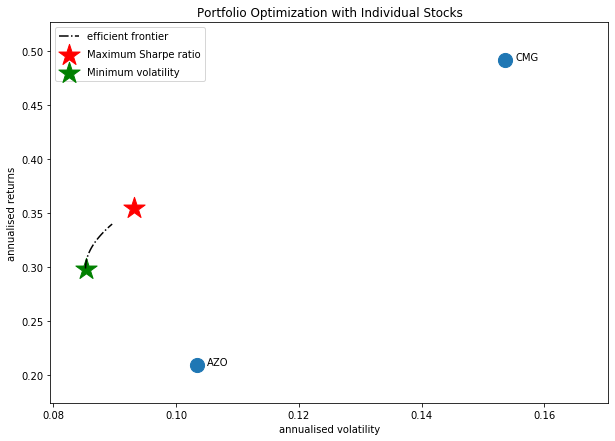

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BIIB', 'AYI']


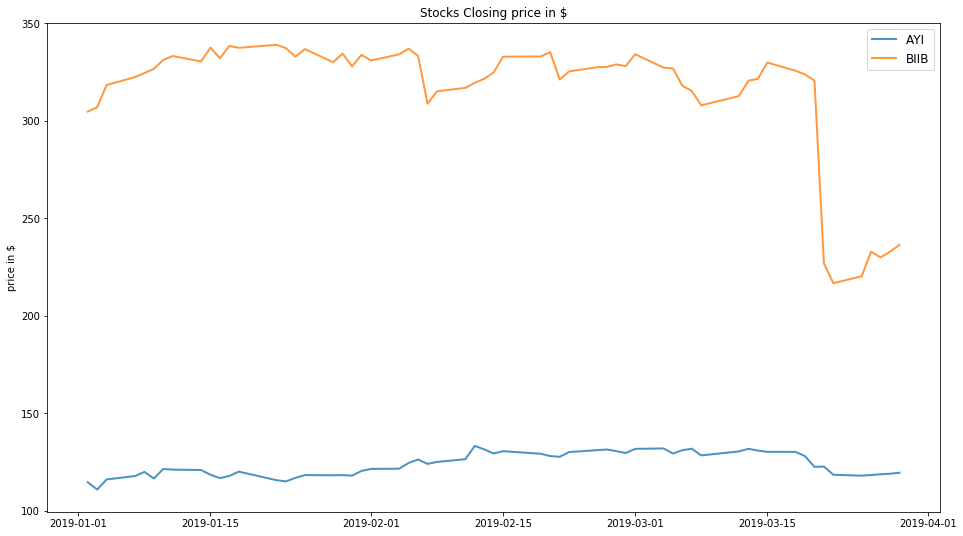

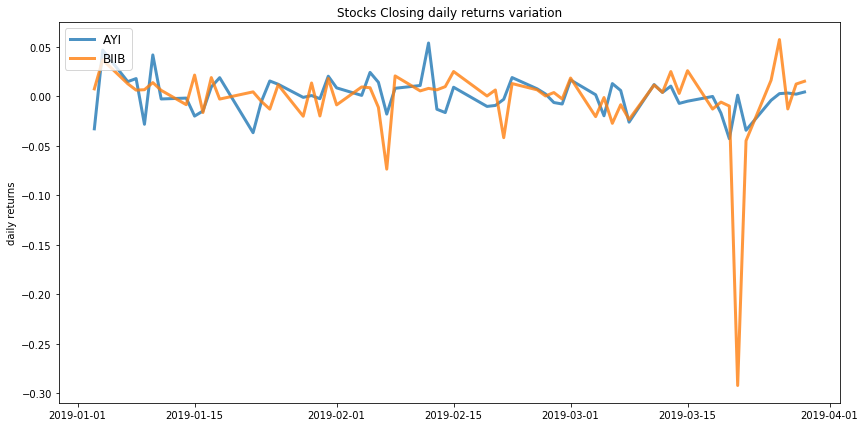

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.15


              AYI  BIIB
allocation  100.0   0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.03
Annualised Volatility: 0.14


              AYI   BIIB
allocation  88.73  11.27


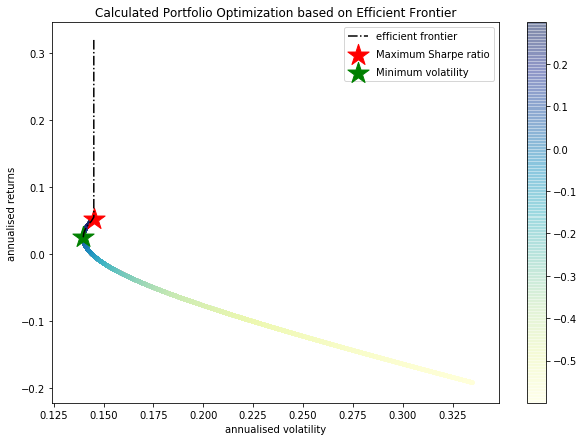

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AYI : annuaised return 0.05 , annualised volatility: 0.14
BIIB : annuaised return -0.19 , annualised volatility: 0.33
--------------------------------------------------------------------------------


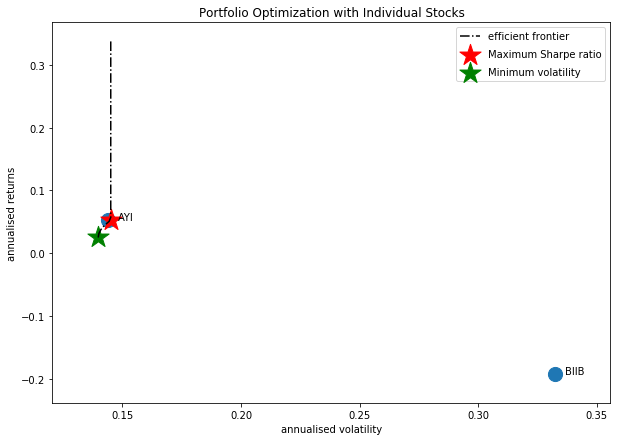

Companies listed in quarter 5 which is between 2019-04-01 and 2019-07-01
['SHW' 'BKNG' 'EQIX' 'MMM' 'AMZN' 'ABC' 'AZO' 'APC' 'HST']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['SHW', 'BKNG', 'MMM', 'ABC']


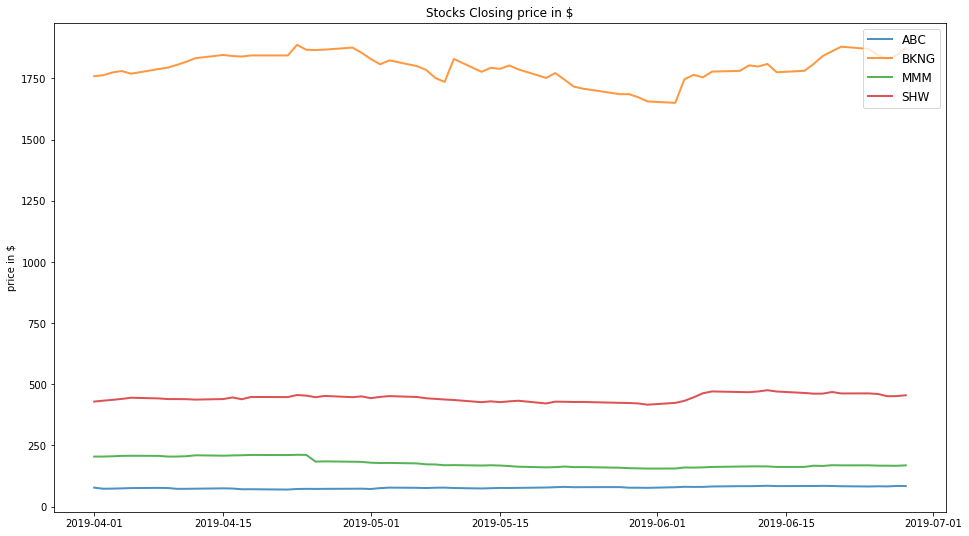

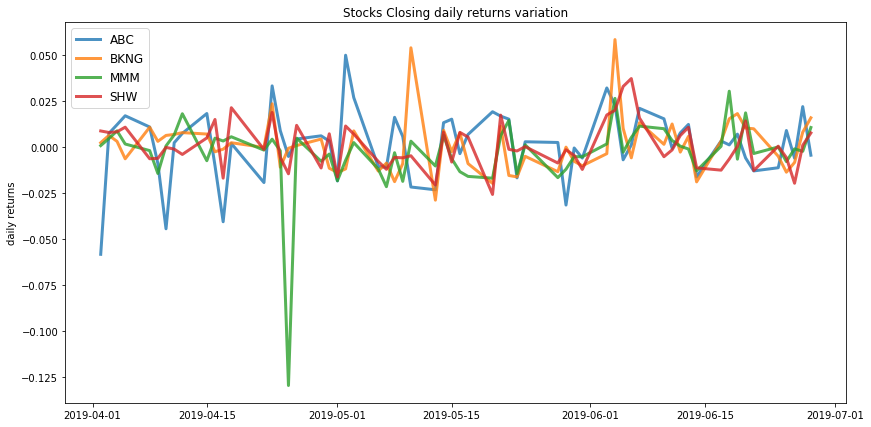

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.09


              ABC  BKNG  MMM    SHW
allocation  33.15  36.3  0.0  30.54
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.08


              ABC   BKNG   MMM    SHW
allocation  19.13  30.24  9.31  41.33


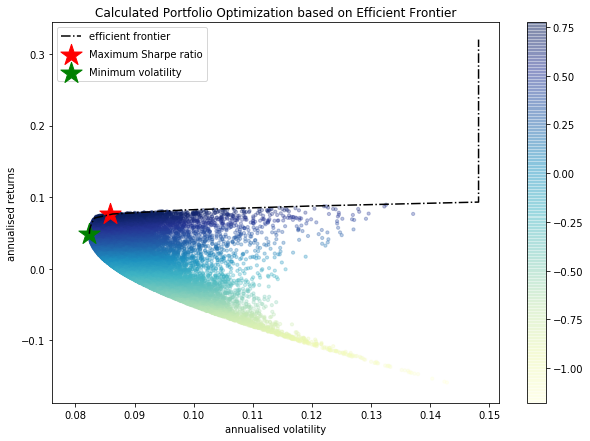

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.09 , annualised volatility: 0.15
BKNG : annuaised return 0.07 , annualised volatility: 0.12
MMM : annuaised return -0.18 , annualised volatility: 0.15
SHW : annuaised return 0.06 , annualised volatility: 0.1
--------------------------------------------------------------------------------


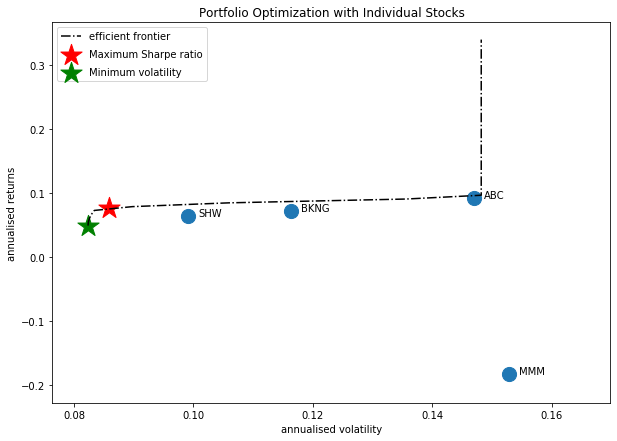

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['SHW', 'EQIX', 'MMM', 'AMZN']


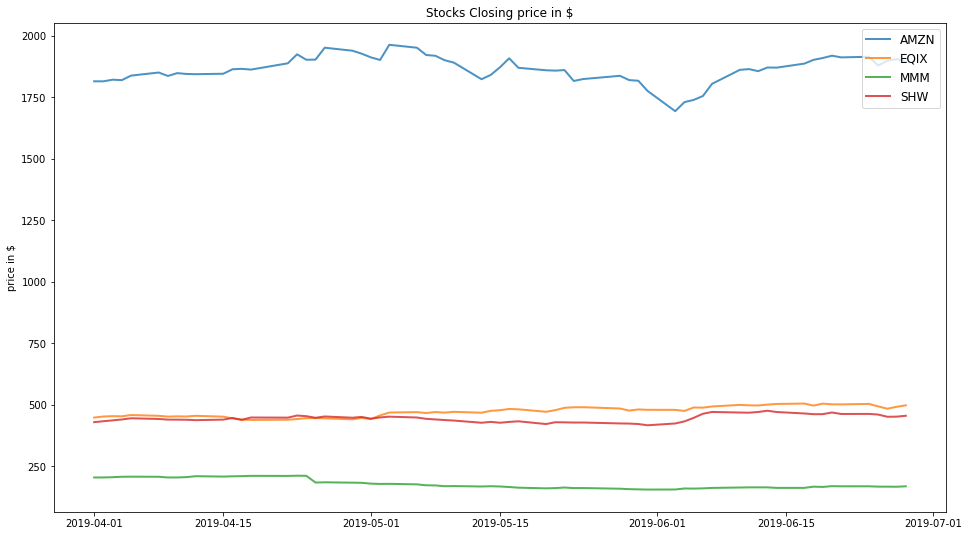

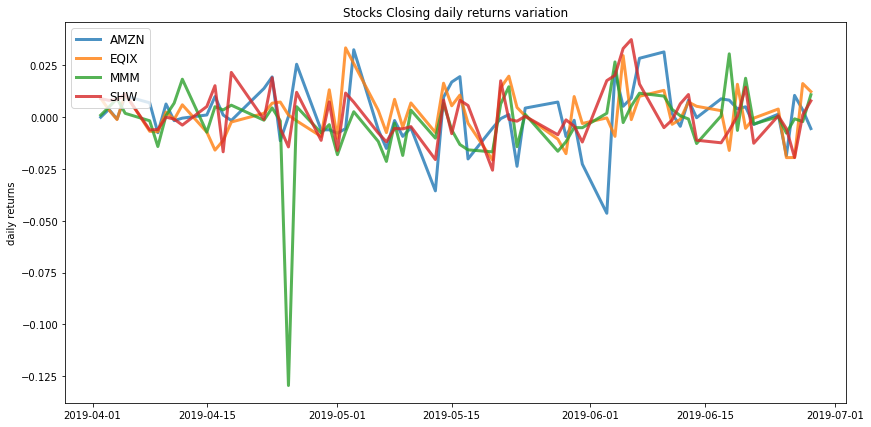

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.09


            AMZN   EQIX  MMM   SHW
allocation  5.23  87.18  0.0  7.59
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.07


             AMZN  EQIX    MMM    SHW
allocation  23.66  43.0  10.58  22.75


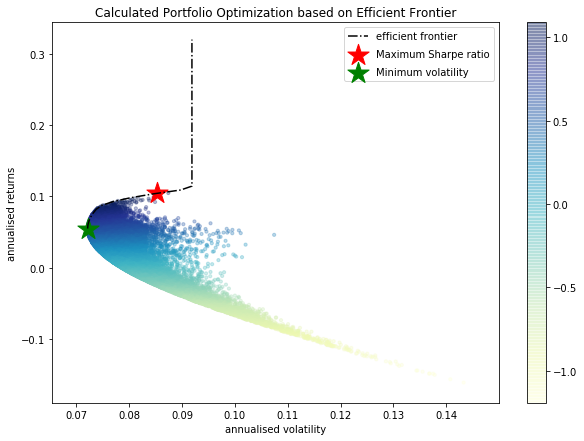

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.05 , annualised volatility: 0.11
EQIX : annuaised return 0.11 , annualised volatility: 0.09
MMM : annuaised return -0.18 , annualised volatility: 0.15
SHW : annuaised return 0.06 , annualised volatility: 0.1
--------------------------------------------------------------------------------


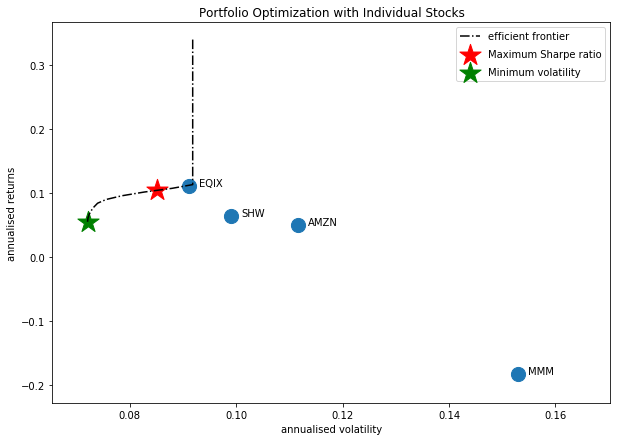

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['SHW', 'BKNG', 'EQIX', 'MMM', 'ABC', 'AZO']


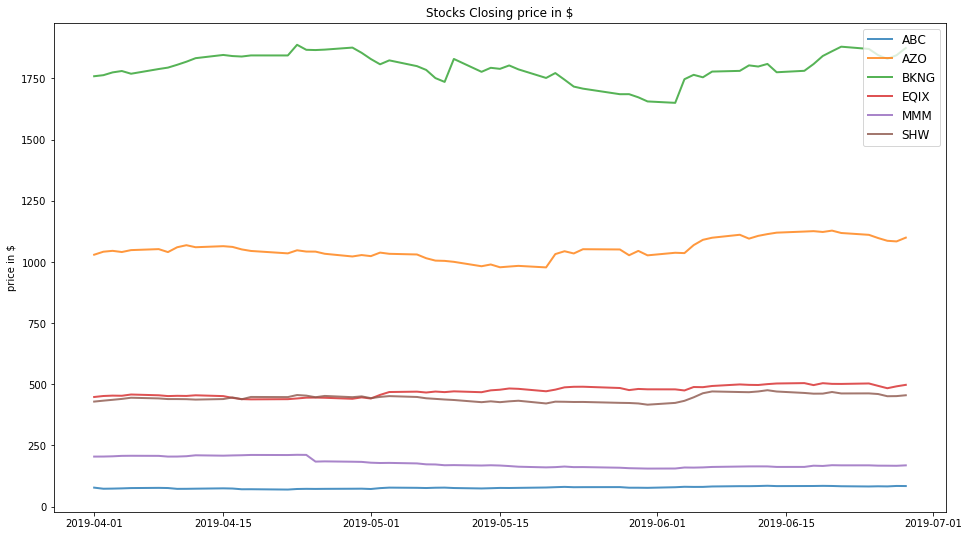

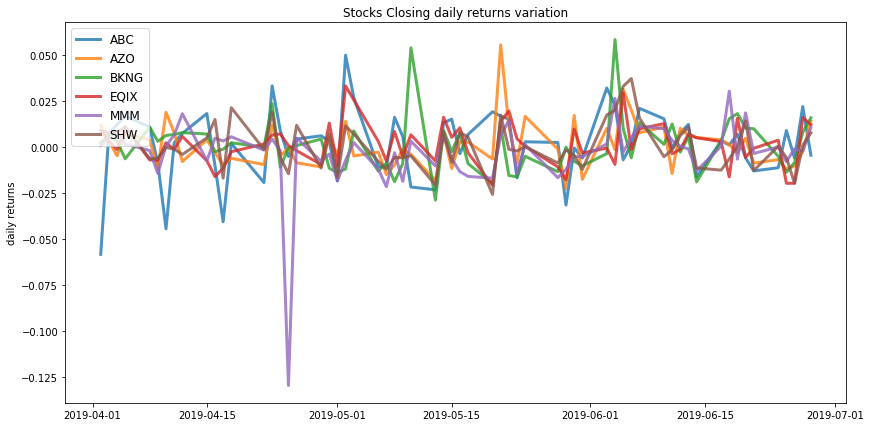

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.08


             ABC  AZO   BKNG   EQIX  MMM  SHW
allocation  9.58  0.0  21.35  69.07  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.06
Annualised Volatility: 0.07


             ABC    AZO   BKNG   EQIX   MMM   SHW
allocation  8.47  17.71  22.71  35.76  8.87  6.48


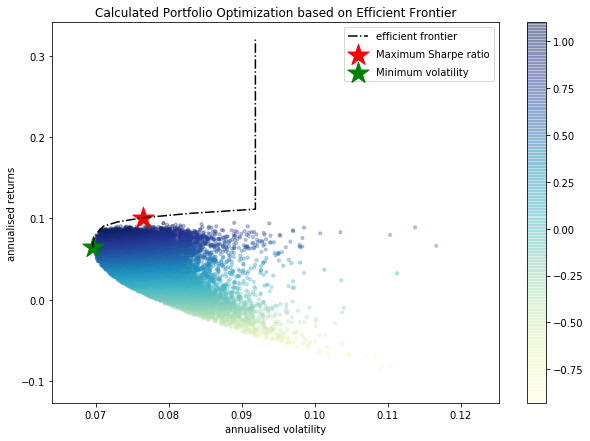

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.09 , annualised volatility: 0.15
AZO : annuaised return 0.07 , annualised volatility: 0.1
BKNG : annuaised return 0.07 , annualised volatility: 0.12
EQIX : annuaised return 0.11 , annualised volatility: 0.09
MMM : annuaised return -0.18 , annualised volatility: 0.15
SHW : annuaised return 0.06 , annualised volatility: 0.1
--------------------------------------------------------------------------------


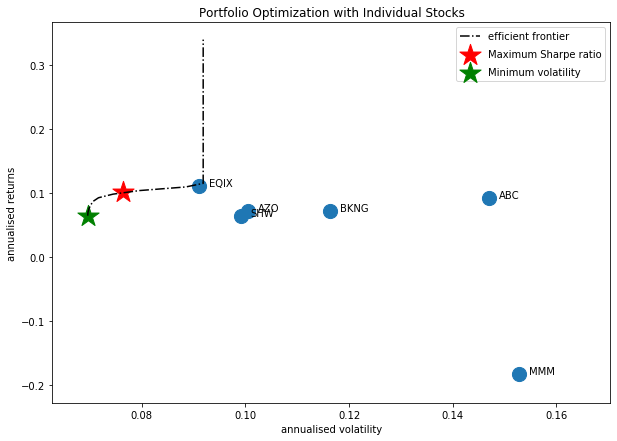

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'MMM', 'ABC']


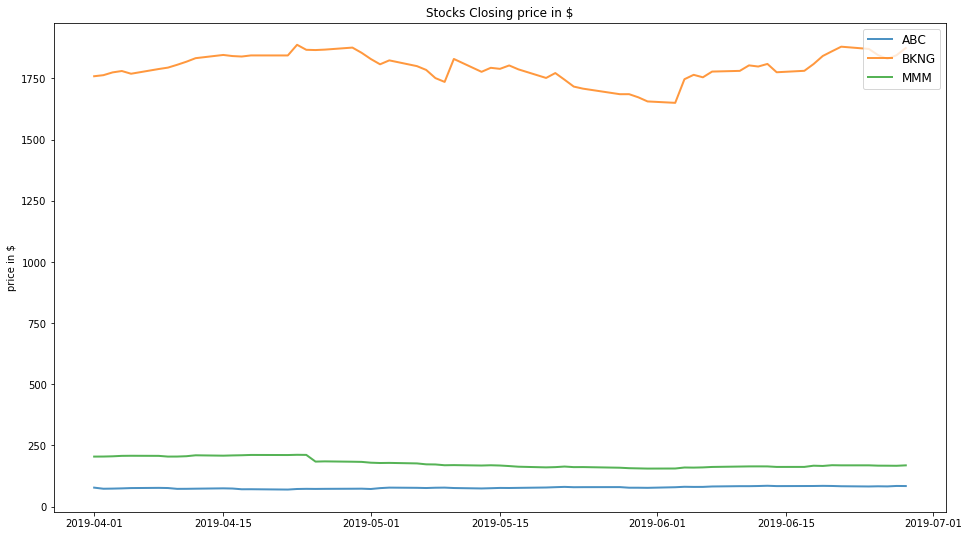

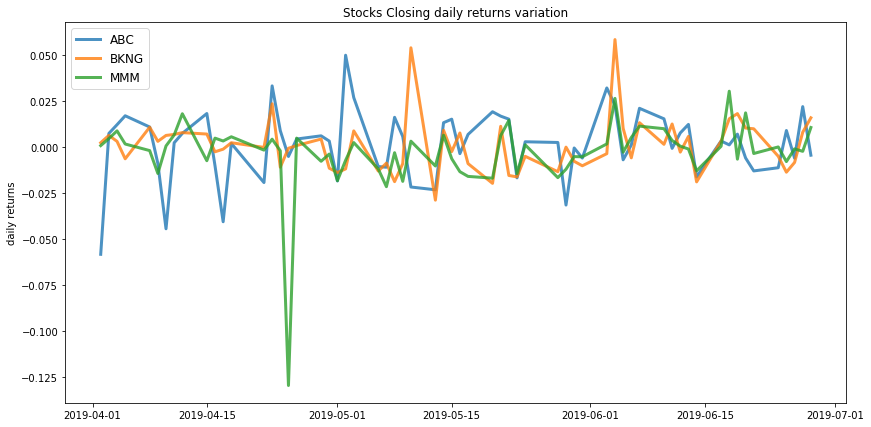

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.1


              ABC   BKNG  MMM
allocation  45.98  54.02  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.03
Annualised Volatility: 0.09


             ABC   BKNG    MMM
allocation  31.7  49.14  19.16


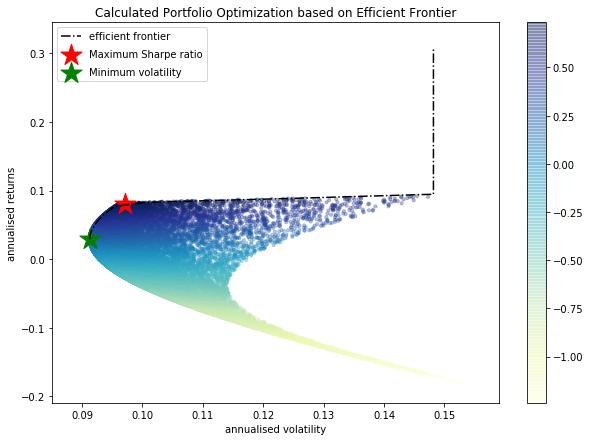

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.09 , annualised volatility: 0.15
BKNG : annuaised return 0.07 , annualised volatility: 0.12
MMM : annuaised return -0.18 , annualised volatility: 0.15
--------------------------------------------------------------------------------


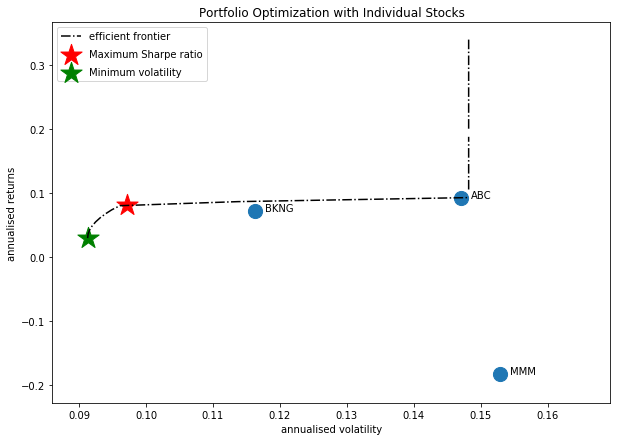

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'APC']


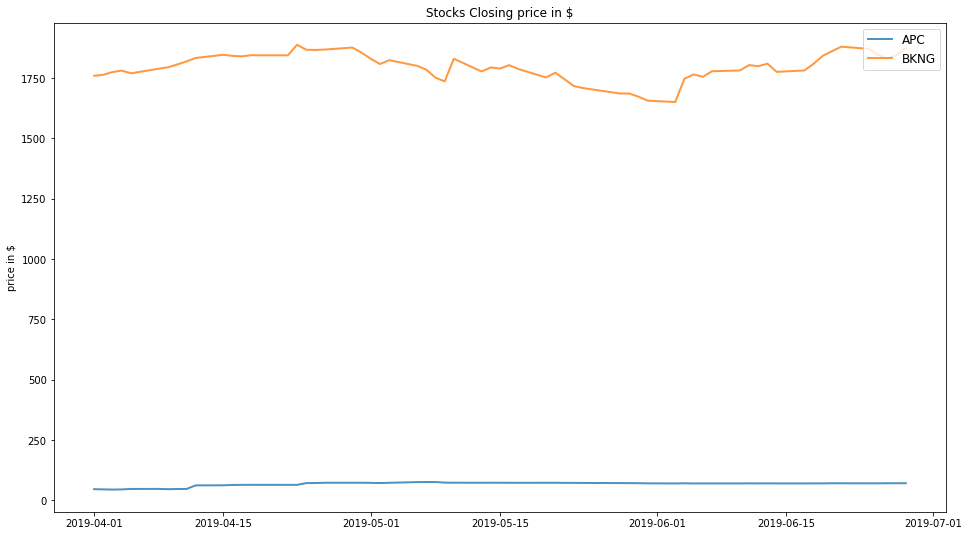

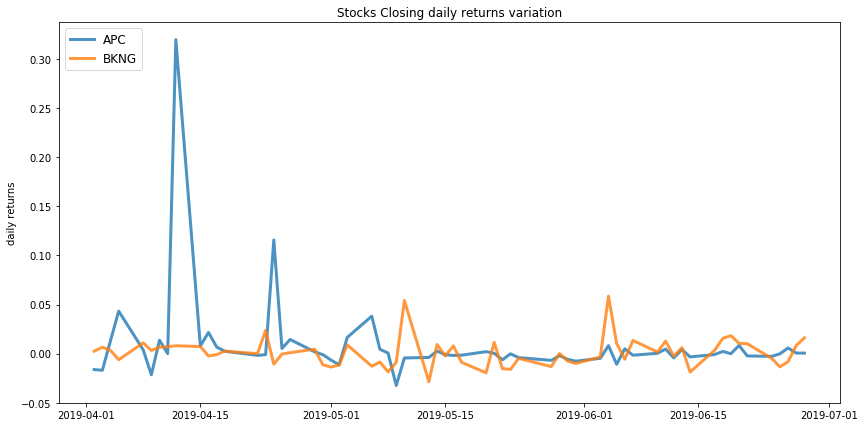

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.28
Annualised Volatility: 0.18


              APC   BKNG
allocation  48.35  51.65
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.11
Annualised Volatility: 0.11


             APC   BKNG
allocation  9.13  90.87


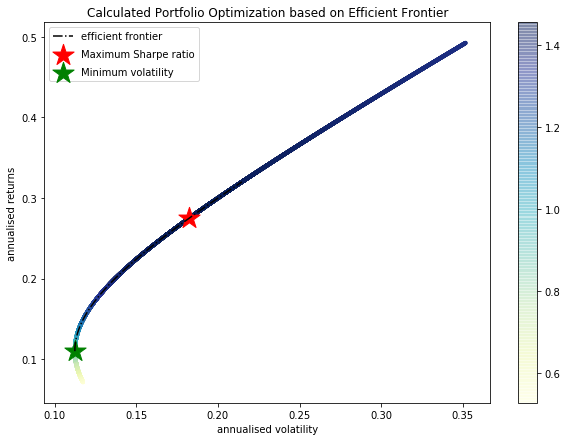

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

APC : annuaised return 0.49 , annualised volatility: 0.35
BKNG : annuaised return 0.07 , annualised volatility: 0.12
--------------------------------------------------------------------------------


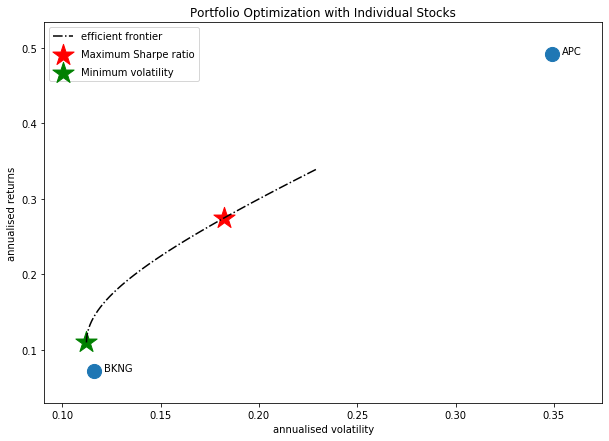

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'MMM', 'ABC']


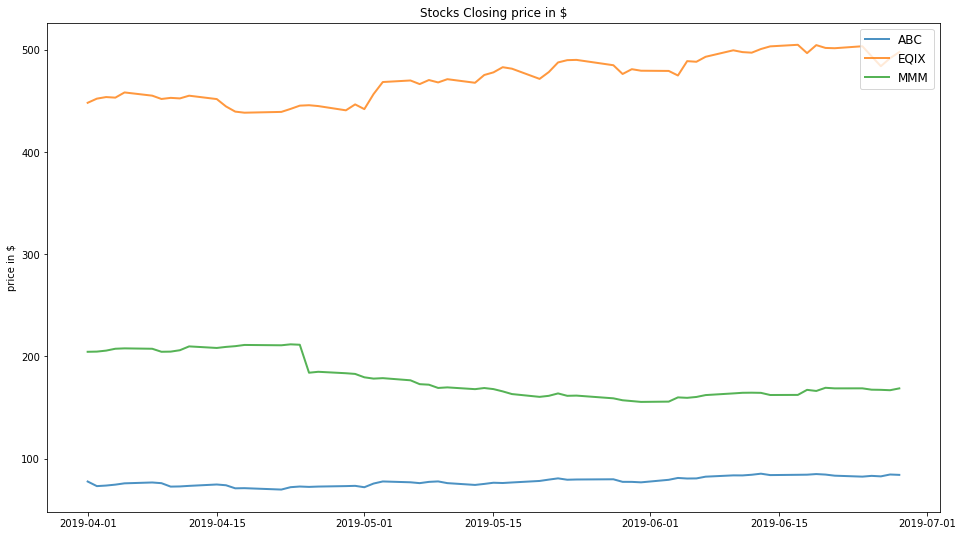

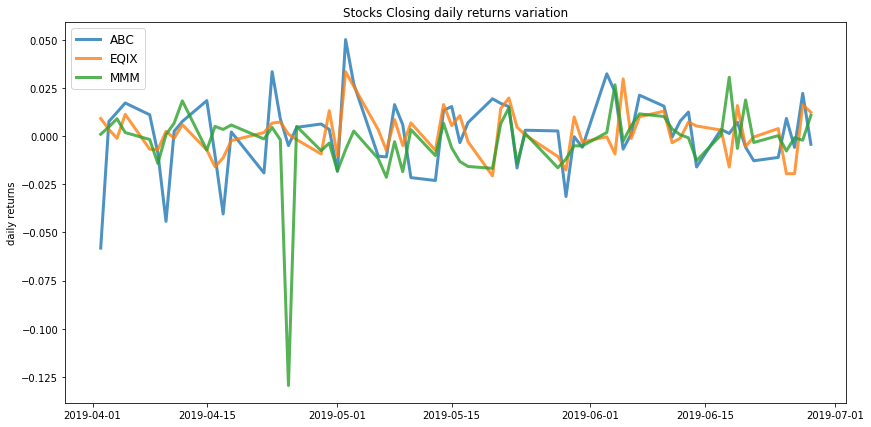

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.11
Annualised Volatility: 0.09


              ABC   EQIX  MMM
allocation  12.79  87.21  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.04
Annualised Volatility: 0.08


              ABC  EQIX    MMM
allocation  13.32  65.0  21.68


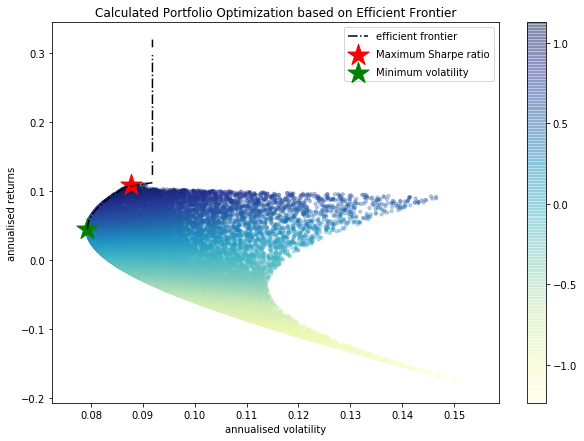

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.09 , annualised volatility: 0.15
EQIX : annuaised return 0.11 , annualised volatility: 0.09
MMM : annuaised return -0.18 , annualised volatility: 0.15
--------------------------------------------------------------------------------


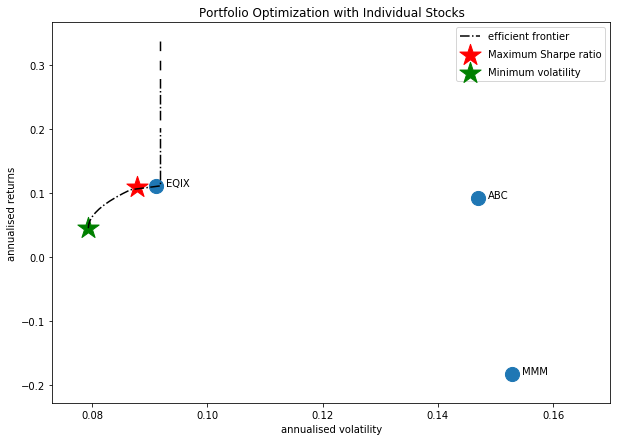

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'EQIX', 'MMM', 'ABC']


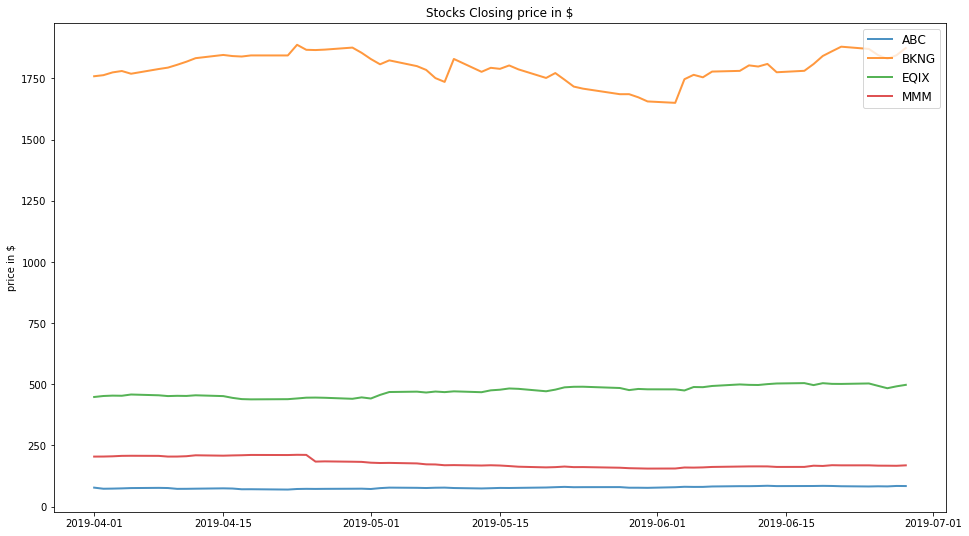

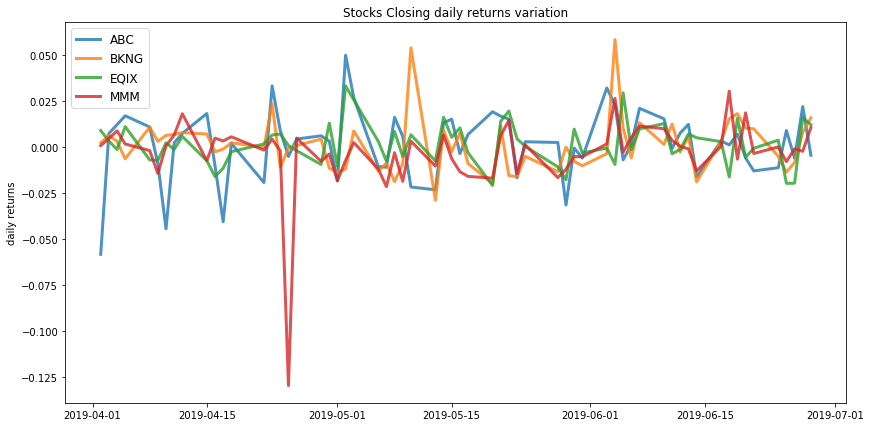

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.08


             ABC   BKNG   EQIX  MMM
allocation  9.54  21.34  69.12  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.06
Annualised Volatility: 0.07


              ABC   BKNG  EQIX    MMM
allocation  10.37  27.14  50.8  11.69


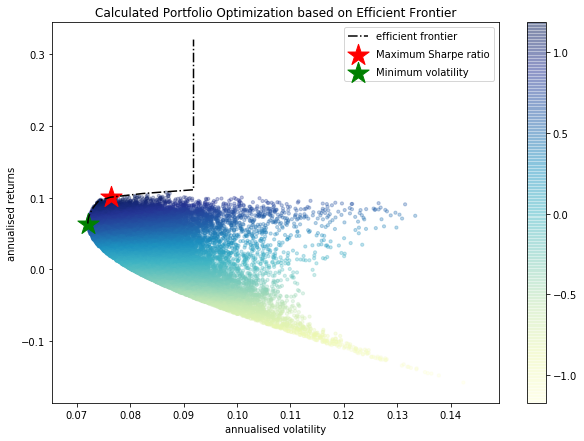

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.09 , annualised volatility: 0.15
BKNG : annuaised return 0.07 , annualised volatility: 0.12
EQIX : annuaised return 0.11 , annualised volatility: 0.09
MMM : annuaised return -0.18 , annualised volatility: 0.15
--------------------------------------------------------------------------------


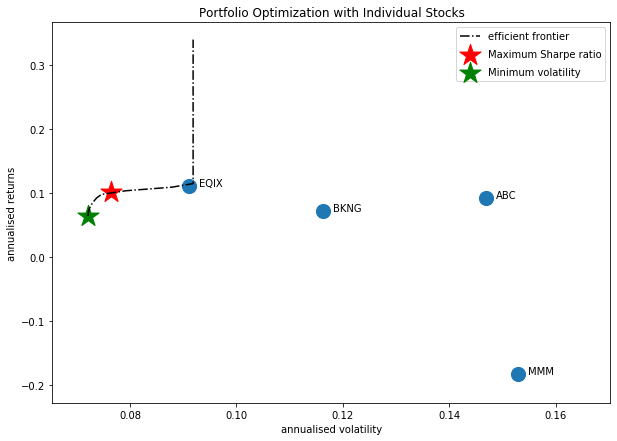

Companies listed in quarter 6 which is between 2019-07-01 and 2019-10-01
['BKNG' 'EQIX' 'AMGN' 'ANTM' 'BLK' 'ECL' 'CMG' 'DHI' 'AMD']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'ECL']


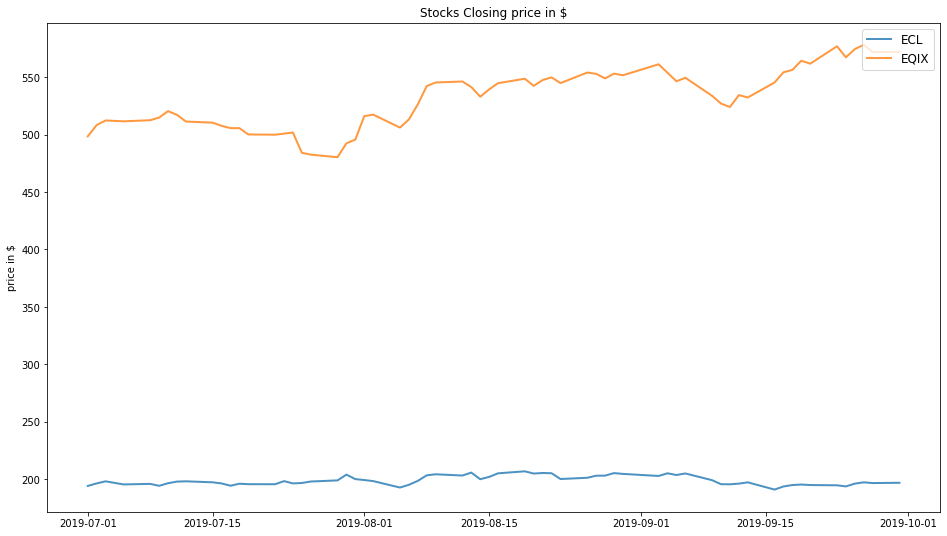

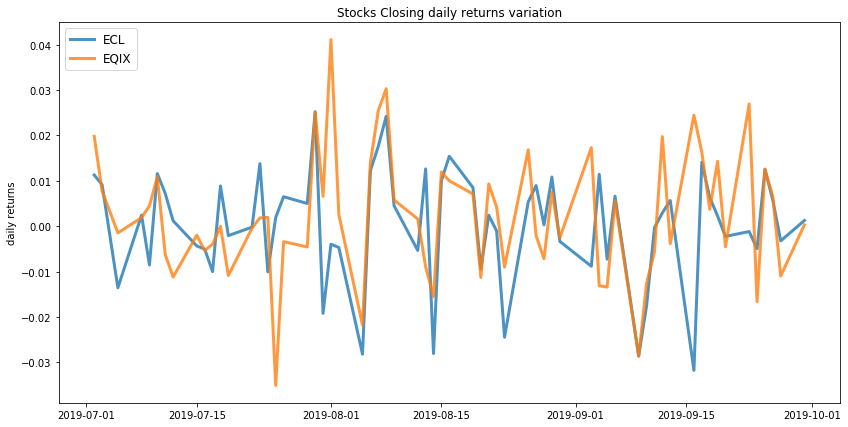

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.15
Annualised Volatility: 0.11


            ECL   EQIX
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.09


              ECL   EQIX
allocation  61.59  38.41


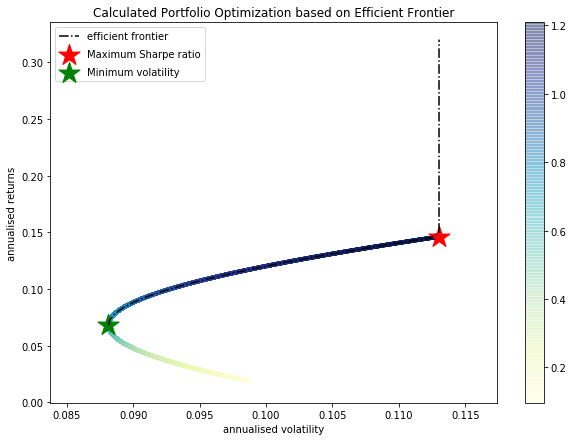

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ECL : annuaised return 0.02 , annualised volatility: 0.1
EQIX : annuaised return 0.15 , annualised volatility: 0.11
--------------------------------------------------------------------------------


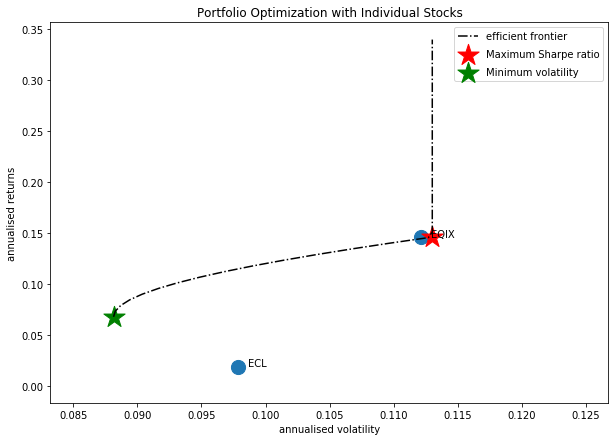

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'CMG']


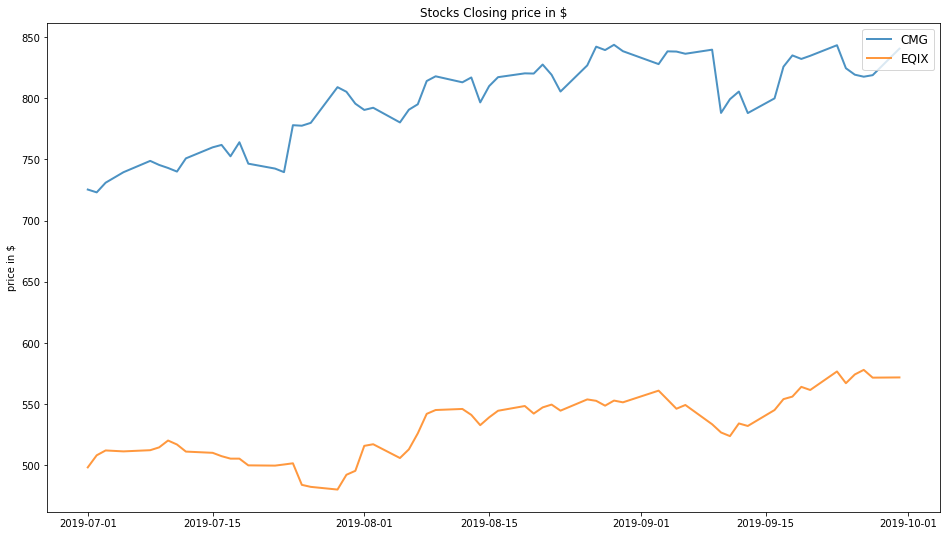

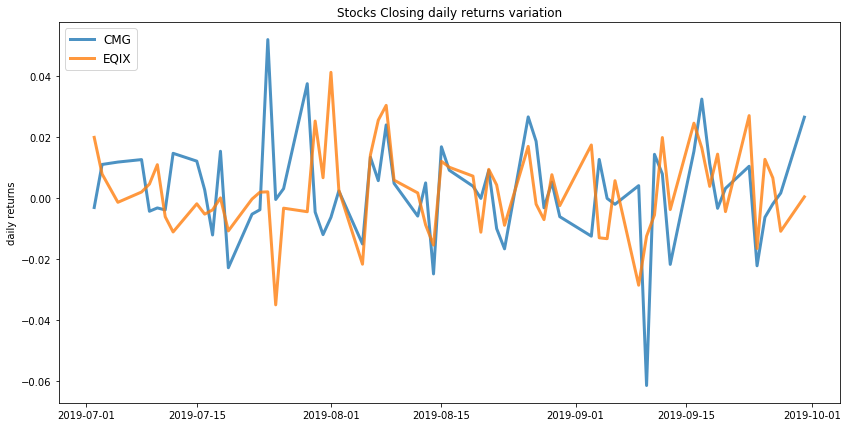

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.15
Annualised Volatility: 0.1


              CMG   EQIX
allocation  42.91  57.09
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.15
Annualised Volatility: 0.1


              CMG   EQIX
allocation  39.26  60.74


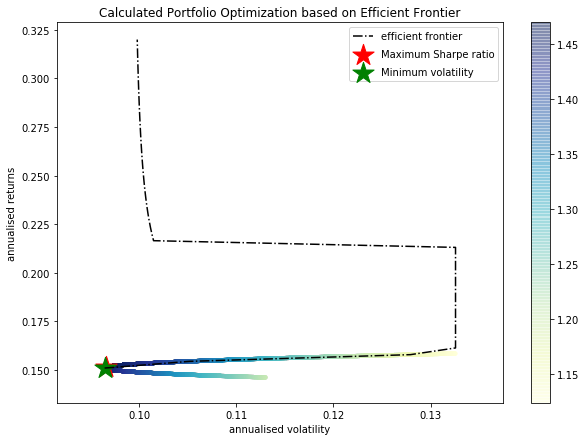

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

CMG : annuaised return 0.16 , annualised volatility: 0.13
EQIX : annuaised return 0.15 , annualised volatility: 0.11
--------------------------------------------------------------------------------


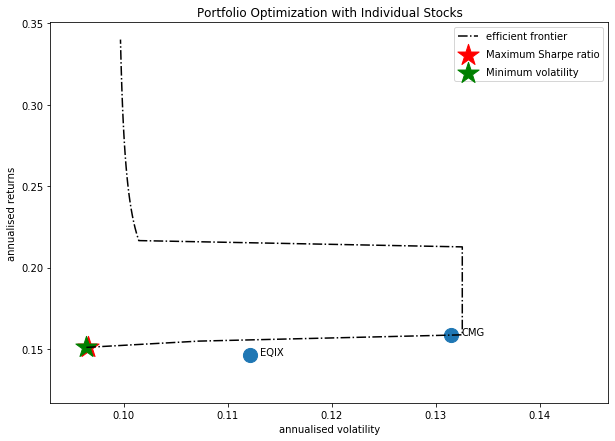

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMGN', 'ECL']


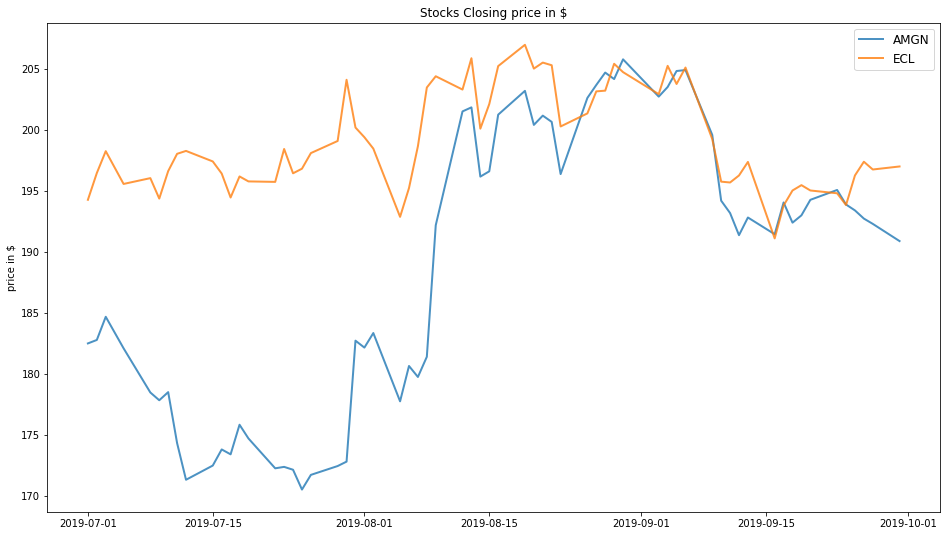

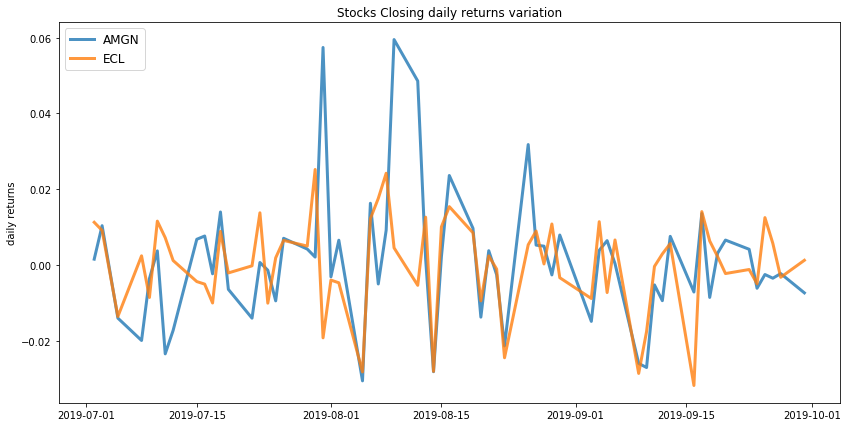

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.14


             AMGN  ECL
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.03
Annualised Volatility: 0.09


             AMGN    ECL
allocation  26.86  73.14


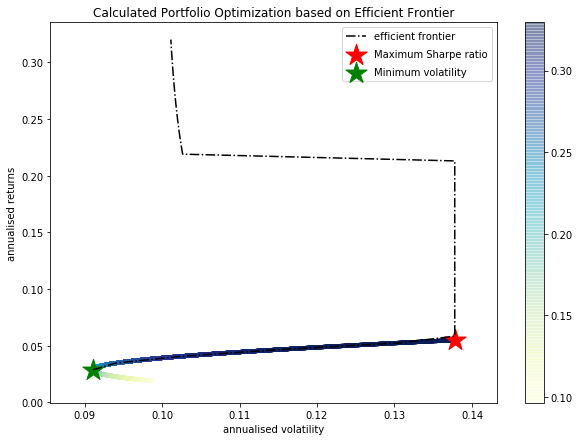

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.05 , annualised volatility: 0.14
ECL : annuaised return 0.02 , annualised volatility: 0.1
--------------------------------------------------------------------------------


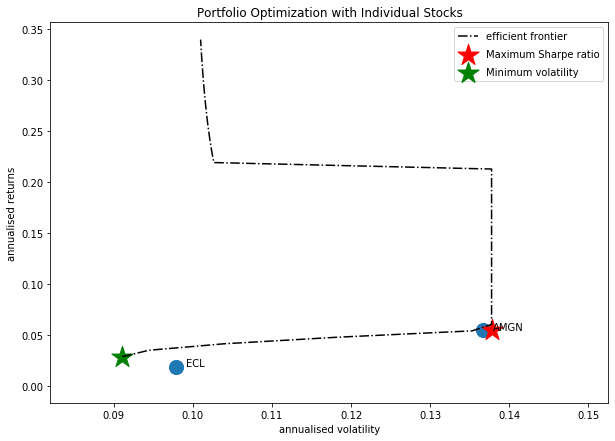

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMGN', 'CMG']


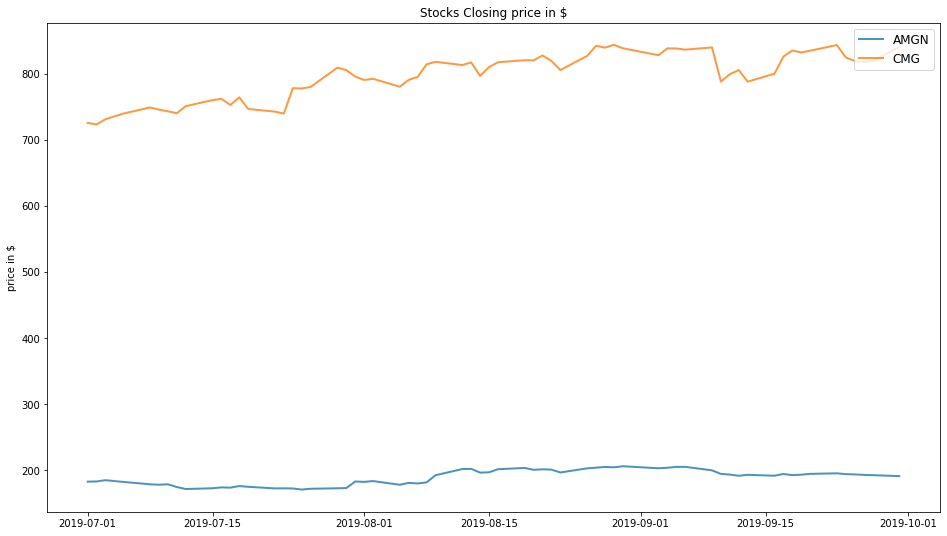

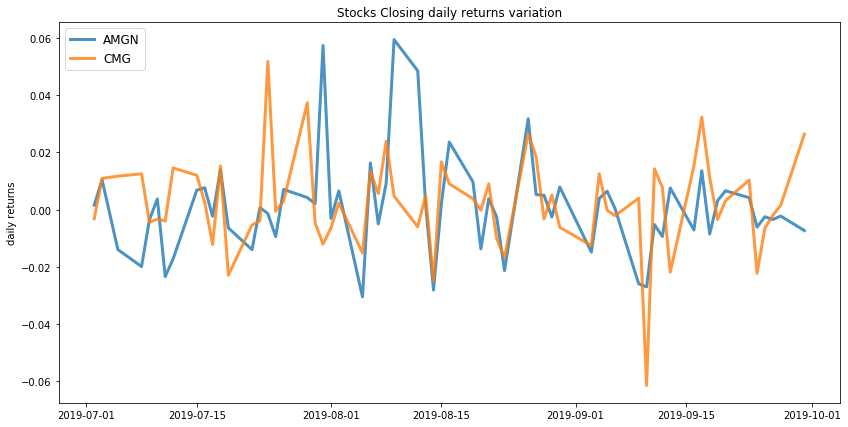

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.15
Annualised Volatility: 0.13


            AMGN    CMG
allocation  5.01  94.99
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.11
Annualised Volatility: 0.11


             AMGN    CMG
allocation  47.46  52.54


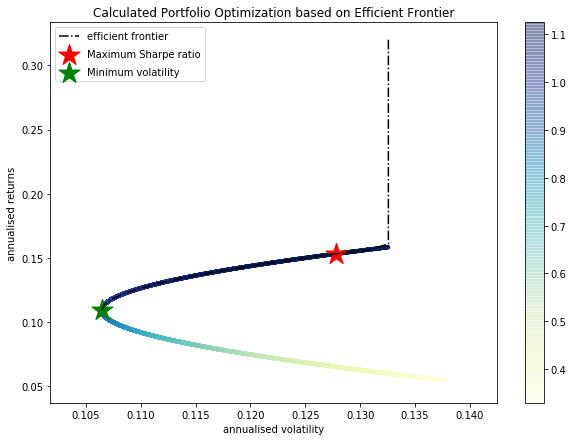

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.05 , annualised volatility: 0.14
CMG : annuaised return 0.16 , annualised volatility: 0.13
--------------------------------------------------------------------------------


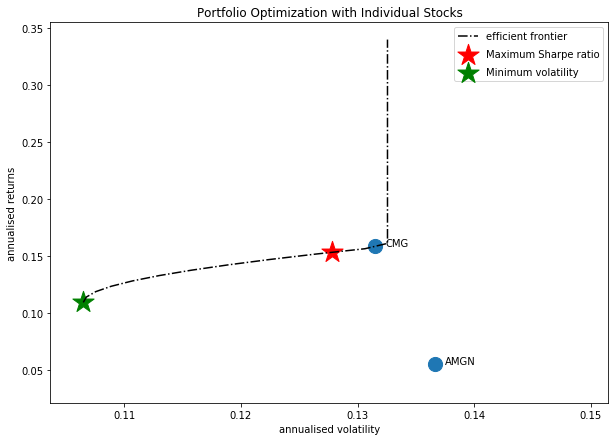

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ANTM', 'ECL']


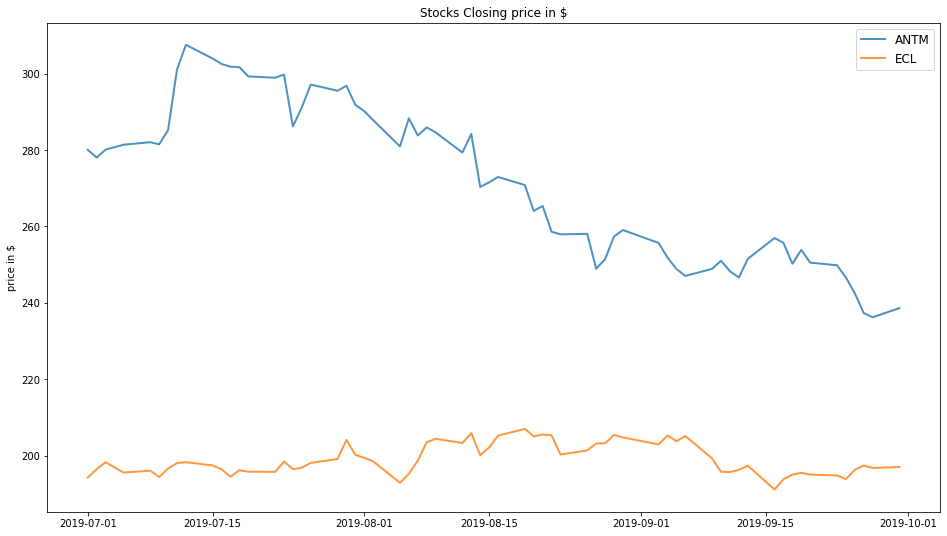

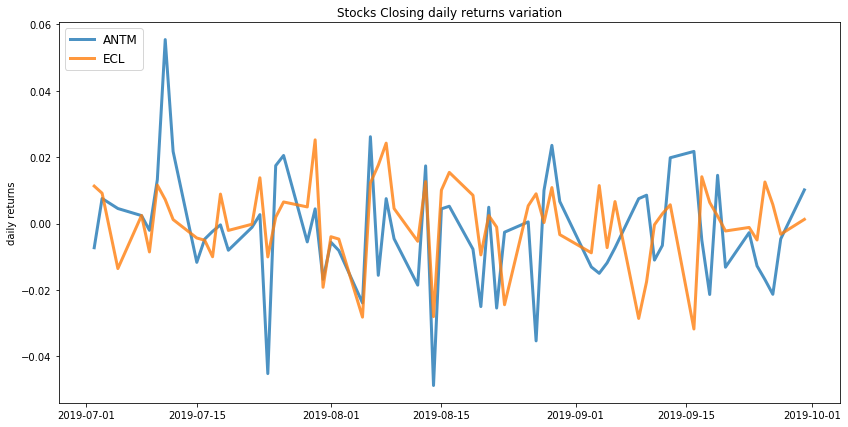

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.02
Annualised Volatility: 0.1


            ANTM    ECL
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.03
Annualised Volatility: 0.09


             ANTM    ECL
allocation  28.59  71.41


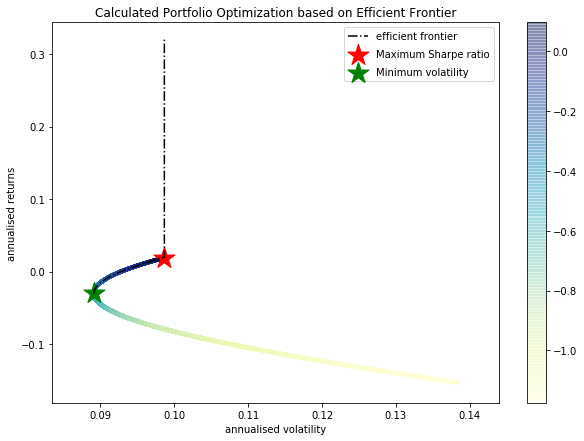

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ANTM : annuaised return -0.15 , annualised volatility: 0.14
ECL : annuaised return 0.02 , annualised volatility: 0.1
--------------------------------------------------------------------------------


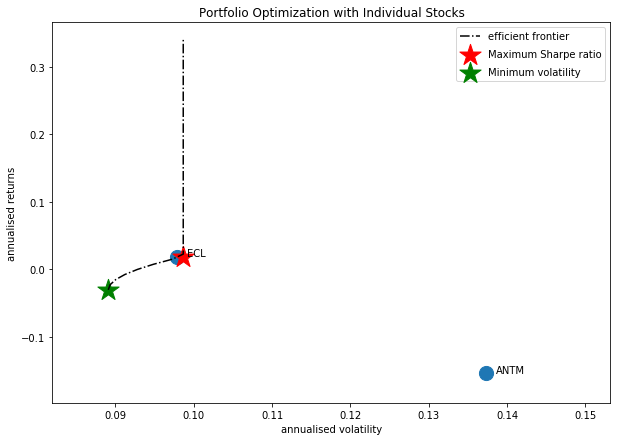

Companies listed in quarter 7 which is between 2019-10-01 and 2020-01-01
['AAPL' 'EQIX' 'BIIB' 'BKNG' 'SHW' 'BLK' 'AMD' 'ALXN' 'ALGN' 'GOOGL']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AAPL', 'BIIB', 'SHW', 'BLK']


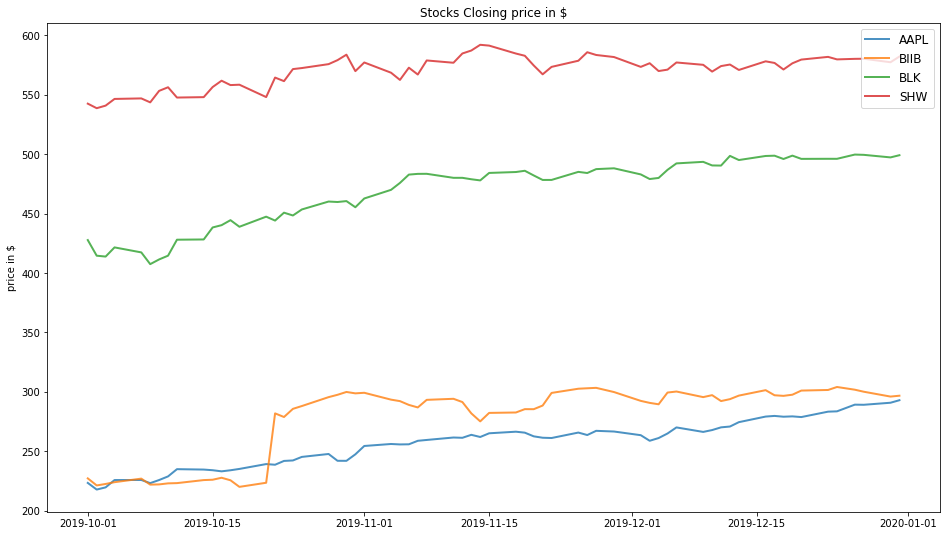

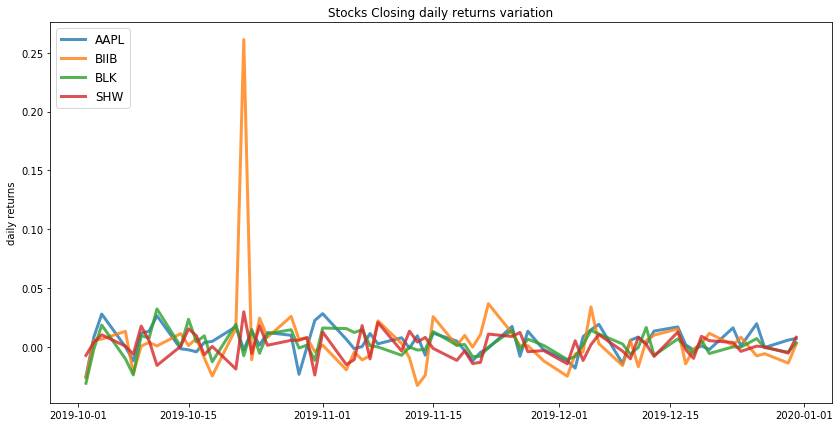

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.25
Annualised Volatility: 0.08


            AAPL  BIIB  BLK    SHW
allocation  78.8  6.08  0.0  15.12
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.16
Annualised Volatility: 0.06


             AAPL  BIIB    BLK    SHW
allocation  32.02   0.0  21.64  46.34


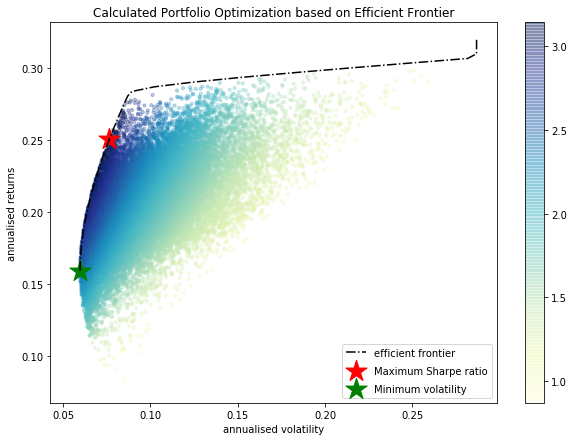

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.28 , annualised volatility: 0.09
BIIB : annuaised return 0.31 , annualised volatility: 0.28
BLK : annuaised return 0.16 , annualised volatility: 0.09
SHW : annuaised return 0.08 , annualised volatility: 0.09
--------------------------------------------------------------------------------


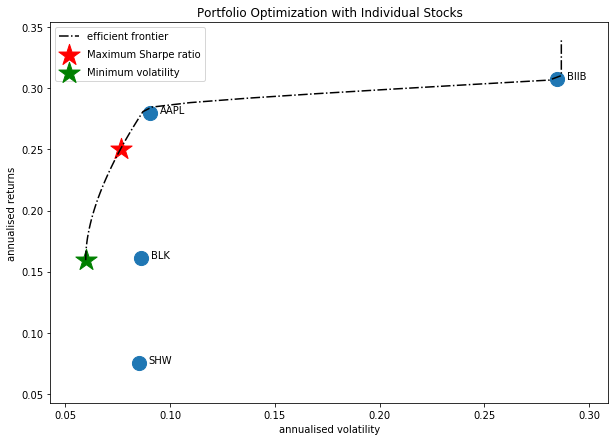

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BIIB', 'SHW', 'BLK']


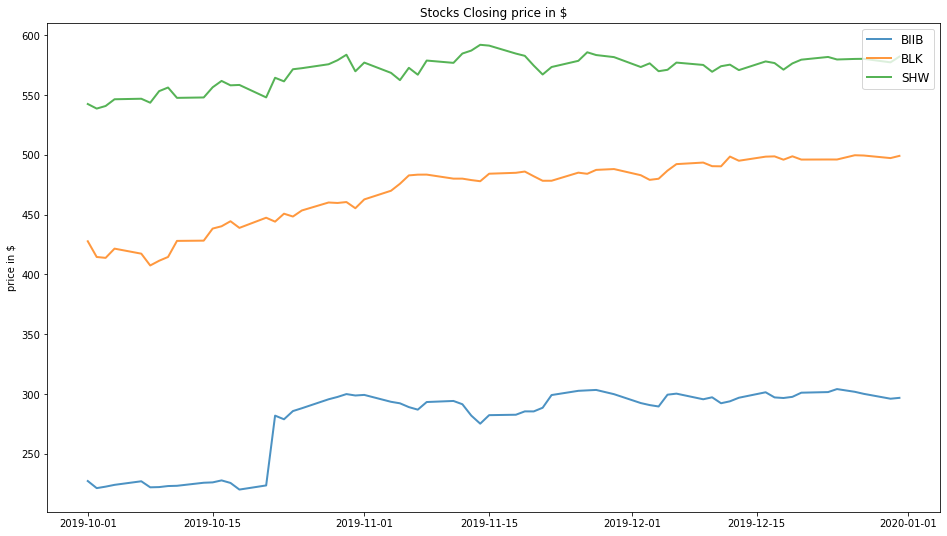

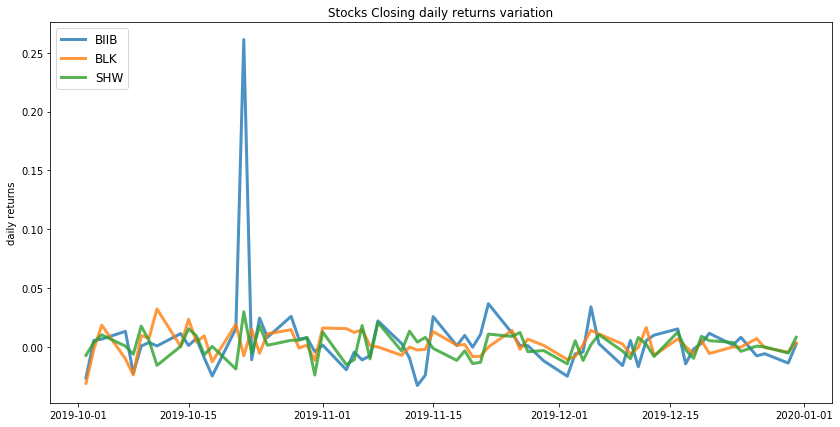

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.08


             BIIB    BLK   SHW
allocation  13.44  79.53  7.03
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.12
Annualised Volatility: 0.07


            BIIB    BLK    SHW
allocation   0.0  49.19  50.81


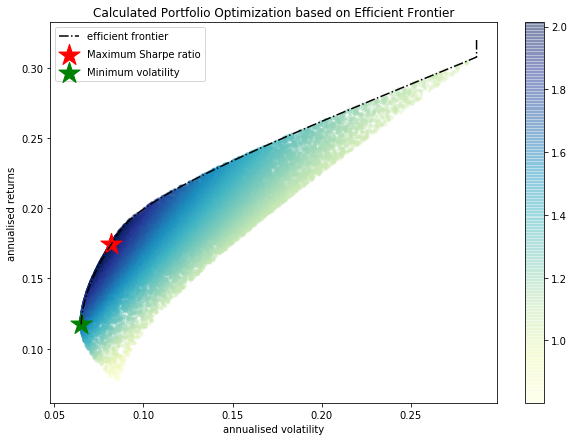

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BIIB : annuaised return 0.31 , annualised volatility: 0.28
BLK : annuaised return 0.16 , annualised volatility: 0.09
SHW : annuaised return 0.08 , annualised volatility: 0.09
--------------------------------------------------------------------------------


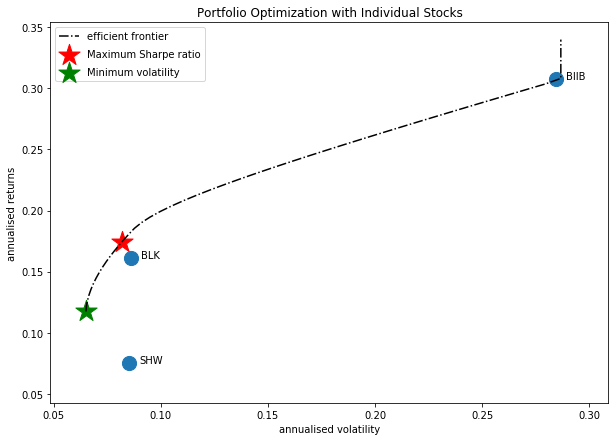

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BIIB', 'AMD']


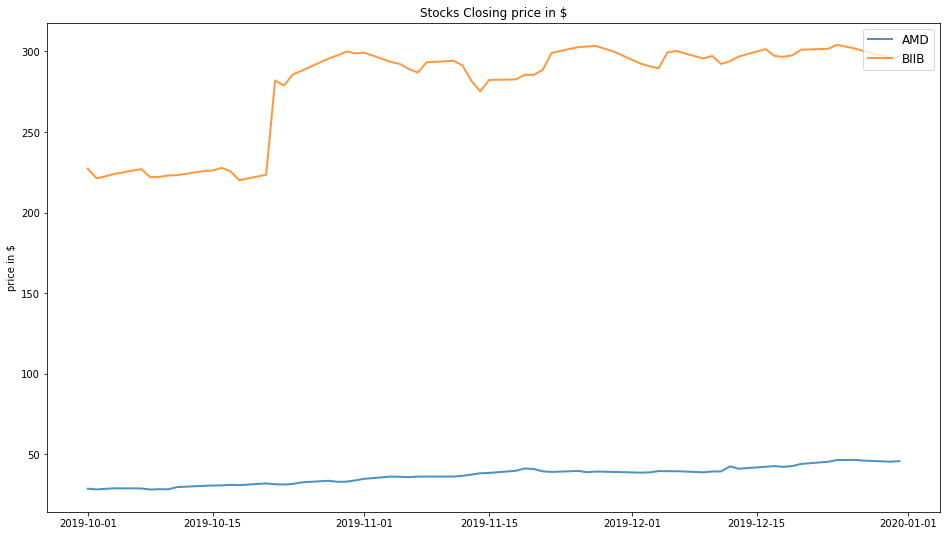

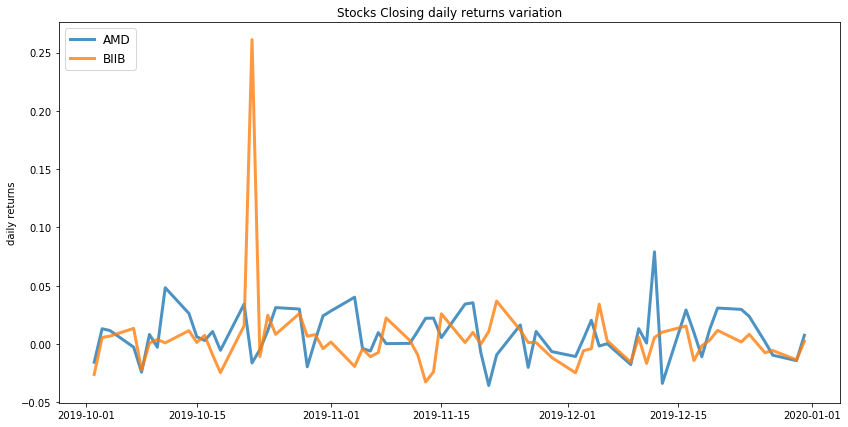

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.45
Annualised Volatility: 0.14


              AMD   BIIB
allocation  80.59  19.41
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.44
Annualised Volatility: 0.14


              AMD   BIIB
allocation  73.81  26.19


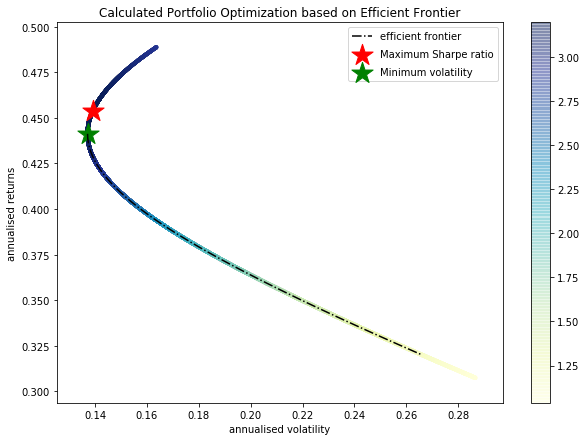

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 0.49 , annualised volatility: 0.16
BIIB : annuaised return 0.31 , annualised volatility: 0.28
--------------------------------------------------------------------------------


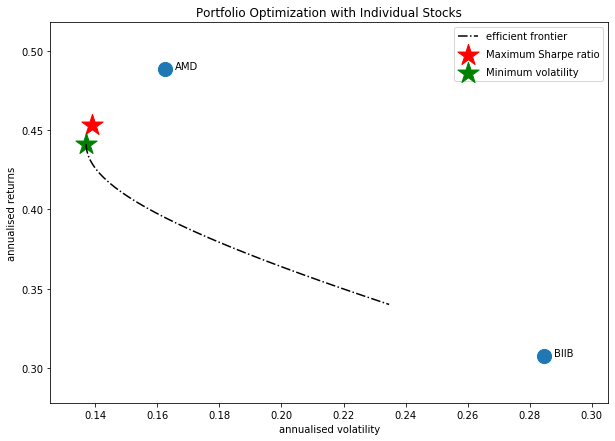

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BIIB', 'ALXN']


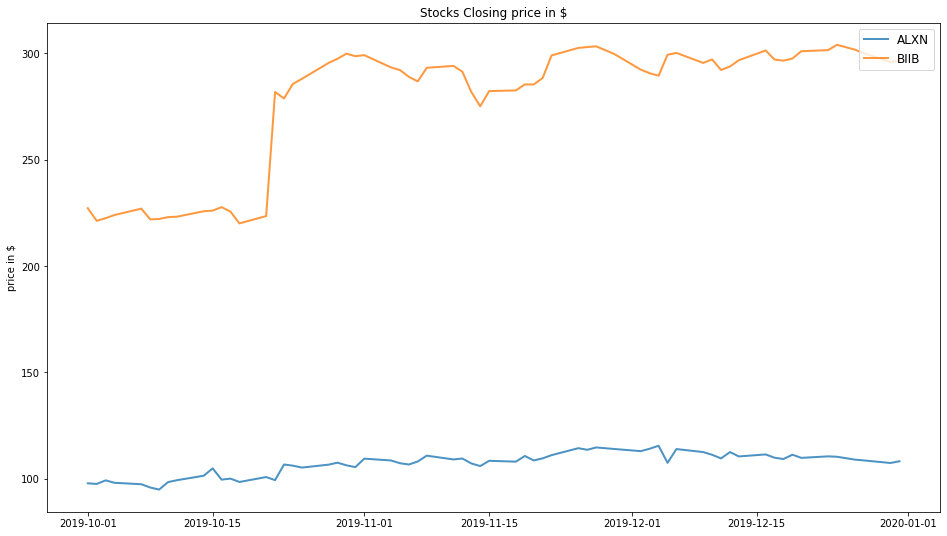

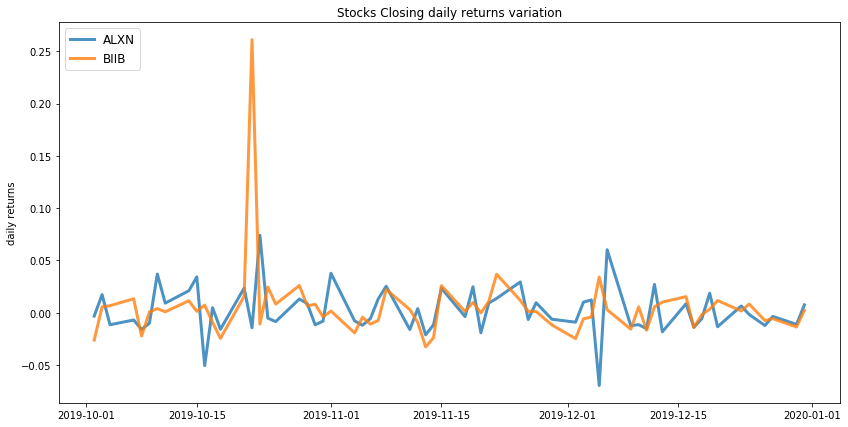

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.21
Annualised Volatility: 0.17


            ALXN  BIIB
allocation  49.1  50.9
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.15


             ALXN   BIIB
allocation  71.23  28.77


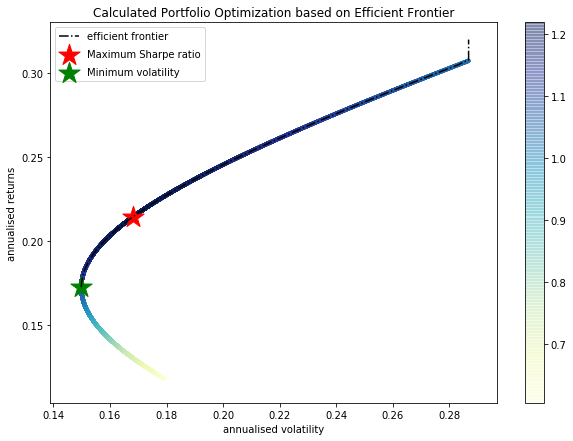

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ALXN : annuaised return 0.12 , annualised volatility: 0.18
BIIB : annuaised return 0.31 , annualised volatility: 0.28
--------------------------------------------------------------------------------


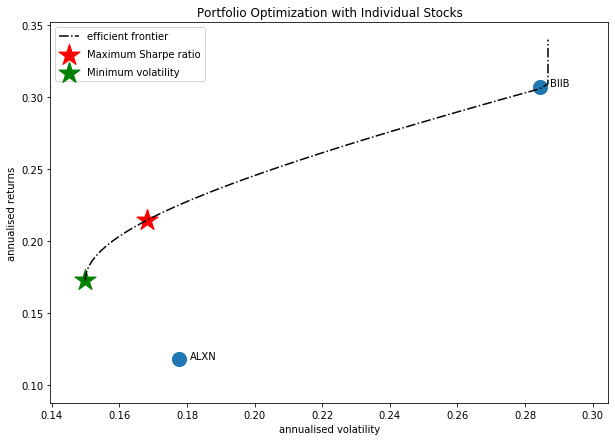

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'SHW']


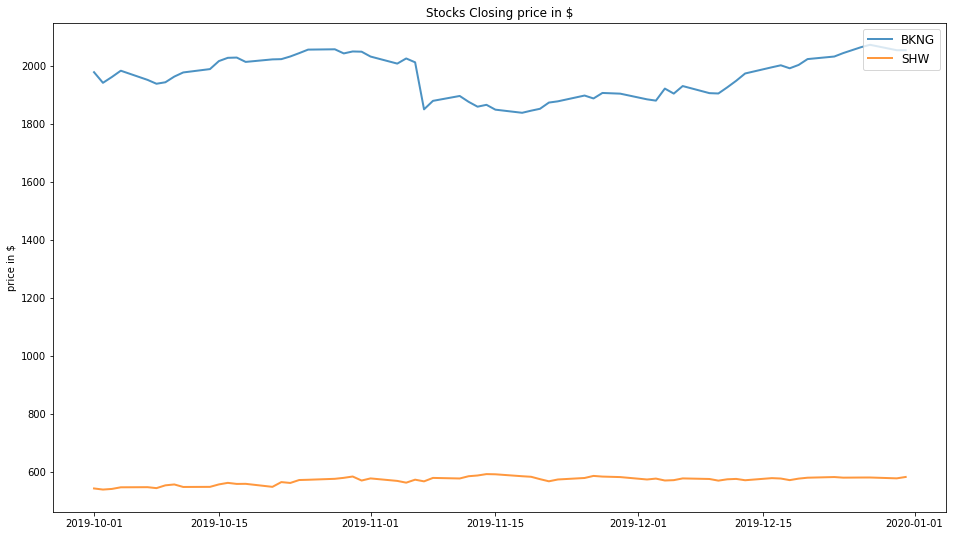

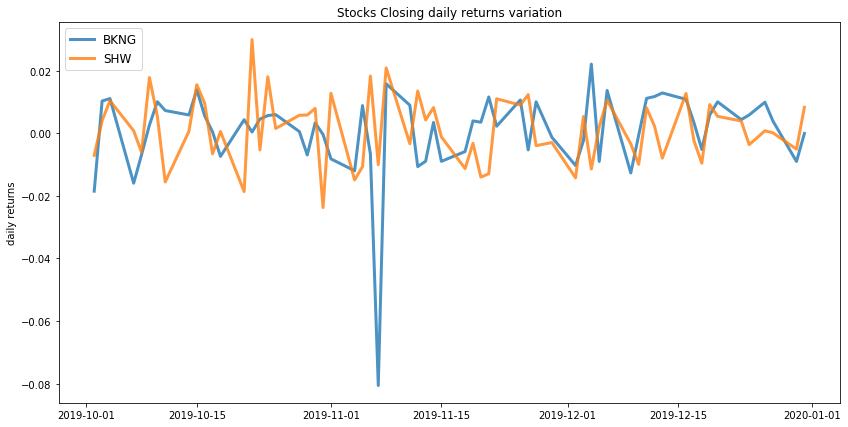

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.08


            BKNG   SHW
allocation  16.7  83.3
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.06
Annualised Volatility: 0.07


             BKNG    SHW
allocation  35.87  64.13


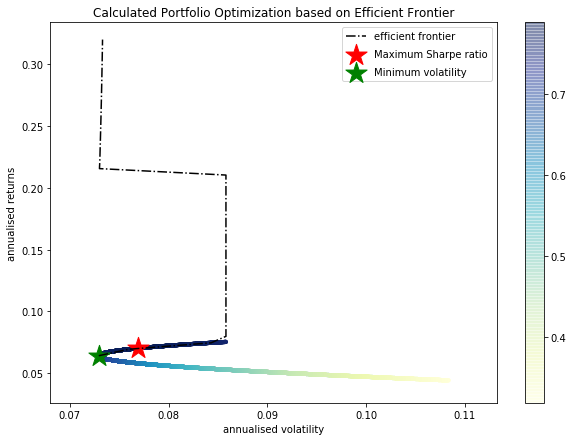

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BKNG : annuaised return 0.04 , annualised volatility: 0.11
SHW : annuaised return 0.08 , annualised volatility: 0.09
--------------------------------------------------------------------------------


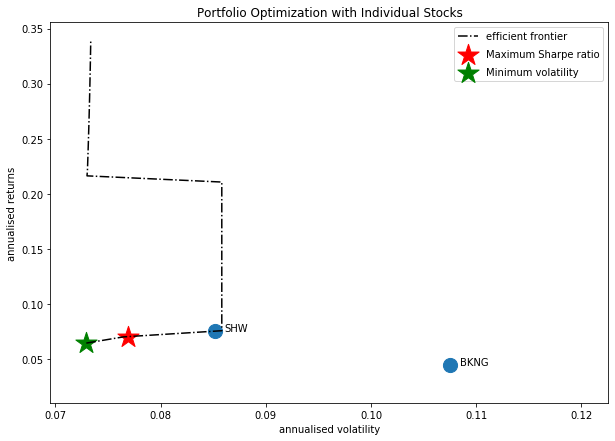

Companies listed in quarter 8 which is between 2020-01-01 and 2020-04-01
['AMZN' 'EQIX' 'BA' 'SHW' 'CTXS' 'PPG' 'BMY']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'BA', 'CTXS']


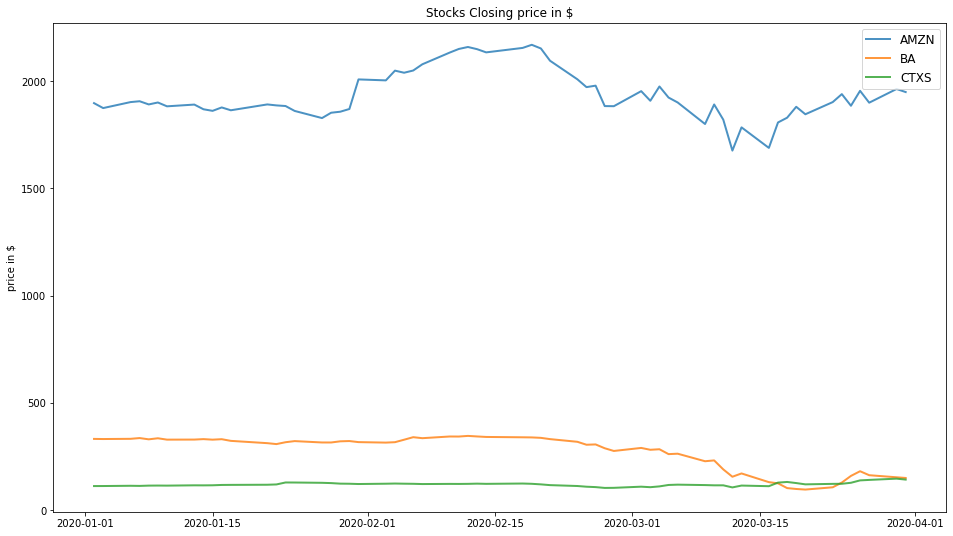

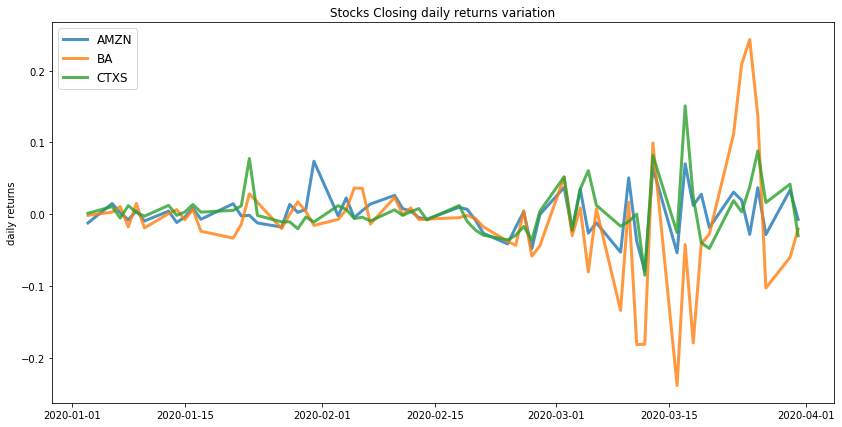

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.28
Annualised Volatility: 0.28


            AMZN   BA   CTXS
allocation   0.0  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.12
Annualised Volatility: 0.22


             AMZN   BA   CTXS
allocation  72.58  0.0  27.42


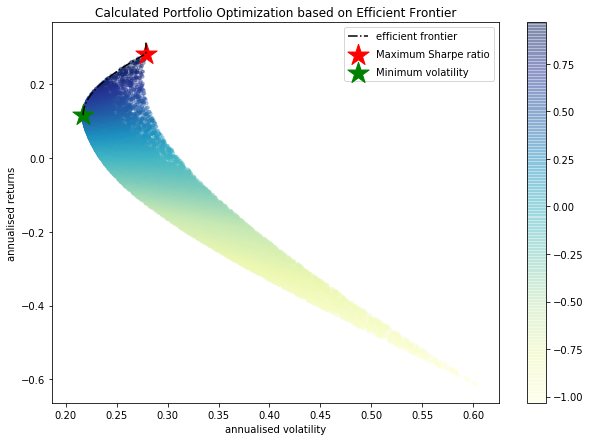

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.05 , annualised volatility: 0.22
BA : annuaised return -0.62 , annualised volatility: 0.6
CTXS : annuaised return 0.28 , annualised volatility: 0.28
--------------------------------------------------------------------------------


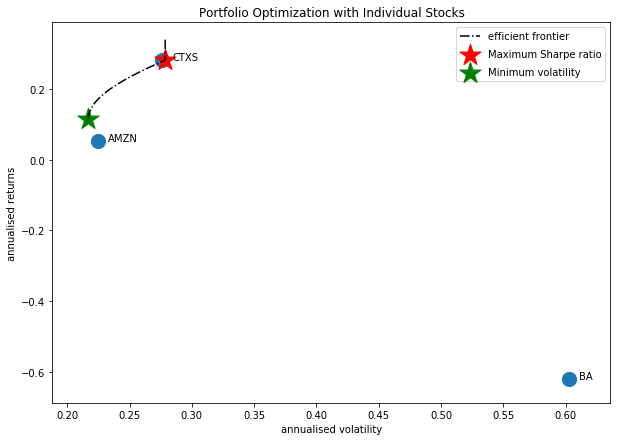

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'PPG']


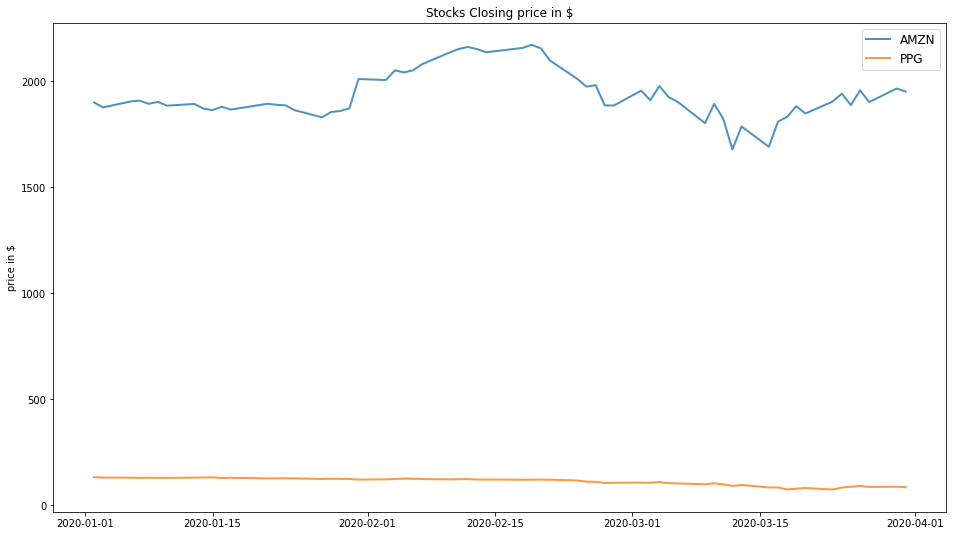

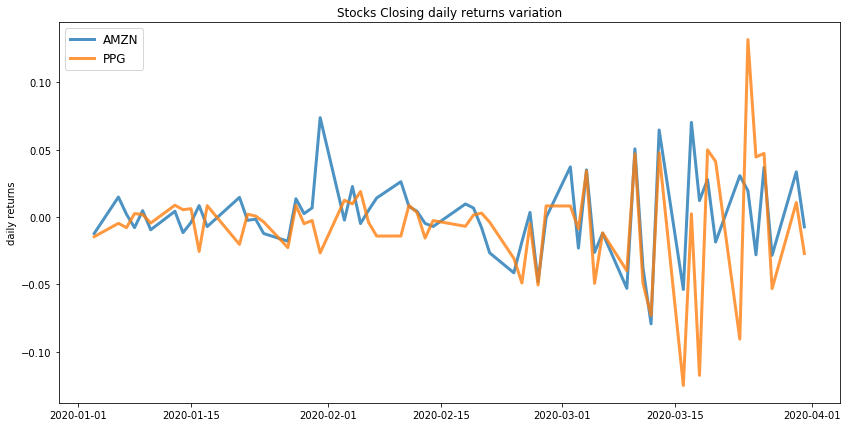

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.23


             AMZN  PPG
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.06
Annualised Volatility: 0.22


             AMZN    PPG
allocation  75.59  24.41


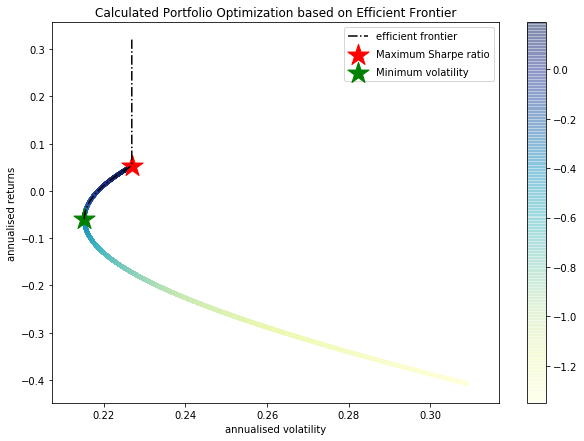

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.05 , annualised volatility: 0.22
PPG : annuaised return -0.41 , annualised volatility: 0.31
--------------------------------------------------------------------------------


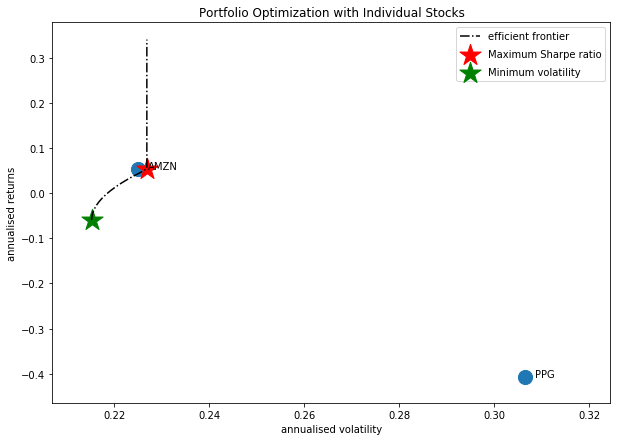

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMZN', 'BMY']


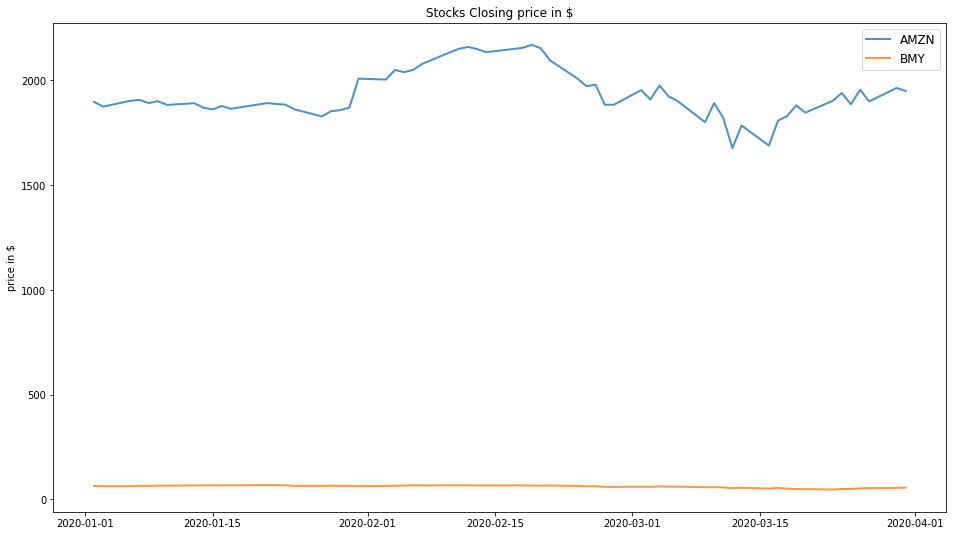

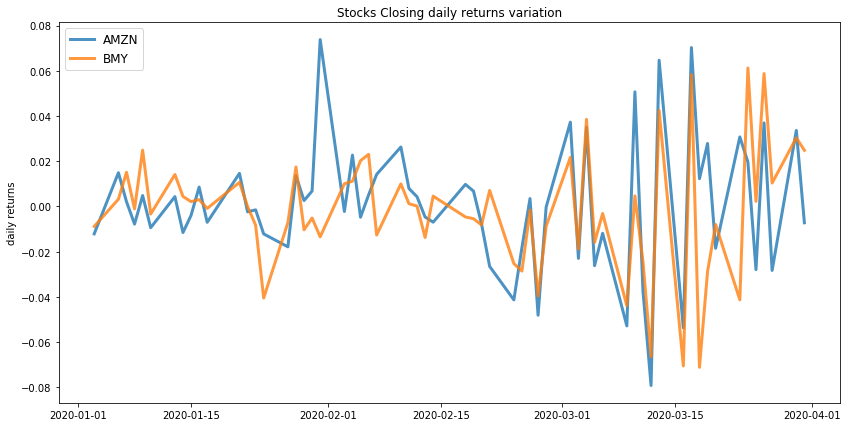

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.23


             AMZN  BMY
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.04
Annualised Volatility: 0.2


             AMZN    BMY
allocation  43.46  56.54


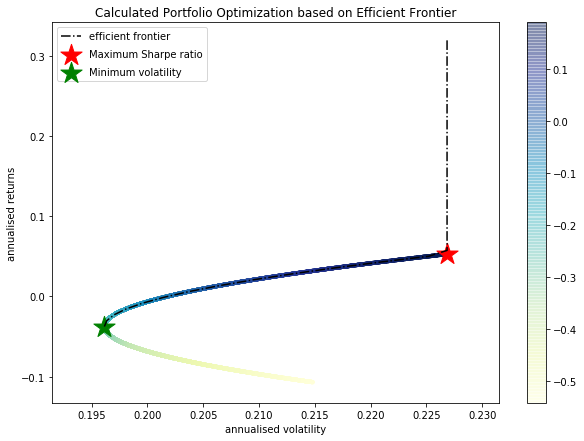

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.05 , annualised volatility: 0.22
BMY : annuaised return -0.11 , annualised volatility: 0.21
--------------------------------------------------------------------------------


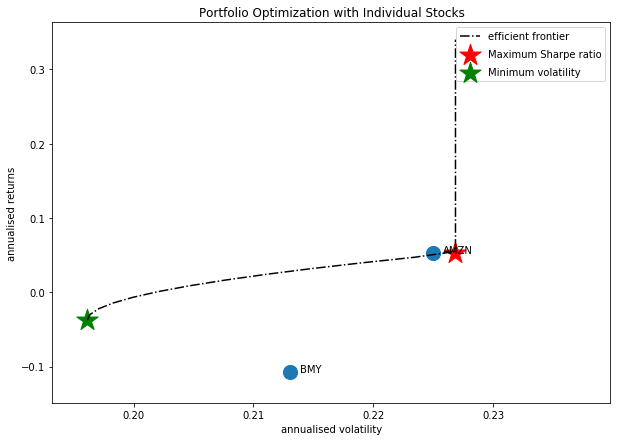

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'SHW']


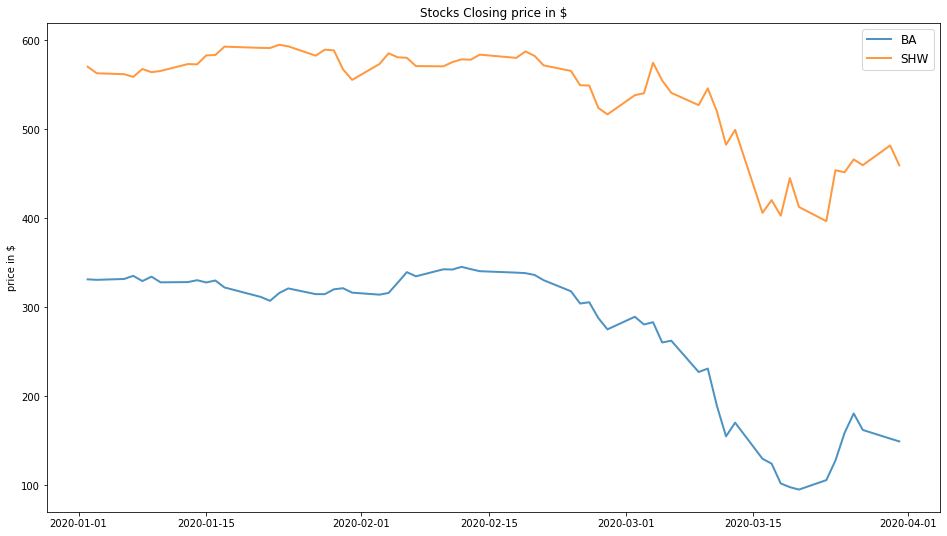

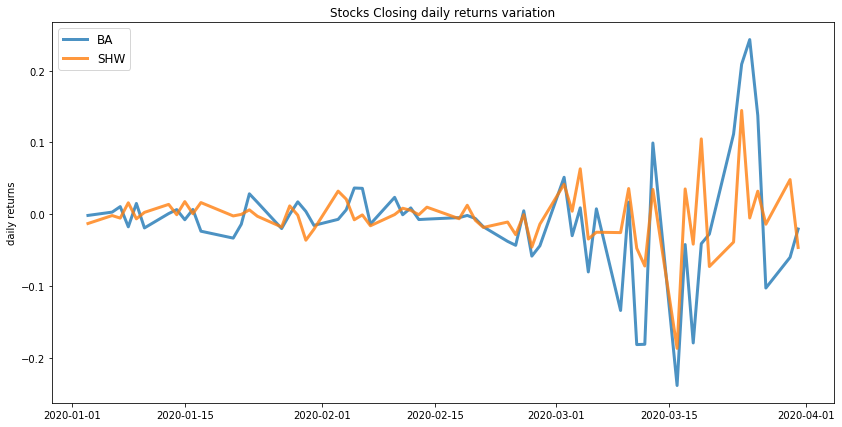

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.16
Annualised Volatility: 0.34


             BA    SHW
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.16
Annualised Volatility: 0.34


             BA    SHW
allocation  0.0  100.0


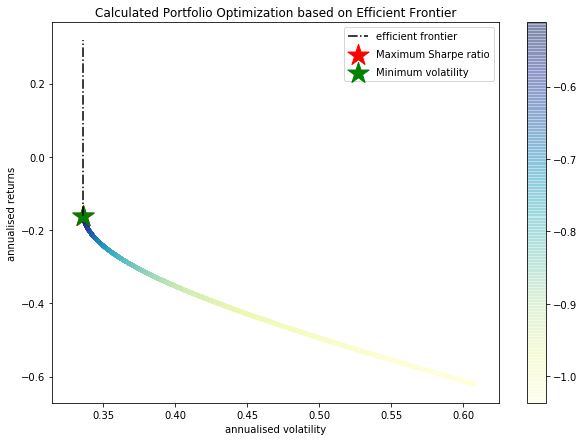

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BA : annuaised return -0.62 , annualised volatility: 0.6
SHW : annuaised return -0.16 , annualised volatility: 0.33
--------------------------------------------------------------------------------


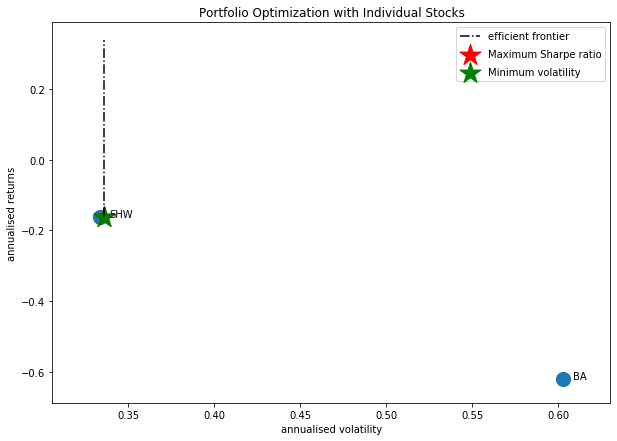

[[1.7878336227575213, 0.23, 0.12, ['BA', 'AMZN'], array([[100.,   0.]]), '2018-04-01'], [1.992680293392031, 0.49, 0.24, ['BA', 'AMD'], array([[100.,   0.]]), '2018-04-01'], [1.7928357041691791, 0.22, 0.12, ['AZO', 'AMZN'], array([[93.48,  6.52]]), '2018-04-01'], [1.997683077368238, 0.45, 0.22, ['AZO', 'AMD'], array([[88.53, 11.47]]), '2018-04-01'], [0.7221240287223277, 0.09, 0.12, ['AZO', 'CVS'], array([[72.23, 27.77]]), '2018-04-01'], [1.7878336227575211, 0.23, 0.12, ['AMZN', 'BLK'], array([[100.,   0.]]), '2018-04-01'], [1.7794591746620134, 0.27, 0.15, ['CMG', 'AYI'], array([[83.91, 16.09]]), '2018-07-01'], [2.982365285512875, 0.39, 0.13, ['AMZN', 'AMD'], array([[36.7, 63.3]]), '2018-07-01'], [2.1157090180367004, 0.16, 0.07, ['AMZN', 'AZO'], array([[44.11, 55.89]]), '2018-07-01'], [1.503684838037342, 0.15, 0.09, ['AMZN', 'PCG'], array([[86.41, 13.59]]), '2018-07-01'], [1.6097916579309617, 0.16, 0.09, ['AZO', 'BLK'], array([[100.,   0.]]), '2018-07-01'], [-0.8963456103259252, -0.13, 0

In [15]:
quarter_list=["2018-04-01", "2018-07-01", "2018-10-01", "2019-01-01", "2019-04-01", "2019-07-01", "2019-10-01", "2020-01-01", "2020-04-01"]
## Taken from
# https://www.treasury.gov/resource-center/data-chart-center/interest-rates/Pages/TextView.aspx?data=billRatesYear&year=2018
# 13 weeks period, COUPON EQUIVALENT, based on last possible date of each quarter
risk_free_rates = [1.93, 2.19, 2.45, 2.40, 2.13, 1.88, 1.55, 0.03]

returns_sharpe_company_list = []
for idx in range(1, len(quarter_list)):
    df_quarter_data = new_df[(new_df["start_date"] >= quarter_list[idx-1]) & (new_df["start_date"]< quarter_list[idx])]
    print("Companies listed in quarter {} which is between {} and {}".format(idx, quarter_list[idx-1], quarter_list[idx]))
    list_of_companies = df_quarter_data["symbol"].unique()
    #generate the stocks pairs which are uncorrelated and having covariance less than mean covariance 
    stocks_pair = get_portfolio_pairs(list_of_companies)
    #print(stocks_pair)
    for stock_list in stocks_pair:
        print("perform efficient_frontier_stock_portfolio Pairs of the companies we got {}".format(stock_list))
        pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights = efficient_frontier_stock_portfolio(stock_list, len(stock_list), risk_free_rates[idx-1], quarter_list[idx-1], quarter_list[idx])
        returns_sharpe_company_list.append([pos_sharpe, Annualised_Return, Annualised_Volatility, stock_list, allocation_weights, quarter_list[idx-1]])
print(returns_sharpe_company_list)

In [16]:
shortlisted_portfolio_df = pd.DataFrame(returns_sharpe_company_list)

In [17]:
shortlisted_portfolio_df.columns = ["Sharpe Ratio", "Portfolio Annualised Return", "Portfolio Annualised_Volatility", "Stock Portfolio", "Stocks Weight Allocation", "Quarter Start Date"]

### we know that higher the sharpe ratio value the stocks have a good returns with consideration of the risk in  the investment and for the portfolio we tag quantitative values such as below for the portfolio generated:

#### Sharpe Ratio >=  3 ---> "Excellent Portfolio"

#### Sharpe Ratio >=  2 ---> "Very Good Portfolio"

#### Sharpe Ratio >= 1 ---> "Good Portfolio"

#### Sharpe Ratio < 1 ---> "Bad Portfolio"

In [18]:
# creating a blank series 
Portfolio_Tag = pd.Series([]) 

for row in range(len(shortlisted_portfolio_df)):
    if (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 3):
        Portfolio_Tag[row] = "Excellent"
    elif (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 2 and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 3)):
        Portfolio_Tag[row] = "Very Good"
    elif ((shortlisted_portfolio_df["Sharpe Ratio"][row] >= 1)  and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 2)):
        Portfolio_Tag[row] = "Good"
    else:
        Portfolio_Tag[row] = "Bad"
        
# inserting new column with values of list made above         
shortlisted_portfolio_df.insert(5, "Portfolio Tag", Portfolio_Tag) 

## Possible combinations of the company from which we will take the final Portfolio list

In [19]:
shortlisted_portfolio_df

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag,Quarter Start Date
0,1.787834,0.23,0.12,"[BA, AMZN]","[[100.0, 0.0]]",Good,2018-04-01
1,1.992680,0.49,0.24,"[BA, AMD]","[[100.0, 0.0]]",Good,2018-04-01
2,1.792836,0.22,0.12,"[AZO, AMZN]","[[93.48, 6.52]]",Good,2018-04-01
3,1.997683,0.45,0.22,"[AZO, AMD]","[[88.53, 11.47]]",Good,2018-04-01
4,0.722124,0.09,0.12,"[AZO, CVS]","[[72.23, 27.77]]",Bad,2018-04-01
5,1.787834,0.23,0.12,"[AMZN, BLK]","[[100.0, 0.0]]",Good,2018-04-01
6,1.779459,0.27,0.15,"[CMG, AYI]","[[83.91, 16.09]]",Good,2018-07-01
7,2.982365,0.39,0.13,"[AMZN, AMD]","[[36.7, 63.3]]",Very Good,2018-07-01
8,2.115709,0.16,0.07,"[AMZN, AZO]","[[44.11, 55.89]]",Very Good,2018-07-01
9,1.503685,0.15,0.09,"[AMZN, PCG]","[[86.41, 13.59]]",Good,2018-07-01


In [20]:
shortlisted_portfolio = shortlisted_portfolio_df[(shortlisted_portfolio_df["Portfolio Tag"] == "Excellent") | (shortlisted_portfolio_df["Portfolio Tag"] == "Very Good") |
                                                    (shortlisted_portfolio_df["Portfolio Tag"] == "Good")]

In [21]:
shortlisted_portfolio = shortlisted_portfolio.sort_values(by="Sharpe Ratio", ascending=False)

In [22]:
shortlisted_portfolio

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag,Quarter Start Date
22,3.709027,0.36,0.09,"[CMG, AZO]","[[48.45, 51.55]]",Excellent,2019-01-01
38,3.194284,0.45,0.14,"[BIIB, AMD]","[[80.59, 19.41]]",Excellent,2019-10-01
36,3.152382,0.25,0.08,"[AAPL, BIIB, SHW, BLK]","[[78.8, 6.08, 0.0, 15.12]]",Excellent,2019-10-01
15,3.134866,0.45,0.14,"[BKNG, CMG]","[[9.46, 90.54]]",Excellent,2019-01-01
7,2.982365,0.39,0.13,"[AMZN, AMD]","[[36.7, 63.3]]",Very Good,2018-07-01
18,2.124238,0.20,0.09,"[BA, AZO]","[[75.11, 24.89]]",Very Good,2019-01-01
8,2.115709,0.16,0.07,"[AMZN, AZO]","[[44.11, 55.89]]",Very Good,2018-07-01
37,2.013631,0.17,0.08,"[BIIB, SHW, BLK]","[[13.44, 79.53, 7.03]]",Very Good,2019-10-01
3,1.997683,0.45,0.22,"[AZO, AMD]","[[88.53, 11.47]]",Good,2018-04-01
1,1.992680,0.49,0.24,"[BA, AMD]","[[100.0, 0.0]]",Good,2018-04-01


# Top 5 stock portfolios to be taken from the data (User to choose)

In [23]:
shortlisted_portfolio[:5]

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag,Quarter Start Date
22,3.709027,0.36,0.09,"[CMG, AZO]","[[48.45, 51.55]]",Excellent,2019-01-01
38,3.194284,0.45,0.14,"[BIIB, AMD]","[[80.59, 19.41]]",Excellent,2019-10-01
36,3.152382,0.25,0.08,"[AAPL, BIIB, SHW, BLK]","[[78.8, 6.08, 0.0, 15.12]]",Excellent,2019-10-01
15,3.134866,0.45,0.14,"[BKNG, CMG]","[[9.46, 90.54]]",Excellent,2019-01-01
7,2.982365,0.39,0.13,"[AMZN, AMD]","[[36.7, 63.3]]",Very Good,2018-07-01


## portfolio generated quarterwise from 2018 - 2020

In [24]:
shortlisted_portfolio_quarterwise_max_df = shortlisted_portfolio_df.groupby("Quarter Start Date")["Sharpe Ratio"].max().reset_index()

In [25]:
portfolio_quarterwise_max = pd.merge(left=shortlisted_portfolio_quarterwise_max_df, right=shortlisted_portfolio_df,left_on='Sharpe Ratio', right_on='Sharpe Ratio').drop(["Quarter Start Date_y"], axis=1)

In [26]:
portfolio_quarterwise_max

,Quarter Start Date_x,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
0,2018-04-01,1.997683,0.45,0.22,"[AZO, AMD]","[[88.53, 11.47]]",Good
1,2018-07-01,2.982365,0.39,0.13,"[AMZN, AMD]","[[36.7, 63.3]]",Very Good
2,2018-10-01,0.797281,0.16,0.18,"[BKNG, NEM]","[[0.0, 100.0]]",Bad
3,2019-01-01,3.709027,0.36,0.09,"[CMG, AZO]","[[48.45, 51.55]]",Excellent
4,2019-04-01,1.455376,0.28,0.18,"[BKNG, APC]","[[48.35, 51.65]]",Good
5,2019-07-01,1.469454,0.15,0.10,"[EQIX, CMG]","[[42.91, 57.09]]",Good
6,2019-10-01,3.194284,0.45,0.14,"[BIIB, AMD]","[[80.59, 19.41]]",Excellent
7,2020-01-01,0.976113,0.28,0.28,"[AMZN, BA, CTXS]","[[0.0, 0.0, 100.0]]",Bad


## portfolio generated for the shortlisted companies for overall 2 yr period

In [27]:
portfolio_list

array(['BA', 'AZO', 'AMZN', 'AMD', 'CMG', 'BKNG', 'CXO', 'SHW', 'EQIX',
       'AMGN', 'AAPL', 'BIIB', 'BLK', 'ALGN', 'MMM', 'ANTM', 'AYI', 'ECL',
       'CVS', 'DVN', 'PCG', 'NEM', 'COP', 'COTY', 'ABC', 'APC', 'DHI',
       'ALXN', 'GOOGL', 'CTXS', 'BAC', 'GOOG', 'APD', 'HST', 'PPG', 'BMY'],
      dtype=object)

['BA' 'AZO' 'AMZN' 'AMD' 'CMG' 'BKNG' 'CXO' 'SHW' 'EQIX' 'AMGN' 'AAPL'
 'BIIB' 'BLK' 'ALGN' 'MMM' 'ANTM' 'AYI' 'ECL' 'CVS' 'DVN' 'PCG' 'NEM'
 'COP' 'COTY' 'ABC' 'APC' 'DHI' 'ALXN' 'GOOGL' 'CTXS' 'BAC' 'GOOG' 'APD'
 'HST' 'PPG' 'BMY']
perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'EQIX', 'CVS', 'ABC']


/home/abhishek/anaconda3/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



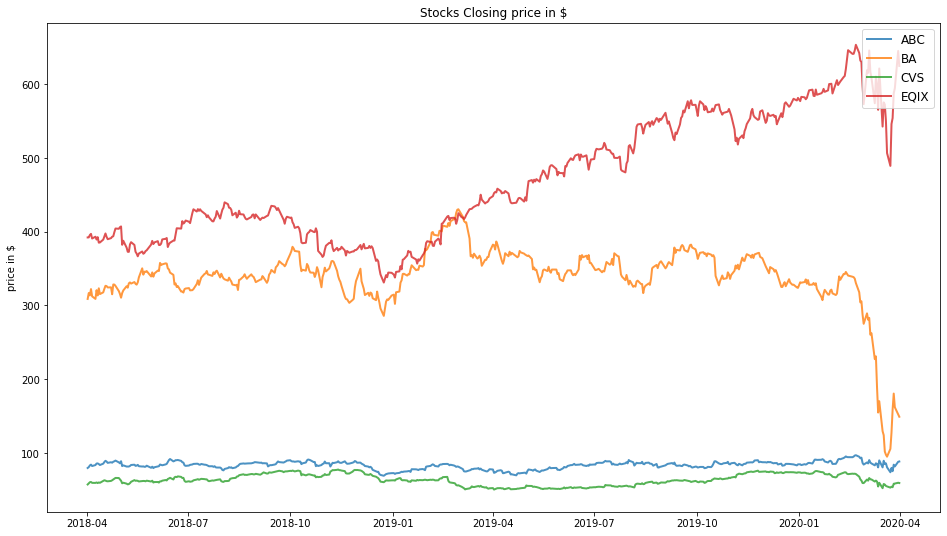

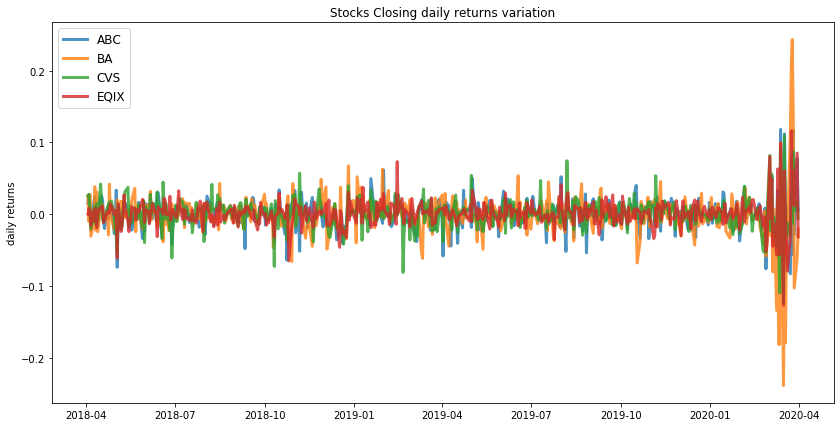

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.42


            ABC   BA  CVS   EQIX
allocation  0.0  0.0  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.34
Annualised Volatility: 0.37


              ABC    BA    CVS   EQIX
allocation  12.07  4.98  31.54  51.42


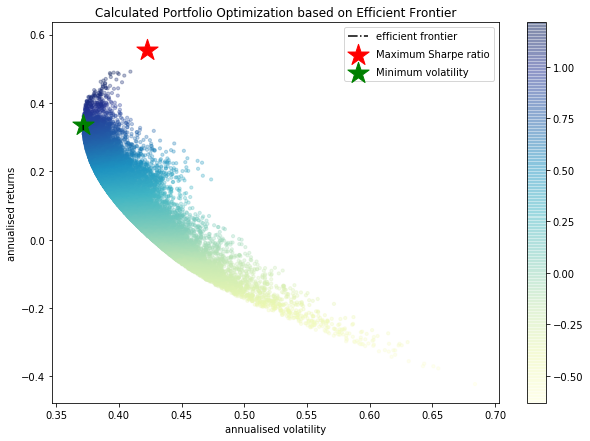

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.23 , annualised volatility: 0.49
BA : annuaised return -0.47 , annualised volatility: 0.72
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


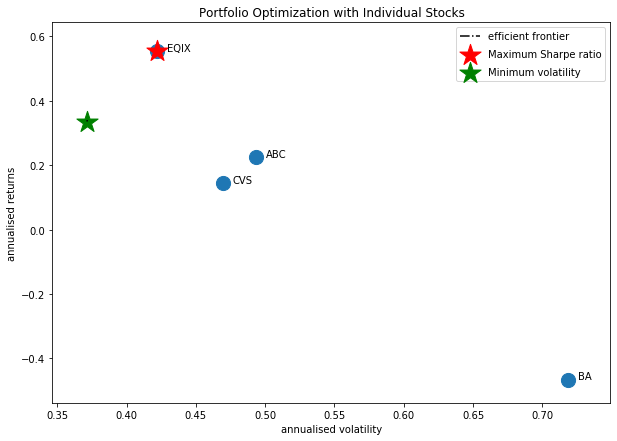

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'EQIX', 'AMGN', 'BIIB', 'MMM', 'CVS']


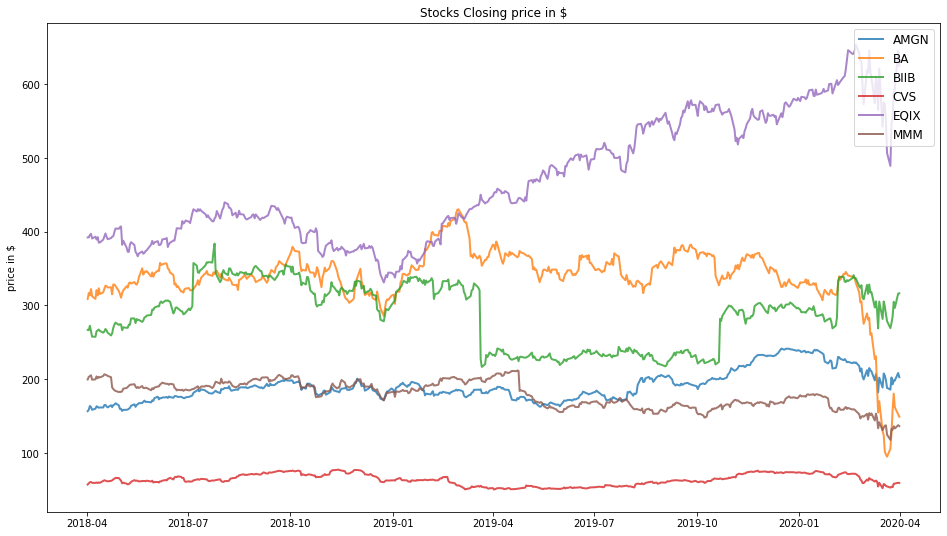

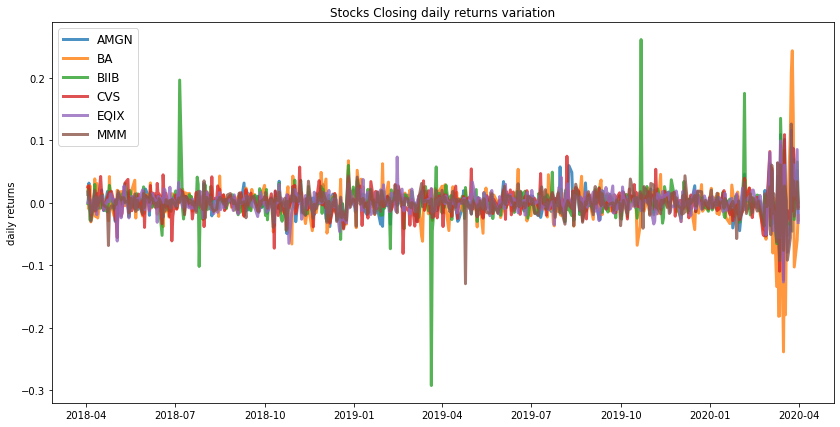

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.4


            AMGN   BA  BIIB  CVS   EQIX  MMM
allocation  3.24  0.0  9.02  0.0  87.74  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.19
Annualised Volatility: 0.34


             AMGN   BA  BIIB    CVS   EQIX    MMM
allocation  23.52  0.0  3.55  14.85  29.15  28.93


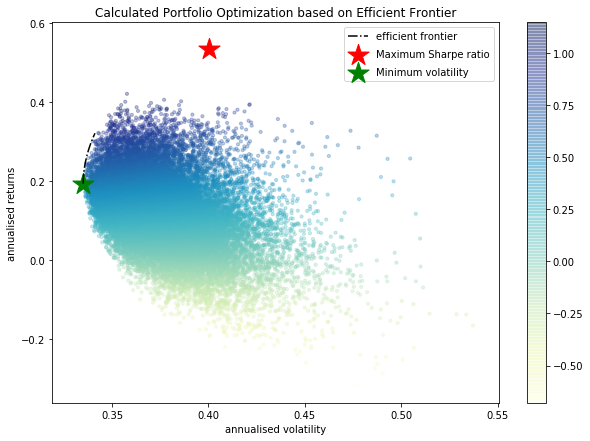

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BA : annuaised return -0.47 , annualised volatility: 0.72
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


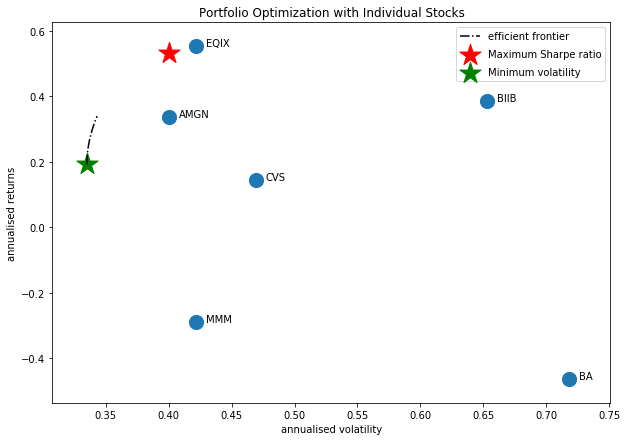

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'EQIX', 'AMGN', 'CVS', 'ABC']


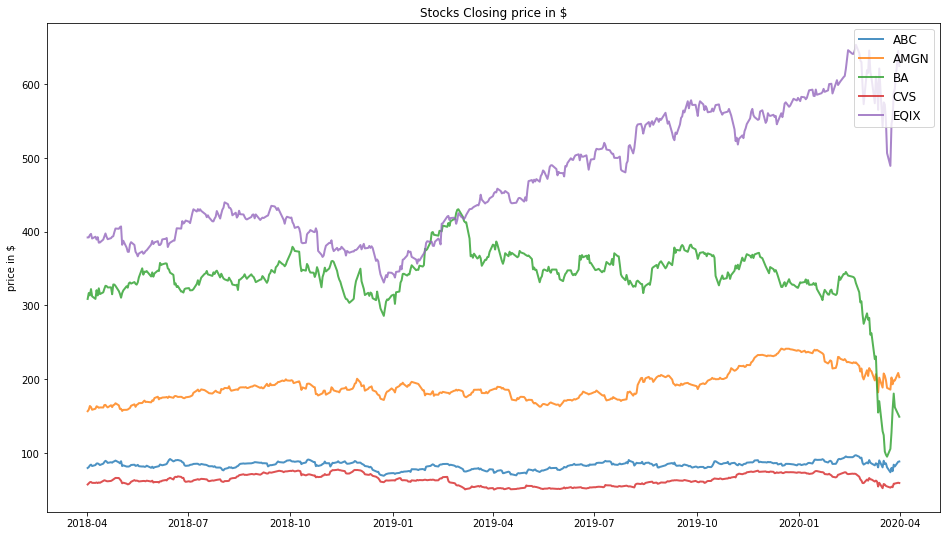

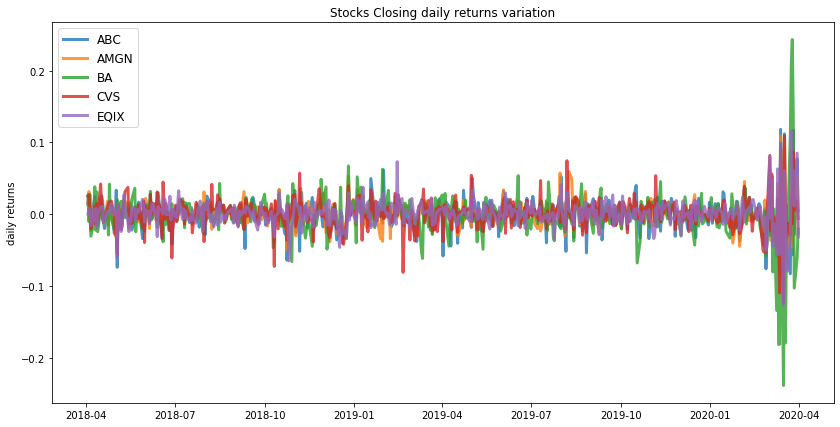

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.4


            ABC   AMGN   BA  CVS   EQIX
allocation  0.0  10.47  0.0  0.0  89.53
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.35


            ABC   AMGN    BA    CVS   EQIX
allocation  1.4  39.62  2.25  21.33  35.41


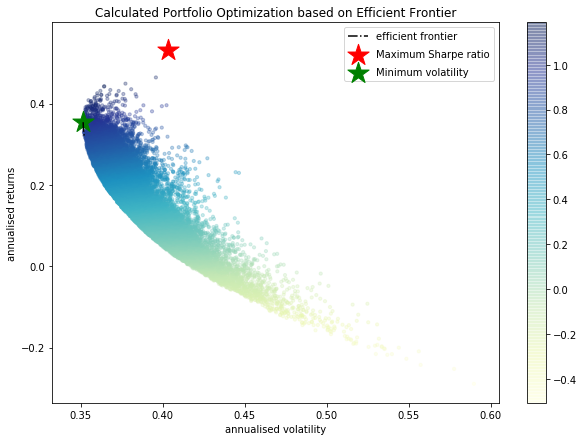

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.23 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BA : annuaised return -0.47 , annualised volatility: 0.72
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


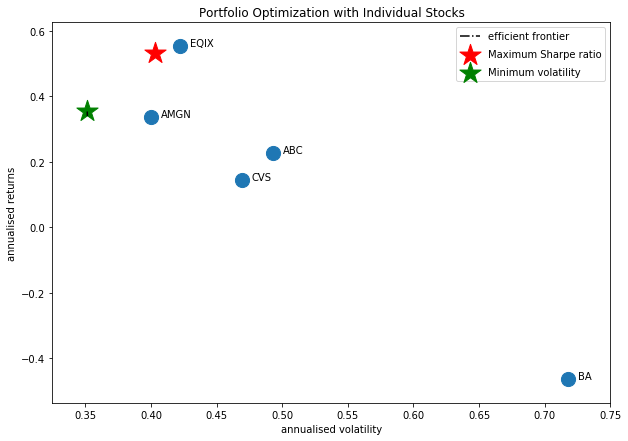

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'APD']


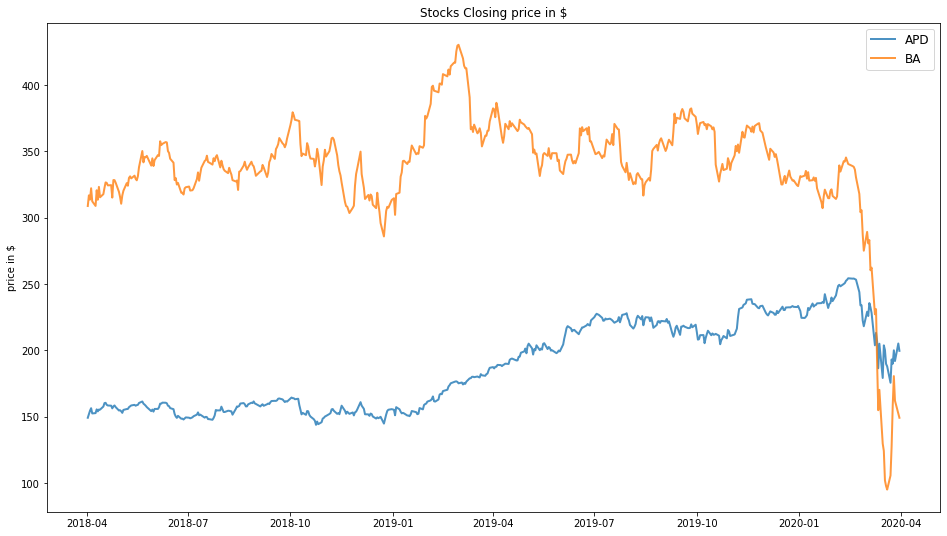

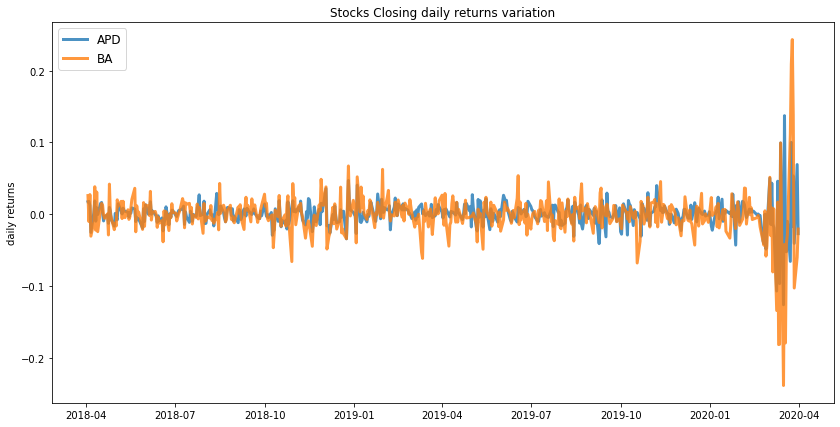

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.38
Annualised Volatility: 0.42


              APD   BA
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.32
Annualised Volatility: 0.42


              APD    BA
allocation  93.18  6.82


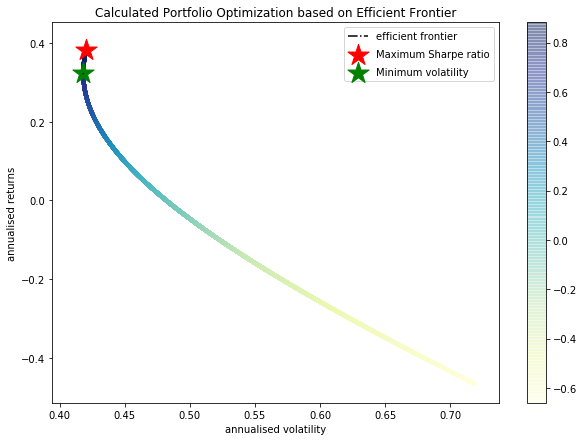

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

APD : annuaised return 0.38 , annualised volatility: 0.42
BA : annuaised return -0.47 , annualised volatility: 0.72
--------------------------------------------------------------------------------


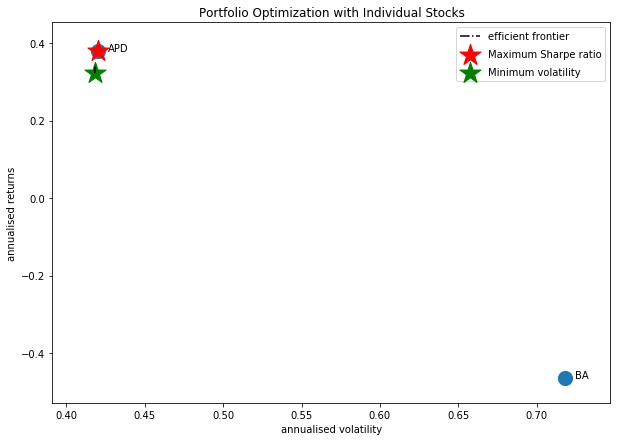

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'HST']


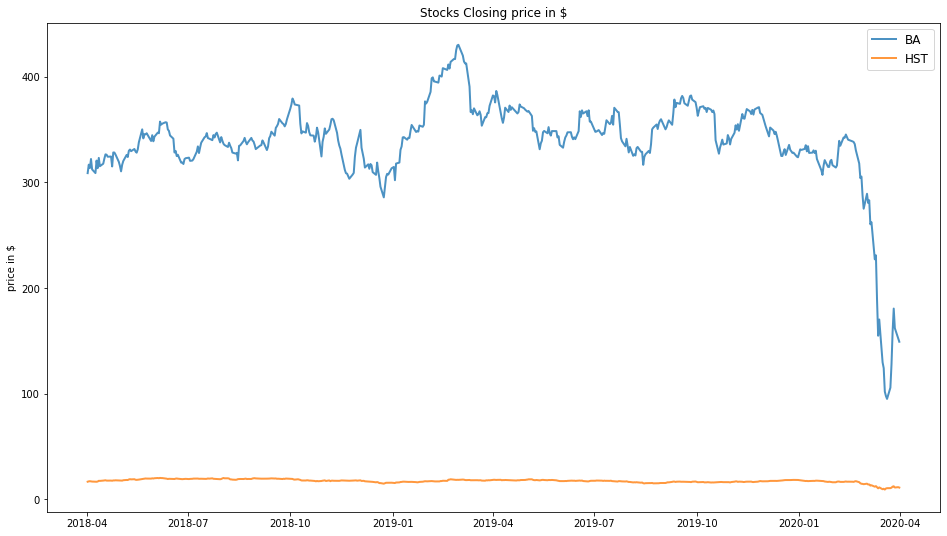

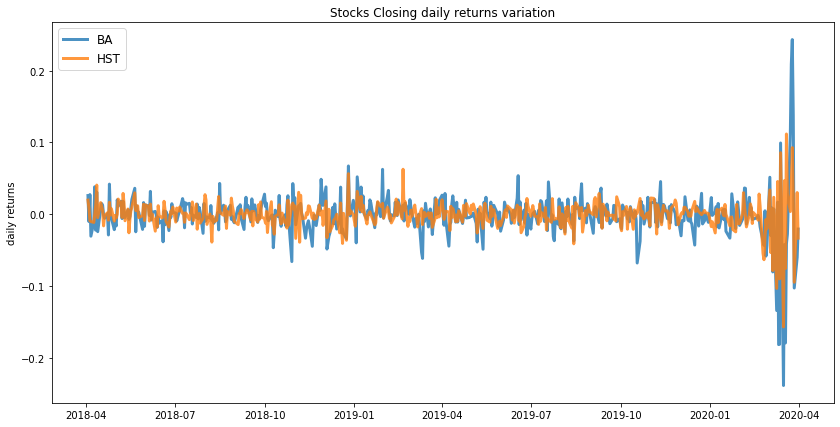

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.47
Annualised Volatility: 0.72


               BA  HST
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.31
Annualised Volatility: 0.45


              BA    HST
allocation  3.05  96.95


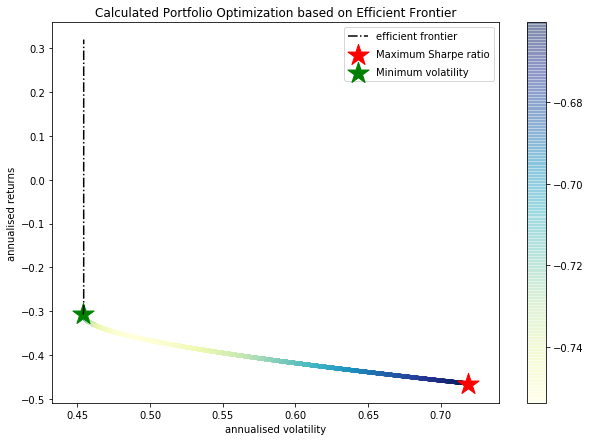

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BA : annuaised return -0.47 , annualised volatility: 0.72
HST : annuaised return -0.3 , annualised volatility: 0.45
--------------------------------------------------------------------------------


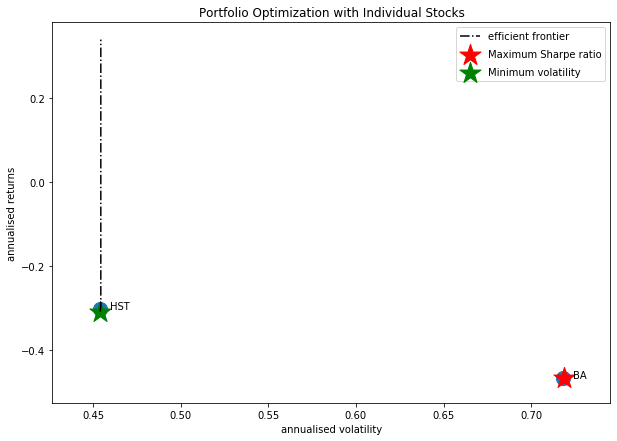

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AMD', 'BIIB', 'ANTM', 'CVS']


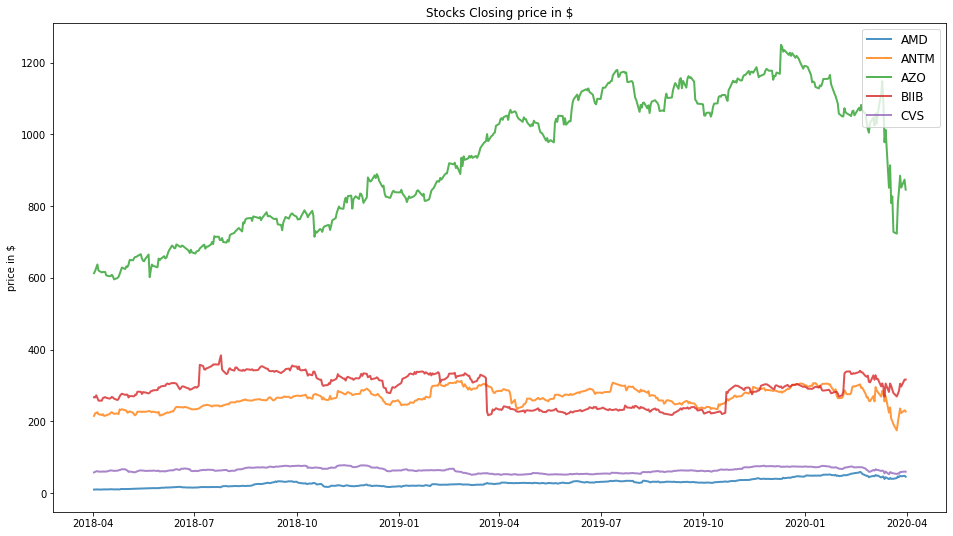

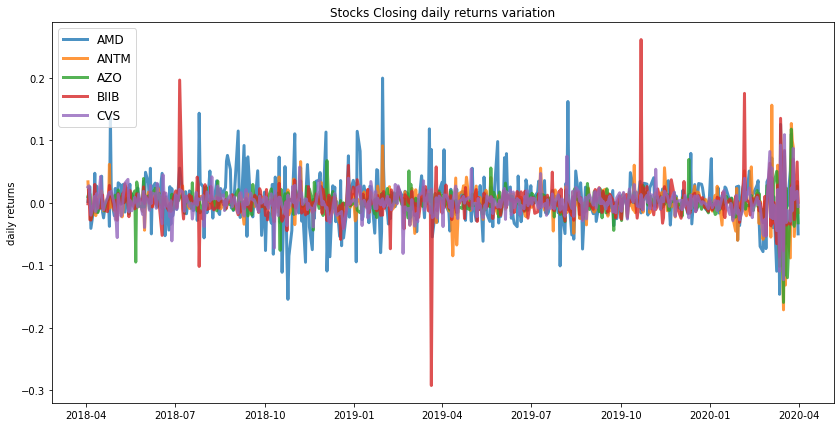

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.55
Annualised Volatility: 0.69


              AMD  ANTM    AZO  BIIB  CVS
allocation  73.36   0.0  21.92  4.73  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.33
Annualised Volatility: 0.37


             AMD  ANTM    AZO   BIIB   CVS
allocation  0.82  2.58  47.16  13.85  35.6


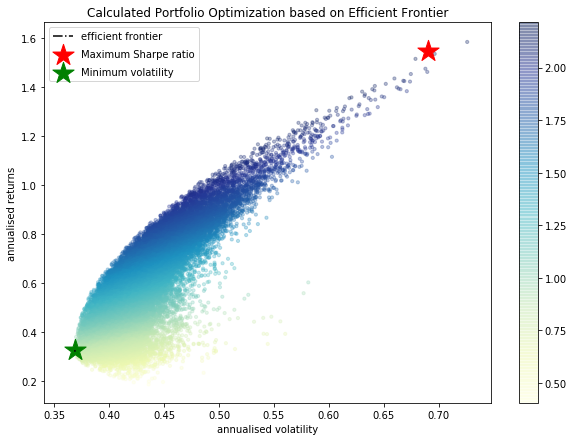

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
ANTM : annuaised return 0.21 , annualised volatility: 0.55
AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
--------------------------------------------------------------------------------


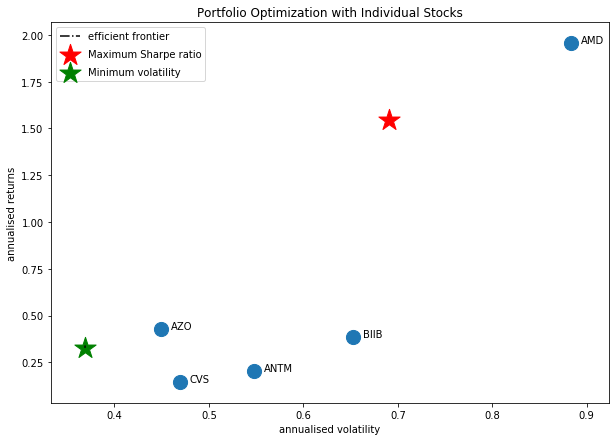

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'CXO', 'BIIB', 'MMM', 'CVS']


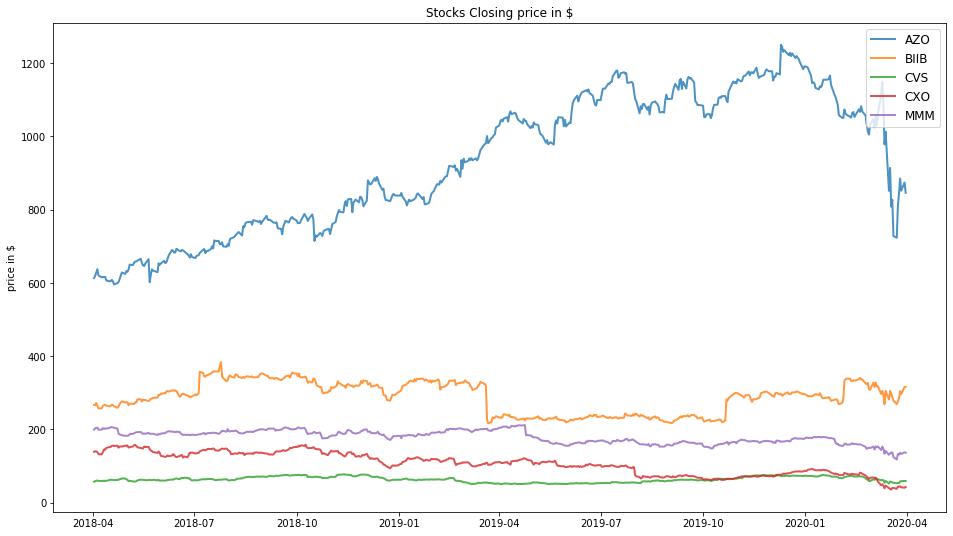

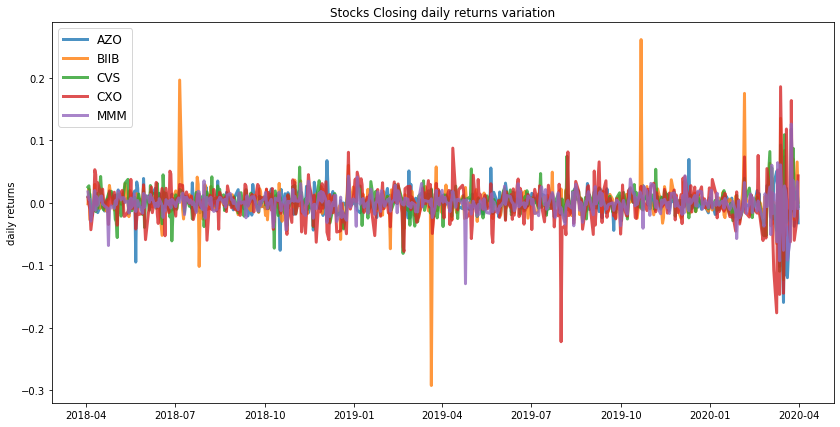

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.42
Annualised Volatility: 0.41


              AZO   BIIB  CVS  CXO  MMM
allocation  75.86  24.14  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.34


              AZO  BIIB    CVS  CXO    MMM
allocation  32.77  8.94  22.53  0.0  35.76


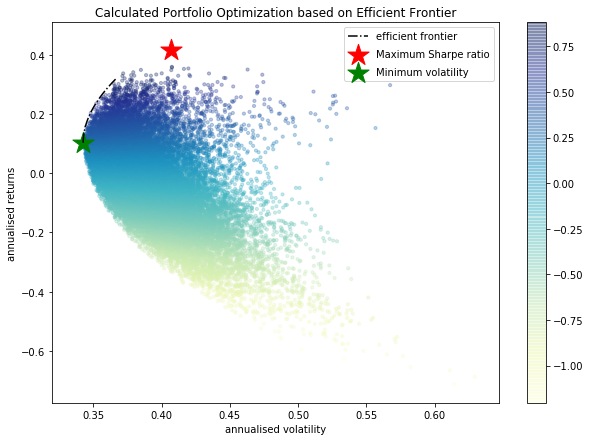

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


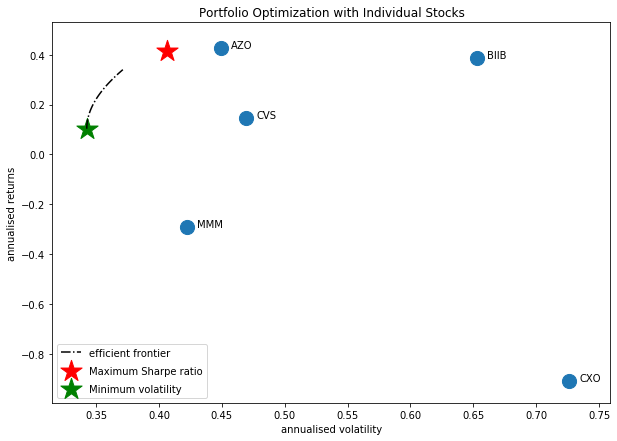

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'EQIX', 'BIIB', 'MMM', 'ANTM', 'CVS']


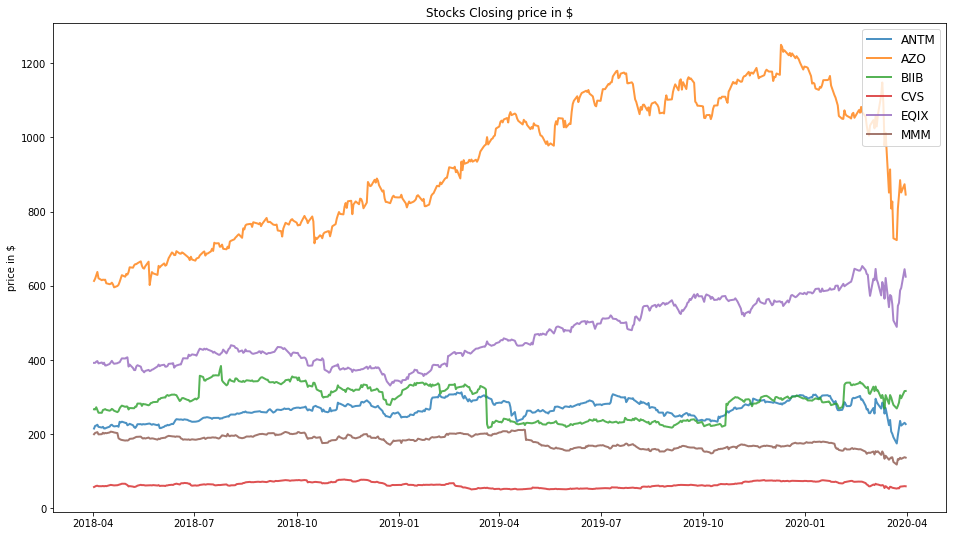

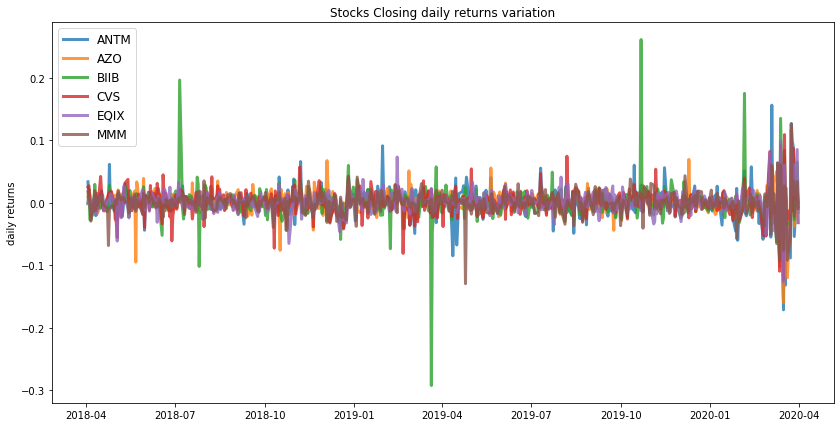

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.51
Annualised Volatility: 0.37


            ANTM    AZO  BIIB  CVS   EQIX  MMM
allocation   0.0  26.35  6.62  0.0  67.03  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.22
Annualised Volatility: 0.33


            ANTM    AZO  BIIB    CVS   EQIX   MMM
allocation   0.0  23.69  6.49  15.24  27.39  27.2


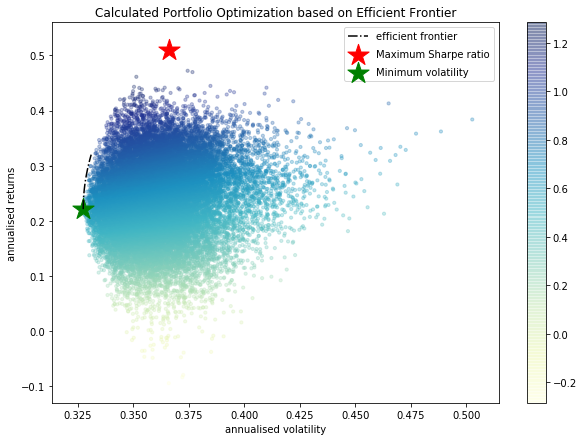

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ANTM : annuaised return 0.21 , annualised volatility: 0.55
AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


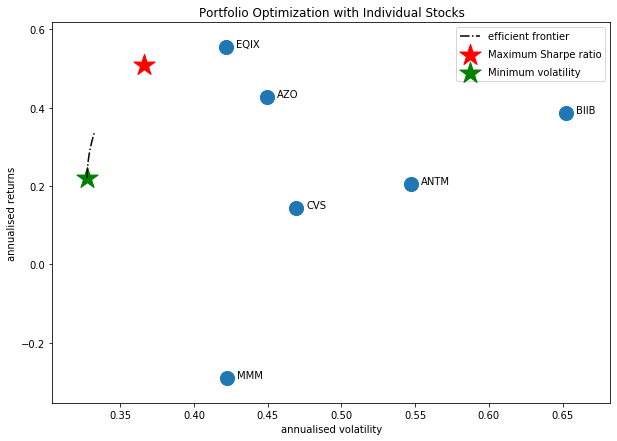

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AMD', 'CXO', 'AMGN', 'BIIB', 'MMM', 'CVS', 'ABC']


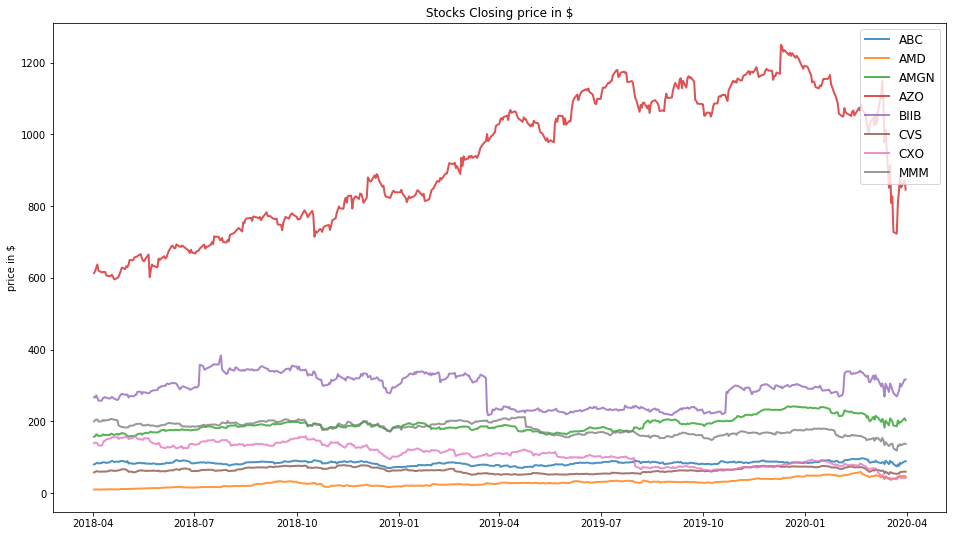

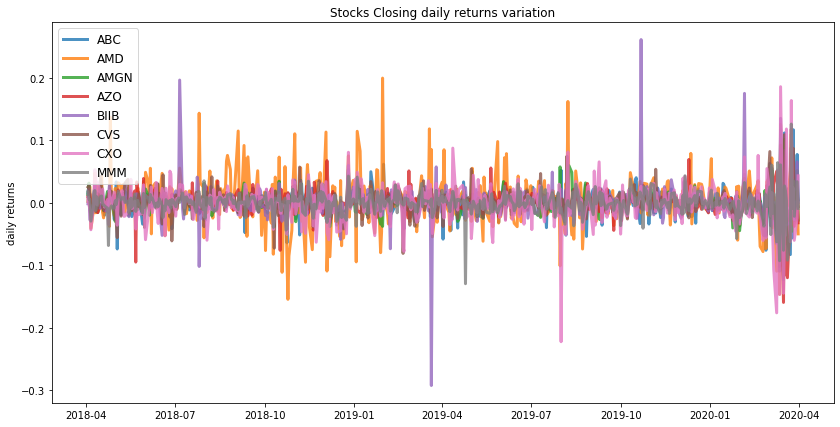

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.55
Annualised Volatility: 0.69


            ABC    AMD  AMGN    AZO  BIIB  CVS  CXO  MMM
allocation  0.0  73.36   0.0  21.92  4.72  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.19
Annualised Volatility: 0.33


            ABC  AMD   AMGN    AZO  BIIB    CVS  CXO    MMM
allocation  0.0  0.0  31.56  28.43  2.94  13.26  0.0  23.81


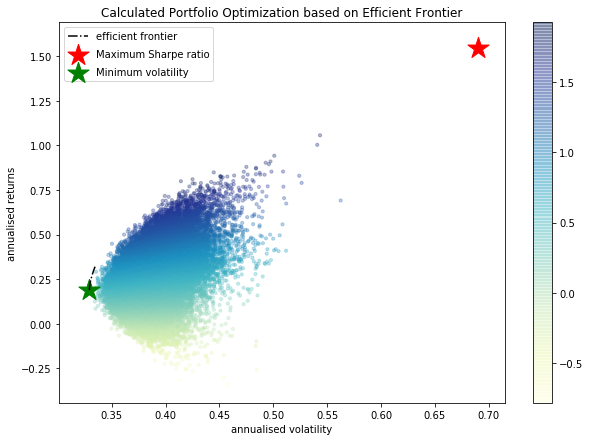

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.23 , annualised volatility: 0.49
AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


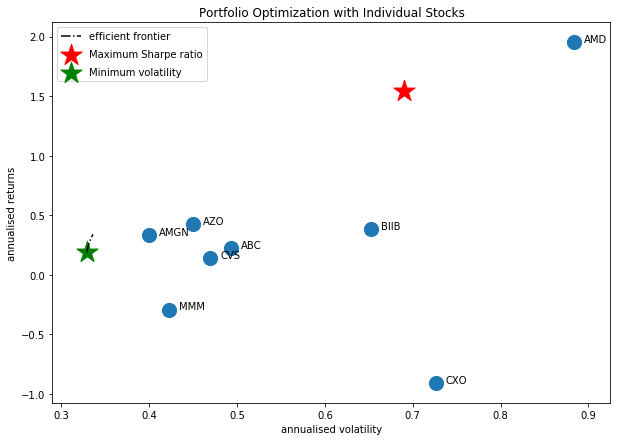

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'BLK']


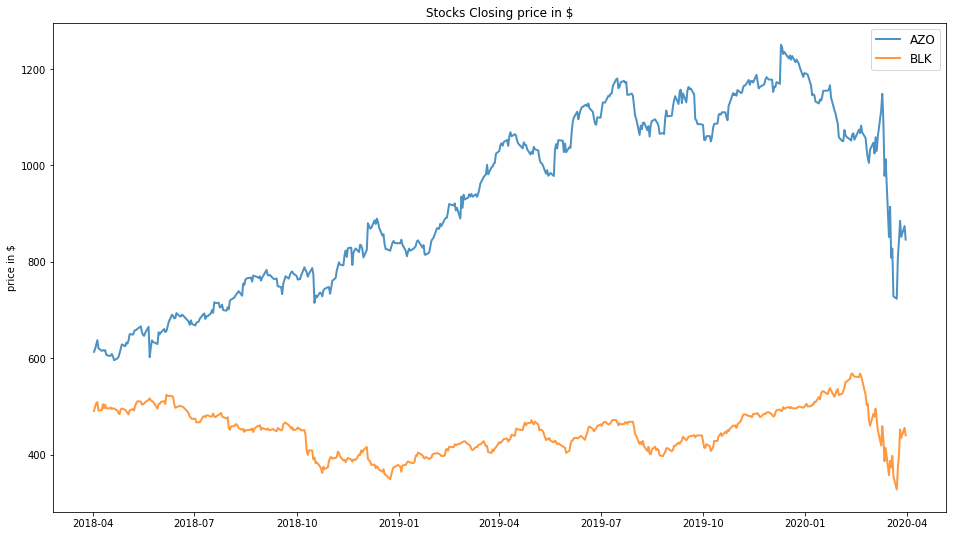

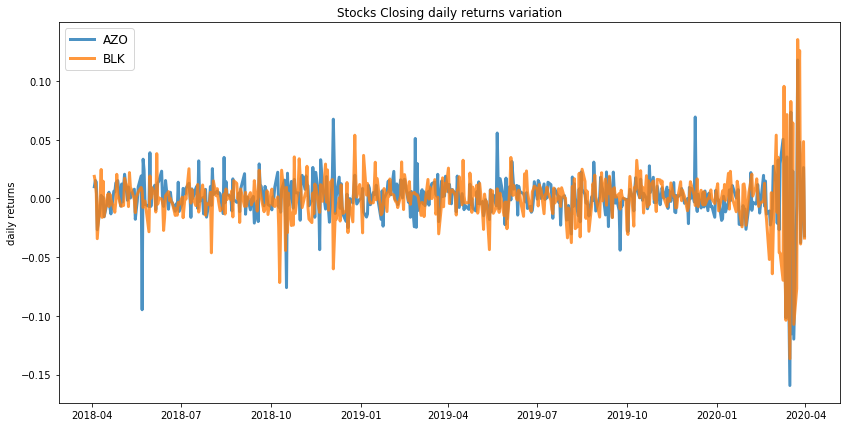

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.43
Annualised Volatility: 0.45


              AZO  BLK
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.25
Annualised Volatility: 0.41


              AZO    BLK
allocation  58.69  41.31


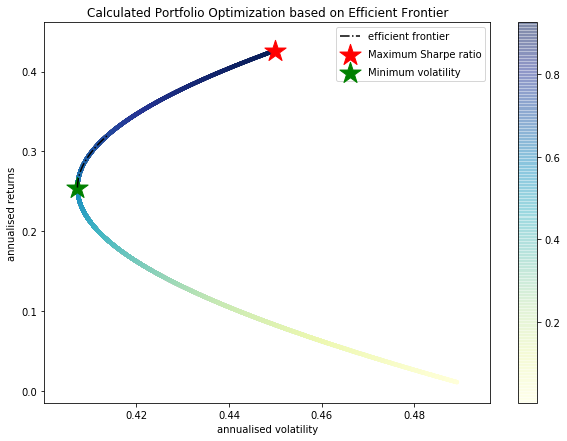

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.43 , annualised volatility: 0.45
BLK : annuaised return 0.01 , annualised volatility: 0.49
--------------------------------------------------------------------------------


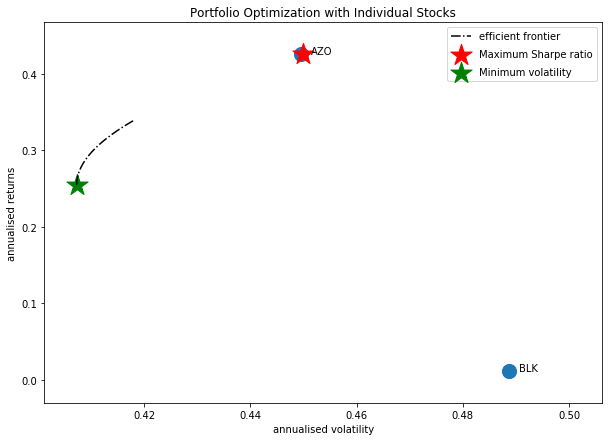

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'EQIX', 'BIIB', 'ANTM', 'CVS']


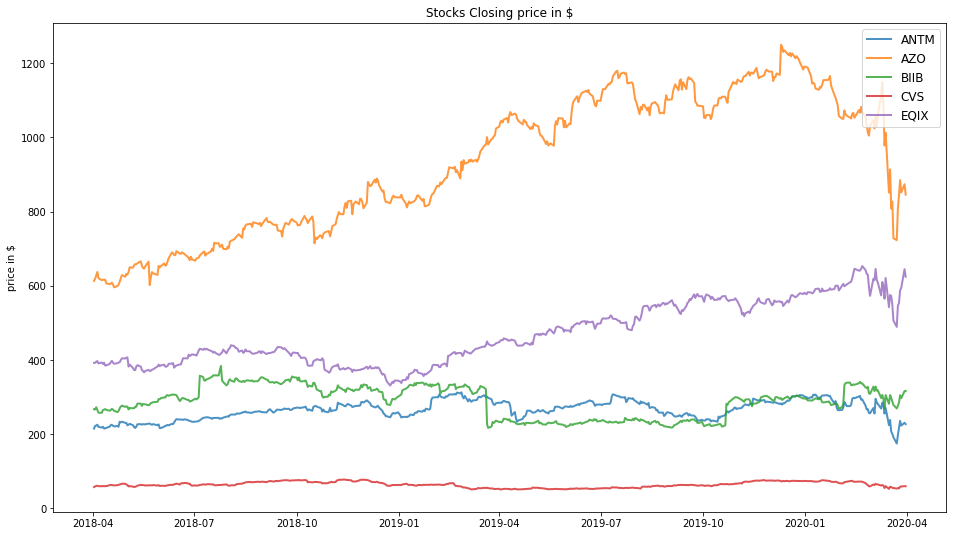

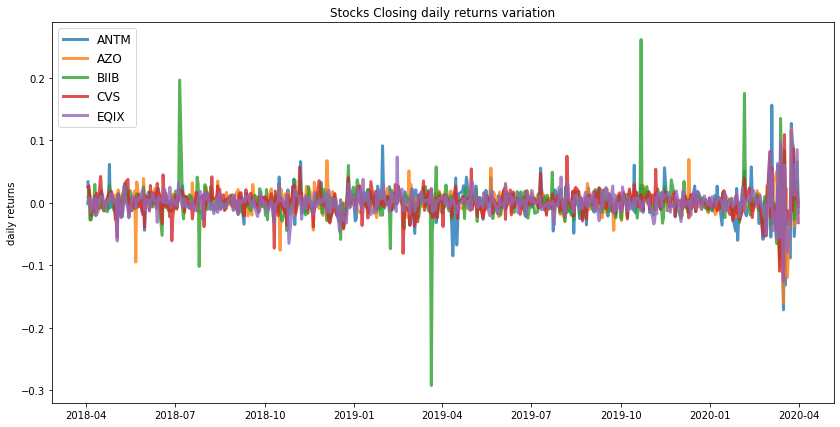

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.51
Annualised Volatility: 0.37


            ANTM    AZO  BIIB  CVS   EQIX
allocation   0.0  26.33   6.6  0.0  67.07
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.4
Annualised Volatility: 0.34


            ANTM   AZO  BIIB    CVS   EQIX
allocation   0.0  31.8   9.3  23.05  35.85


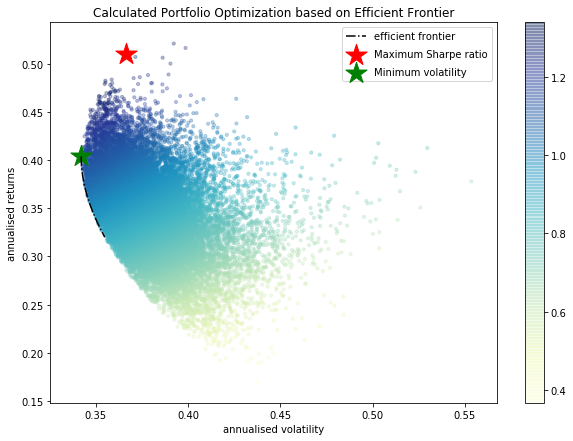

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ANTM : annuaised return 0.21 , annualised volatility: 0.55
AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


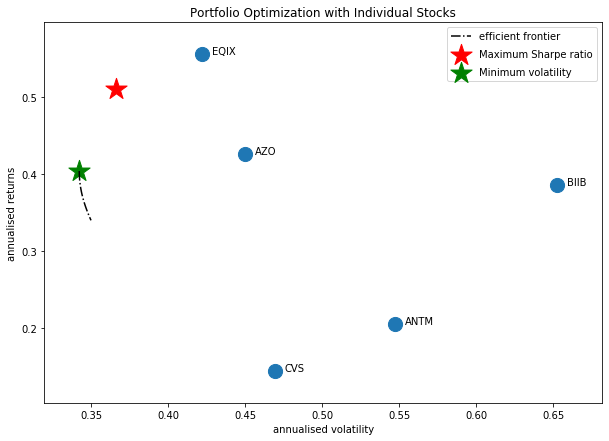

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AMD', 'CXO', 'SHW', 'EQIX', 'AMGN', 'BIIB', 'MMM', 'CVS', 'ABC']


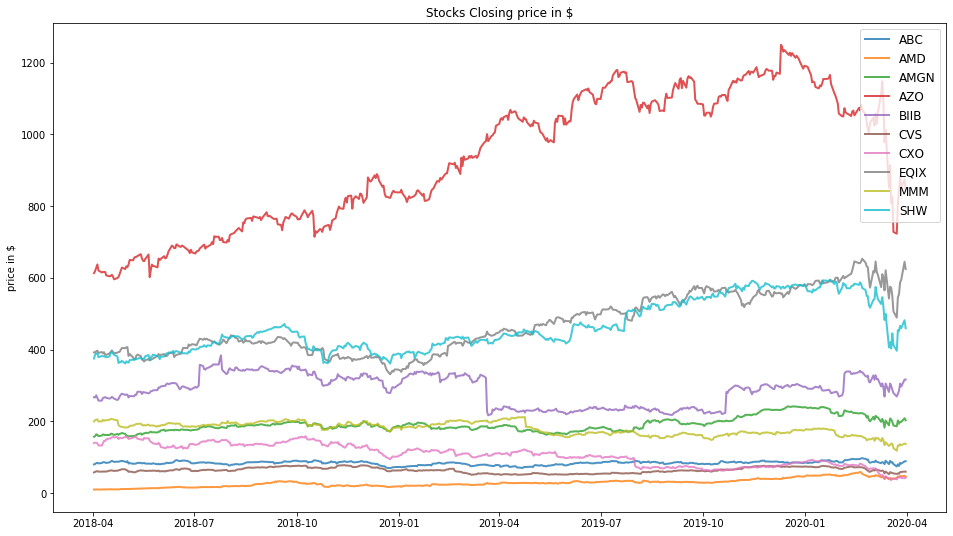

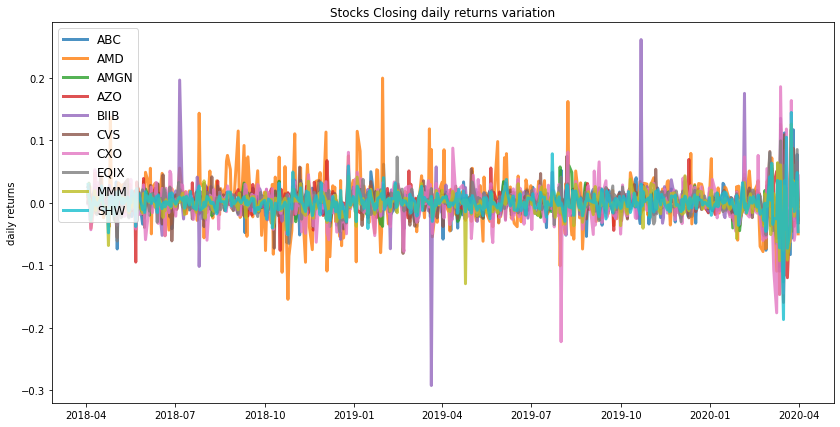

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.37
Annualised Volatility: 0.6


            ABC    AMD  AMGN   AZO  BIIB  CVS  CXO   EQIX  MMM  SHW
allocation  0.0  58.72   0.0  9.16   0.2  0.0  0.0  31.92  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.25
Annualised Volatility: 0.32


            ABC  AMD   AMGN    AZO  BIIB    CVS  CXO  EQIX    MMM   SHW
allocation  0.0  0.0  21.58  22.57  2.91  10.56  0.0  20.2  20.48  1.69


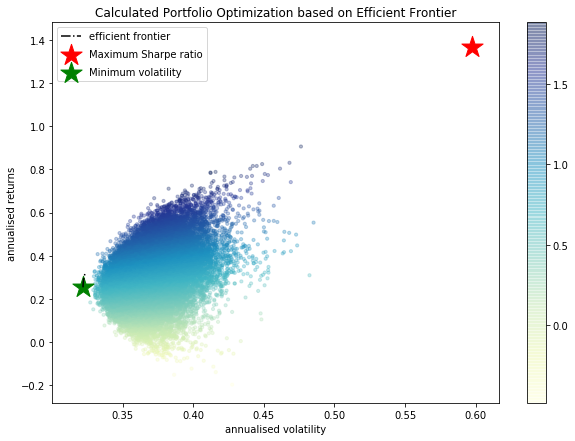

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.23 , annualised volatility: 0.49
AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
SHW : annuaised return 0.3 , annualised volatility: 0.44
--------------------------------------------------------------------------------


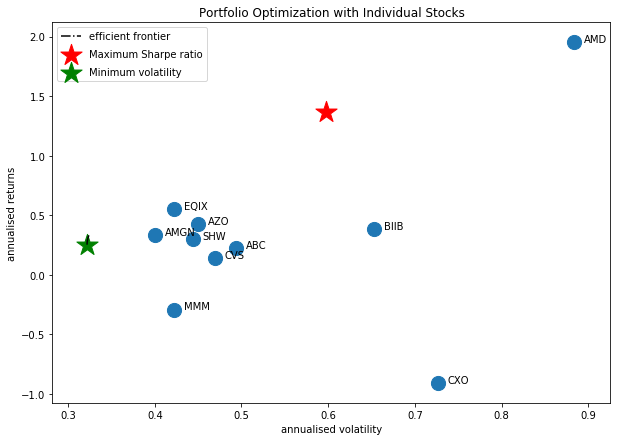

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AMD', 'CXO', 'AMGN', 'BIIB', 'CVS', 'ABC']


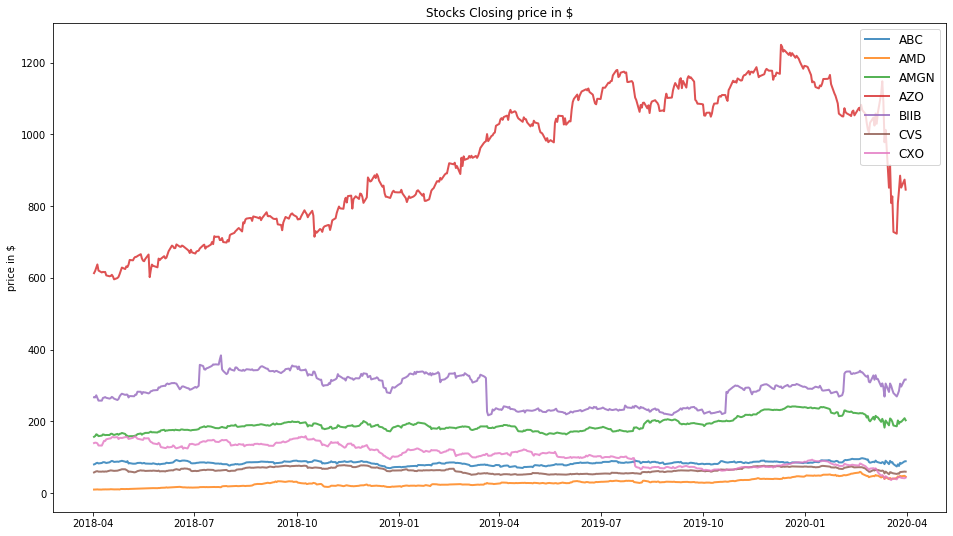

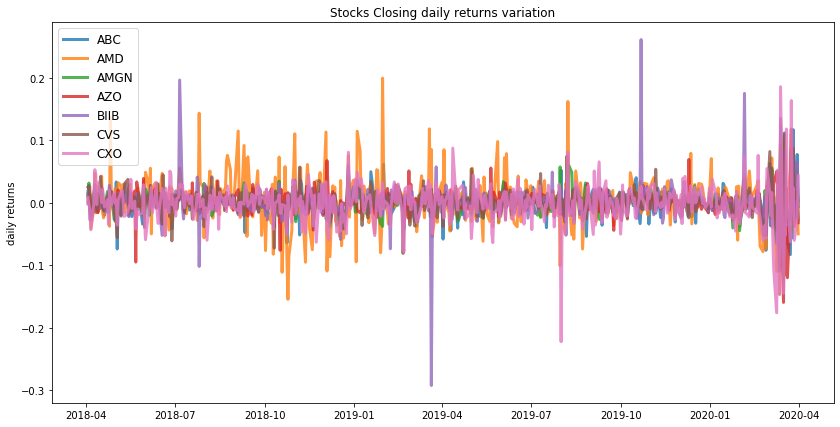

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.55
Annualised Volatility: 0.69


            ABC    AMD  AMGN    AZO  BIIB  CVS  CXO
allocation  0.0  73.38   0.0  21.91  4.71  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.32
Annualised Volatility: 0.34


             ABC  AMD   AMGN    AZO  BIIB    CVS   CXO
allocation  1.61  0.0  42.71  34.95  3.33  16.44  0.97


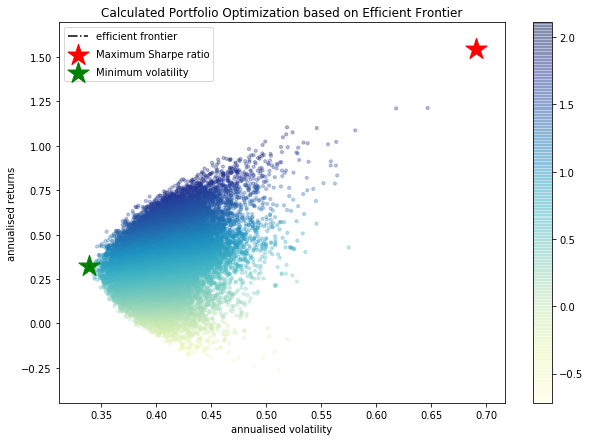

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.23 , annualised volatility: 0.49
AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
--------------------------------------------------------------------------------


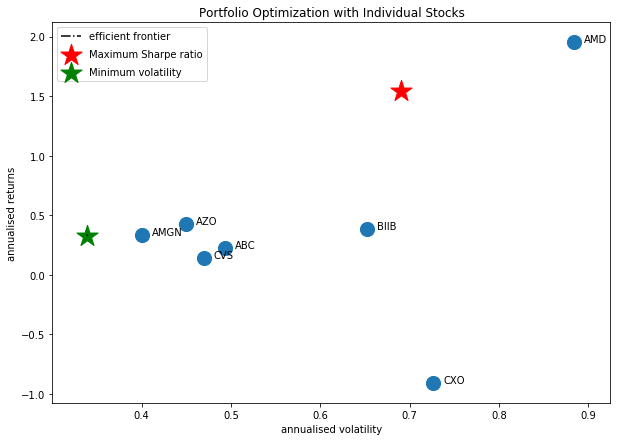

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'GOOGL']


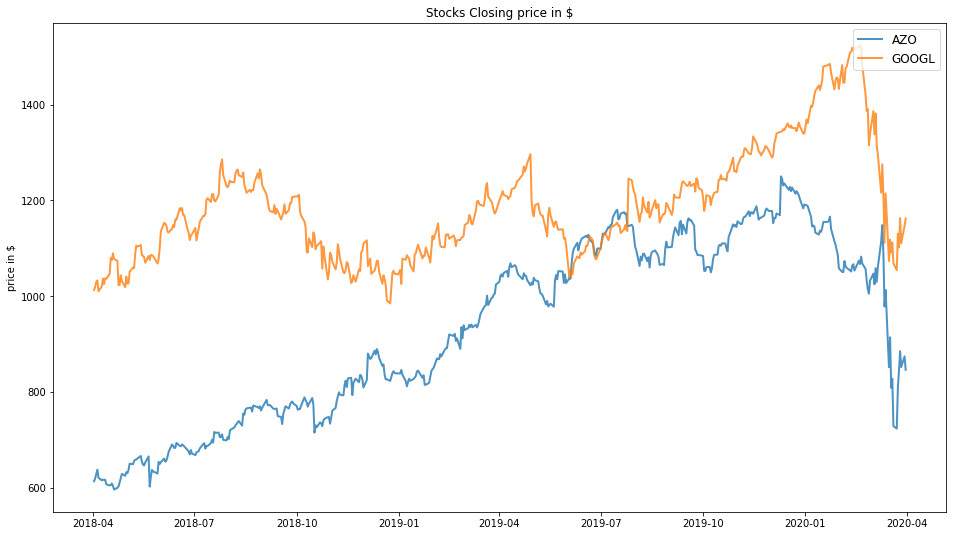

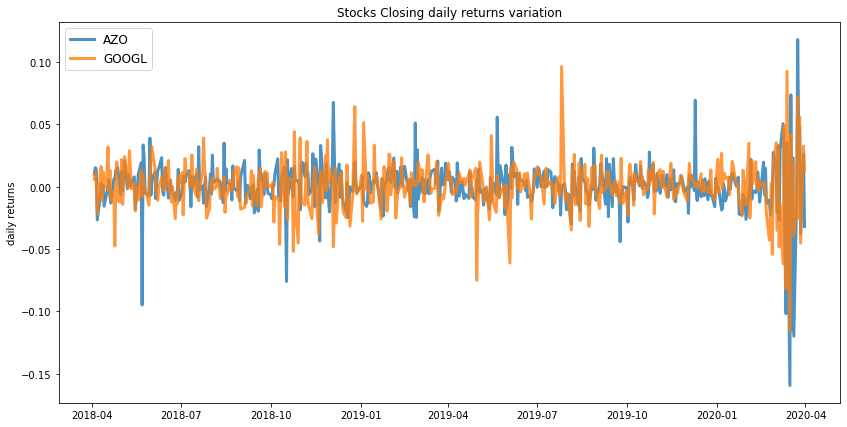

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.39
Annualised Volatility: 0.4


              AZO  GOOGL
allocation  80.65  19.35
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.32
Annualised Volatility: 0.36


              AZO  GOOGL
allocation  46.17  53.83


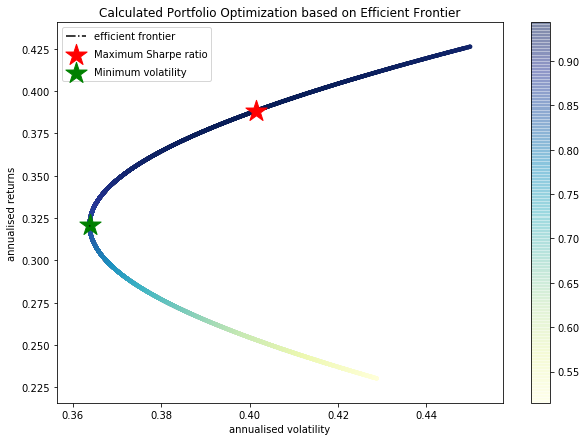

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.43 , annualised volatility: 0.45
GOOGL : annuaised return 0.23 , annualised volatility: 0.43
--------------------------------------------------------------------------------


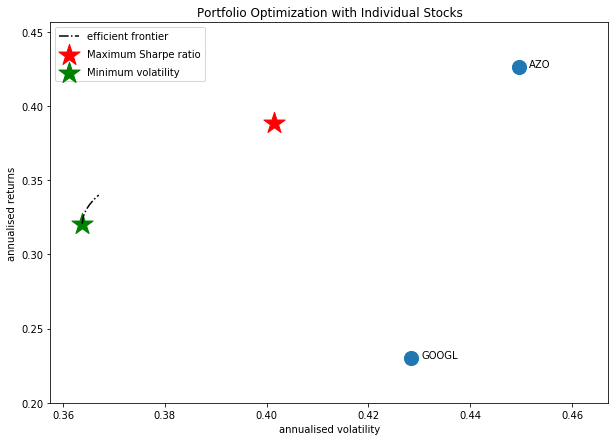

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'CTXS']


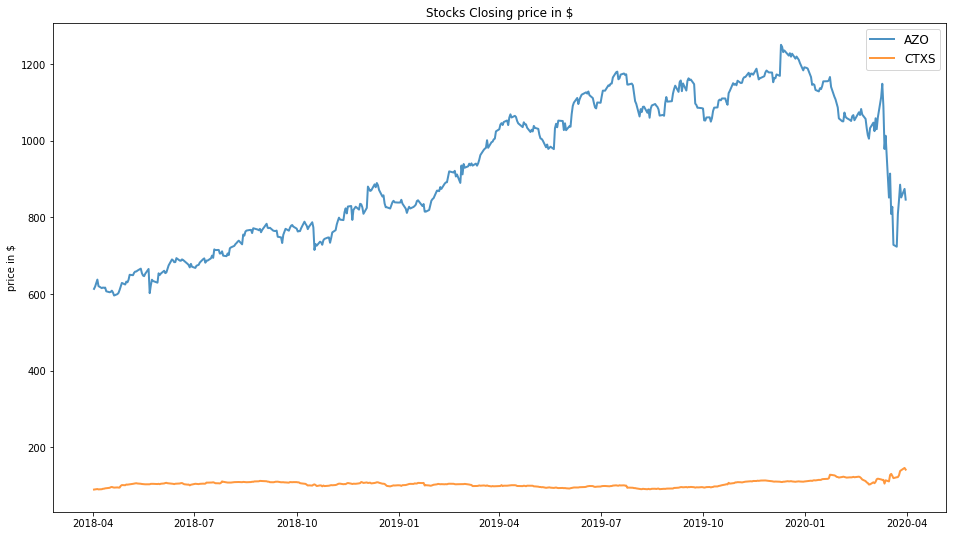

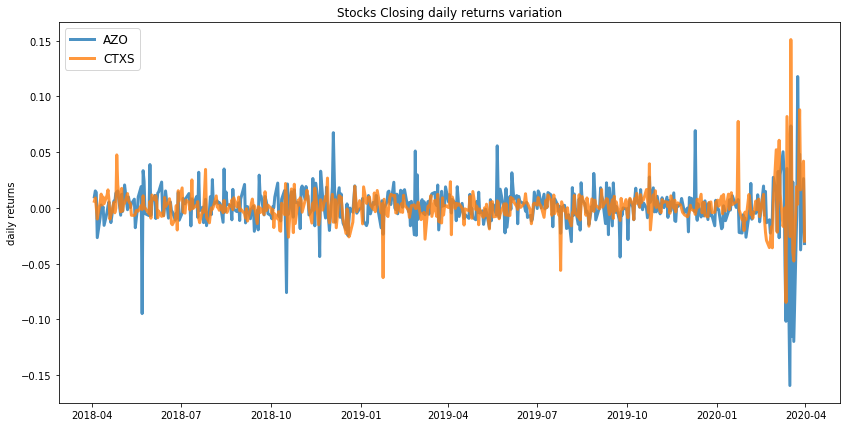

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.5
Annualised Volatility: 0.32


              AZO   CTXS
allocation  21.88  78.12
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.49
Annualised Volatility: 0.32


              AZO   CTXS
allocation  31.02  68.98


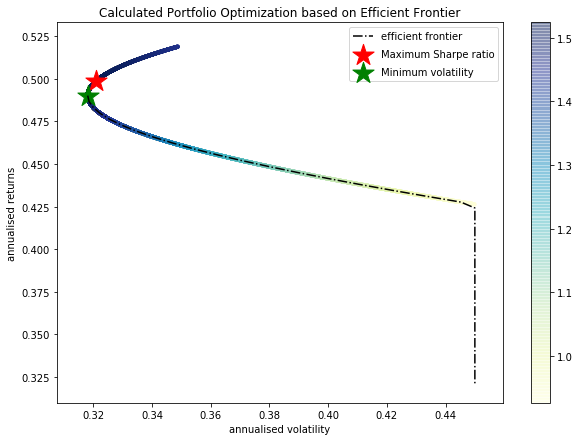

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.43 , annualised volatility: 0.45
CTXS : annuaised return 0.52 , annualised volatility: 0.35
--------------------------------------------------------------------------------


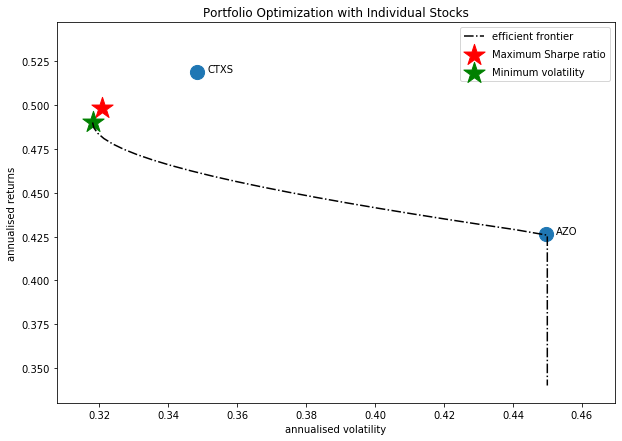

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AMD', 'BIIB', 'CVS', 'BAC']


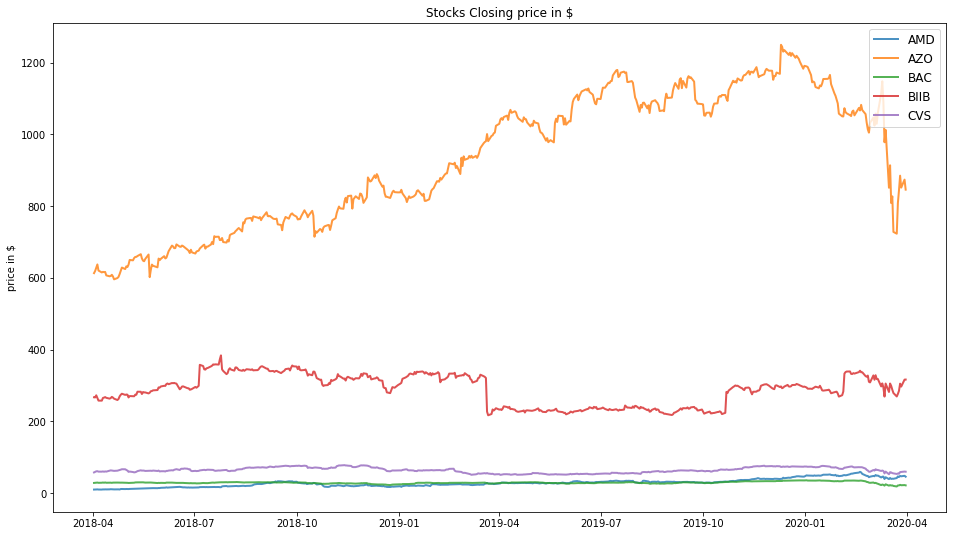

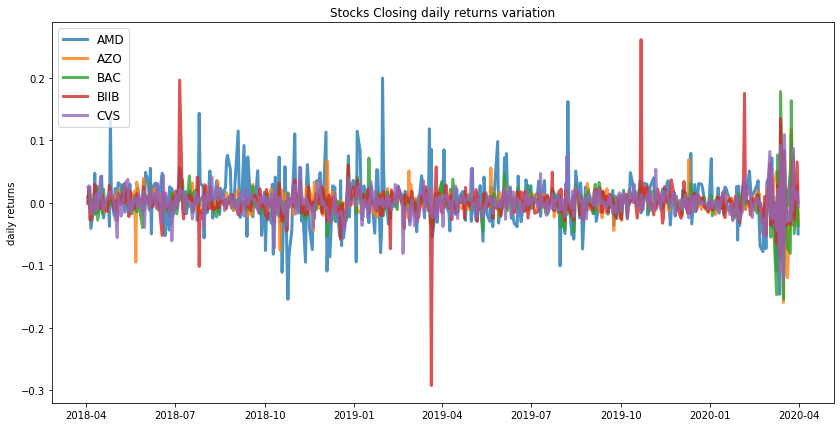

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.55
Annualised Volatility: 0.69


              AMD    AZO  BAC  BIIB  CVS
allocation  73.36  21.92  0.0  4.73  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.28
Annualised Volatility: 0.37


            AMD    AZO   BAC   BIIB    CVS
allocation  0.0  45.41  9.08  12.44  33.08


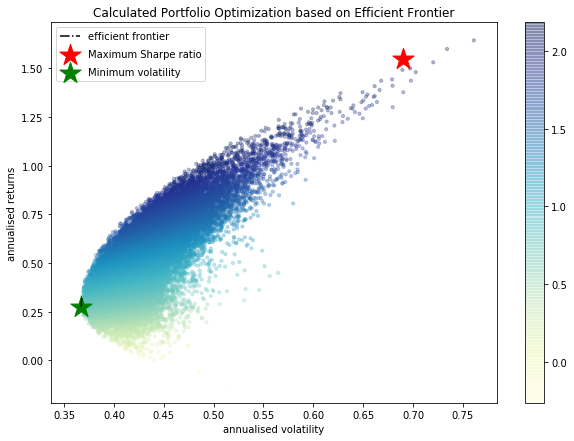

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AZO : annuaised return 0.43 , annualised volatility: 0.45
BAC : annuaised return -0.14 , annualised volatility: 0.52
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
--------------------------------------------------------------------------------


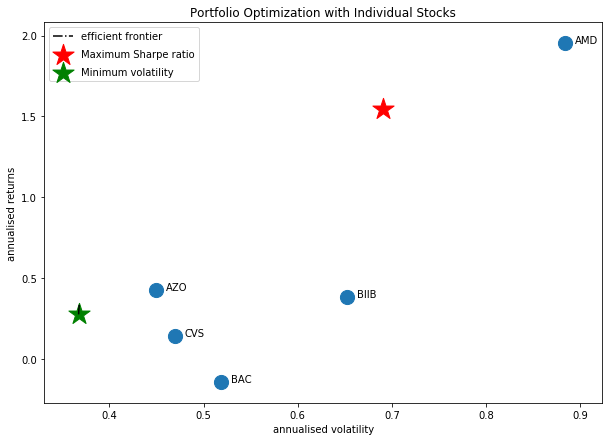

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AMD', 'BIIB', 'CVS', 'GOOG']


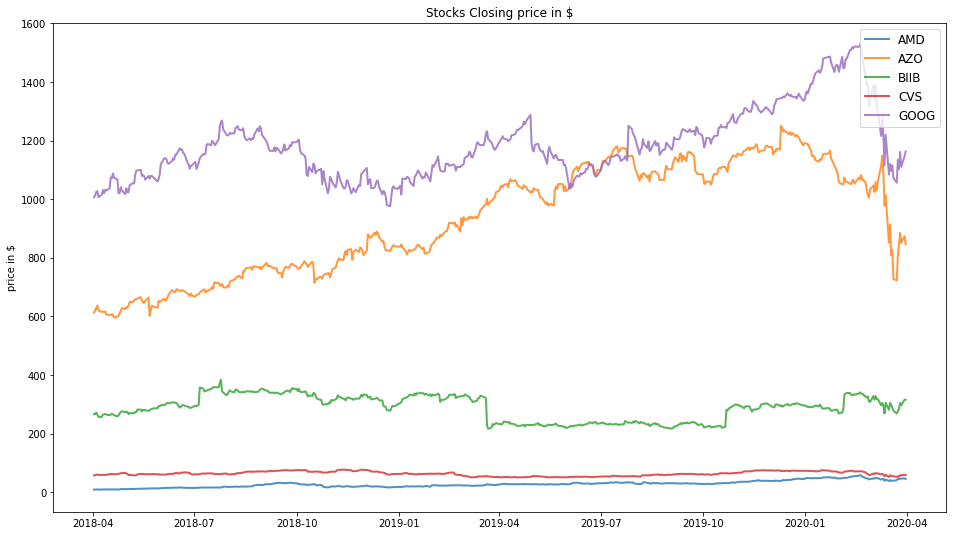

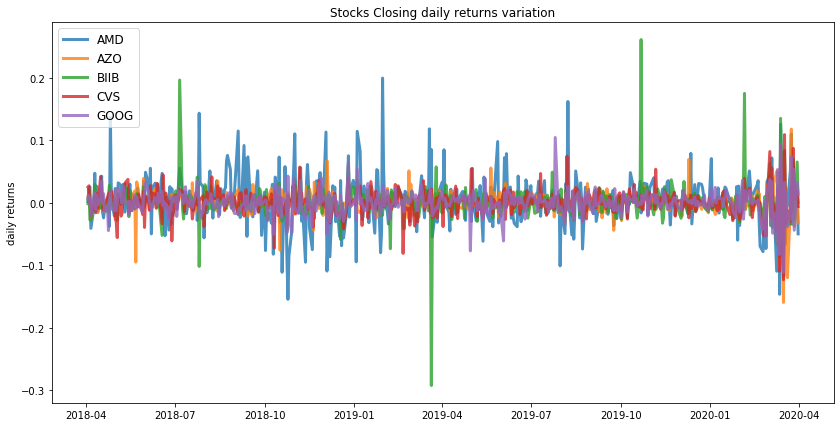

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.55
Annualised Volatility: 0.69


              AMD    AZO  BIIB  CVS  GOOG
allocation  73.36  21.92  4.71  0.0   0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.29
Annualised Volatility: 0.34


            AMD    AZO  BIIB    CVS   GOOG
allocation  0.0  34.55  7.75  22.57  35.12


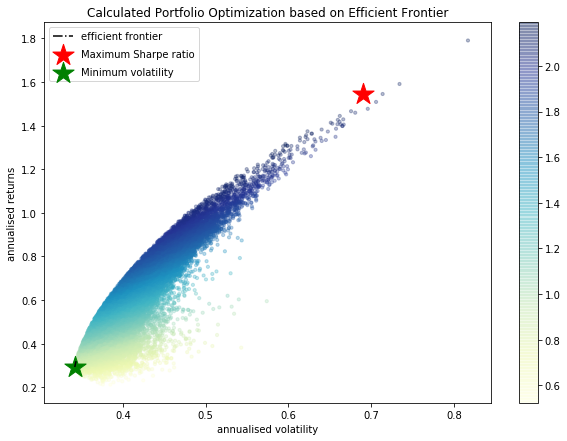

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
GOOG : annuaised return 0.24 , annualised volatility: 0.43
--------------------------------------------------------------------------------


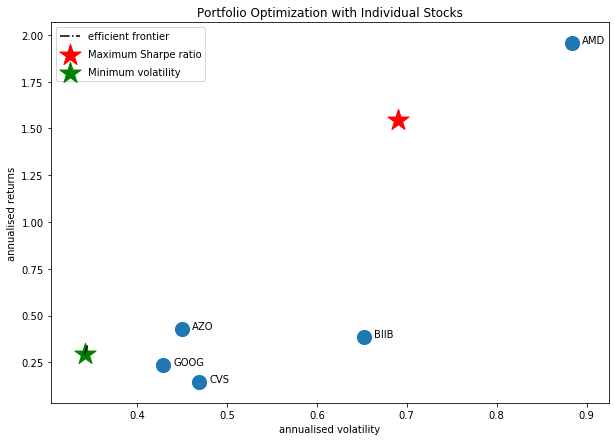

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['APD', 'AZO', 'AMD', 'BIIB', 'CVS']


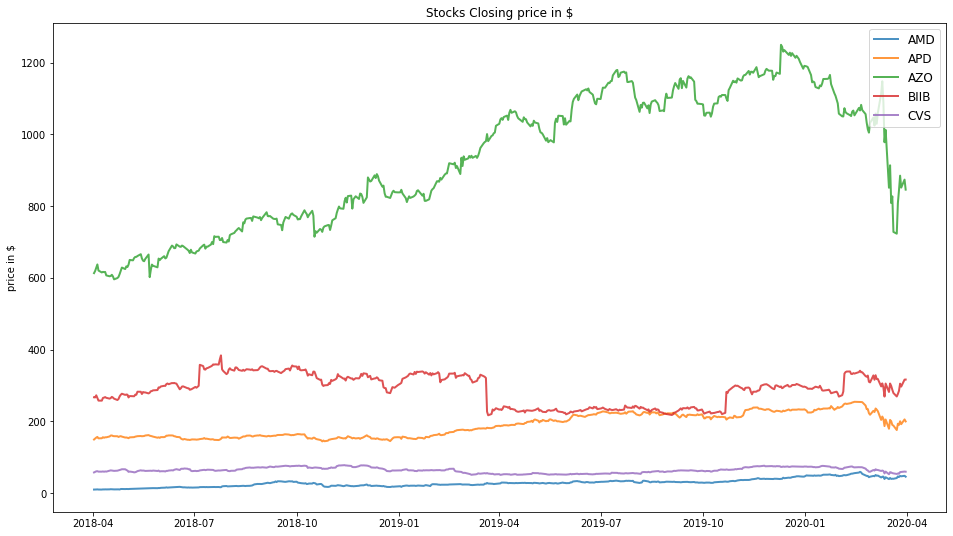

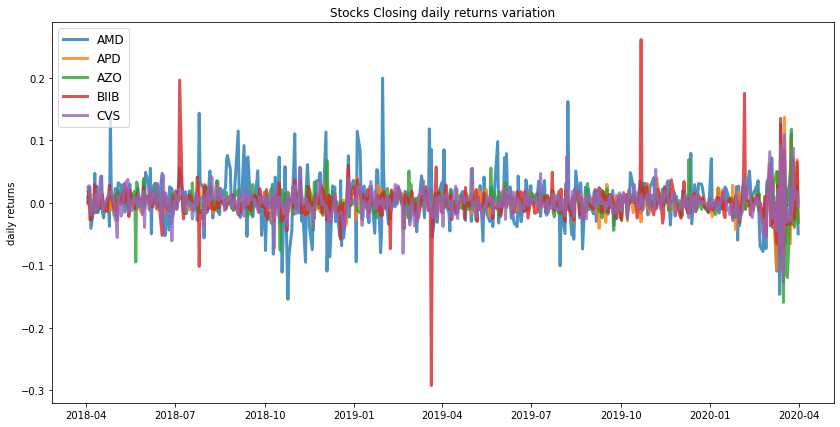

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.55
Annualised Volatility: 0.69


              AMD  APD    AZO  BIIB  CVS
allocation  73.37  0.0  21.92  4.72  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.35


            AMD   APD    AZO   BIIB    CVS
allocation  0.0  34.9  35.02  10.01  20.07


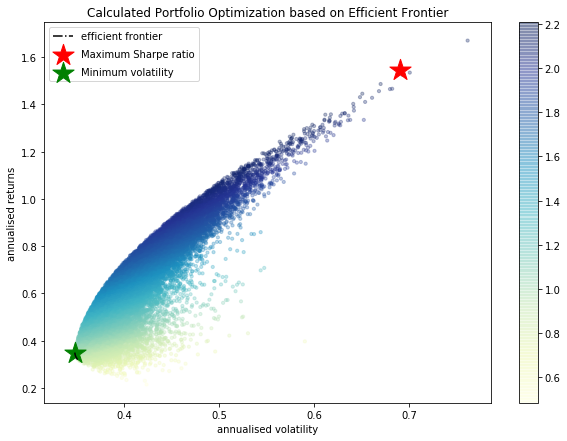

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
APD : annuaised return 0.38 , annualised volatility: 0.42
AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
--------------------------------------------------------------------------------


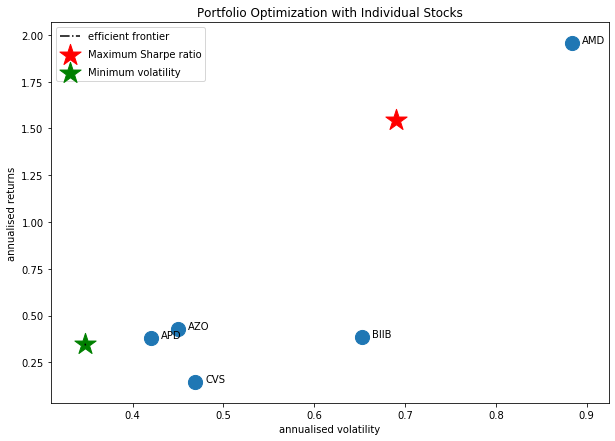

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'HST']


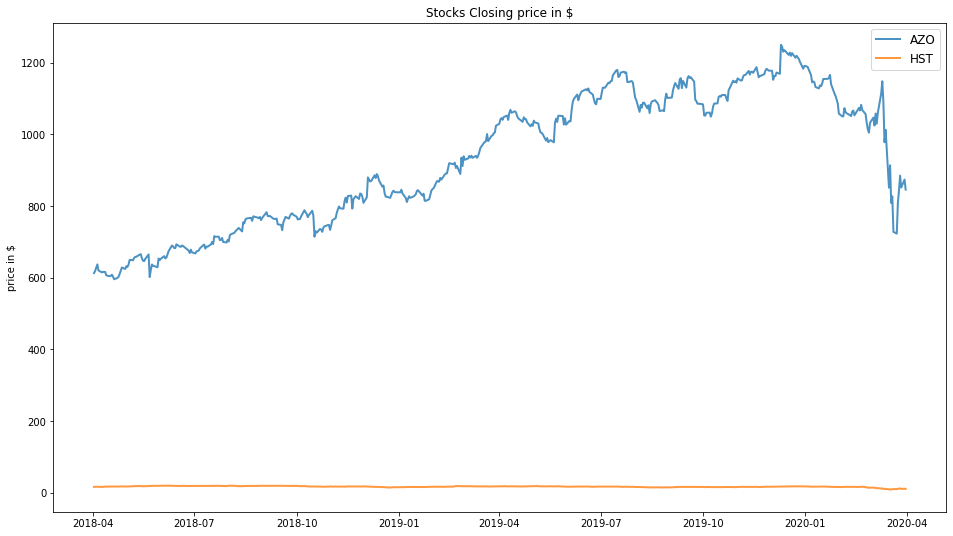

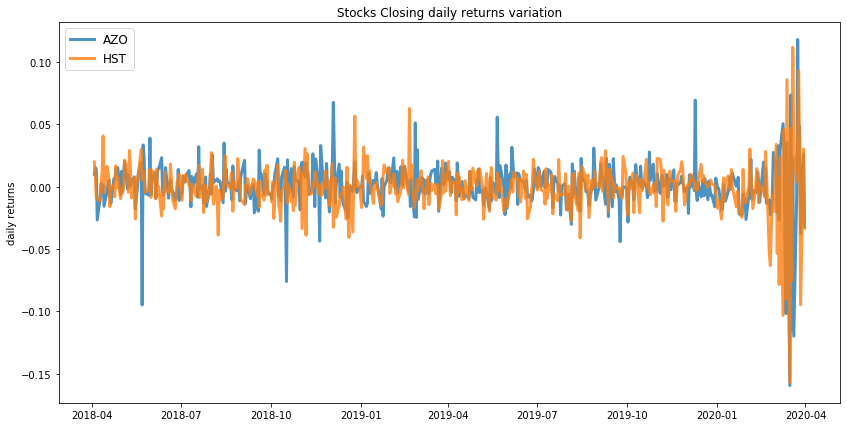

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.43
Annualised Volatility: 0.45


              AZO  HST
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.38


              AZO    HST
allocation  50.89  49.11


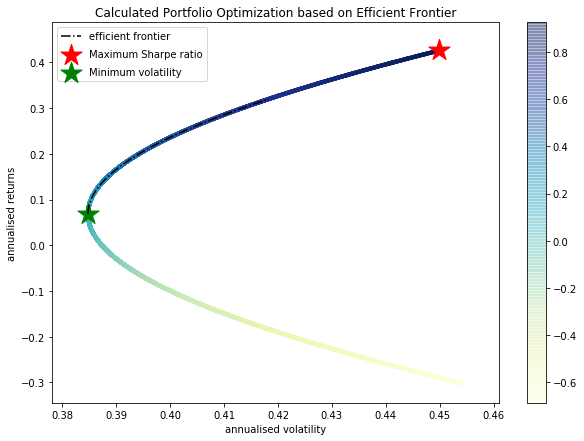

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.43 , annualised volatility: 0.45
HST : annuaised return -0.3 , annualised volatility: 0.45
--------------------------------------------------------------------------------


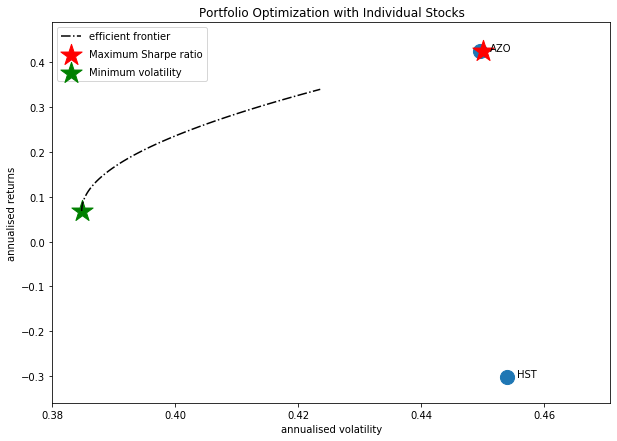

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'PPG']


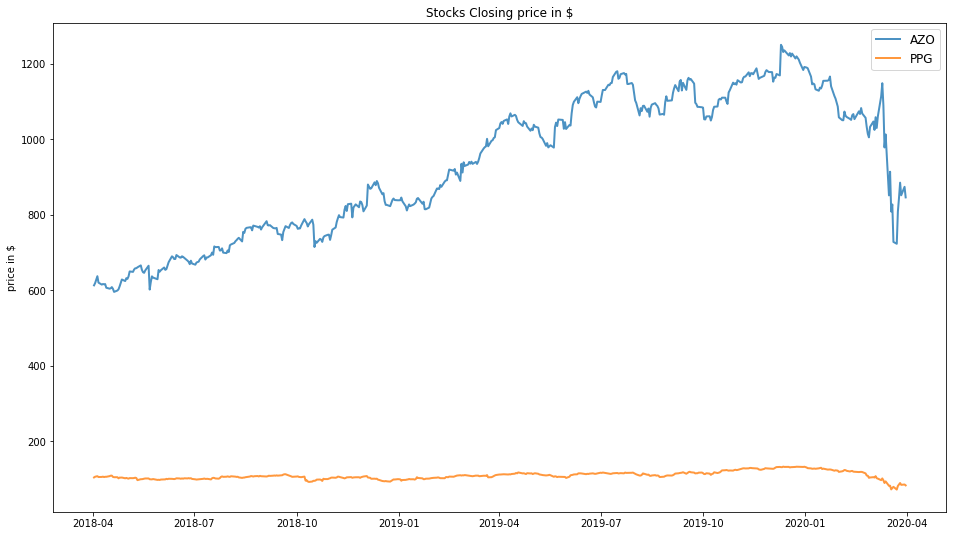

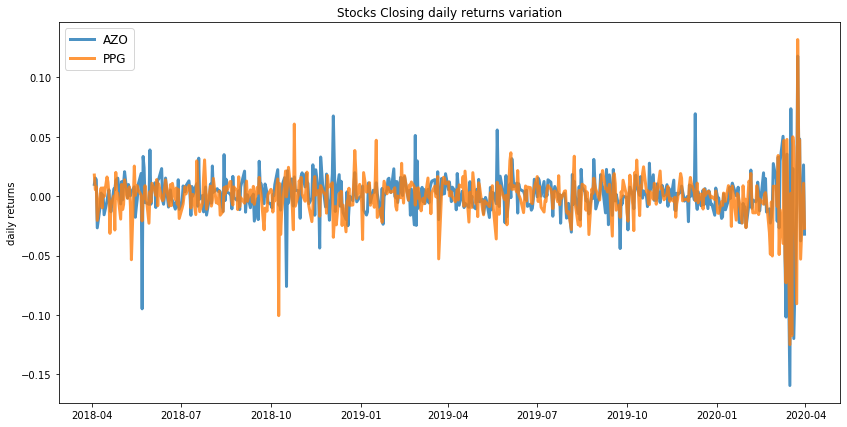

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.43
Annualised Volatility: 0.45


              AZO  PPG
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.12
Annualised Volatility: 0.38


              AZO    PPG
allocation  44.49  55.51


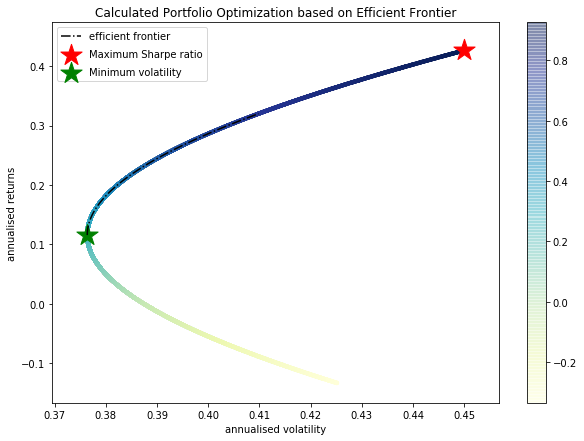

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AZO : annuaised return 0.43 , annualised volatility: 0.45
PPG : annuaised return -0.13 , annualised volatility: 0.42
--------------------------------------------------------------------------------


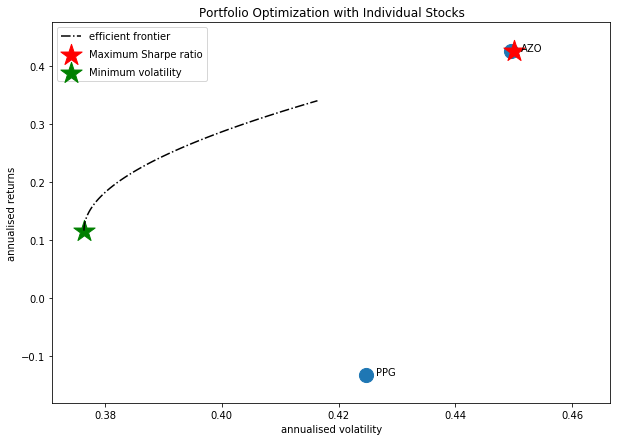

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['HST', 'AMZN']


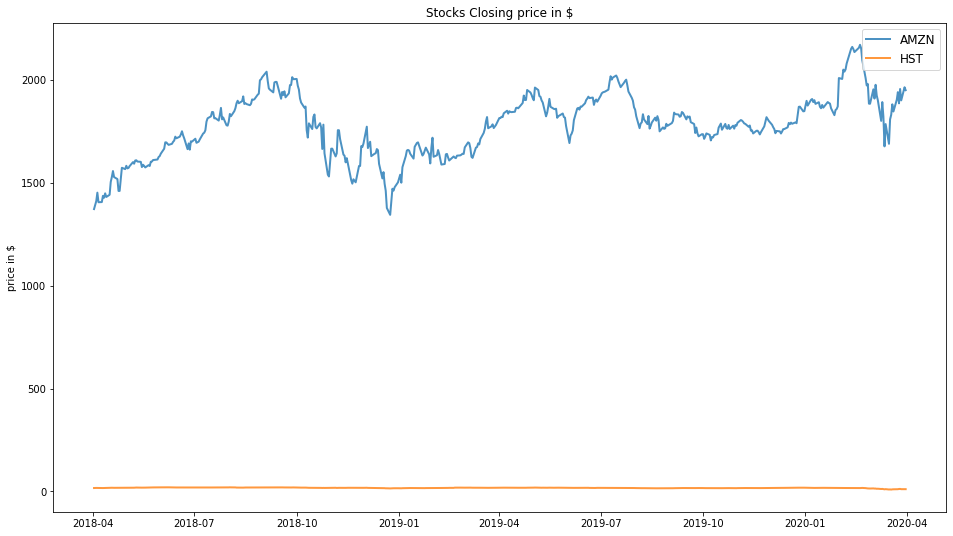

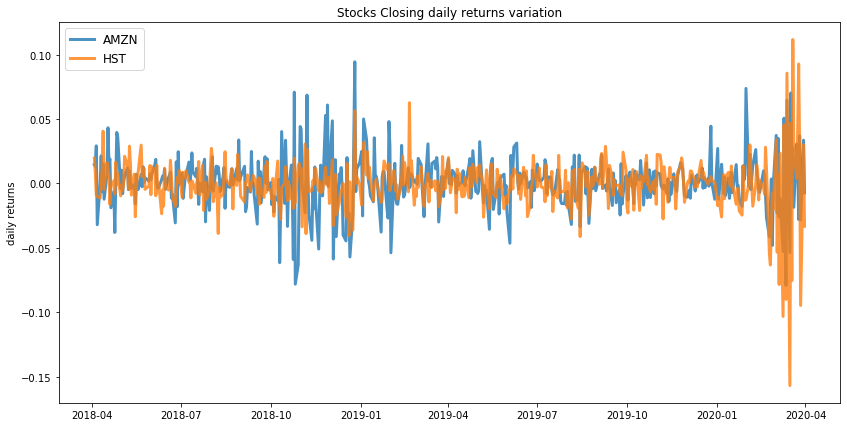

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.46
Annualised Volatility: 0.46


             AMZN  HST
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.39


            AMZN   HST
allocation  50.0  50.0


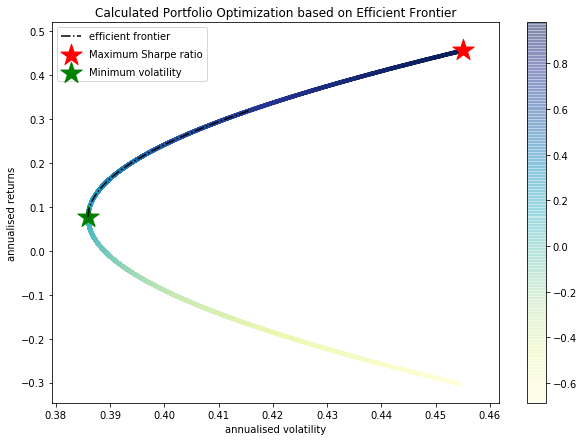

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMZN : annuaised return 0.46 , annualised volatility: 0.45
HST : annuaised return -0.3 , annualised volatility: 0.45
--------------------------------------------------------------------------------


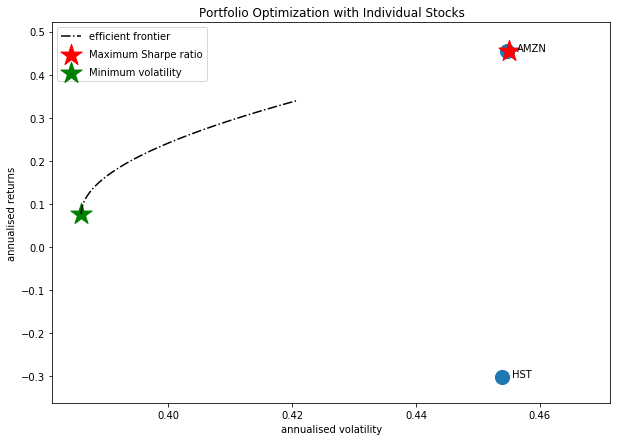

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CVS', 'AMD', 'SHW']


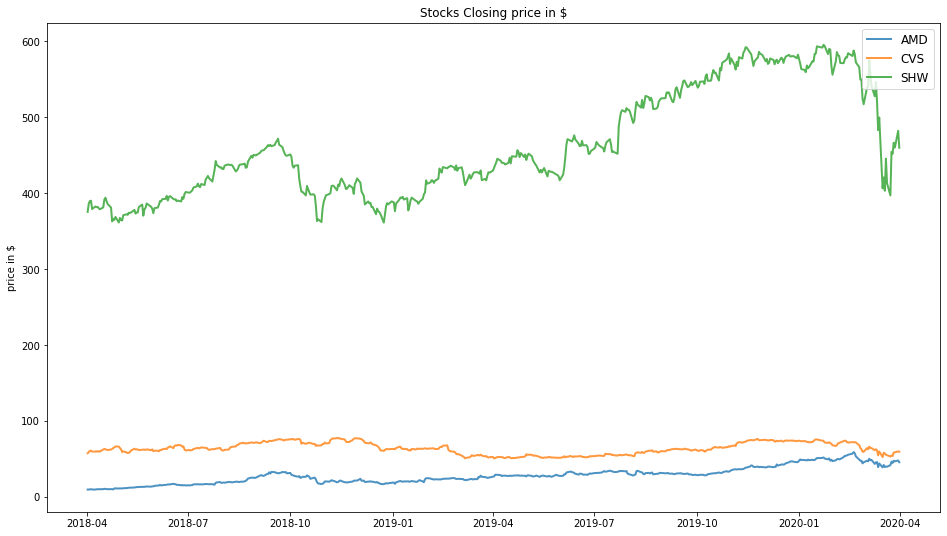

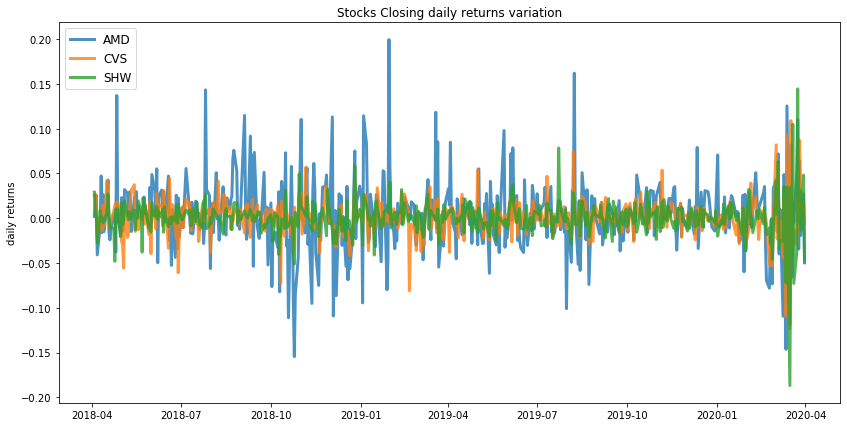

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.96
Annualised Volatility: 0.88


              AMD  CVS  SHW
allocation  100.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.23
Annualised Volatility: 0.39


            AMD    CVS    SHW
allocation  0.0  45.04  54.96


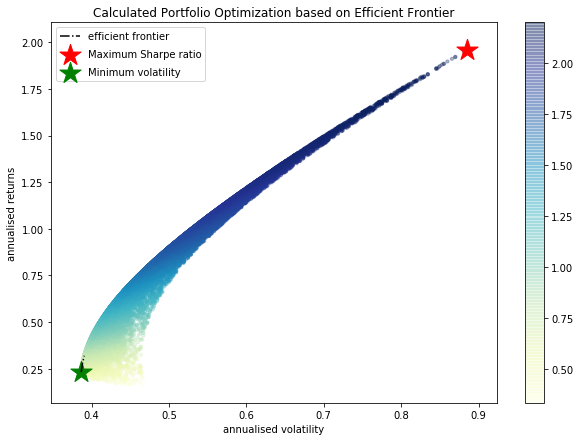

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
CVS : annuaised return 0.14 , annualised volatility: 0.47
SHW : annuaised return 0.3 , annualised volatility: 0.44
--------------------------------------------------------------------------------


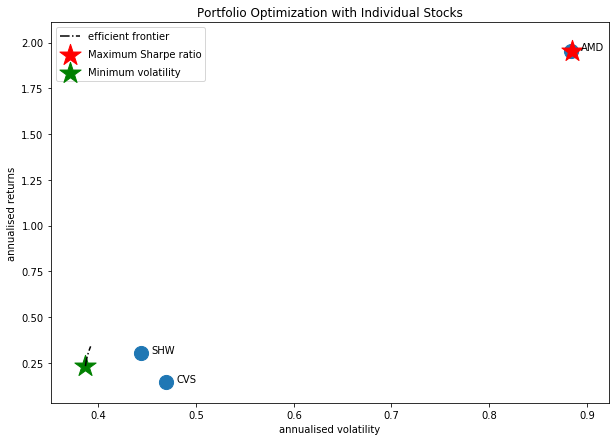

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMD', 'AMGN', 'BIIB', 'MMM', 'CVS']


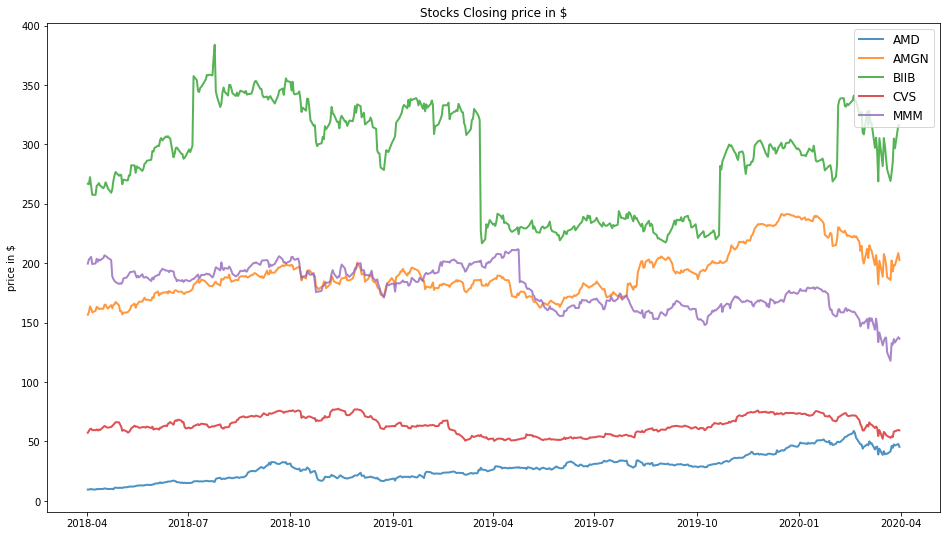

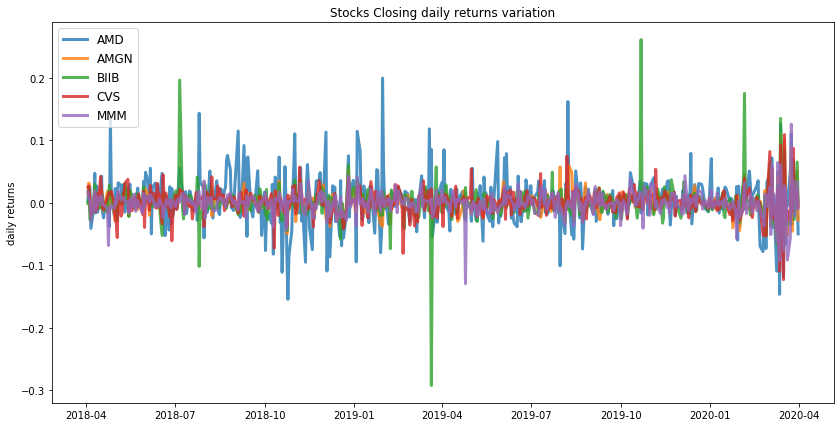

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


              AMD  AMGN  BIIB  CVS  MMM
allocation  91.18   0.0  8.82  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.35


            AMD   AMGN  BIIB    CVS    MMM
allocation  0.0  39.09  3.98  20.55  36.39


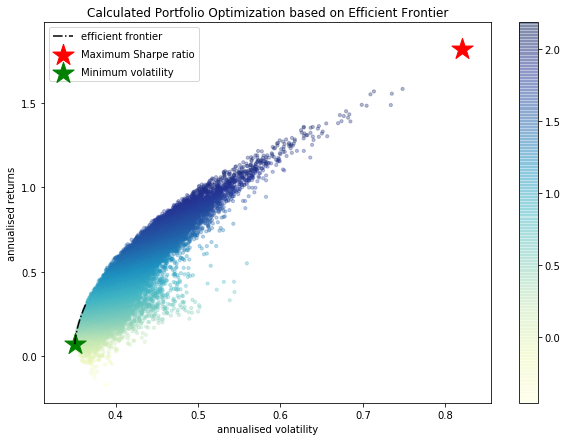

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


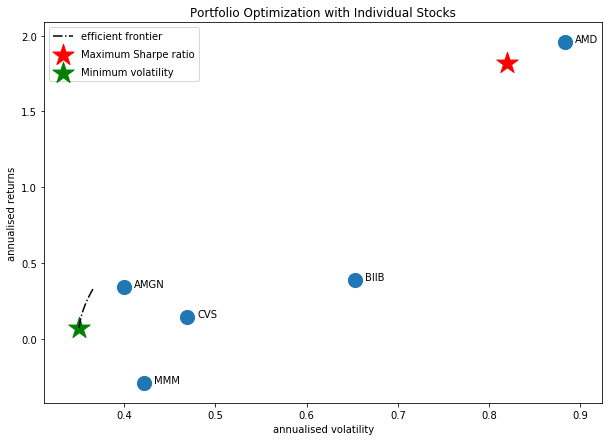

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AAPL', 'AMD']


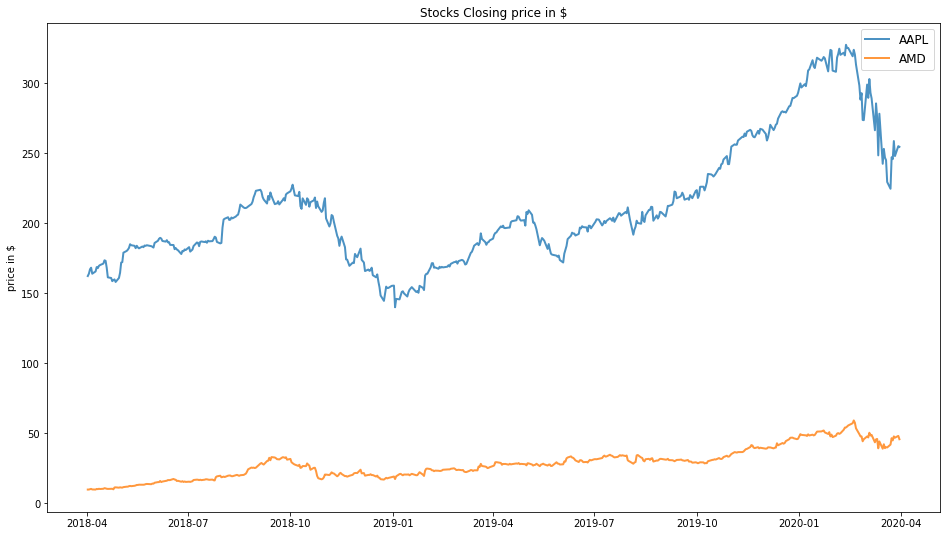

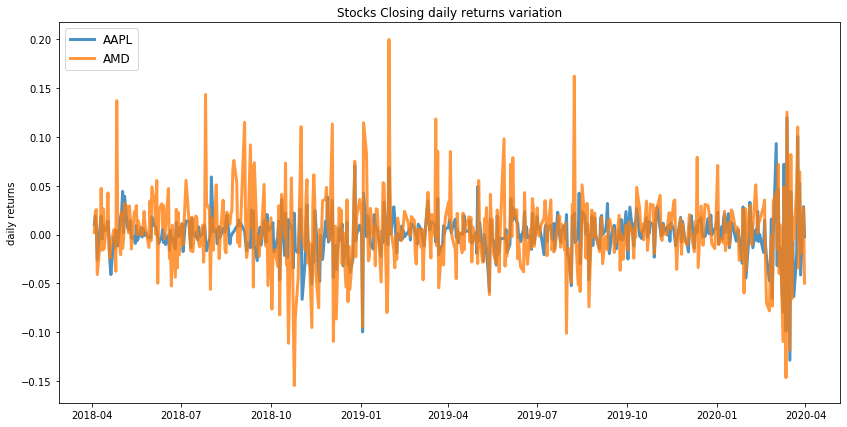

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.96
Annualised Volatility: 0.88


            AAPL    AMD
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.61
Annualised Volatility: 0.49


            AAPL  AMD
allocation  97.6  2.4


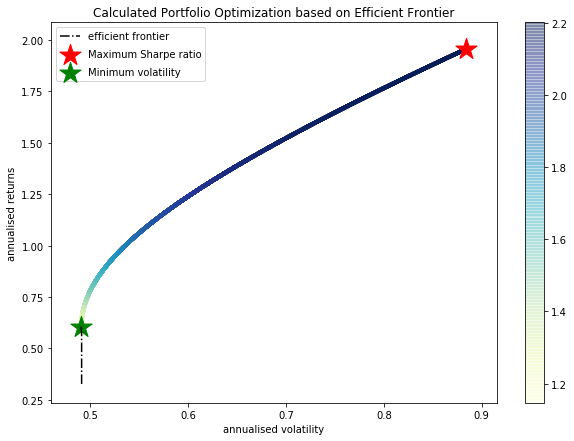

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMD : annuaised return 1.96 , annualised volatility: 0.88
--------------------------------------------------------------------------------


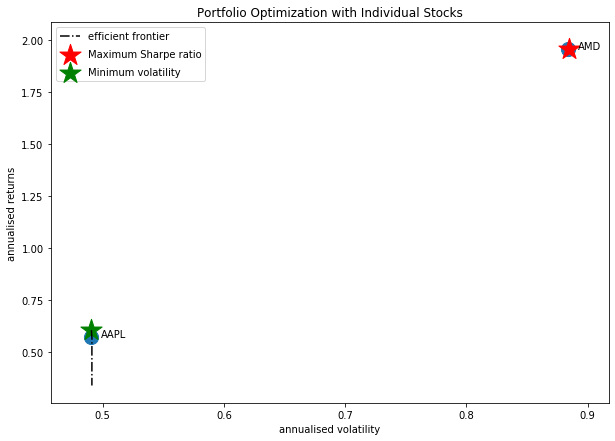

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMD', 'AMGN', 'BIIB', 'CVS', 'PCG']


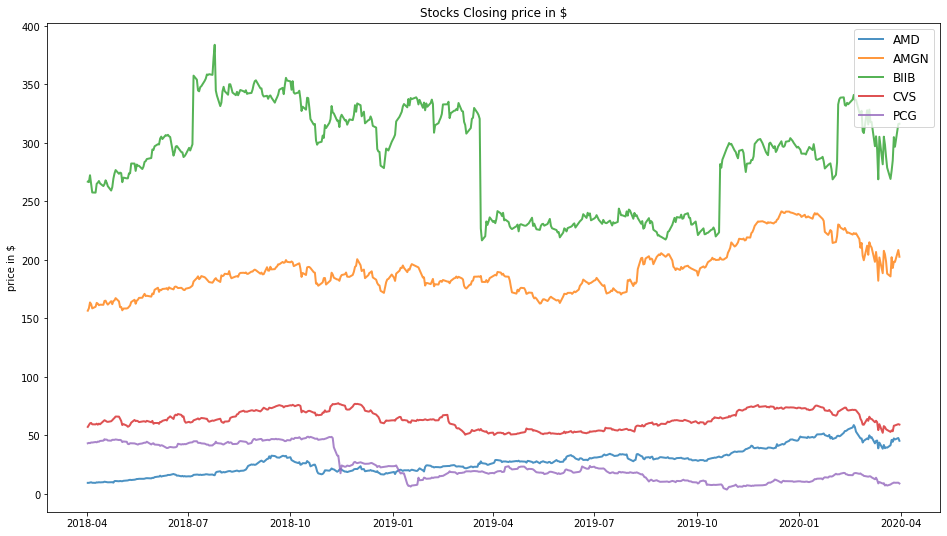

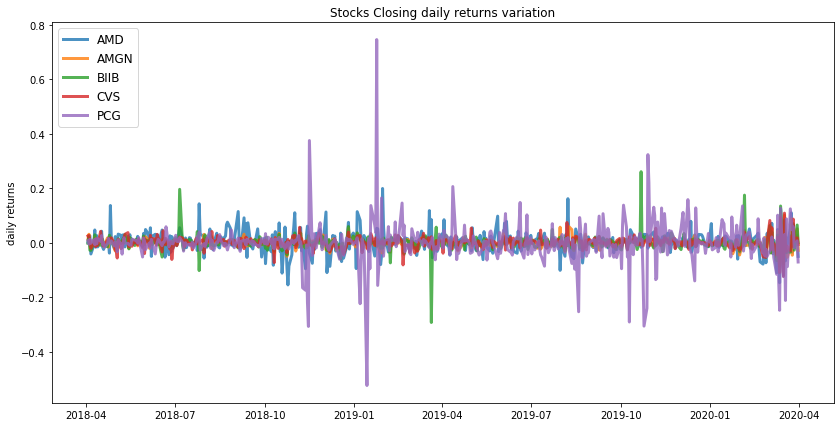

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


              AMD  AMGN  BIIB  CVS  PCG
allocation  91.18   0.0  8.82  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.28
Annualised Volatility: 0.37


             AMD   AMGN  BIIB    CVS   PCG
allocation  0.31  62.21  5.22  30.71  1.55


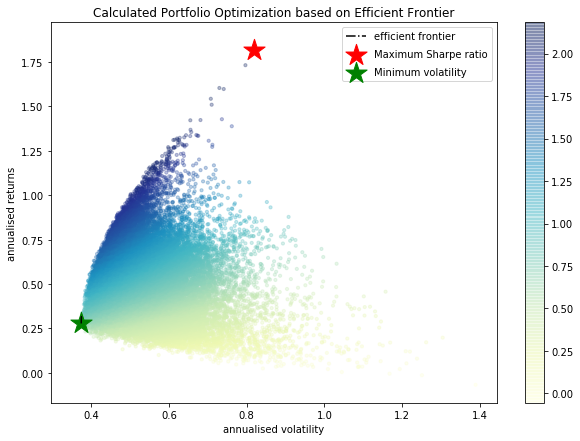

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
PCG : annuaised return -0.16 , annualised volatility: 1.67
--------------------------------------------------------------------------------


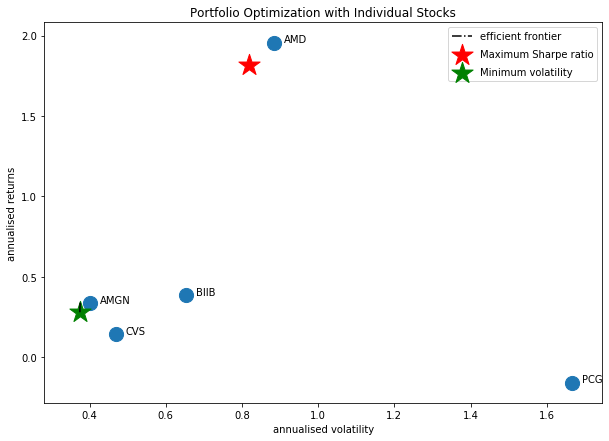

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['DHI', 'AMD']


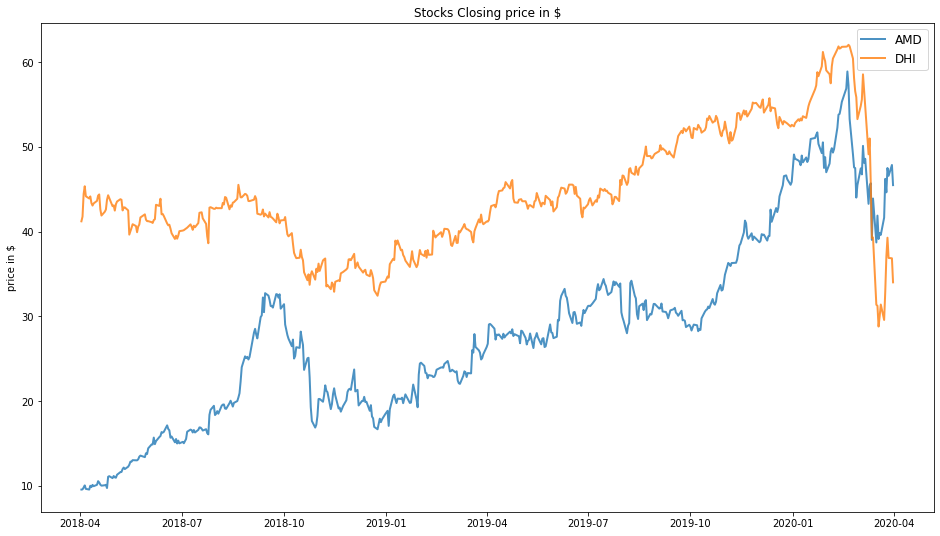

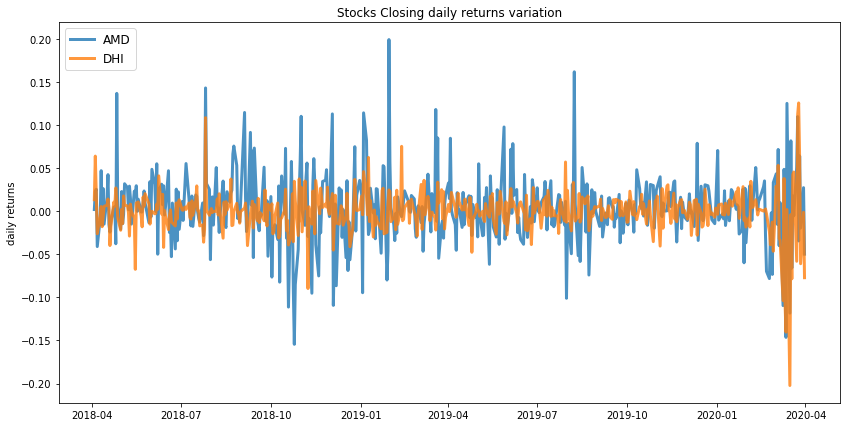

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.96
Annualised Volatility: 0.88


              AMD  DHI
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.34
Annualised Volatility: 0.53


              AMD    DHI
allocation  18.94  81.06


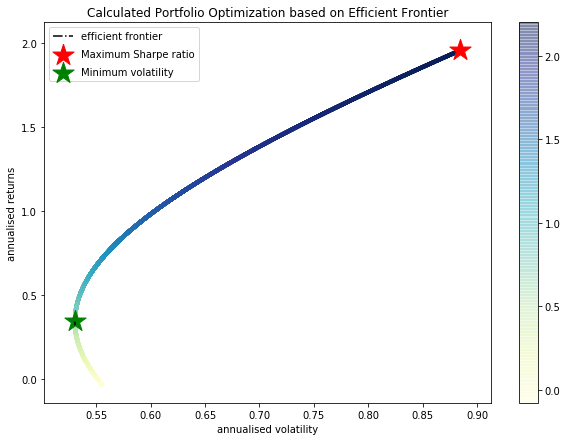

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
DHI : annuaised return -0.03 , annualised volatility: 0.55
--------------------------------------------------------------------------------


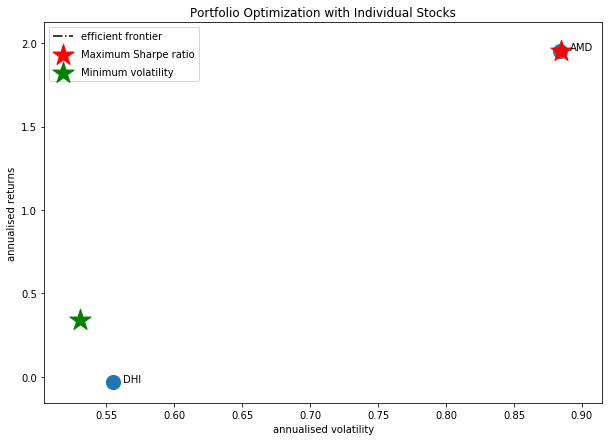

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ALXN', 'AMD']


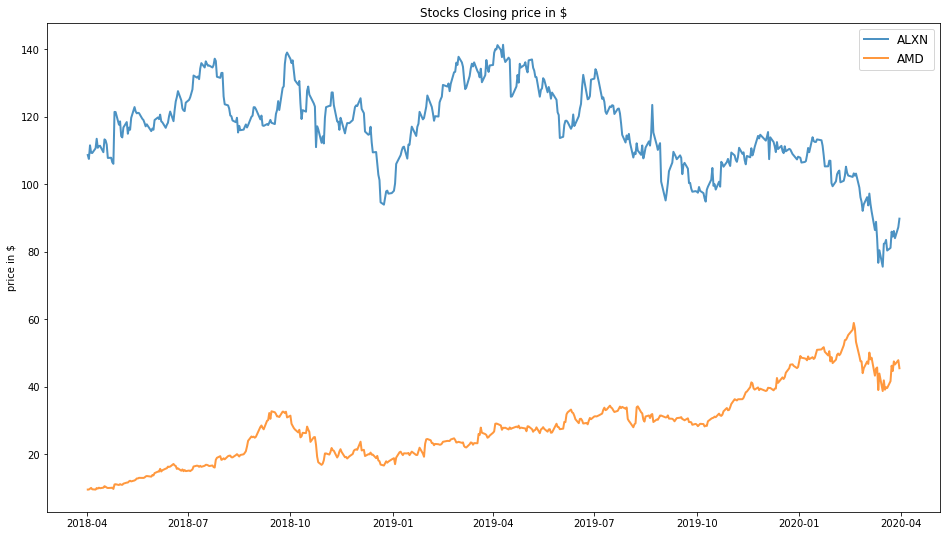

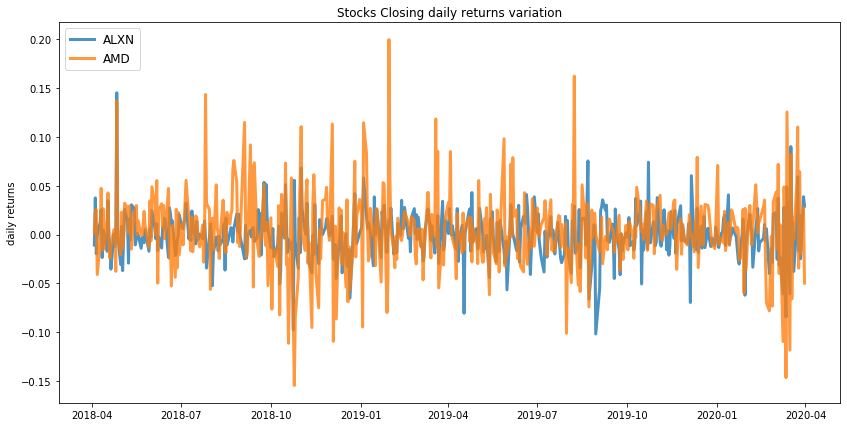

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.96
Annualised Volatility: 0.88


            ALXN    AMD
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.27
Annualised Volatility: 0.54


             ALXN    AMD
allocation  84.66  15.34


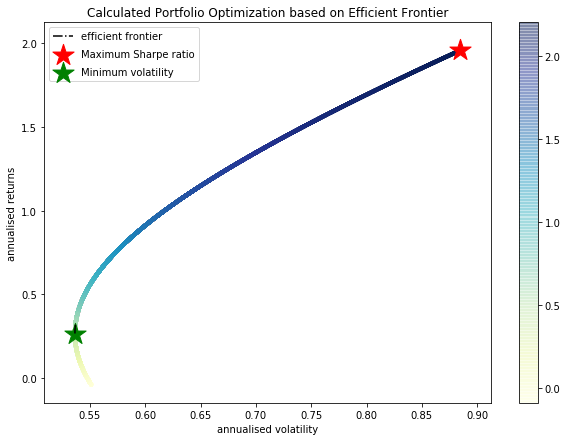

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ALXN : annuaised return -0.04 , annualised volatility: 0.55
AMD : annuaised return 1.96 , annualised volatility: 0.88
--------------------------------------------------------------------------------


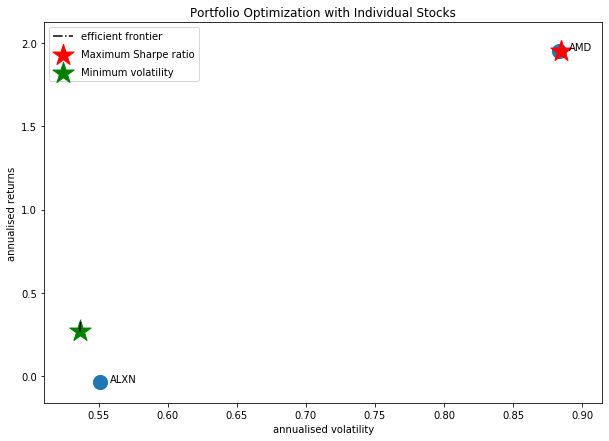

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CMG', 'MMM']


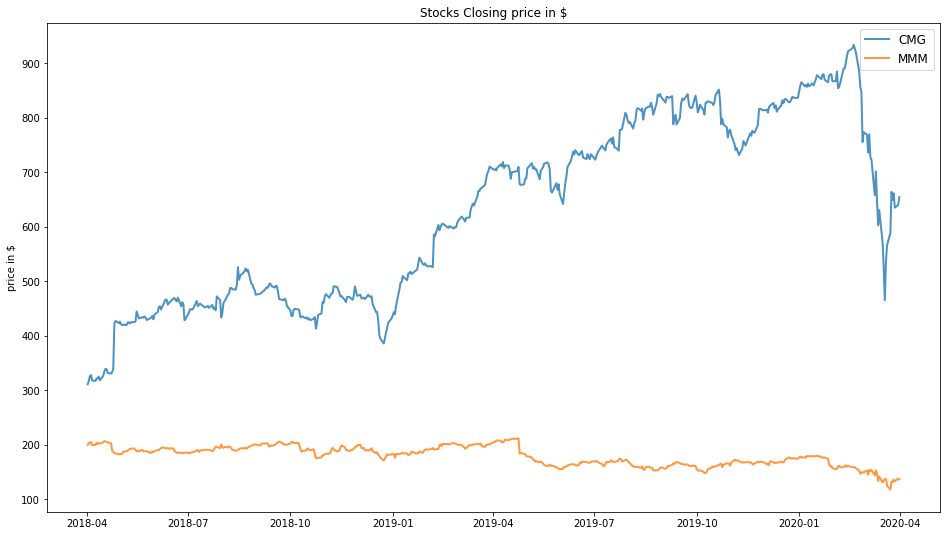

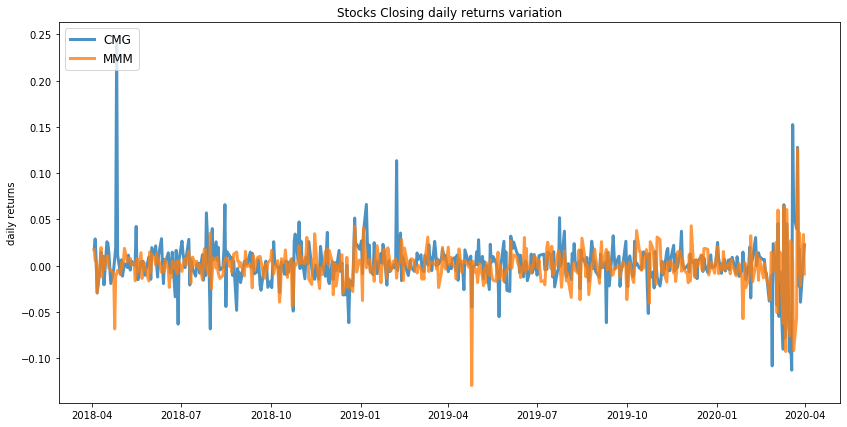

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.91
Annualised Volatility: 0.58


              CMG  MMM
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.08
Annualised Volatility: 0.38


              CMG    MMM
allocation  30.64  69.36


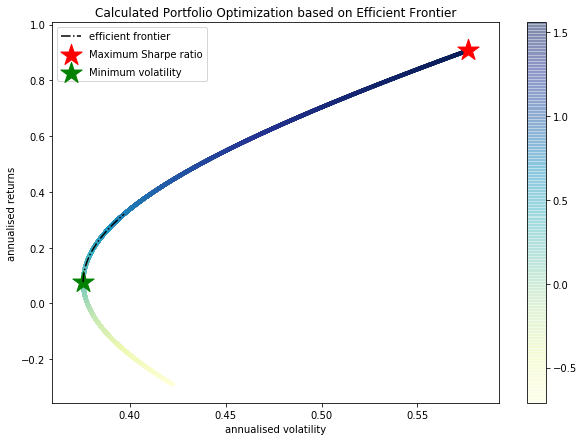

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

CMG : annuaised return 0.91 , annualised volatility: 0.58
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


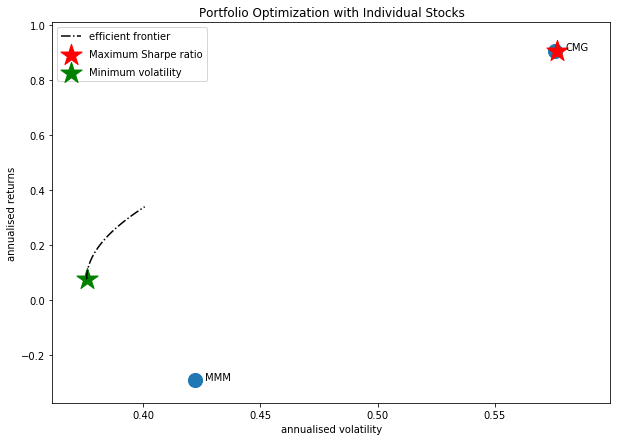

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'CXO', 'BIIB', 'MMM', 'CVS']


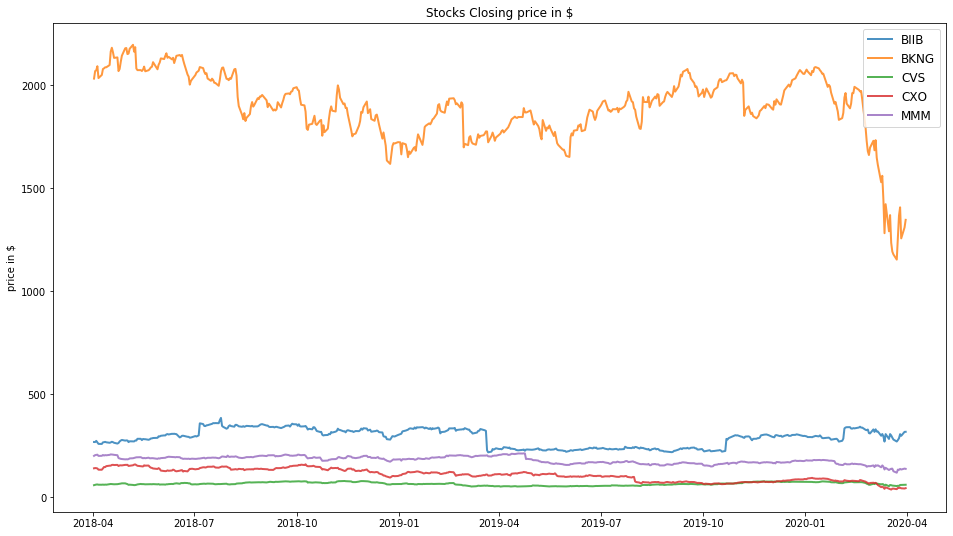

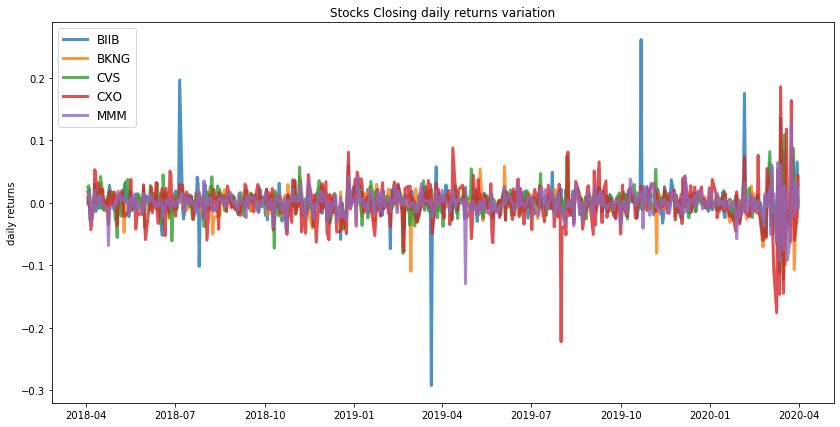

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.34
Annualised Volatility: 0.58


             BIIB  BKNG    CVS  CXO  MMM
allocation  83.18   0.0  16.82  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.12
Annualised Volatility: 0.36


            BIIB   BKNG    CVS  CXO    MMM
allocation  8.14  23.06  27.04  0.0  41.76


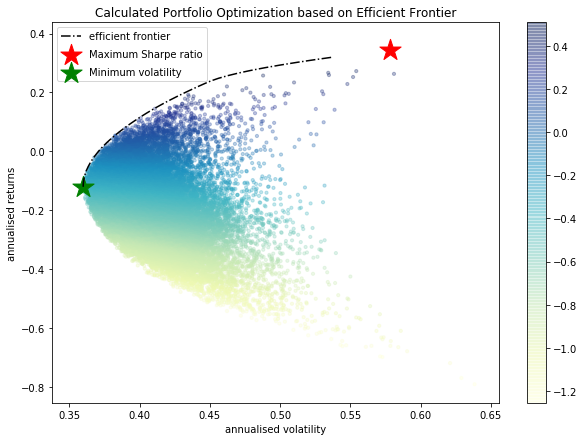

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


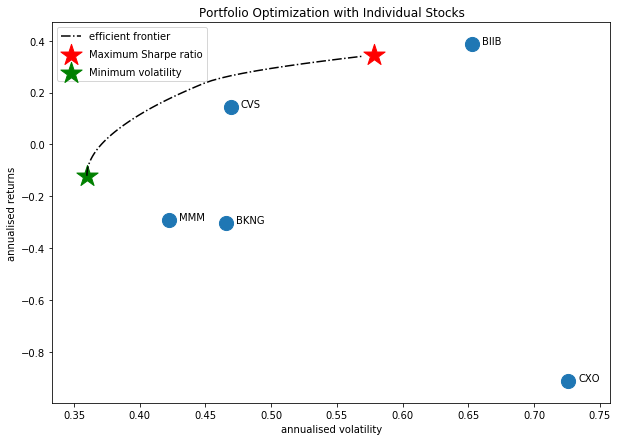

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'EQIX', 'BIIB', 'MMM', 'CVS']


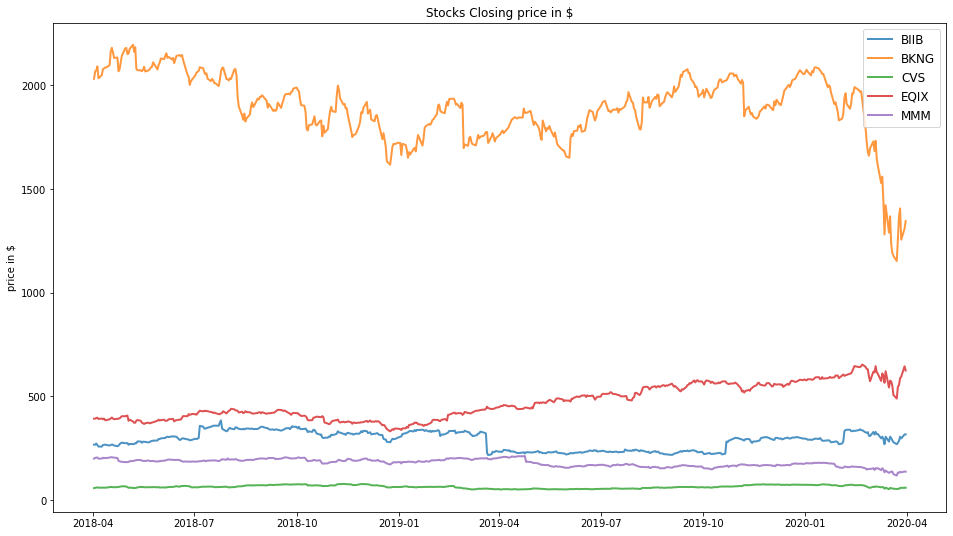

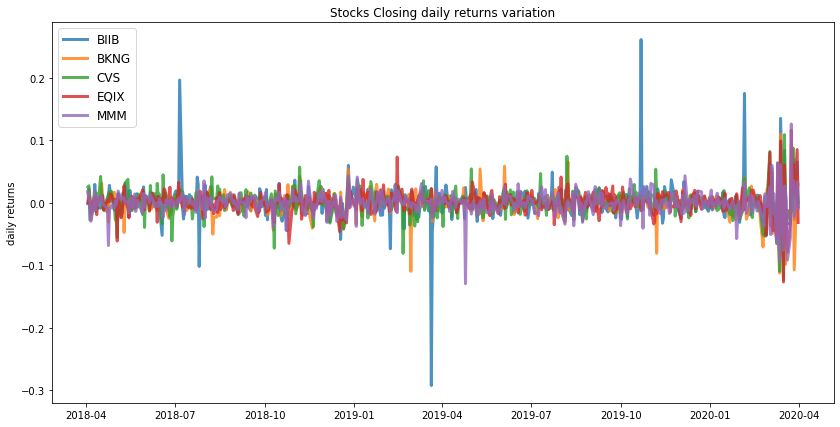

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.54
Annualised Volatility: 0.4


            BIIB  BKNG  CVS   EQIX  MMM
allocation  9.82   0.0  0.0  90.18  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.1
Annualised Volatility: 0.34


            BIIB   BKNG    CVS  EQIX    MMM
allocation  5.57  14.41  16.97  33.3  29.74


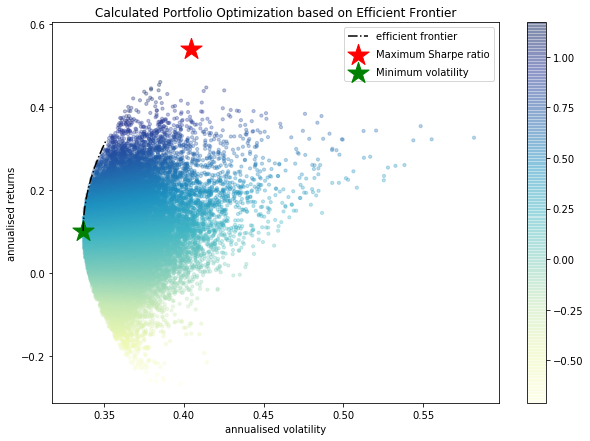

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


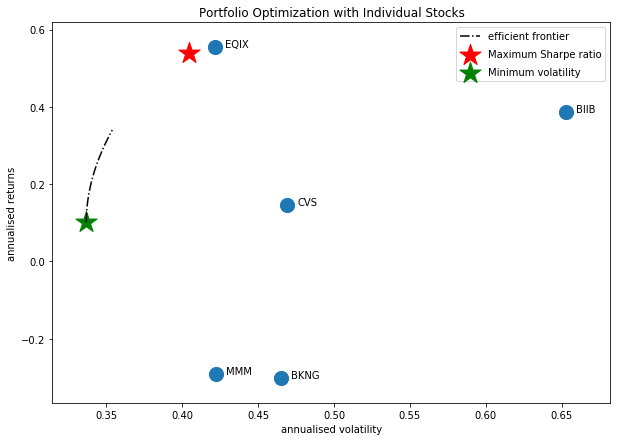

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'CXO', 'EQIX', 'AMGN', 'BIIB', 'MMM', 'CVS', 'PCG']


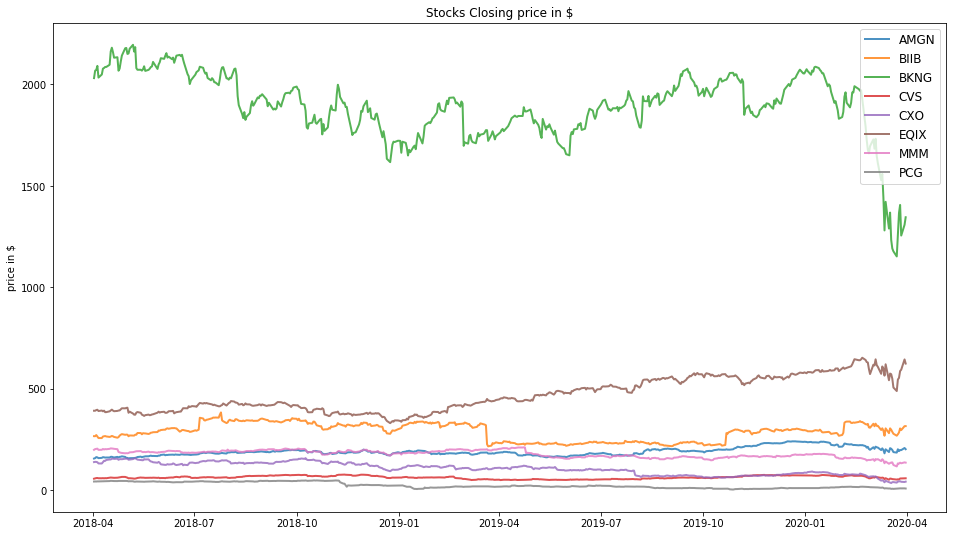

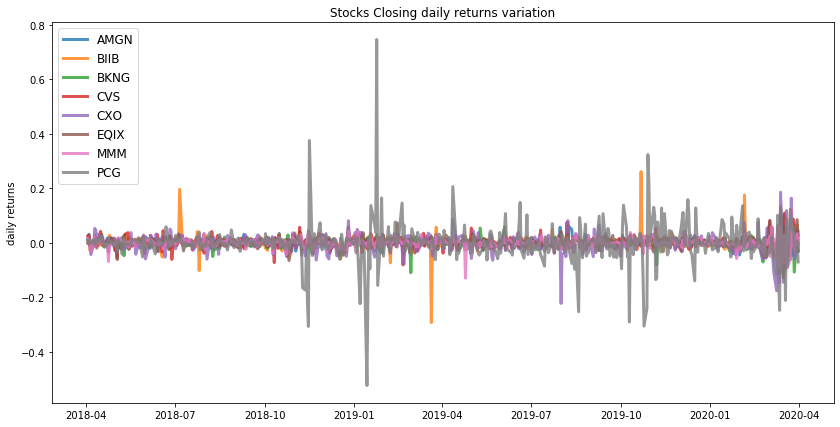

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.4


            AMGN  BIIB  BKNG  CVS  CXO   EQIX  MMM  PCG
allocation  3.24  9.01   0.0  0.0  0.0  87.75  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.14
Annualised Volatility: 0.33


            AMGN  BIIB   BKNG    CVS  CXO   EQIX    MMM   PCG
allocation  21.0  2.33  12.44  12.72  0.0  26.89  24.38  0.23


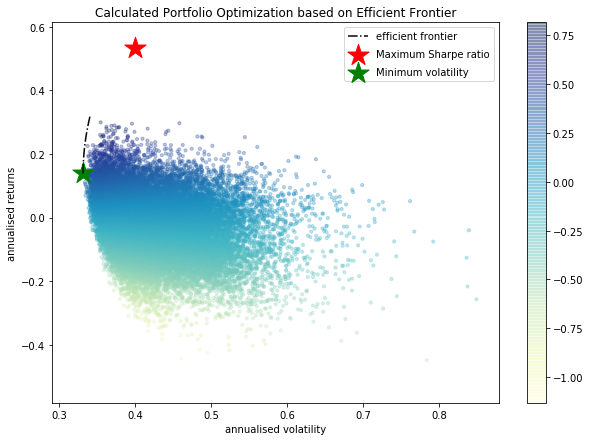

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
PCG : annuaised return -0.16 , annualised volatility: 1.67
--------------------------------------------------------------------------------


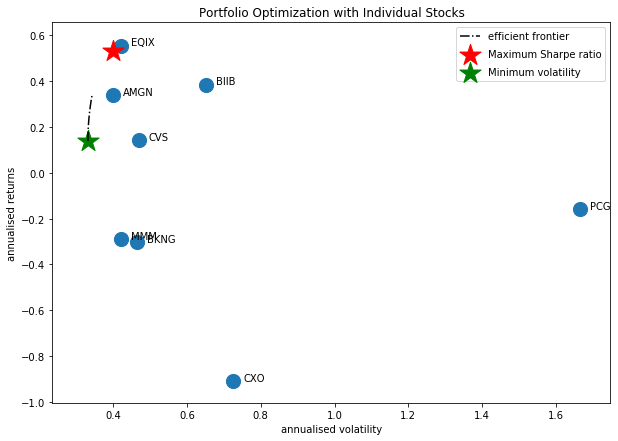

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'CXO', 'SHW', 'EQIX', 'AMGN', 'BIIB', 'MMM', 'CVS']


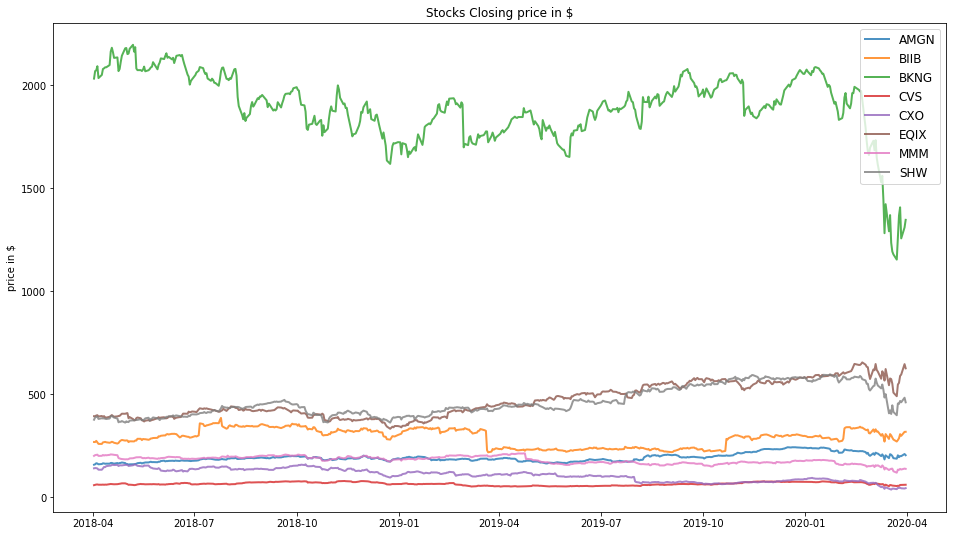

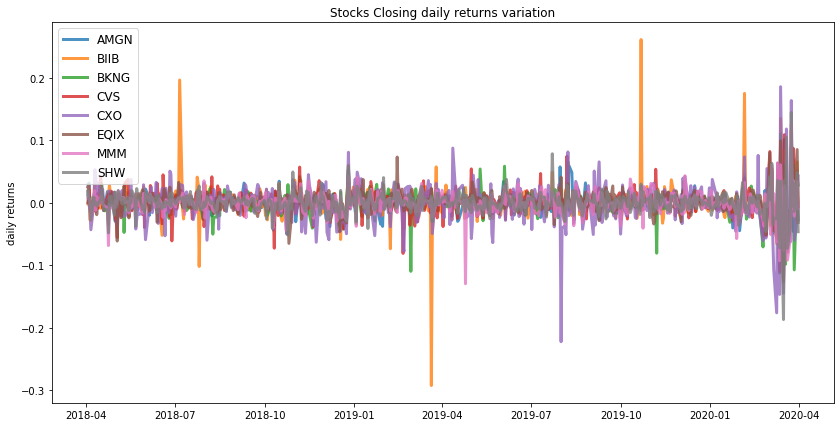

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.4


            AMGN  BIIB  BKNG  CVS  CXO  EQIX  MMM  SHW
allocation  3.18  9.03   0.0  0.0  0.0  87.8  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.16
Annualised Volatility: 0.33


             AMGN  BIIB   BKNG    CVS  CXO  EQIX    MMM   SHW
allocation  20.39  2.32  11.26  12.12  0.0  24.1  21.03  8.77


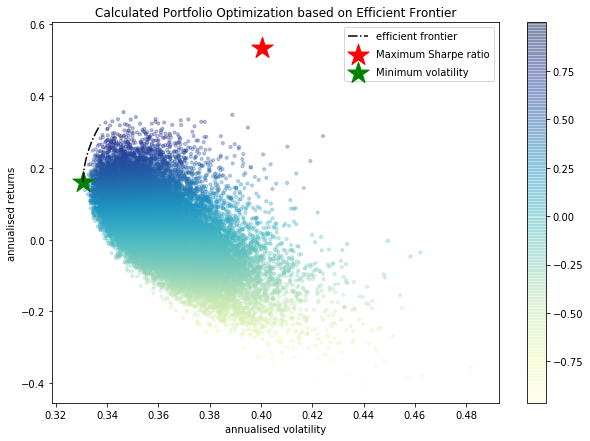

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
SHW : annuaised return 0.3 , annualised volatility: 0.44
--------------------------------------------------------------------------------


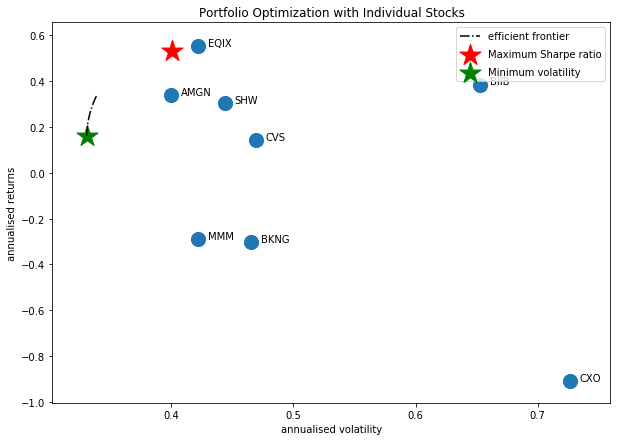

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'CXO', 'EQIX', 'AMGN', 'BIIB', 'MMM', 'CVS', 'ABC']


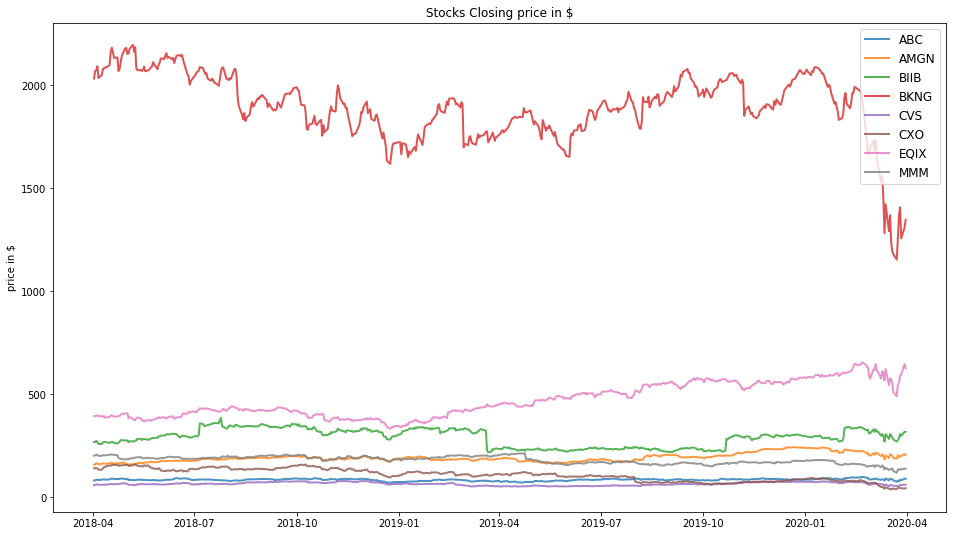

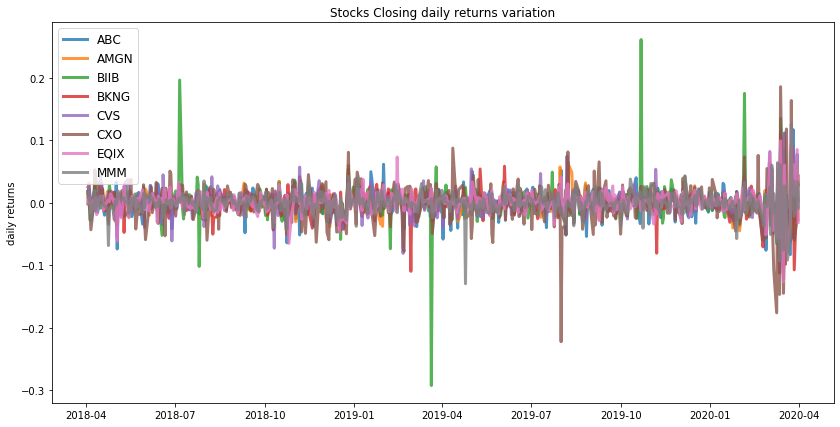

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.4


            ABC  AMGN  BIIB  BKNG  CVS  CXO  EQIX  MMM
allocation  0.0  3.17  9.03   0.0  0.0  0.0  87.8  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.14
Annualised Volatility: 0.33


            ABC   AMGN  BIIB   BKNG    CVS  CXO   EQIX    MMM
allocation  0.0  21.16   2.4  12.45  12.71  0.0  26.83  24.45


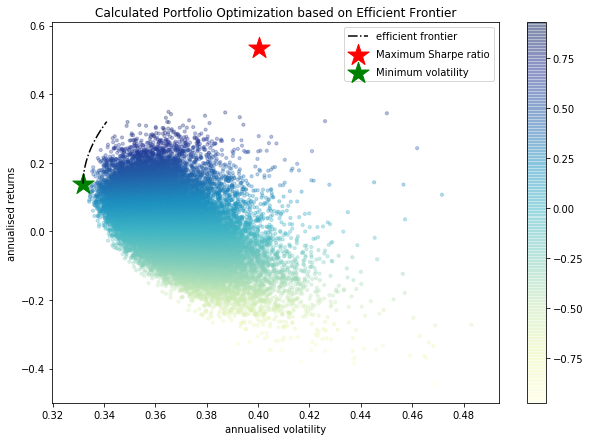

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.23 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
BKNG : annuaised return -0.3 , annualised volatility: 0.47
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


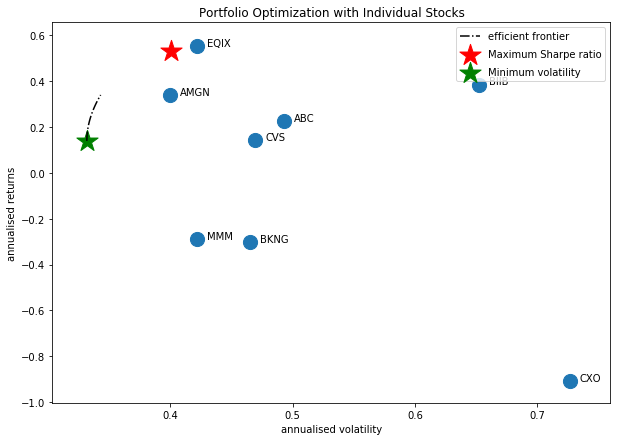

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BKNG', 'BAC']


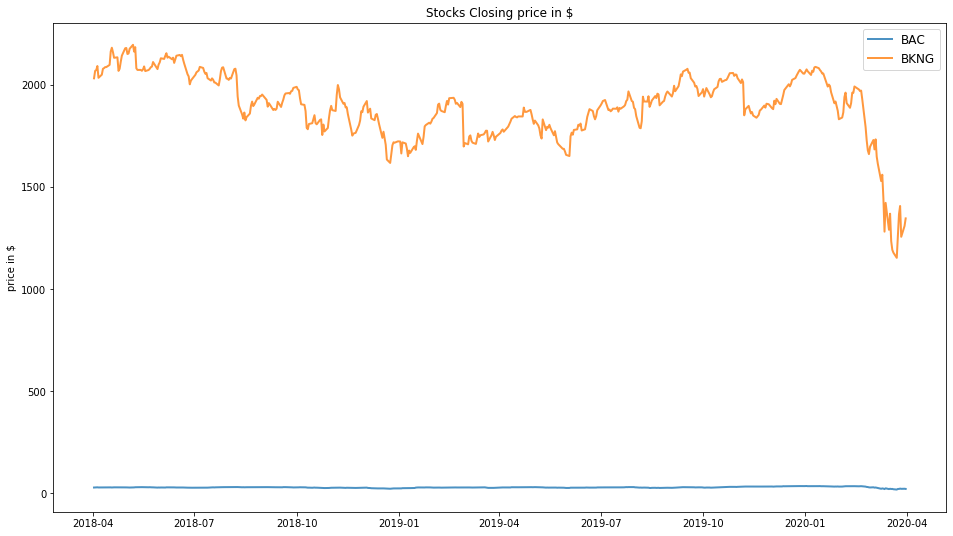

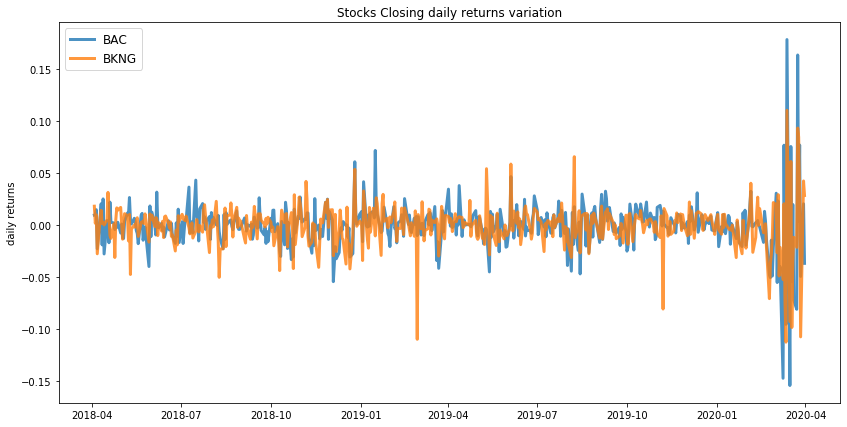

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.14
Annualised Volatility: 0.52


              BAC  BKNG
allocation  100.0   0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.25
Annualised Volatility: 0.44


             BAC  BKNG
allocation  36.2  63.8


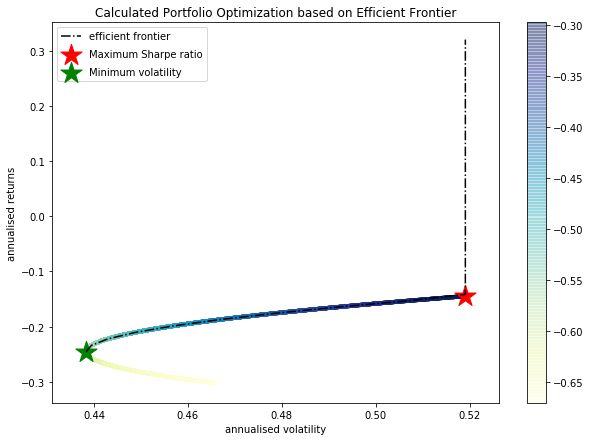

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BAC : annuaised return -0.14 , annualised volatility: 0.52
BKNG : annuaised return -0.3 , annualised volatility: 0.47
--------------------------------------------------------------------------------


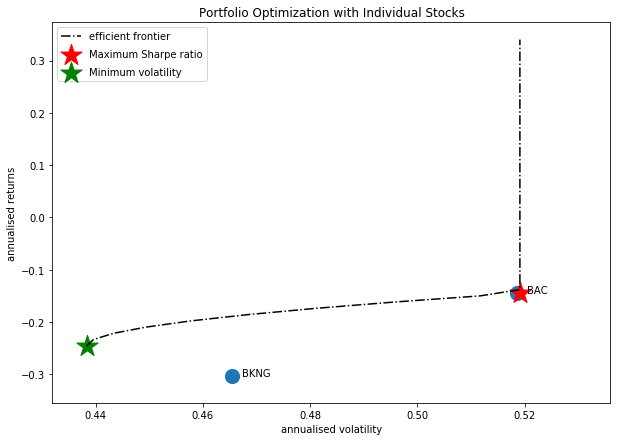

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CVS', 'CXO', 'SHW']


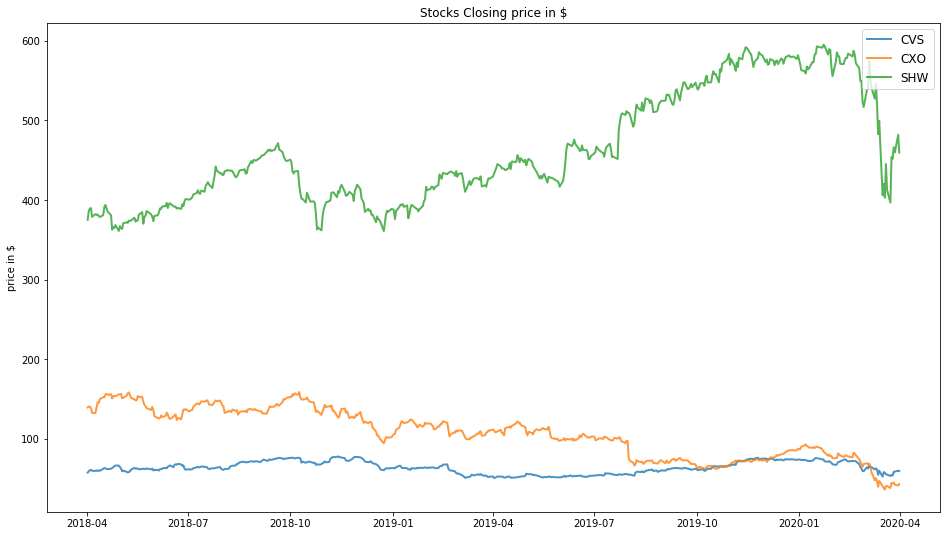

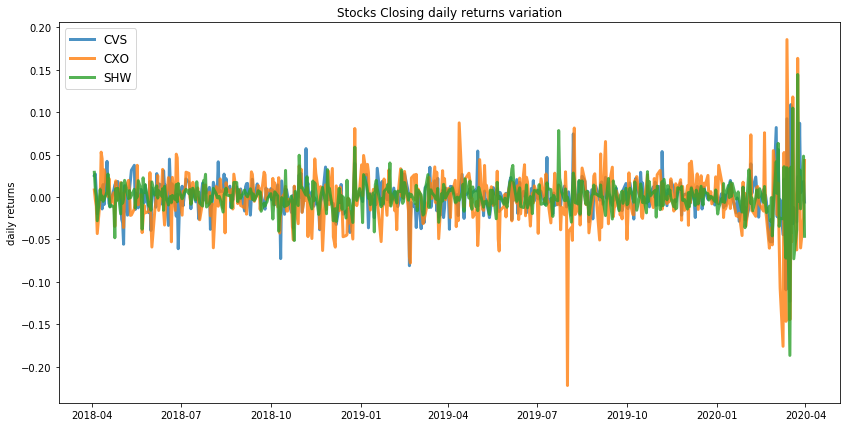

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.3
Annualised Volatility: 0.44


            CVS  CXO    SHW
allocation  0.0  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.19
Annualised Volatility: 0.39


              CVS   CXO    SHW
allocation  43.35  4.04  52.61


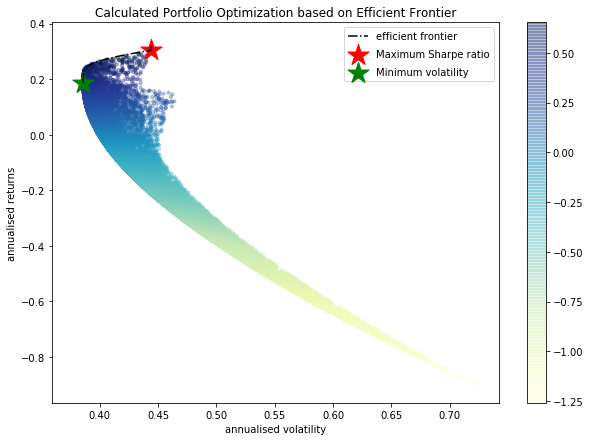

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
SHW : annuaised return 0.3 , annualised volatility: 0.44
--------------------------------------------------------------------------------


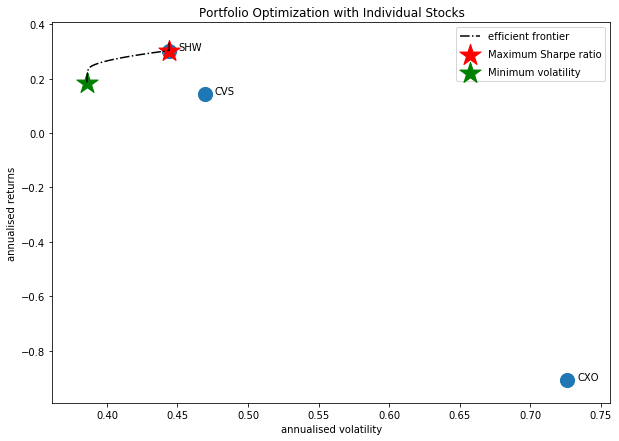

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CXO', 'AMGN', 'BIIB', 'MMM', 'CVS']


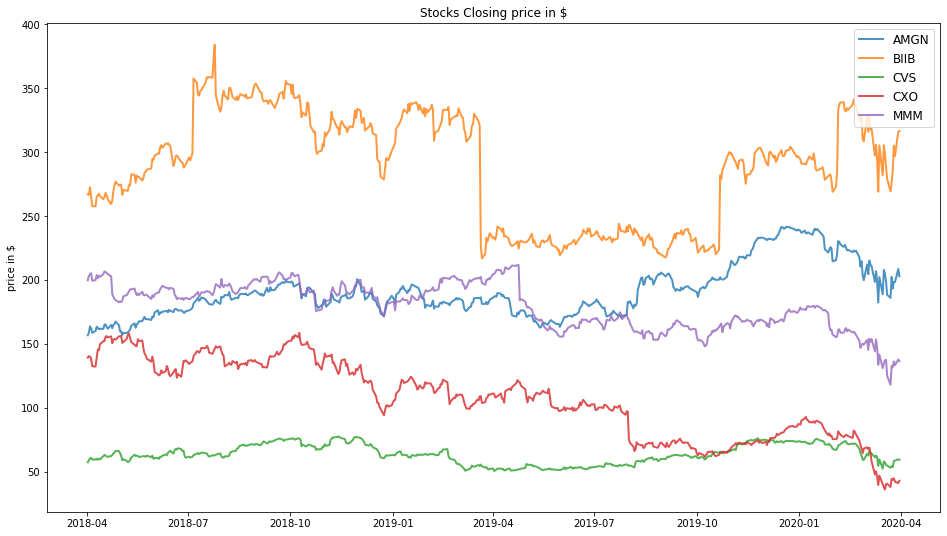

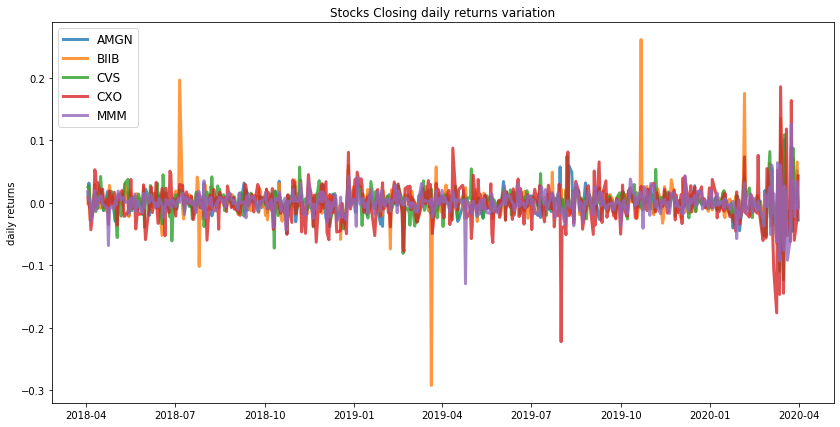

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.4


             AMGN   BIIB  CVS  CXO  MMM
allocation  83.74  16.26  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.35


             AMGN  BIIB    CVS  CXO    MMM
allocation  39.11  3.96  20.55  0.0  36.37


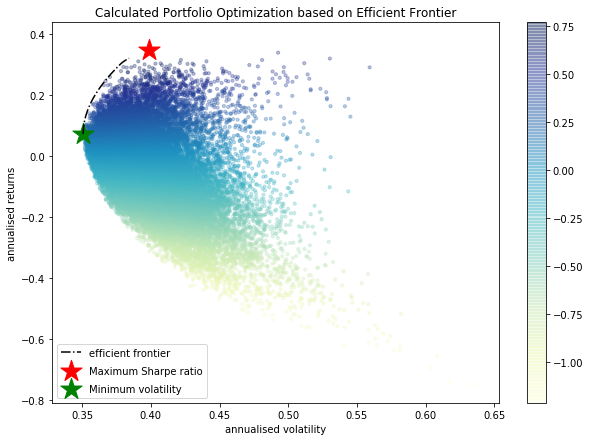

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


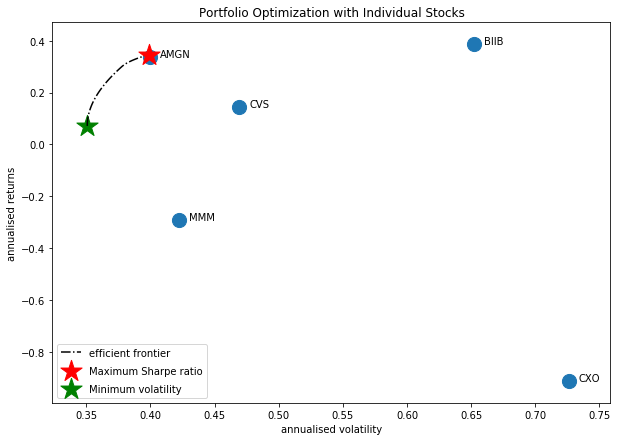

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AAPL', 'CVS', 'CXO', 'MMM']


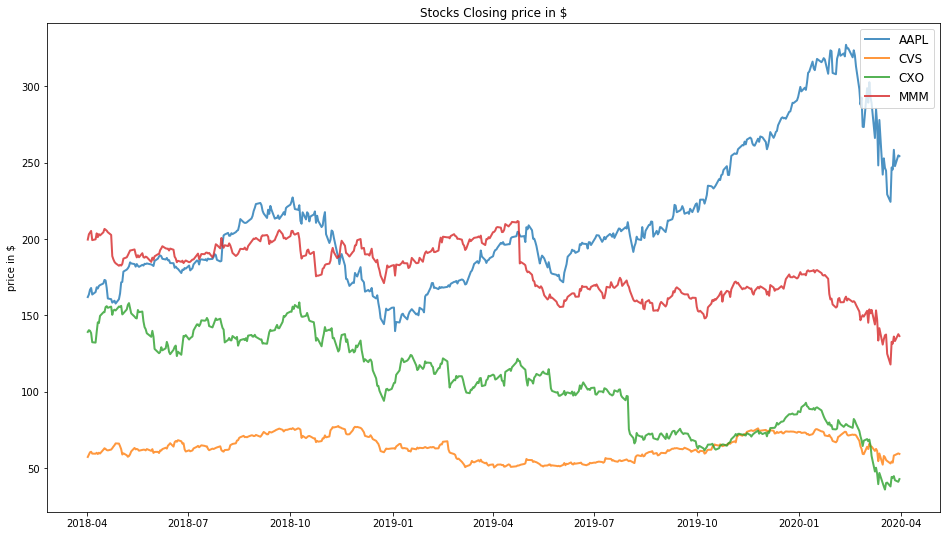

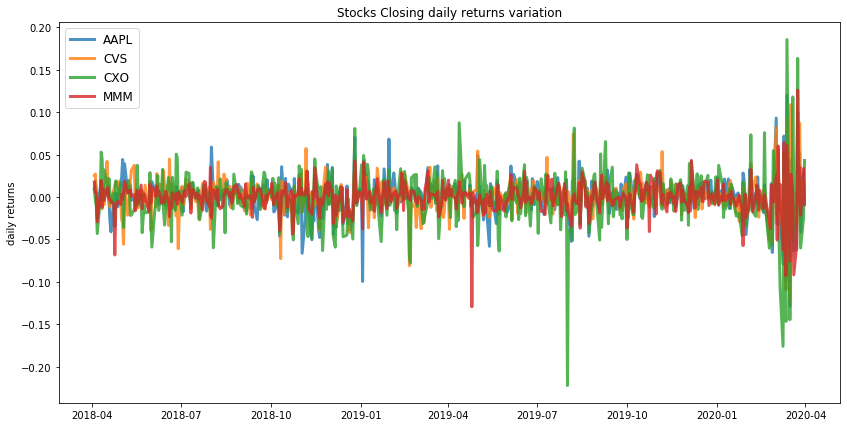

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.57
Annualised Volatility: 0.49


             AAPL  CVS  CXO  MMM
allocation  100.0  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.01
Annualised Volatility: 0.37


             AAPL    CVS  CXO   MMM
allocation  14.71  35.28  0.0  50.0


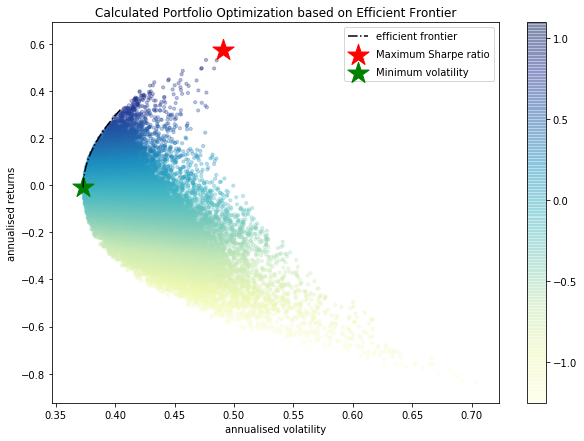

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


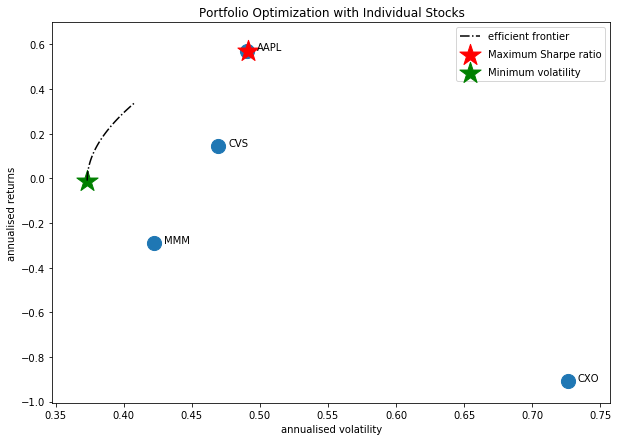

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CXO', 'AMGN', 'AAPL', 'BIIB', 'MMM', 'CVS']


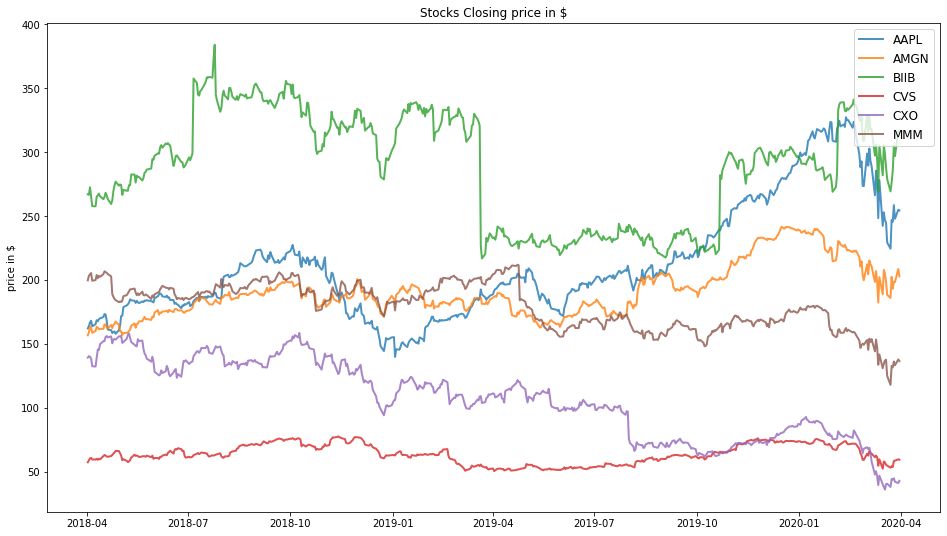

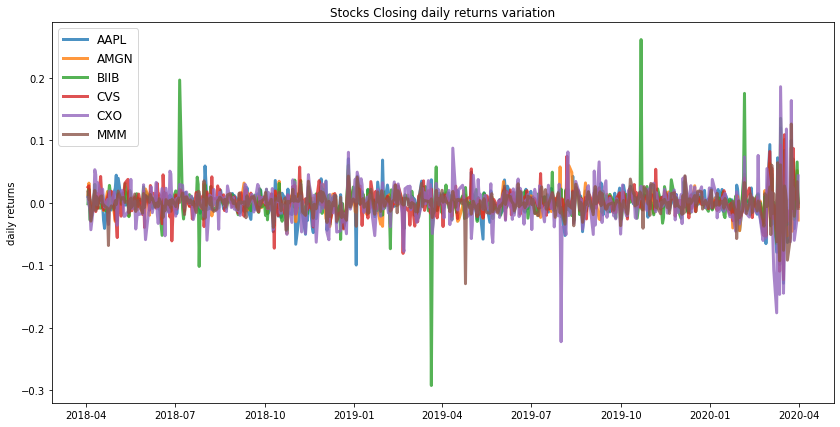

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.52
Annualised Volatility: 0.44


             AAPL   AMGN  BIIB  CVS  CXO  MMM
allocation  77.47  13.78  8.75  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.09
Annualised Volatility: 0.35


            AAPL   AMGN  BIIB    CVS  CXO    MMM
allocation  2.62  38.05  3.91  20.13  0.0  35.29


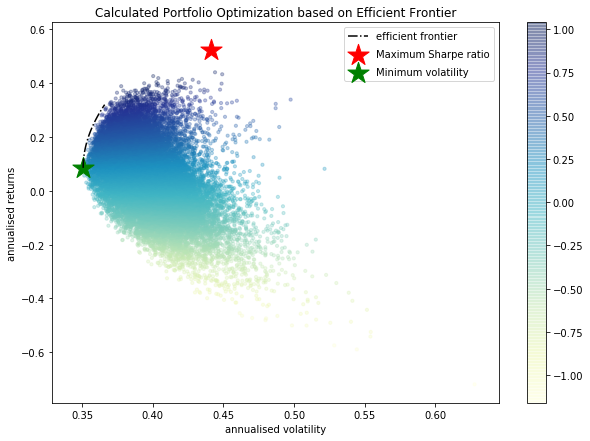

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


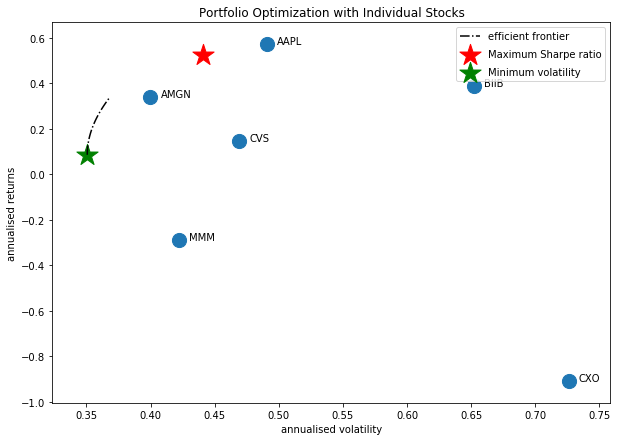

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CXO', 'BIIB', 'MMM', 'ECL', 'CVS']


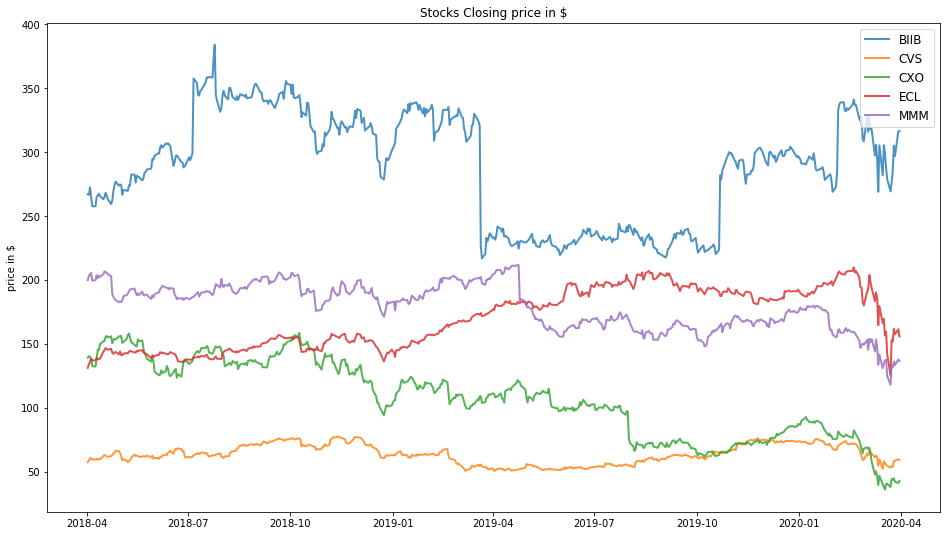

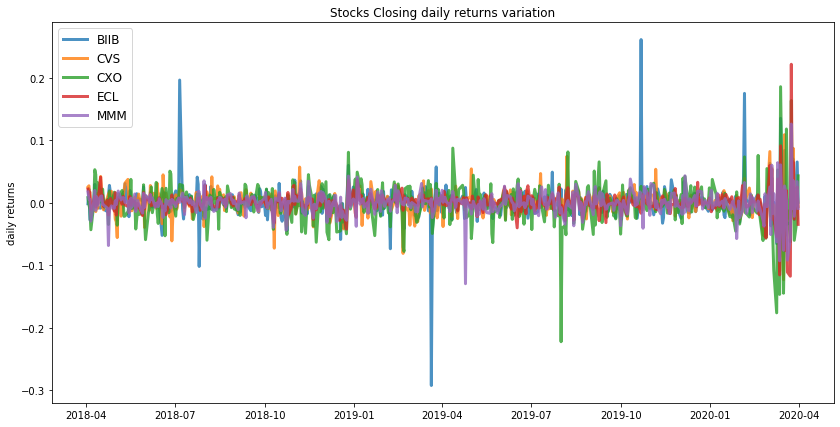

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.31
Annualised Volatility: 0.42


             BIIB  CVS  CXO    ECL  MMM
allocation  39.04  0.0  0.0  60.96  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.05
Annualised Volatility: 0.36


            BIIB   CVS  CXO    ECL    MMM
allocation  9.98  26.1  0.0  28.46  35.45


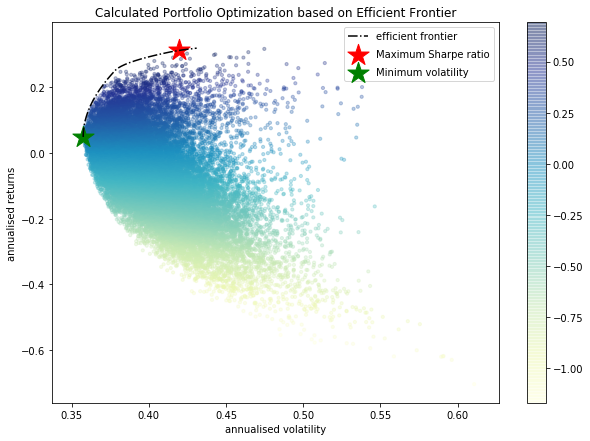

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
ECL : annuaised return 0.27 , annualised volatility: 0.44
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


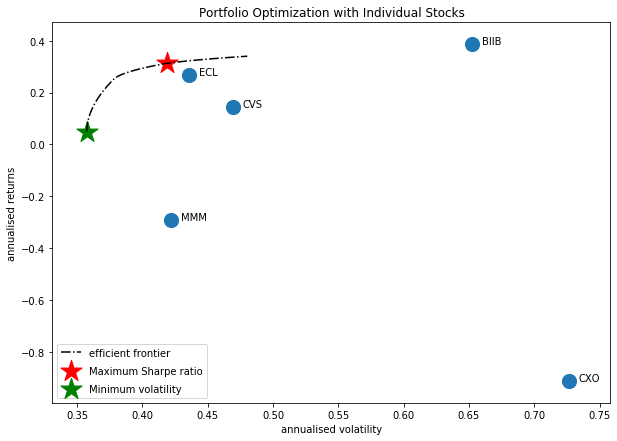

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CXO', 'BIIB', 'MMM', 'CVS', 'COP']


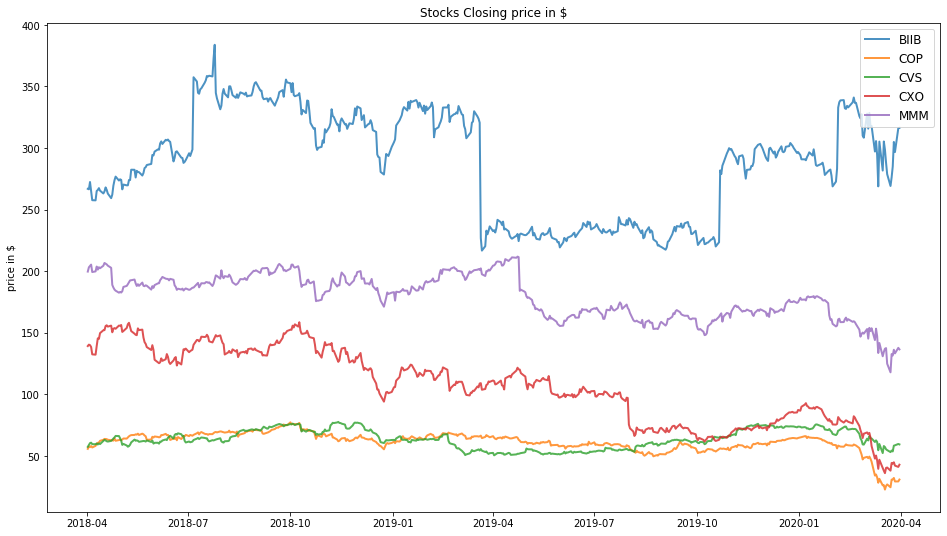

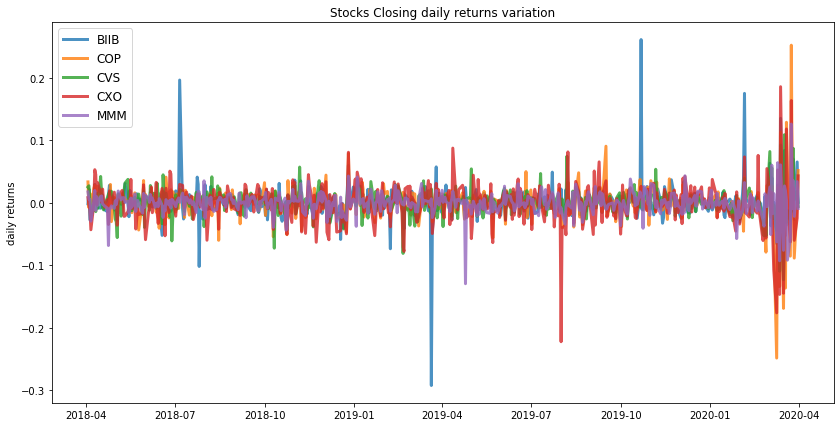

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.34
Annualised Volatility: 0.58


             BIIB  COP    CVS  CXO  MMM
allocation  83.13  0.0  16.87  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.07
Annualised Volatility: 0.37


             BIIB   COP    CVS  CXO    MMM
allocation  11.44  2.16  33.67  0.0  52.74


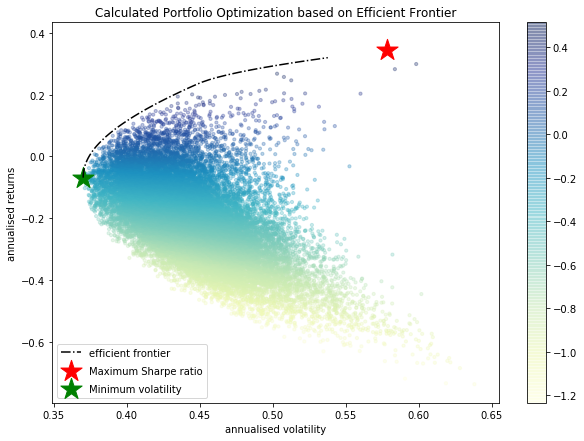

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BIIB : annuaised return 0.39 , annualised volatility: 0.65
COP : annuaised return -0.38 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


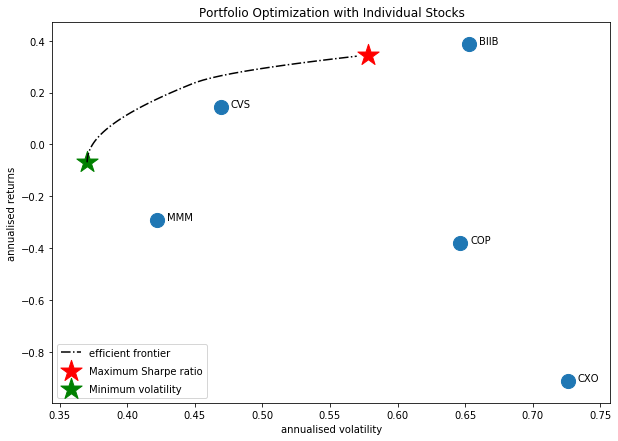

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['DHI', 'CXO']


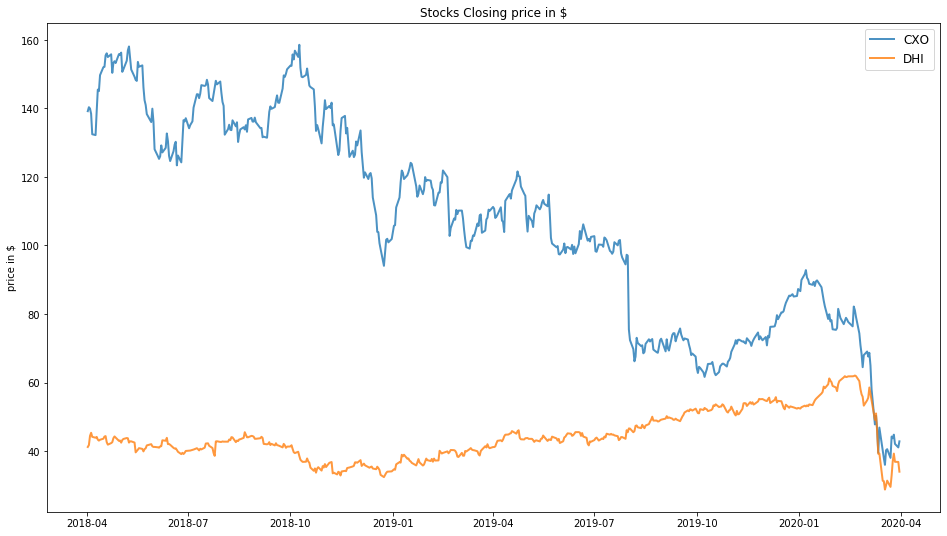

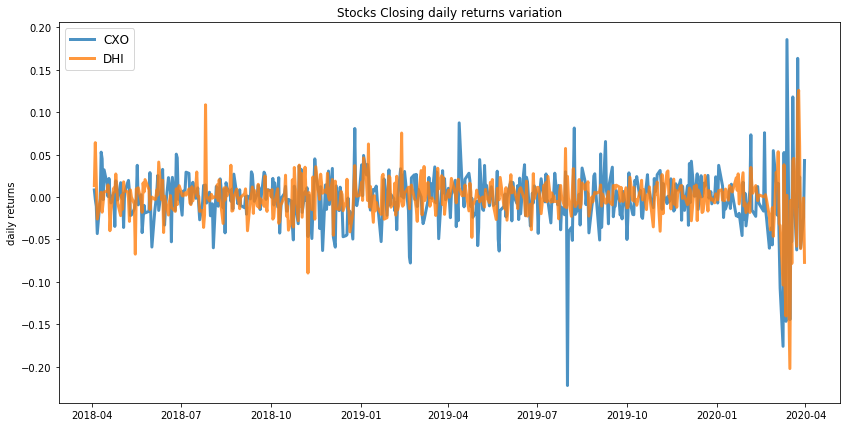

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.03
Annualised Volatility: 0.56


            CXO    DHI
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.3
Annualised Volatility: 0.51


              CXO    DHI
allocation  30.03  69.97


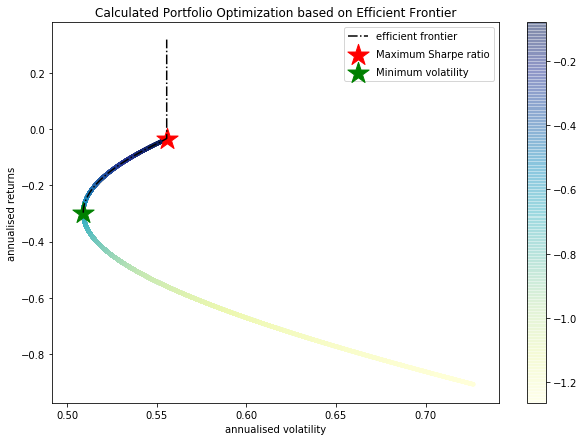

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

CXO : annuaised return -0.91 , annualised volatility: 0.73
DHI : annuaised return -0.03 , annualised volatility: 0.55
--------------------------------------------------------------------------------


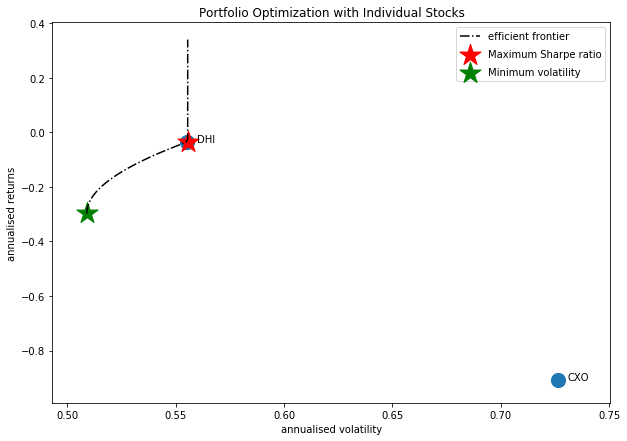

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['ALXN', 'CXO']


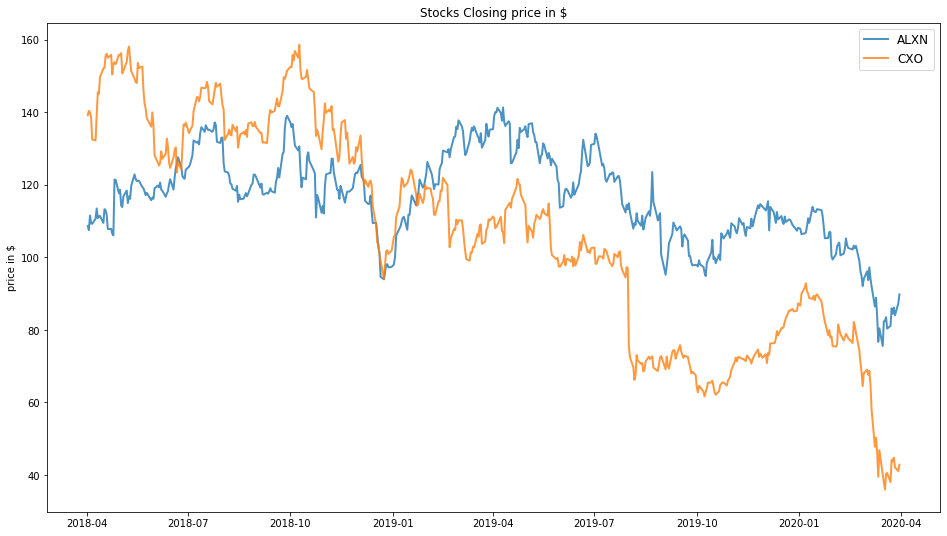

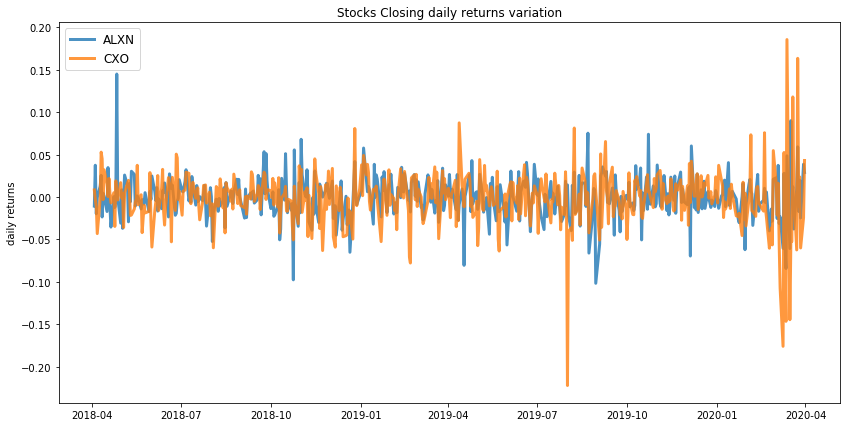

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: -0.04
Annualised Volatility: 0.55


             ALXN  CXO
allocation  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: -0.29
Annualised Volatility: 0.51


             ALXN    CXO
allocation  71.19  28.81


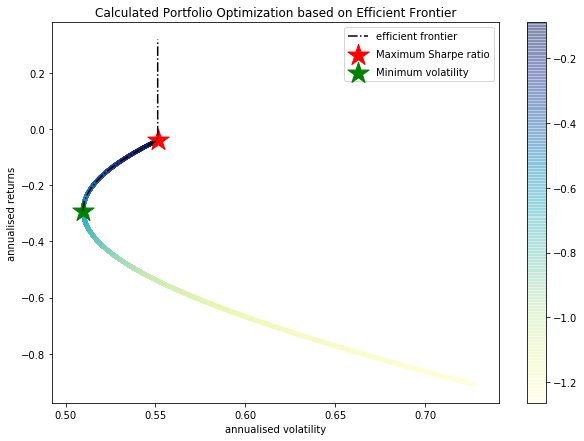

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ALXN : annuaised return -0.04 , annualised volatility: 0.55
CXO : annuaised return -0.91 , annualised volatility: 0.73
--------------------------------------------------------------------------------


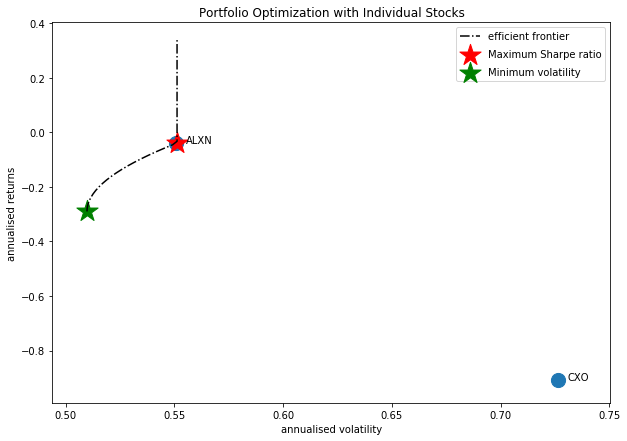

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'CVS', 'SHW']


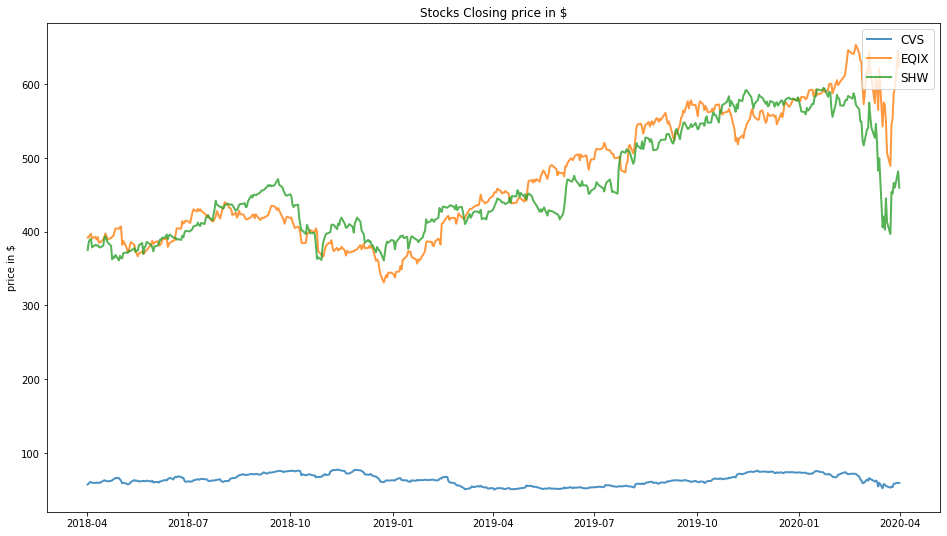

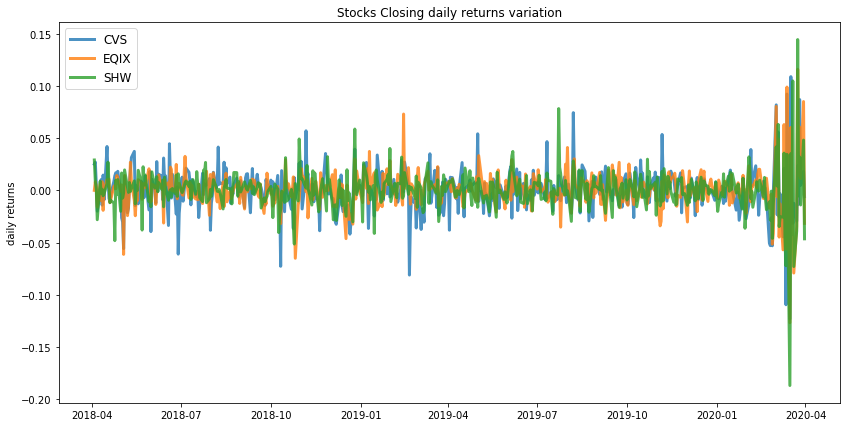

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.42


            CVS   EQIX  SHW
allocation  0.0  100.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.36
Annualised Volatility: 0.36


              CVS   EQIX    SHW
allocation  29.79  39.88  30.34


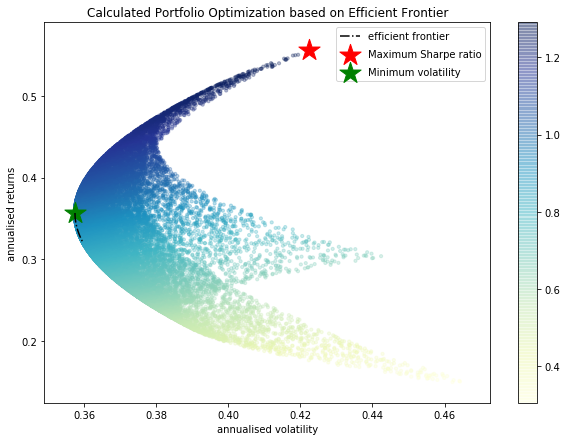

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
SHW : annuaised return 0.3 , annualised volatility: 0.44
--------------------------------------------------------------------------------


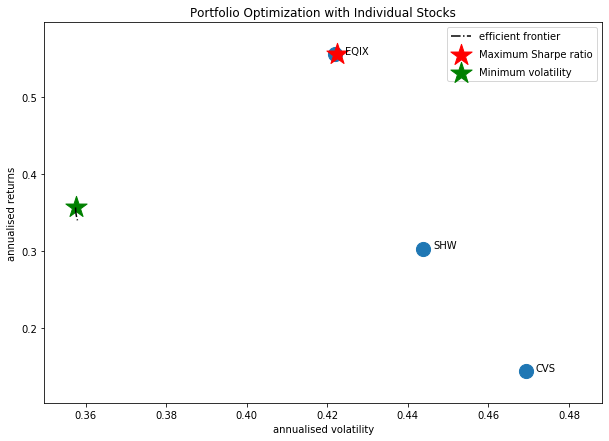

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMD', 'CXO', 'SHW', 'AMGN', 'BIIB', 'MMM', 'CVS']


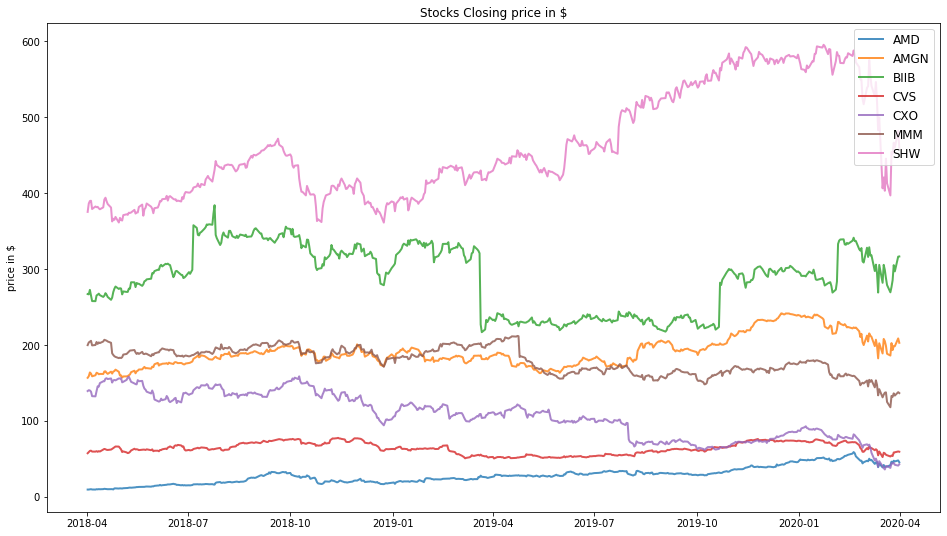

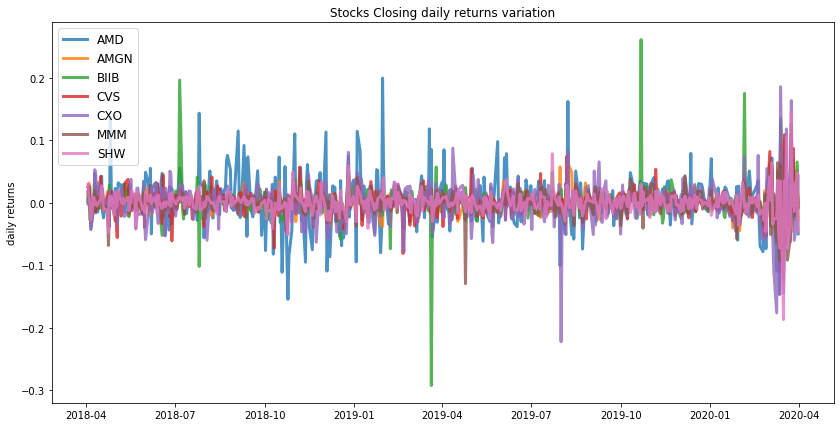

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


              AMD  AMGN  BIIB  CVS  CXO  MMM  SHW
allocation  91.18   0.0  8.82  0.0  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.13
Annualised Volatility: 0.34


            AMD  AMGN  BIIB   CVS  CXO    MMM    SHW
allocation  0.0  32.9  3.46  17.5  0.0  26.42  19.72


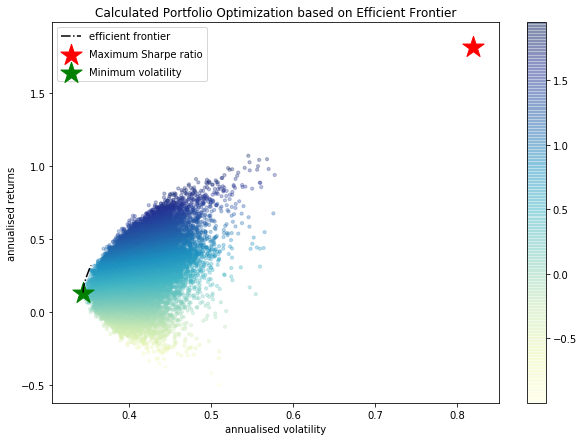

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
MMM : annuaised return -0.29 , annualised volatility: 0.42
SHW : annuaised return 0.3 , annualised volatility: 0.44
--------------------------------------------------------------------------------


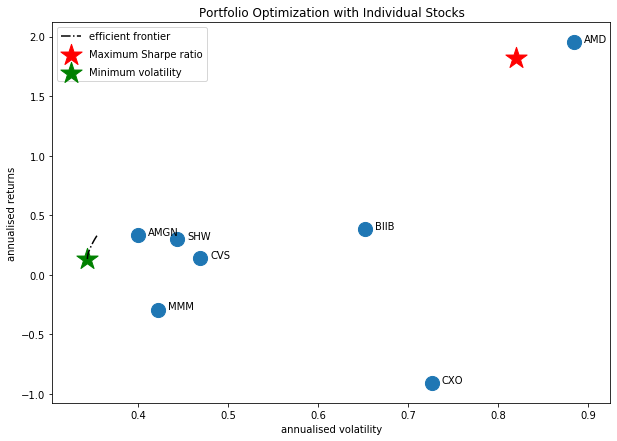

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMGN', 'BIIB', 'MMM', 'CVS']


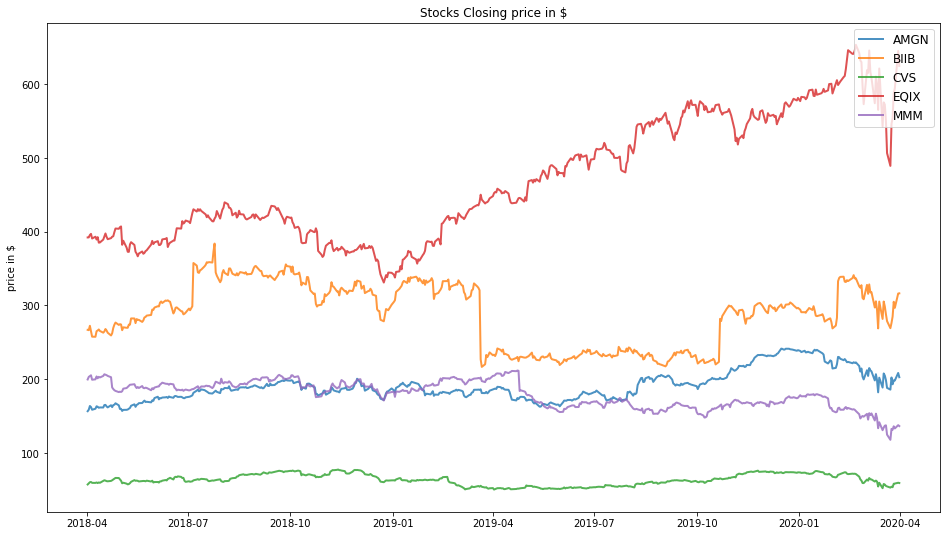

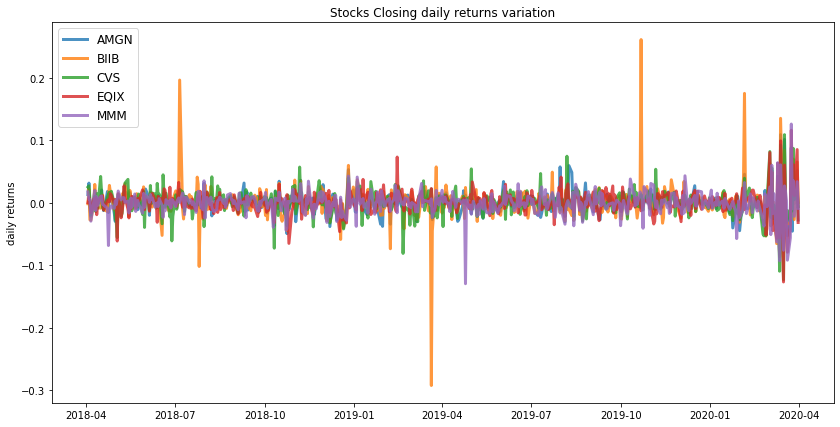

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.4


            AMGN  BIIB  CVS   EQIX  MMM
allocation  3.26   9.0  0.0  87.74  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.19
Annualised Volatility: 0.34


             AMGN  BIIB    CVS   EQIX    MMM
allocation  23.23  3.58  14.92  29.23  29.04


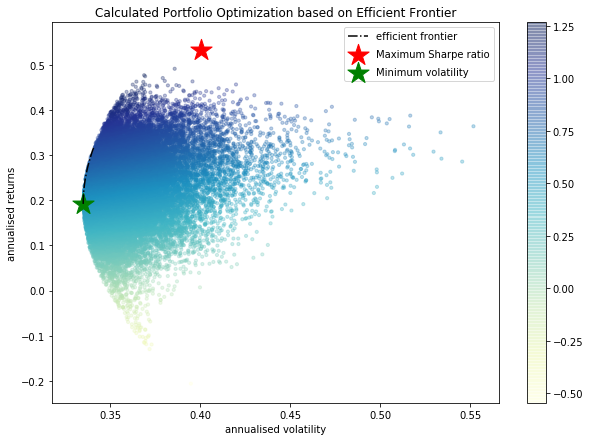

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


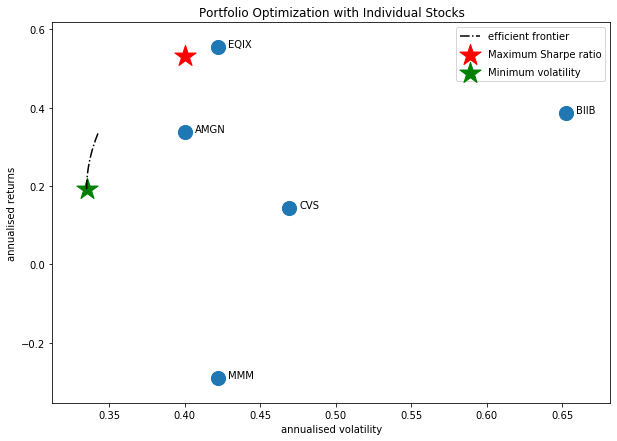

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AAPL', 'CVS', 'MMM']


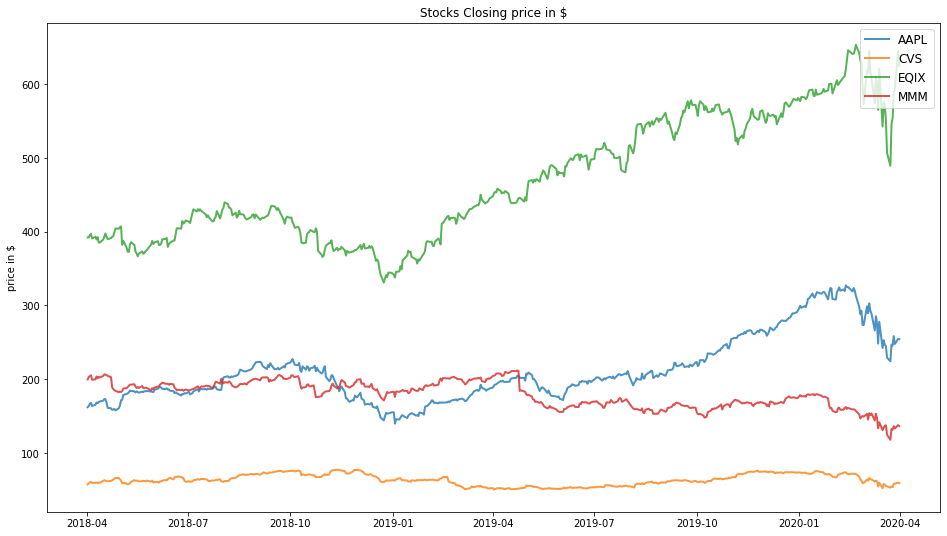

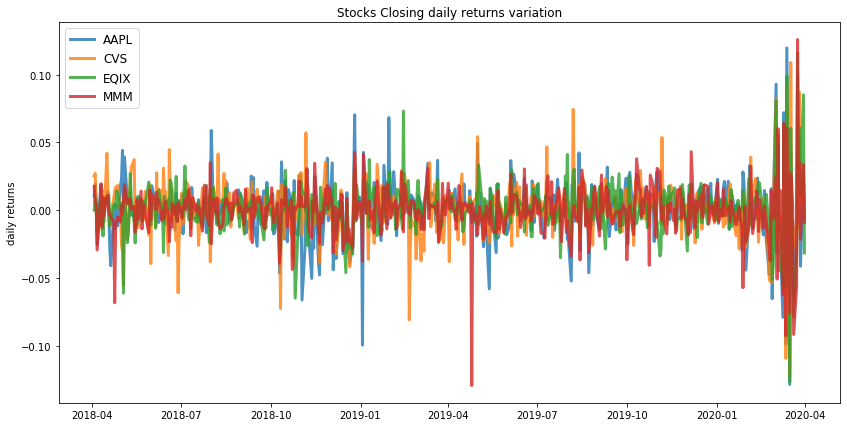

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.39


             AAPL  CVS   EQIX  MMM
allocation  36.48  0.0  63.52  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.14
Annualised Volatility: 0.34


            AAPL    CVS   EQIX    MMM
allocation  0.32  22.99  38.73  37.96


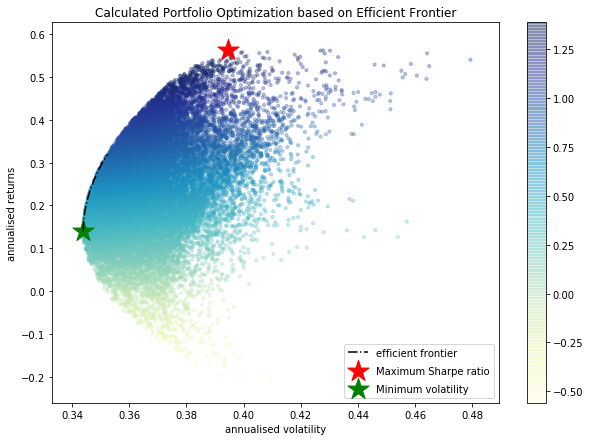

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


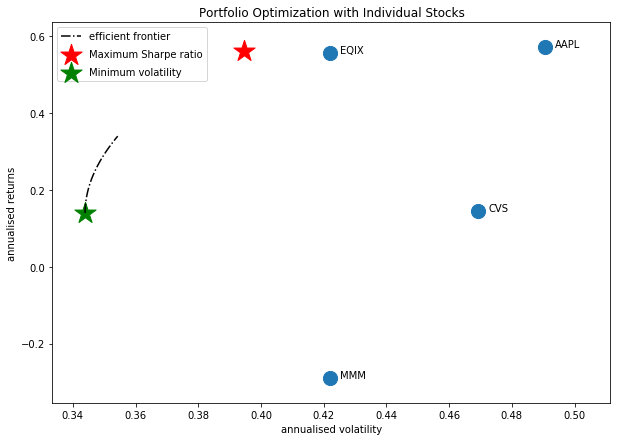

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AMD', 'EQIX', 'AMGN', 'BIIB', 'MMM', 'CVS', 'ABC']


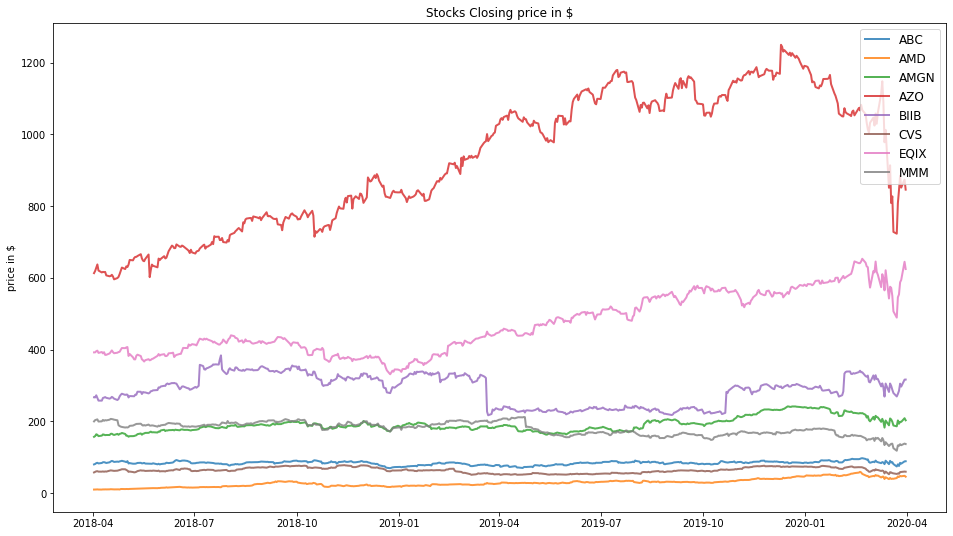

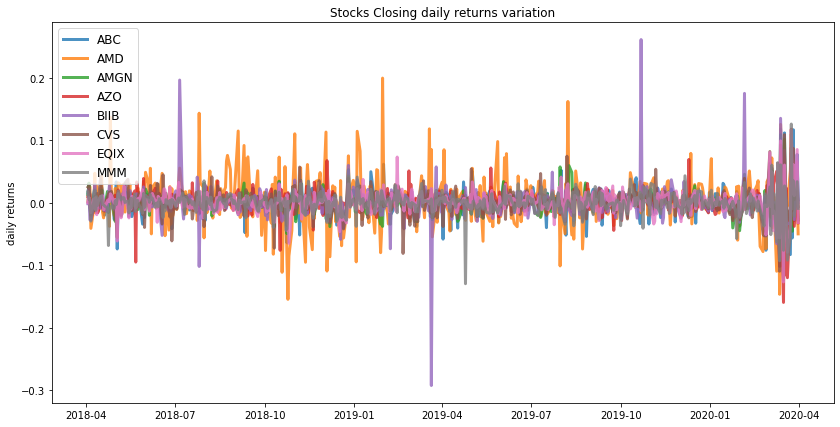

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.37
Annualised Volatility: 0.6


            ABC   AMD  AMGN   AZO  BIIB  CVS   EQIX  MMM
allocation  0.0  58.7   0.0  9.13  0.21  0.0  31.97  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.25
Annualised Volatility: 0.32


            ABC  AMD   AMGN    AZO  BIIB    CVS  EQIX    MMM
allocation  0.0  0.0  21.77  22.94   2.9  10.66  20.6  21.12


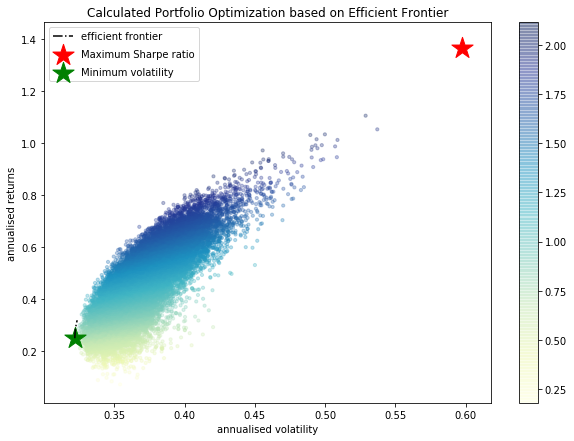

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.23 , annualised volatility: 0.49
AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


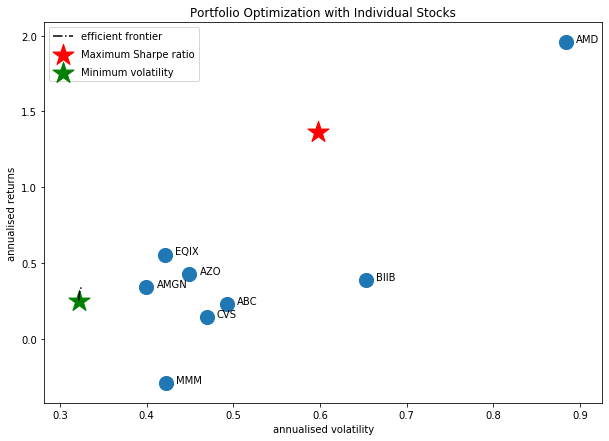

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'ALGN']


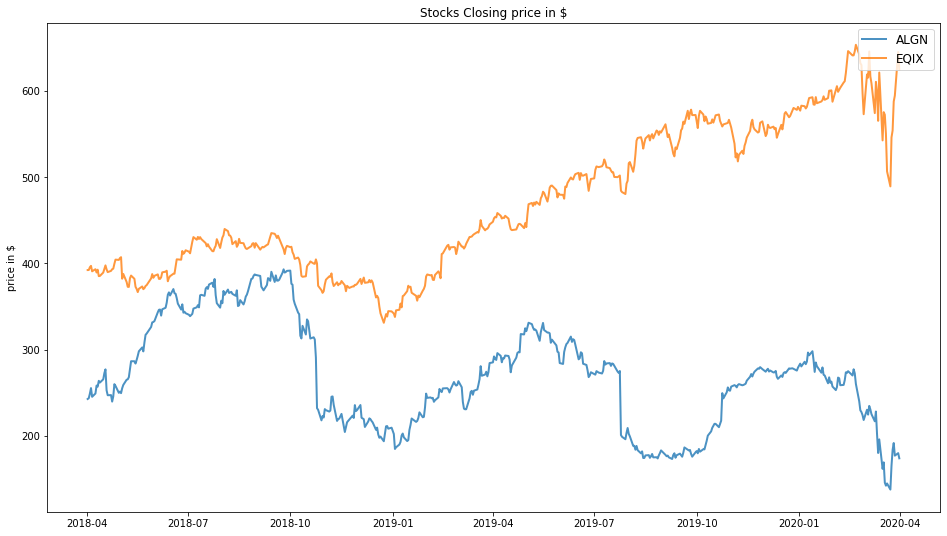

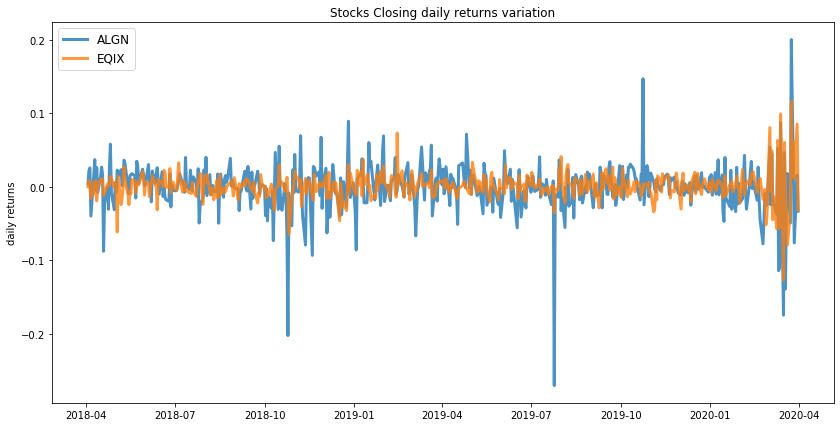

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.42


            ALGN   EQIX
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.51
Annualised Volatility: 0.42


            ALGN   EQIX
allocation  8.58  91.42


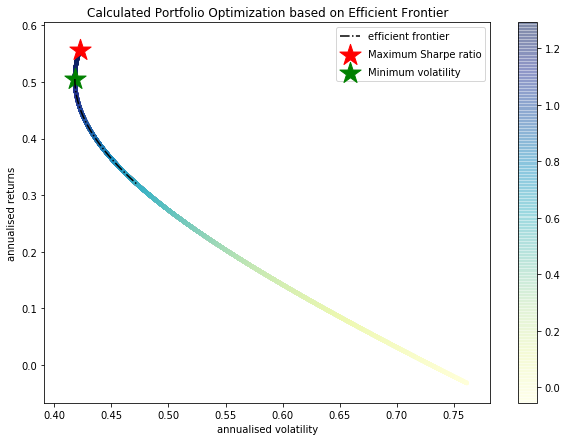

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ALGN : annuaised return -0.03 , annualised volatility: 0.76
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


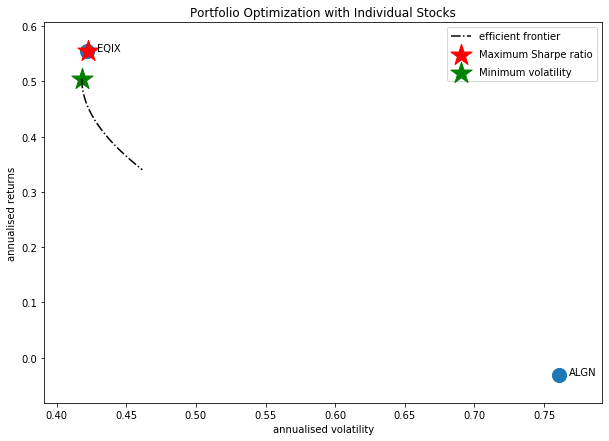

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMGN', 'AAPL', 'BIIB', 'MMM', 'CVS']


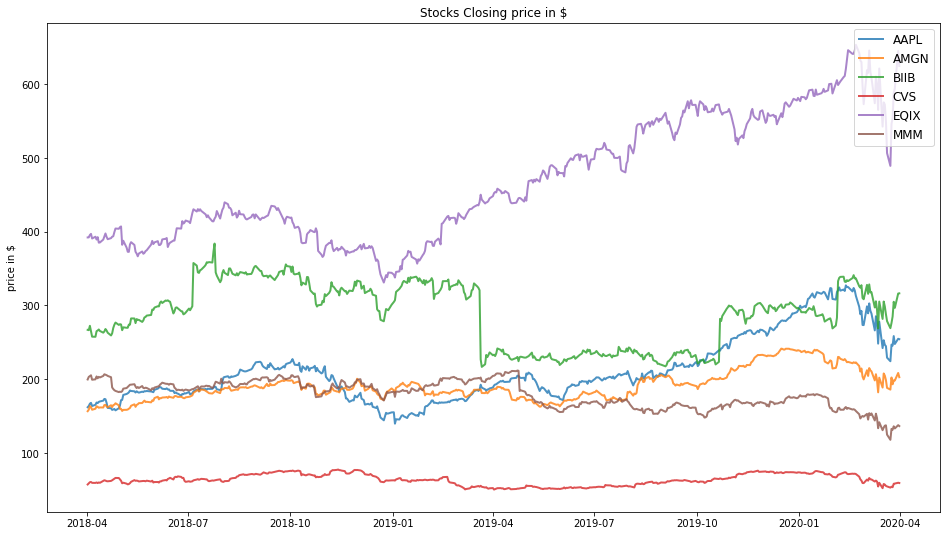

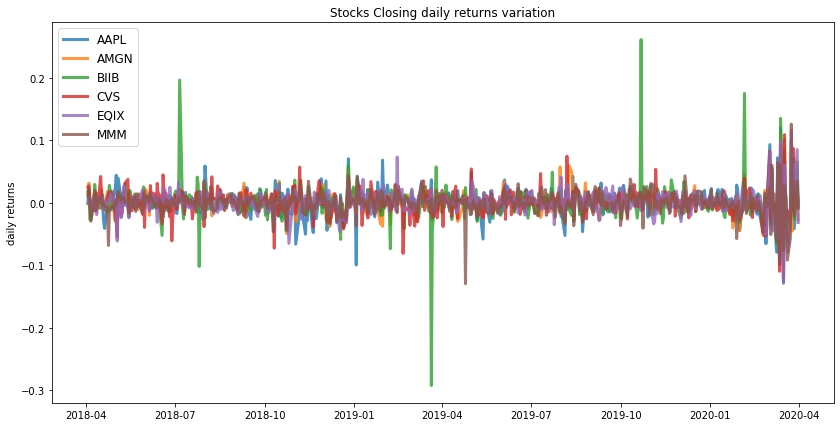

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.39


             AAPL  AMGN  BIIB  CVS  EQIX  MMM
allocation  34.78   0.0  3.42  0.0  61.8  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.19
Annualised Volatility: 0.34


            AAPL   AMGN  BIIB    CVS   EQIX    MMM
allocation   0.0  23.23  3.63  14.89  29.23  29.03


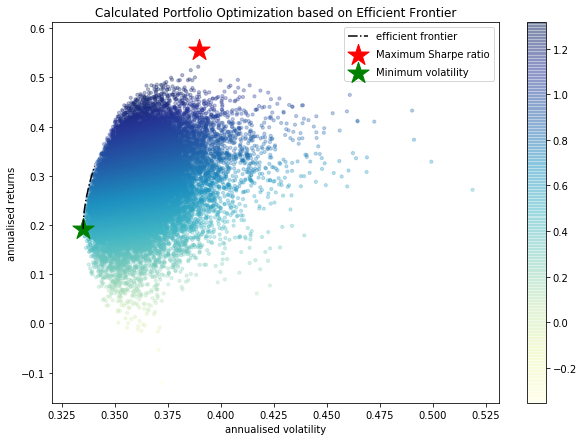

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


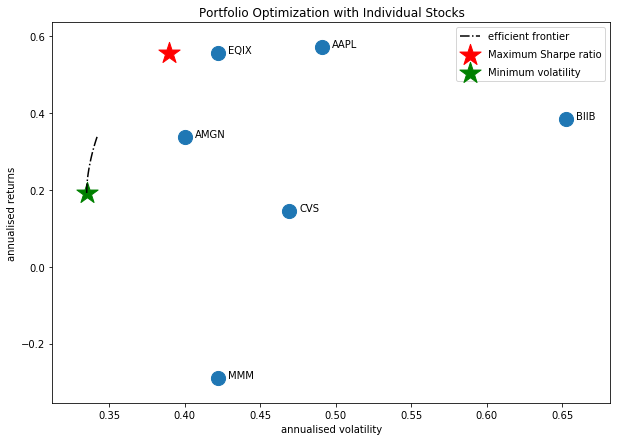

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AYI']


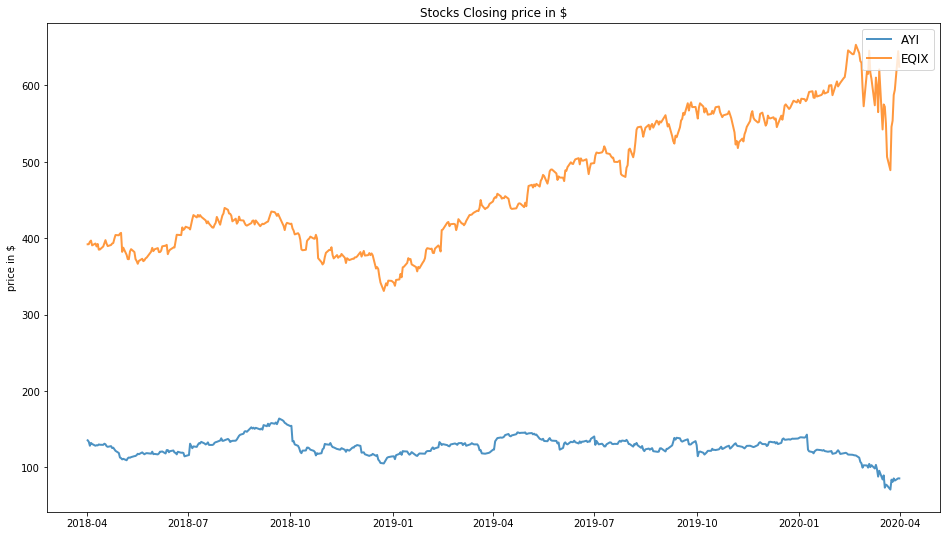

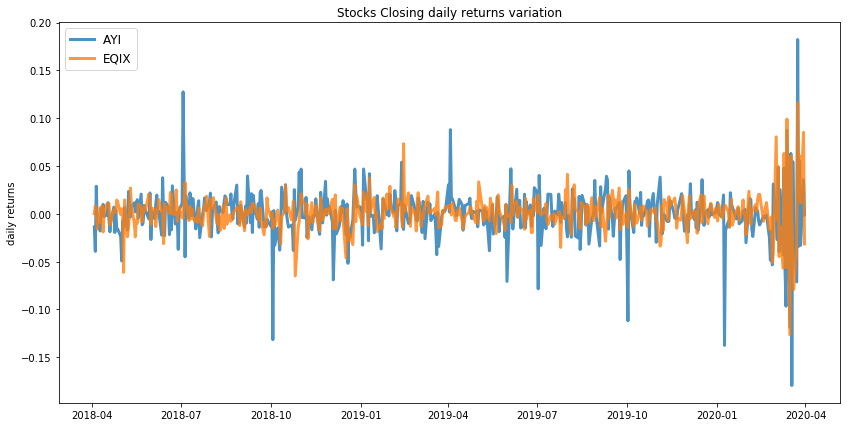

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.42


            AYI   EQIX
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.35
Annualised Volatility: 0.4


              AYI   EQIX
allocation  24.47  75.53


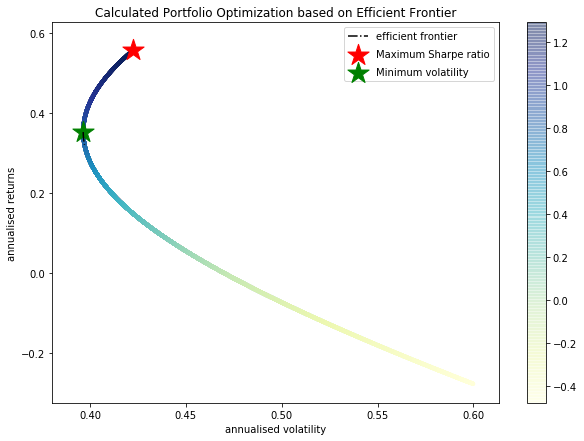

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AYI : annuaised return -0.28 , annualised volatility: 0.6
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


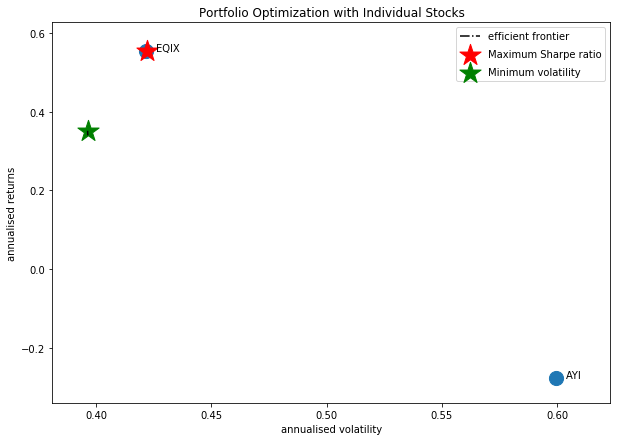

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'BIIB', 'MMM', 'ECL', 'CVS']


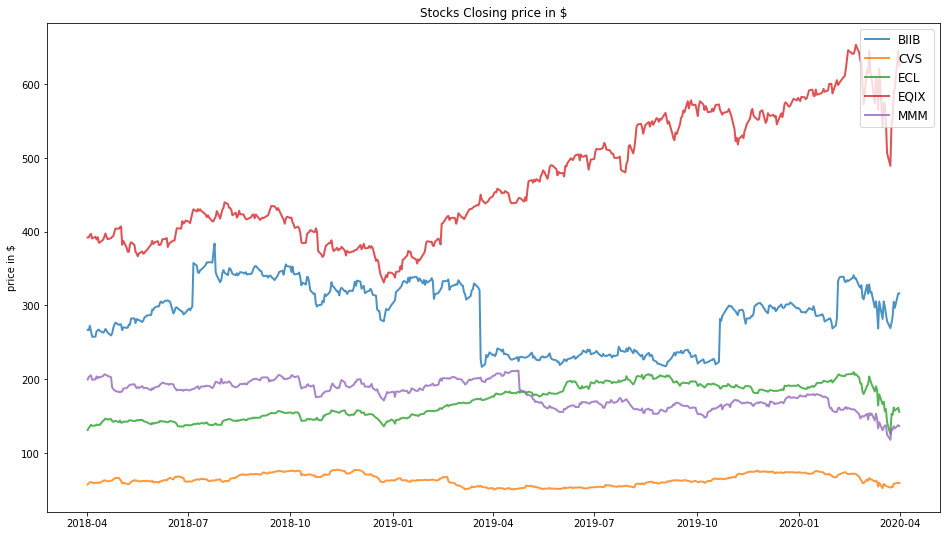

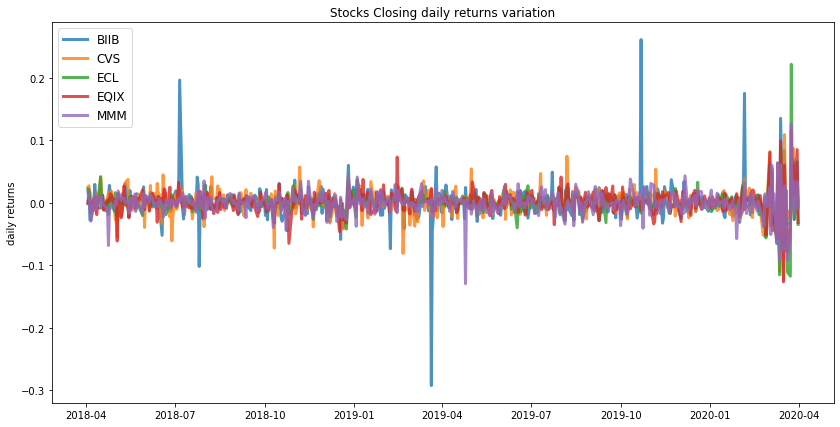

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.54
Annualised Volatility: 0.4


            BIIB  CVS  ECL   EQIX  MMM
allocation  9.79  0.0  0.0  90.21  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.17
Annualised Volatility: 0.34


            BIIB   CVS   ECL   EQIX    MMM
allocation  7.27  18.9  9.07  32.84  31.92


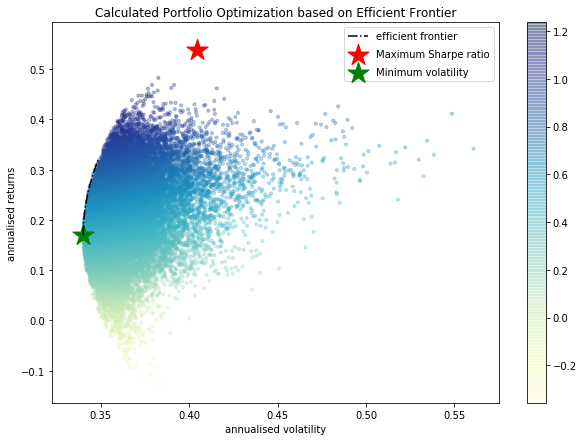

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
ECL : annuaised return 0.27 , annualised volatility: 0.44
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


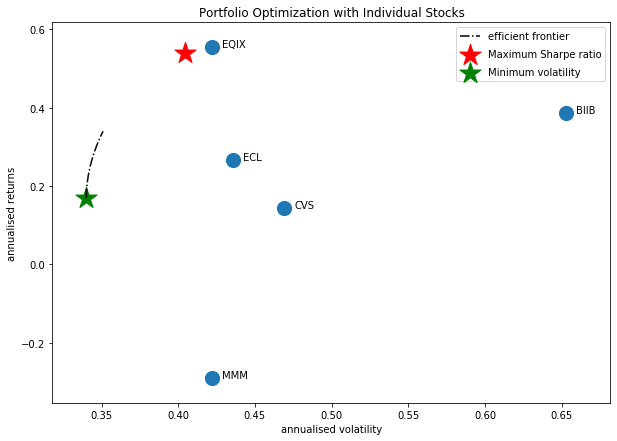

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'AZO', 'EQIX', 'BIIB', 'MMM', 'ANTM', 'CVS']


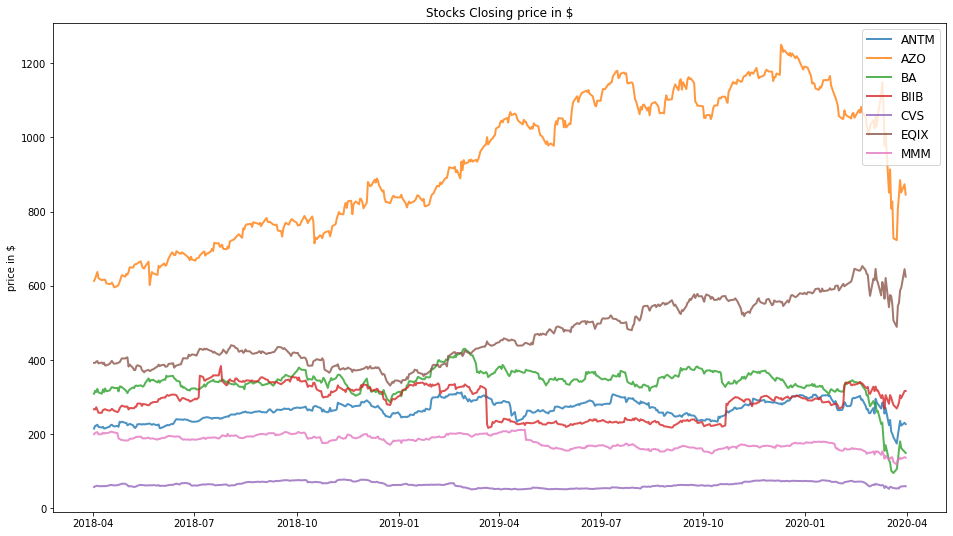

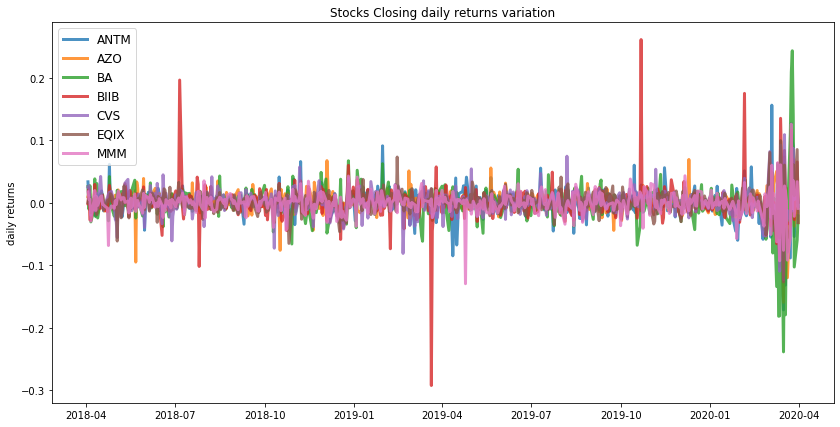

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.51
Annualised Volatility: 0.37


            ANTM    AZO   BA  BIIB  CVS   EQIX  MMM
allocation   0.0  26.35  0.0  6.61  0.0  67.04  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.22
Annualised Volatility: 0.33


            ANTM    AZO   BA  BIIB    CVS   EQIX    MMM
allocation   0.0  23.76  0.0  6.52  15.24  27.36  27.13


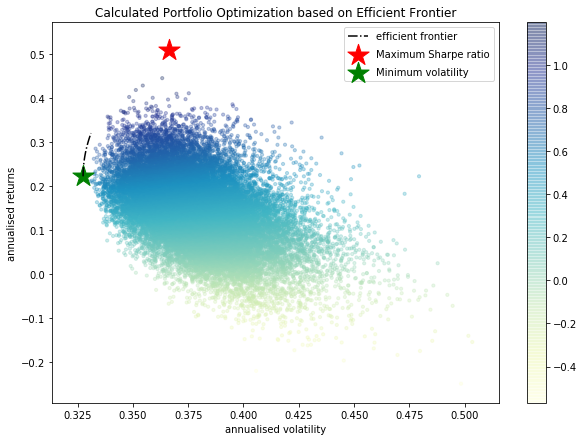

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ANTM : annuaised return 0.21 , annualised volatility: 0.55
AZO : annuaised return 0.43 , annualised volatility: 0.45
BA : annuaised return -0.47 , annualised volatility: 0.72
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


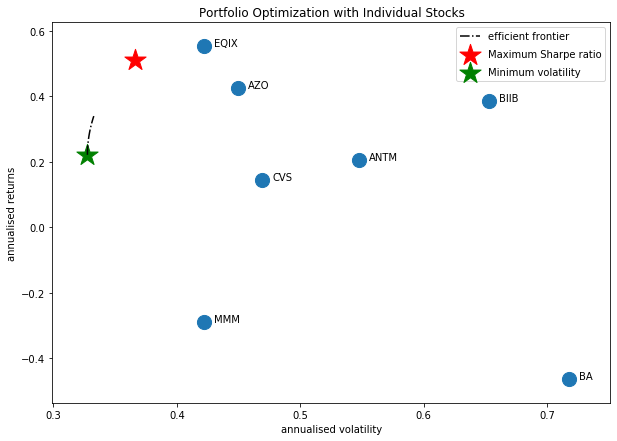

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AAPL', 'BIIB', 'MMM', 'CVS', 'NEM']


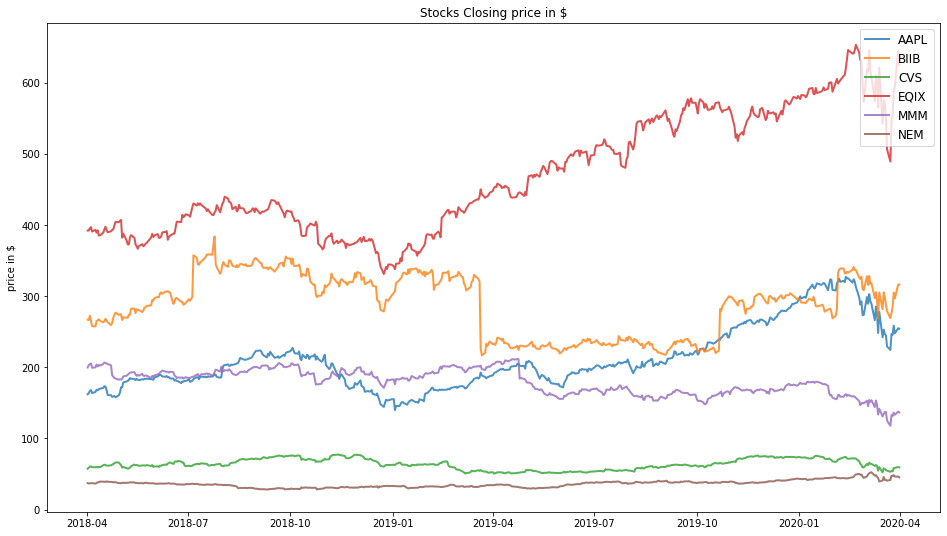

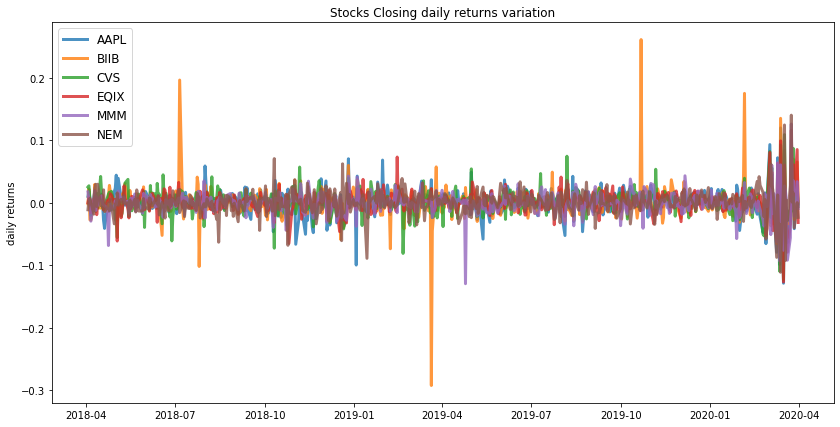

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.5
Annualised Volatility: 0.33


             AAPL  BIIB  CVS   EQIX  MMM    NEM
allocation  28.26  3.36  0.0  46.25  0.0  22.12
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.2
Annualised Volatility: 0.29


            AAPL  BIIB    CVS   EQIX    MMM    NEM
allocation  0.26  6.21  16.55  20.56  22.39  34.03


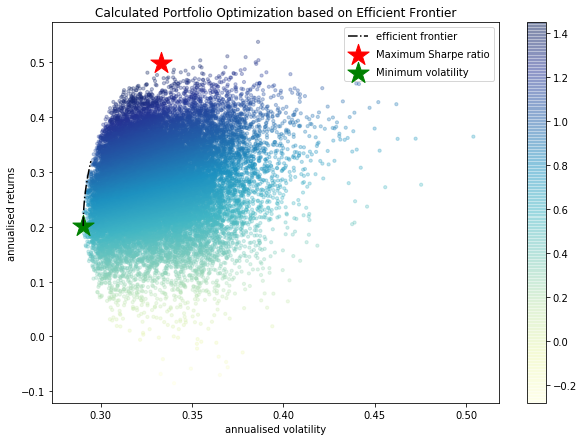

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
NEM : annuaised return 0.3 , annualised volatility: 0.46
--------------------------------------------------------------------------------


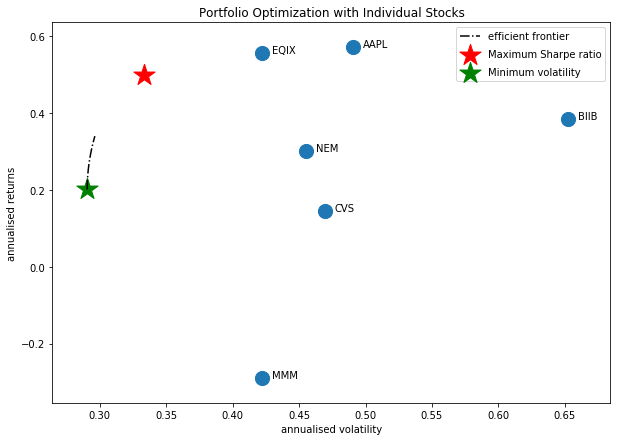

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'BIIB', 'MMM', 'CVS', 'COP']


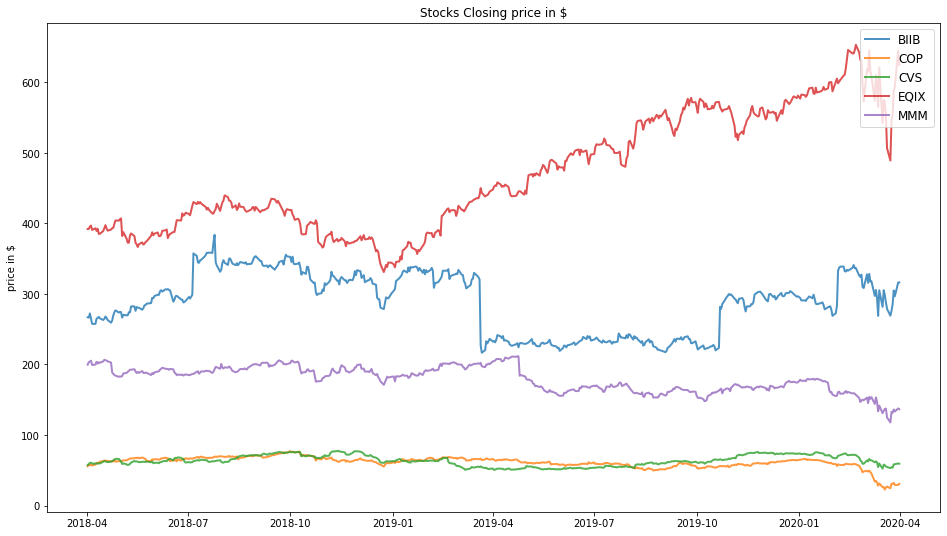

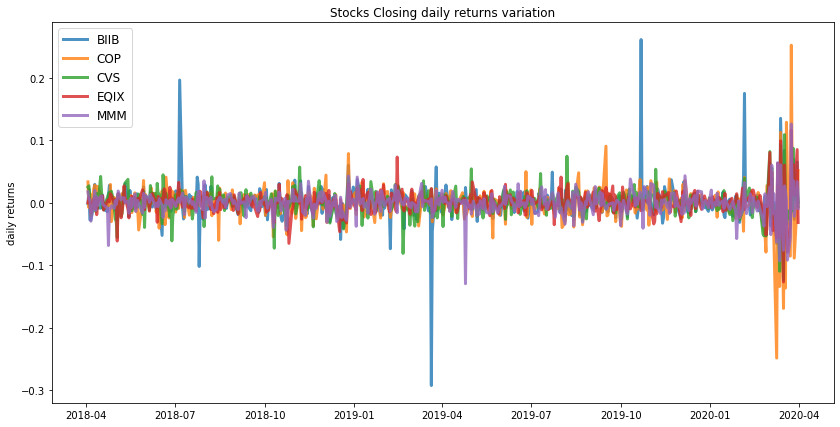

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.54
Annualised Volatility: 0.4


            BIIB  COP  CVS   EQIX  MMM
allocation  9.84  0.0  0.0  90.16  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.16
Annualised Volatility: 0.34


            BIIB  COP    CVS   EQIX    MMM
allocation  7.39  0.0  19.96  36.93  35.72


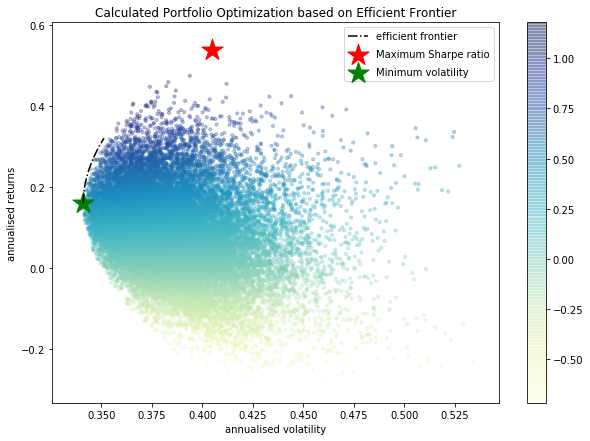

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

BIIB : annuaised return 0.39 , annualised volatility: 0.65
COP : annuaised return -0.38 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


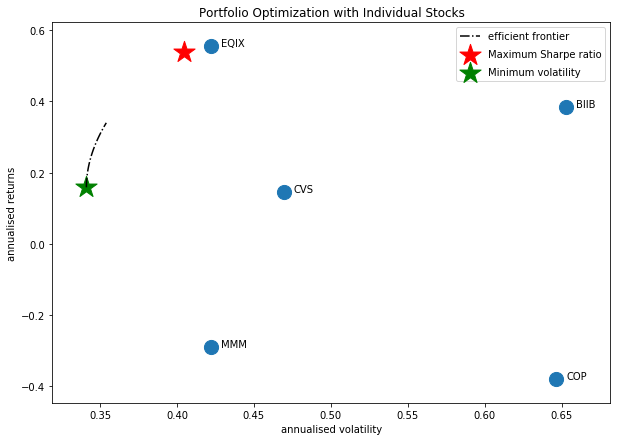

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['BA', 'AZO', 'EQIX', 'CVS', 'ABC']


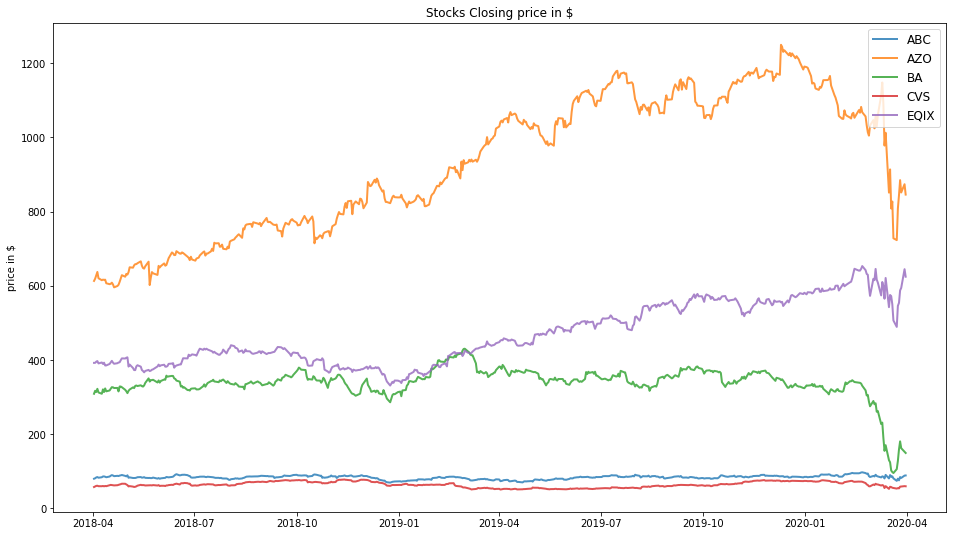

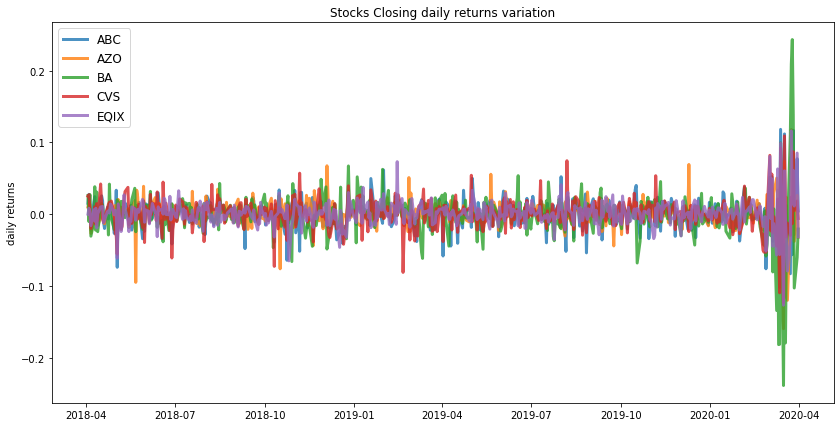

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.52
Annualised Volatility: 0.37


            ABC    AZO   BA  CVS   EQIX
allocation  0.0  28.27  0.0  0.0  71.73
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.39
Annualised Volatility: 0.35


             ABC   AZO   BA   CVS   EQIX
allocation  5.75  32.6  0.0  24.5  37.15


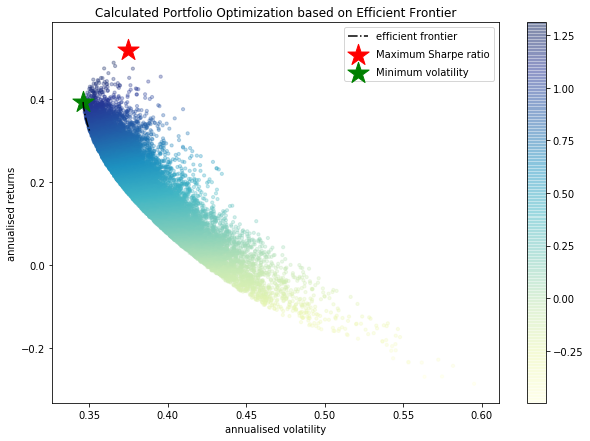

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.23 , annualised volatility: 0.49
AZO : annuaised return 0.43 , annualised volatility: 0.45
BA : annuaised return -0.47 , annualised volatility: 0.72
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


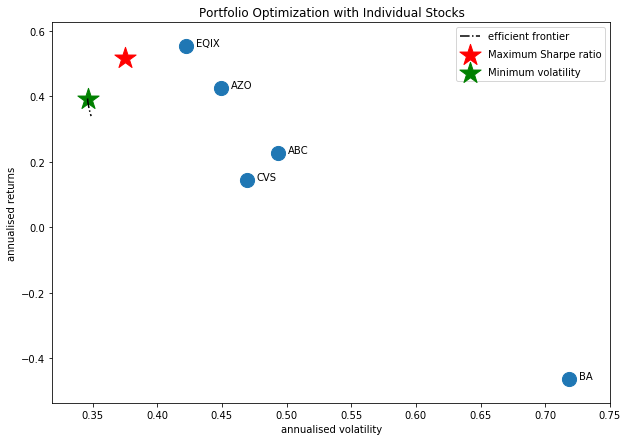

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'DHI']


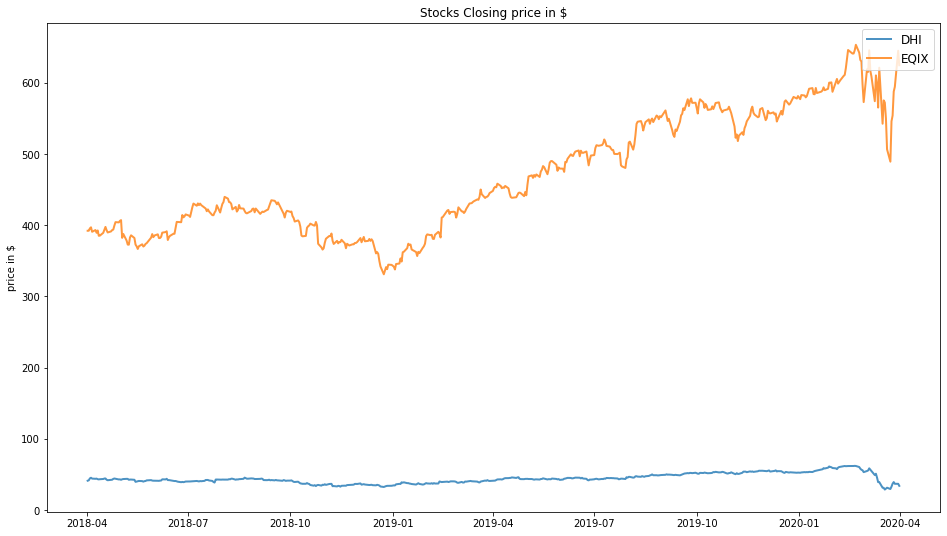

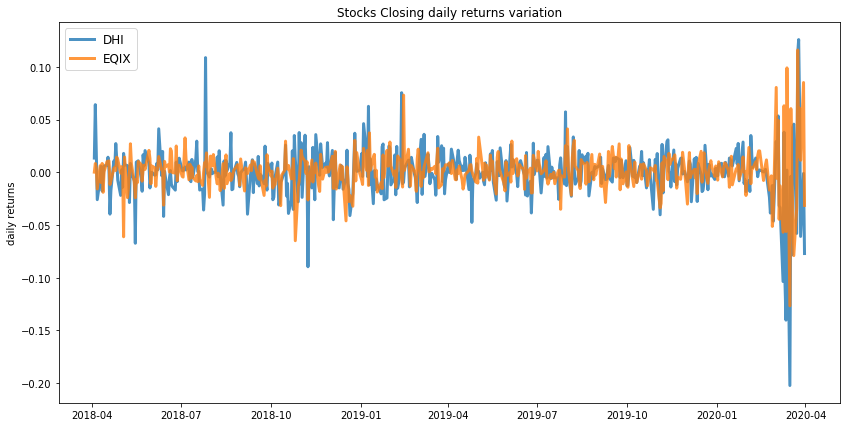

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.42


            DHI   EQIX
allocation  0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.39
Annualised Volatility: 0.4


              DHI   EQIX
allocation  27.48  72.52


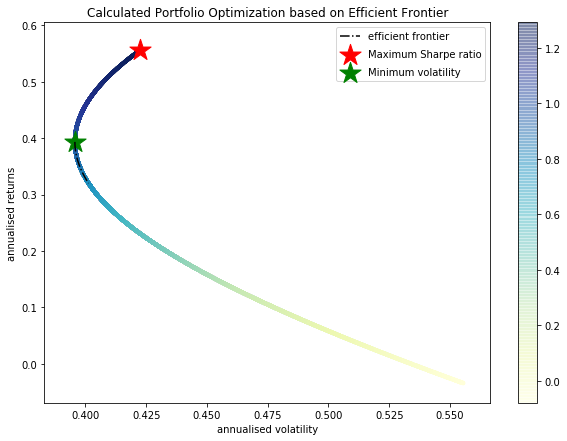

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

DHI : annuaised return -0.03 , annualised volatility: 0.55
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


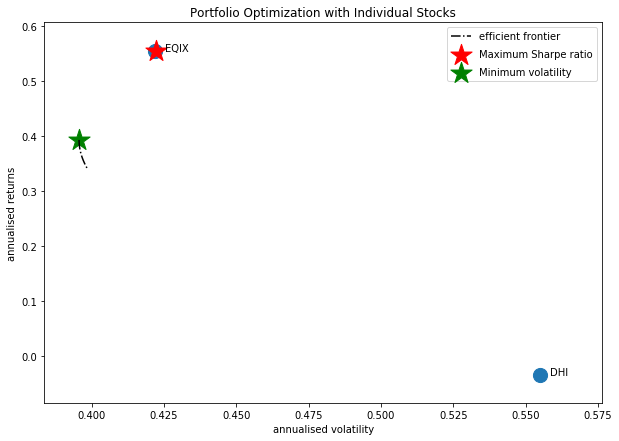

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'ALXN']


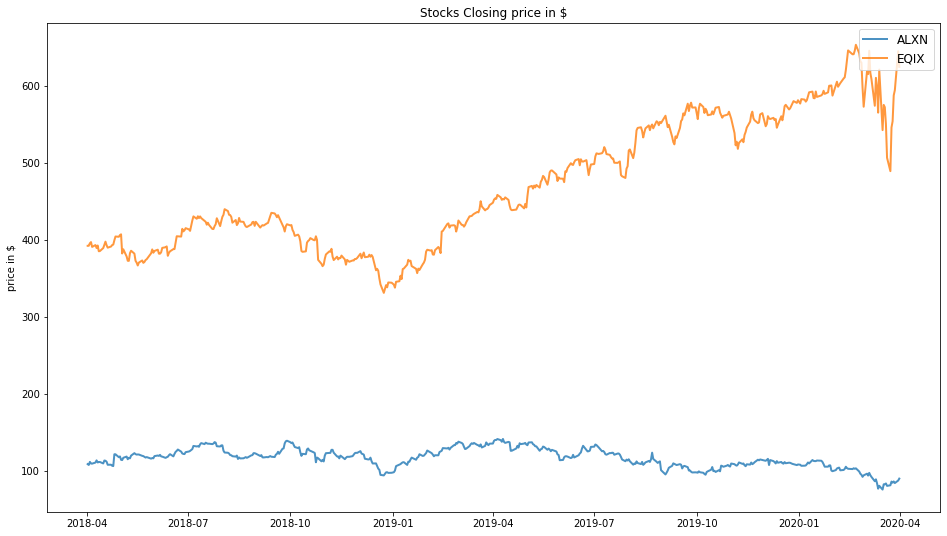

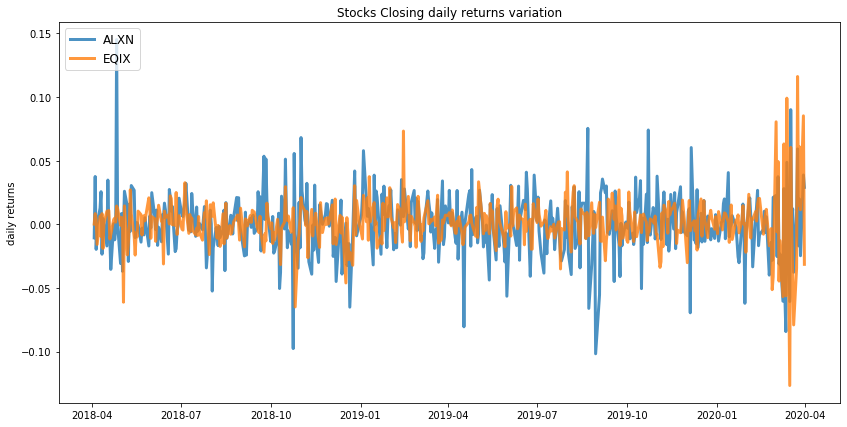

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.42


            ALXN   EQIX
allocation   0.0  100.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.37
Annualised Volatility: 0.38


             ALXN   EQIX
allocation  31.15  68.85


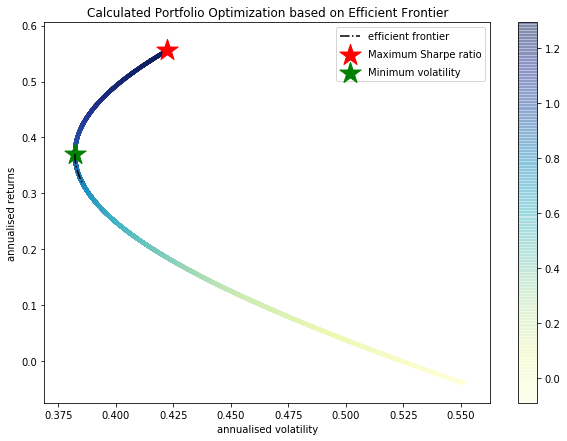

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ALXN : annuaised return -0.04 , annualised volatility: 0.55
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


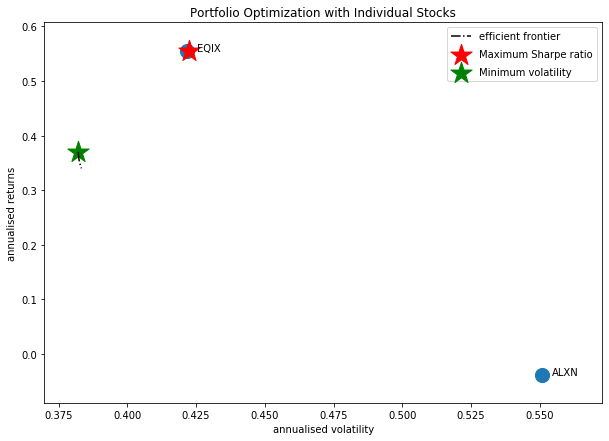

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMD', 'CXO', 'AMGN', 'BIIB', 'MMM', 'CVS']


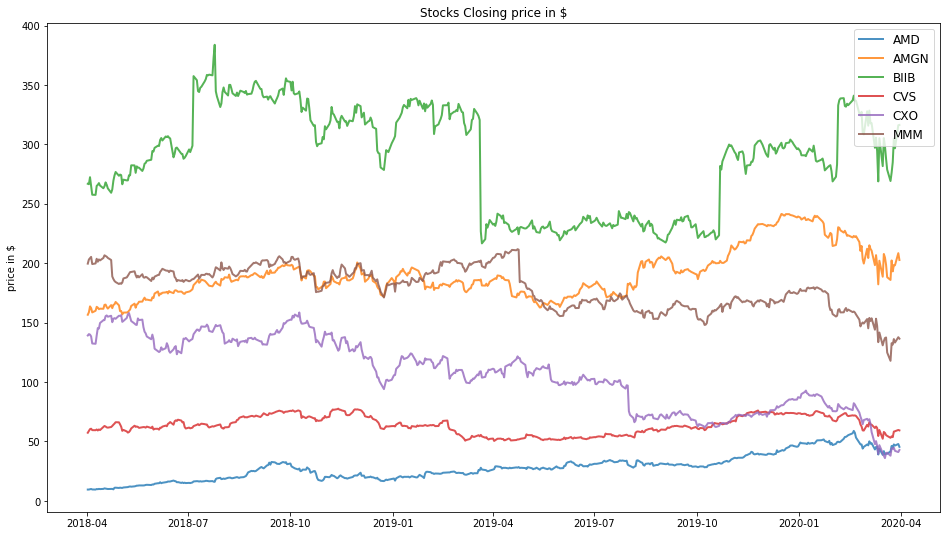

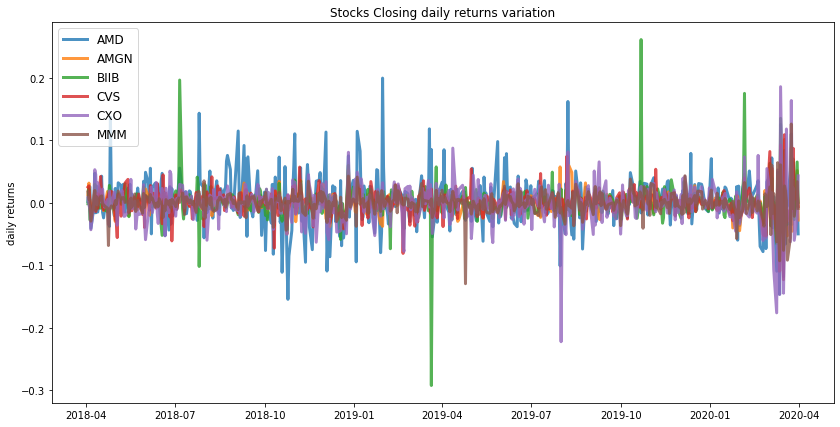

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


              AMD  AMGN  BIIB  CVS  CXO  MMM
allocation  91.18   0.0  8.82  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.35


            AMD   AMGN  BIIB    CVS  CXO    MMM
allocation  0.0  39.07  3.98  20.56  0.0  36.39


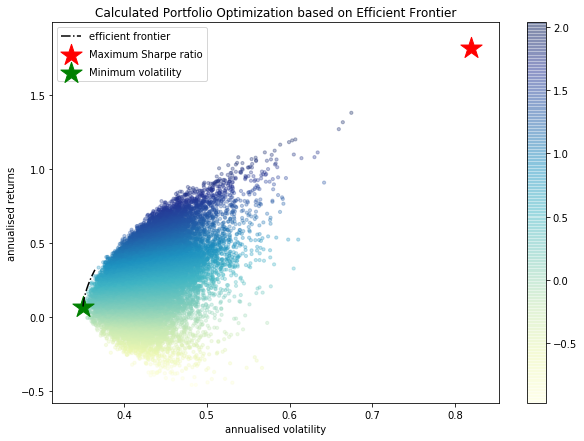

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


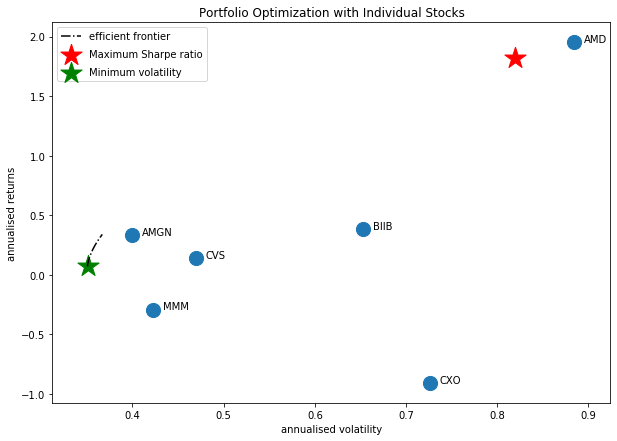

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CXO', 'EQIX', 'AMGN', 'AAPL', 'BIIB', 'MMM', 'CVS']


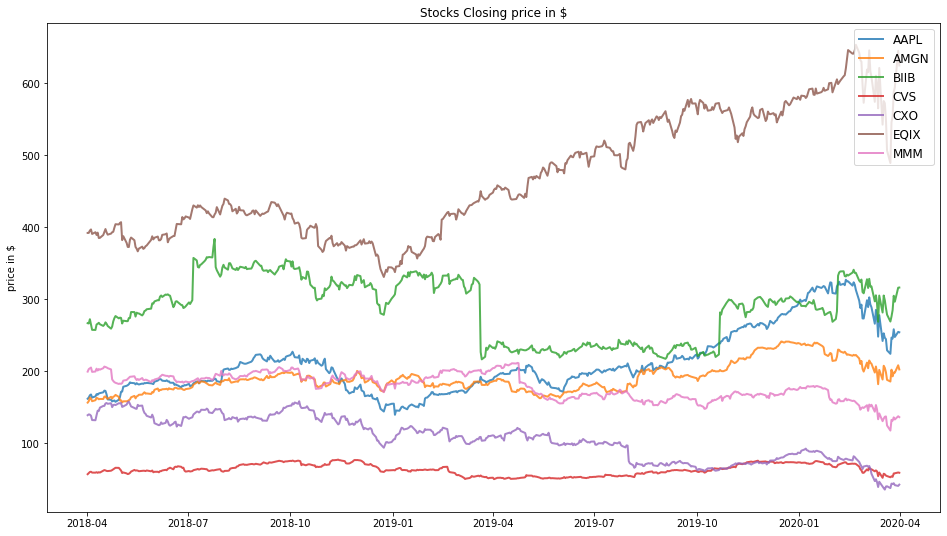

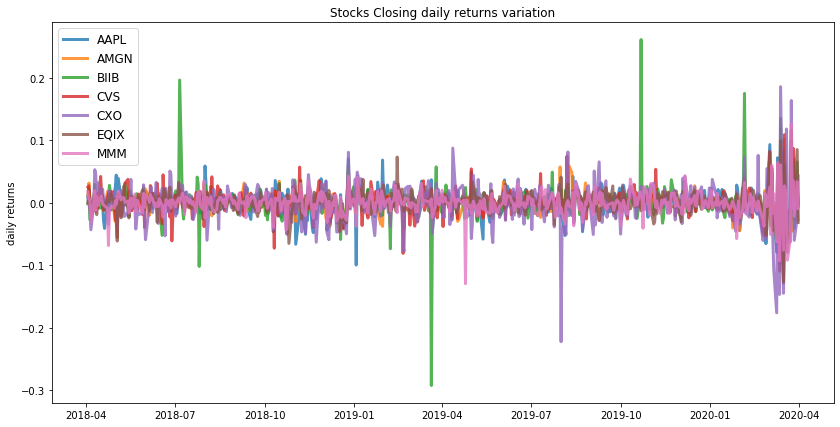

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.56
Annualised Volatility: 0.39


             AAPL  AMGN  BIIB  CVS  CXO   EQIX  MMM
allocation  34.79   0.0  3.41  0.0  0.0  61.79  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.19
Annualised Volatility: 0.34


            AAPL   AMGN  BIIB    CVS  CXO   EQIX    MMM
allocation   0.0  23.26  3.62  14.86  0.0  29.23  29.03


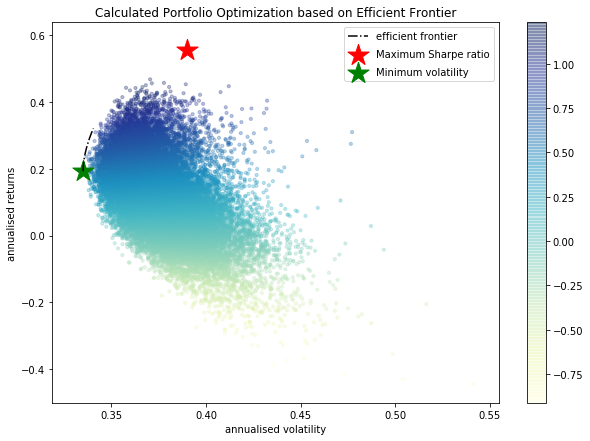

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AAPL : annuaised return 0.57 , annualised volatility: 0.49
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


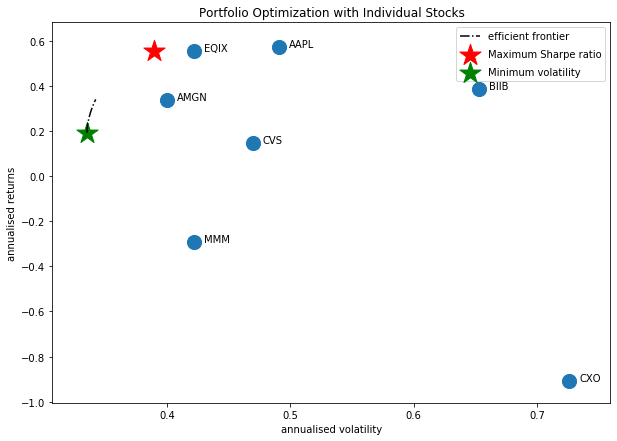

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMD', 'CXO', 'SHW', 'EQIX', 'AMGN', 'BIIB', 'MMM', 'CVS']


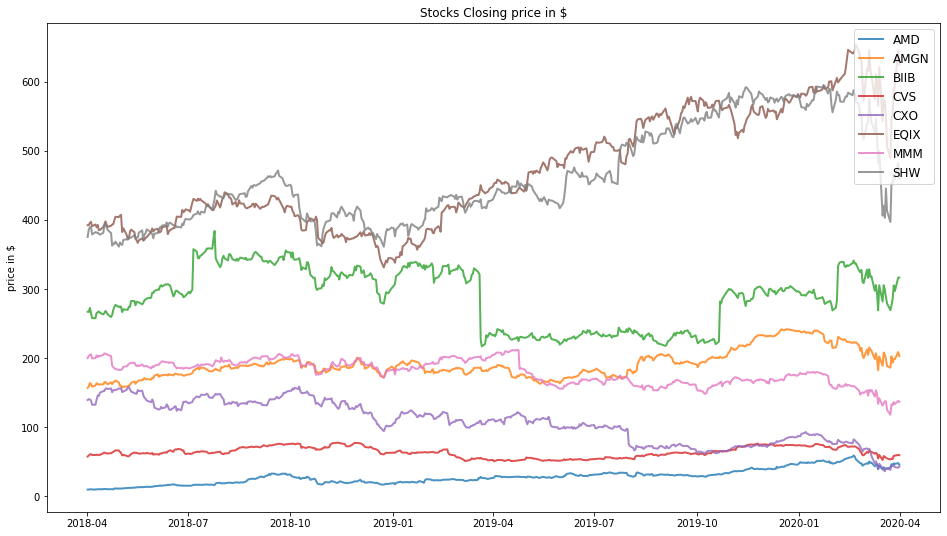

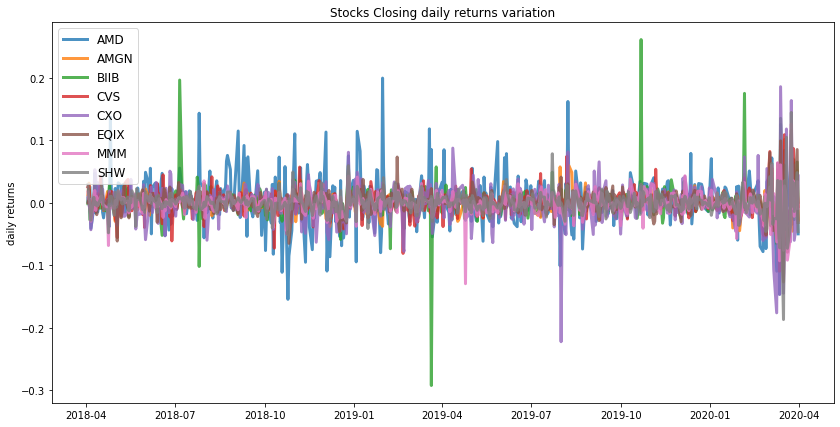

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.42
Annualised Volatility: 0.62


              AMD  AMGN  BIIB  CVS  CXO   EQIX  MMM  SHW
allocation  62.14   0.0  0.88  0.0  0.0  36.98  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.21
Annualised Volatility: 0.33


            AMD   AMGN  BIIB    CVS  CXO   EQIX    MMM    SHW
allocation  0.0  22.05  3.37  13.82  0.0  25.64  24.31  10.82


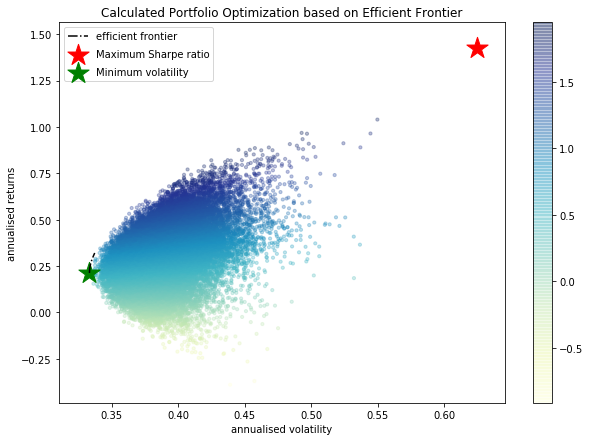

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
SHW : annuaised return 0.3 , annualised volatility: 0.44
--------------------------------------------------------------------------------


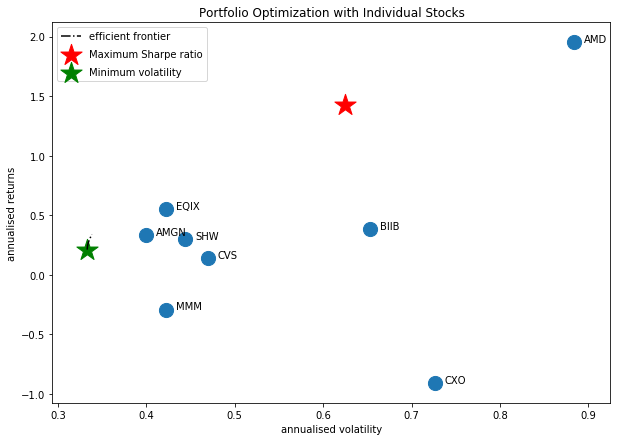

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMD', 'CXO', 'AMGN', 'BIIB', 'MMM', 'CVS', 'PCG']


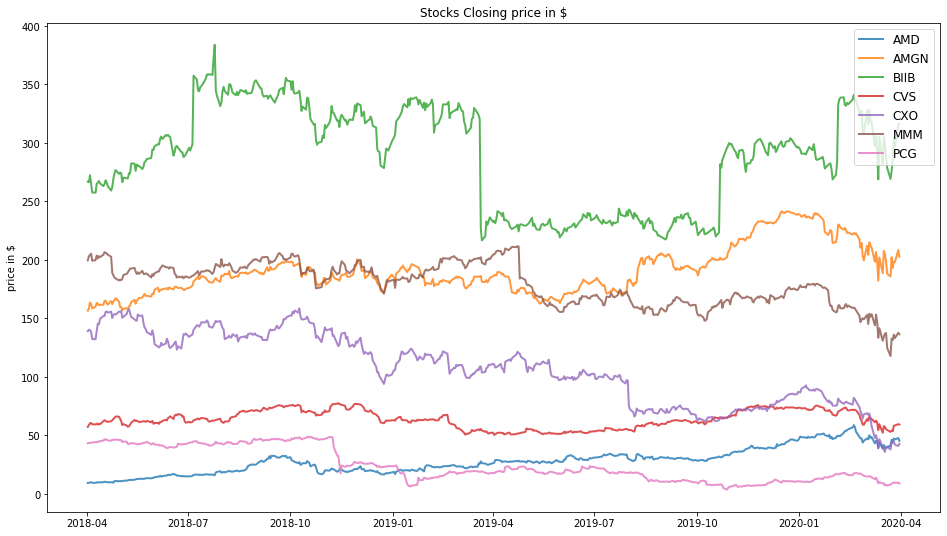

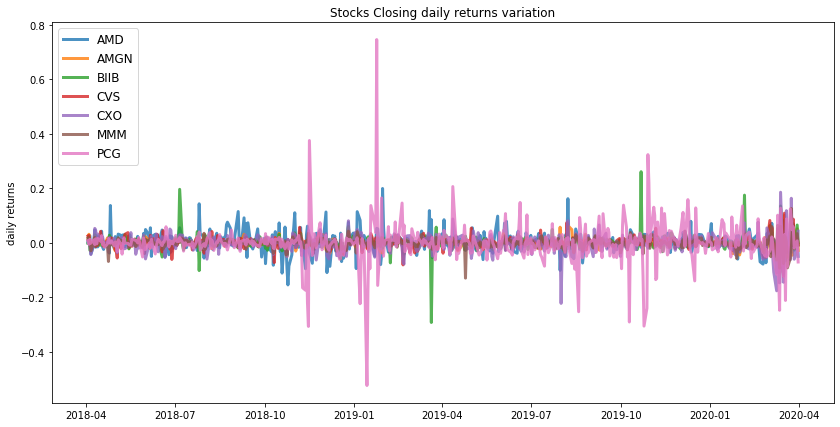

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


              AMD  AMGN  BIIB  CVS  CXO  MMM  PCG
allocation  91.18   0.0  8.82  0.0  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.35


            AMD  AMGN  BIIB    CVS  CXO    MMM   PCG
allocation  0.0  38.5  3.91  20.36  0.0  36.17  1.05


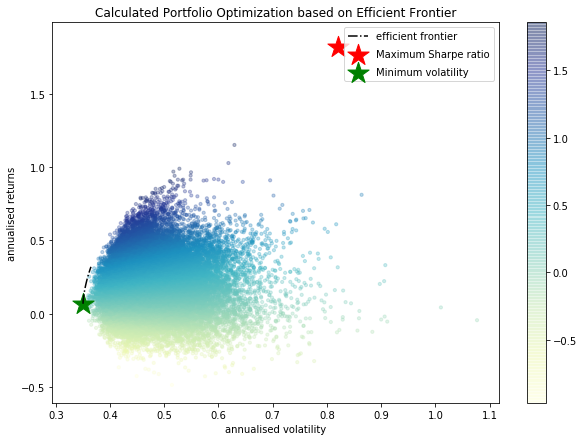

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
MMM : annuaised return -0.29 , annualised volatility: 0.42
PCG : annuaised return -0.16 , annualised volatility: 1.67
--------------------------------------------------------------------------------


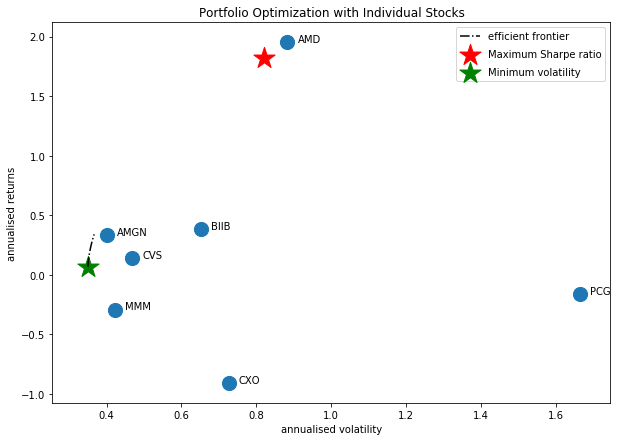

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMD', 'CXO', 'AMGN', 'BIIB', 'MMM', 'CVS', 'ABC']


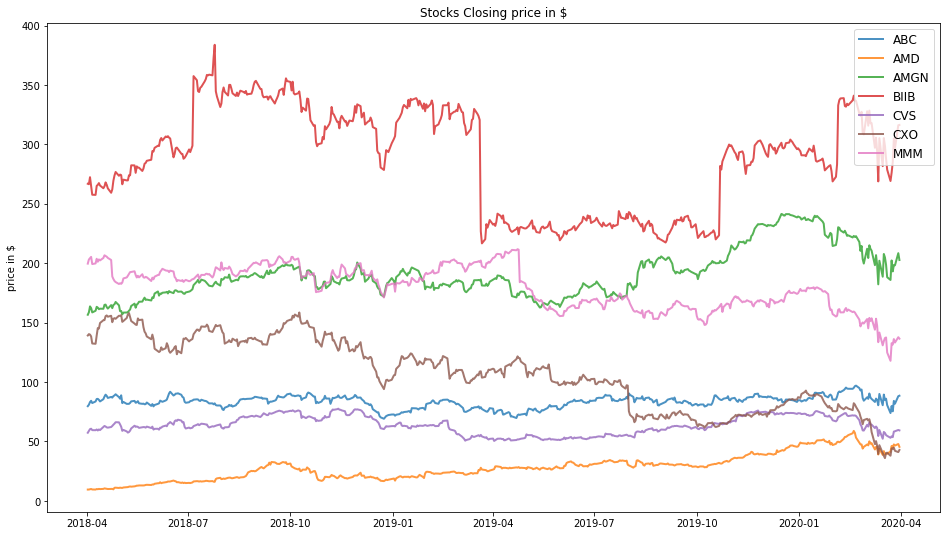

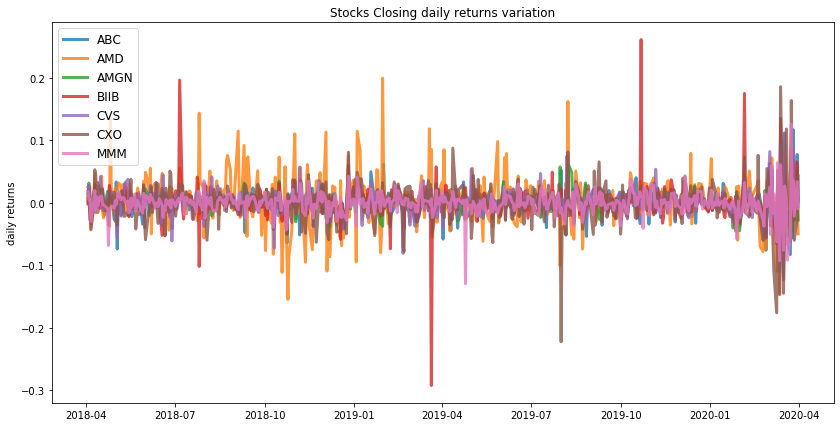

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.82
Annualised Volatility: 0.82


            ABC    AMD  AMGN  BIIB  CVS  CXO  MMM
allocation  0.0  91.18   0.0  8.82  0.0  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.07
Annualised Volatility: 0.35


             ABC  AMD  AMGN  BIIB    CVS  CXO    MMM
allocation  4.37  0.0  37.4  3.81  18.67  0.0  35.76


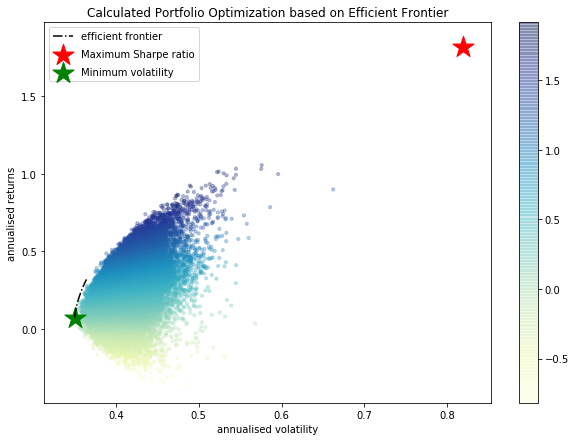

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.23 , annualised volatility: 0.49
AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


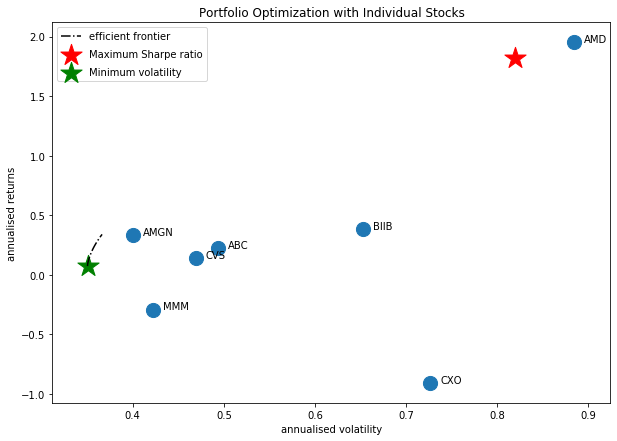

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AMD', 'EQIX', 'AMGN', 'BIIB', 'ANTM', 'CVS', 'ABC']


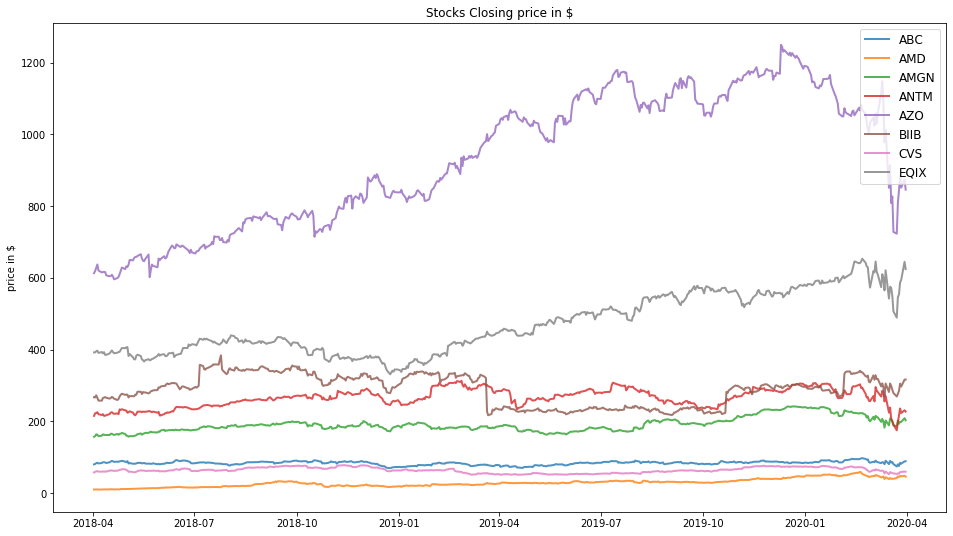

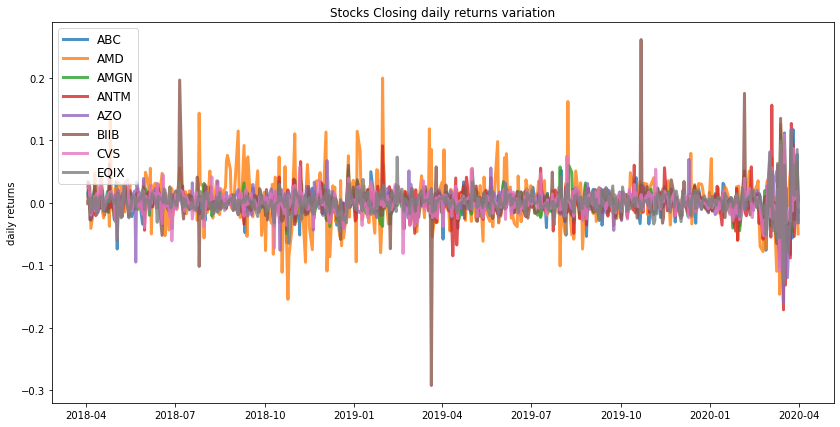

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.37
Annualised Volatility: 0.6


            ABC    AMD  AMGN  ANTM   AZO  BIIB  CVS   EQIX
allocation  0.0  58.68   0.0   0.0  9.12  0.26  0.0  31.94
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.39
Annualised Volatility: 0.33


            ABC  AMD   AMGN  ANTM    AZO  BIIB    CVS   EQIX
allocation  0.0  0.0  30.97   0.0  28.31  3.38  13.97  23.37


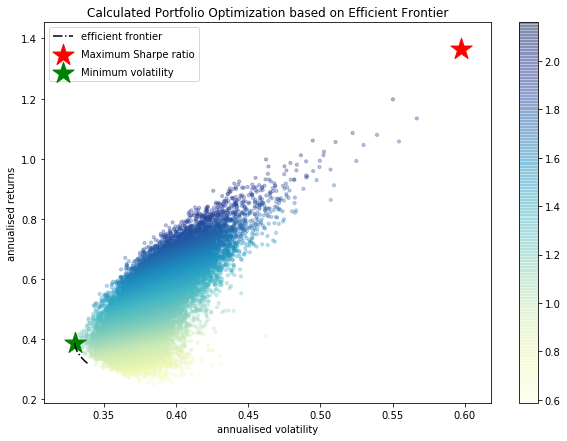

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

ABC : annuaised return 0.23 , annualised volatility: 0.49
AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
ANTM : annuaised return 0.21 , annualised volatility: 0.55
AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


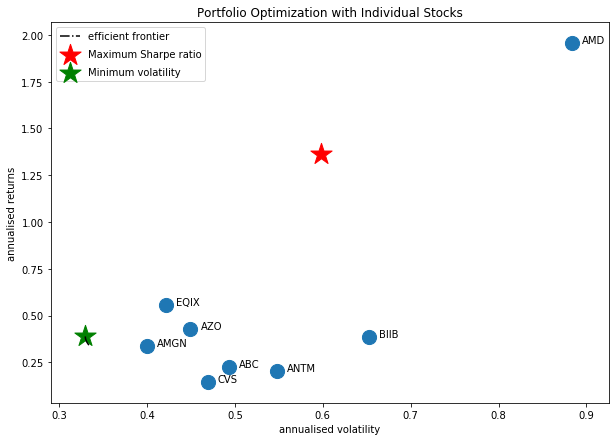

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CXO', 'EQIX', 'AMGN', 'BIIB', 'MMM', 'ECL', 'CVS']


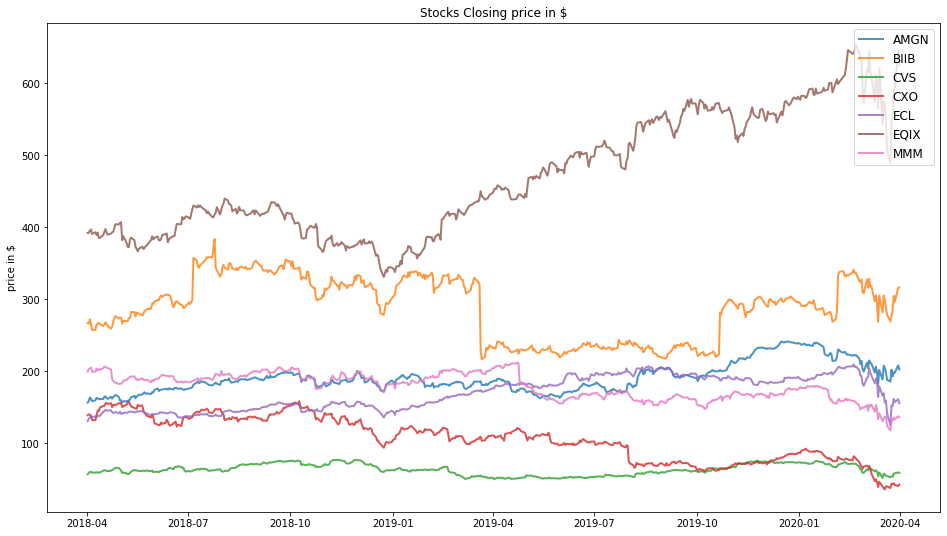

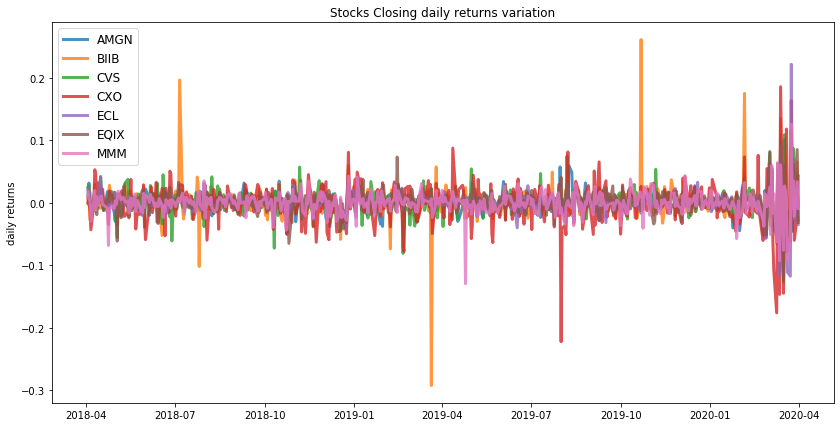

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.4


            AMGN  BIIB  CVS  CXO  ECL   EQIX  MMM
allocation  3.29   9.0  0.0  0.0  0.0  87.71  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.2
Annualised Volatility: 0.33


             AMGN  BIIB    CVS  CXO   ECL   EQIX    MMM
allocation  22.42  3.71  14.52  0.0  5.69  26.88  26.78


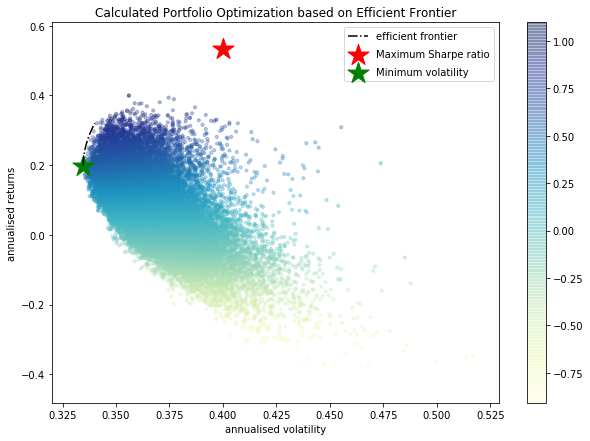

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
ECL : annuaised return 0.27 , annualised volatility: 0.44
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


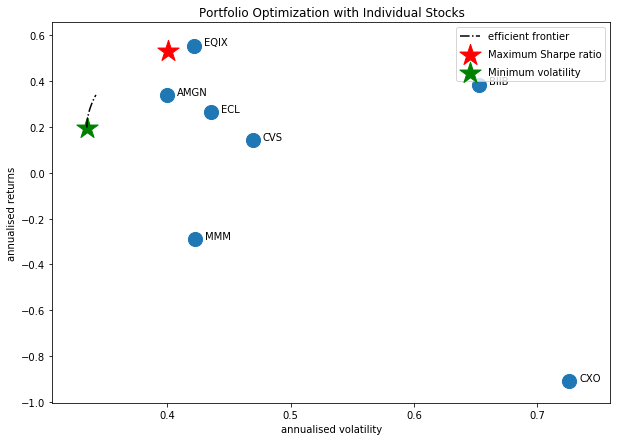

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['EQIX', 'AMGN', 'BIIB', 'MMM', 'CVS', 'NEM']


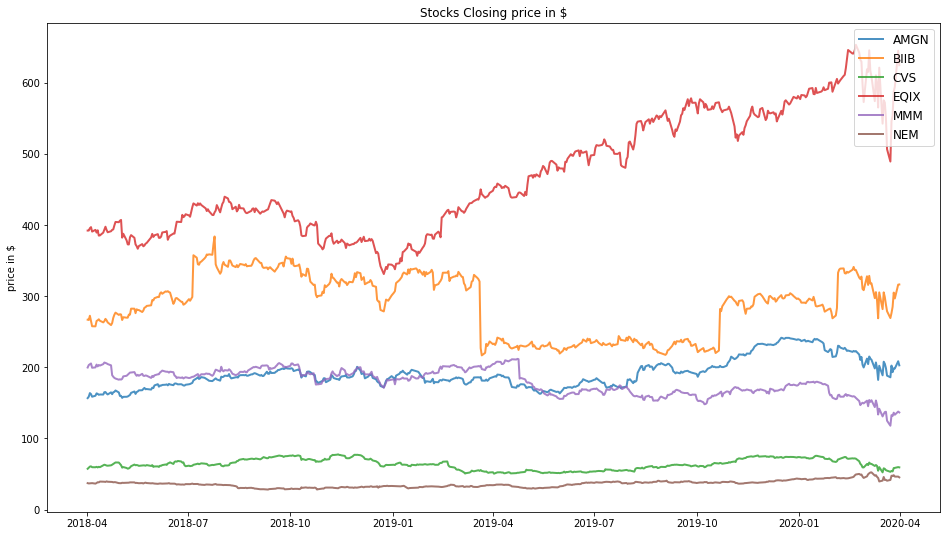

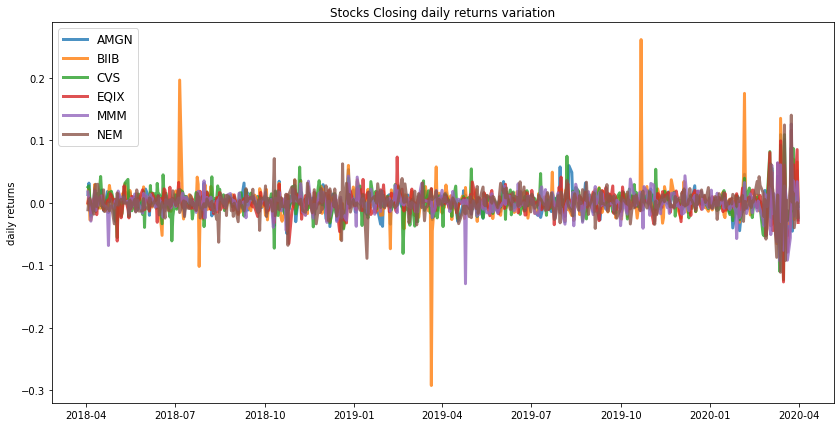

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.48
Annualised Volatility: 0.34


            AMGN  BIIB  CVS   EQIX  MMM   NEM
allocation   0.0  8.46  0.0  67.34  0.0  24.2
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.22
Annualised Volatility: 0.29


             AMGN  BIIB   CVS   EQIX    MMM    NEM
allocation  13.55  4.11  13.7  16.63  19.02  32.97


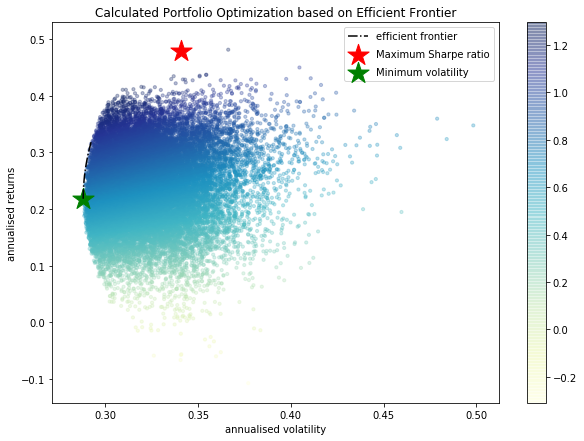

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
NEM : annuaised return 0.3 , annualised volatility: 0.46
--------------------------------------------------------------------------------


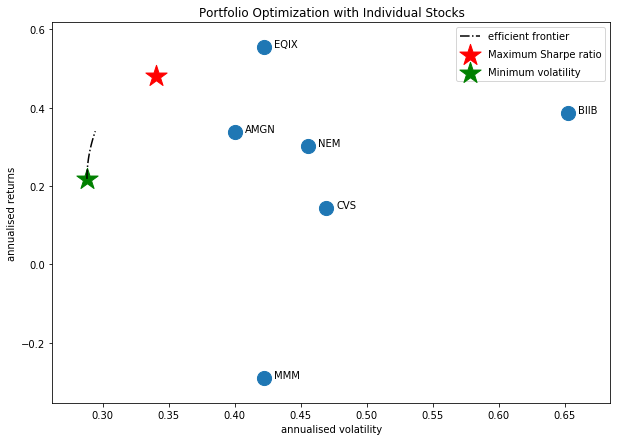

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CXO', 'EQIX', 'AMGN', 'BIIB', 'MMM', 'CVS', 'COP']


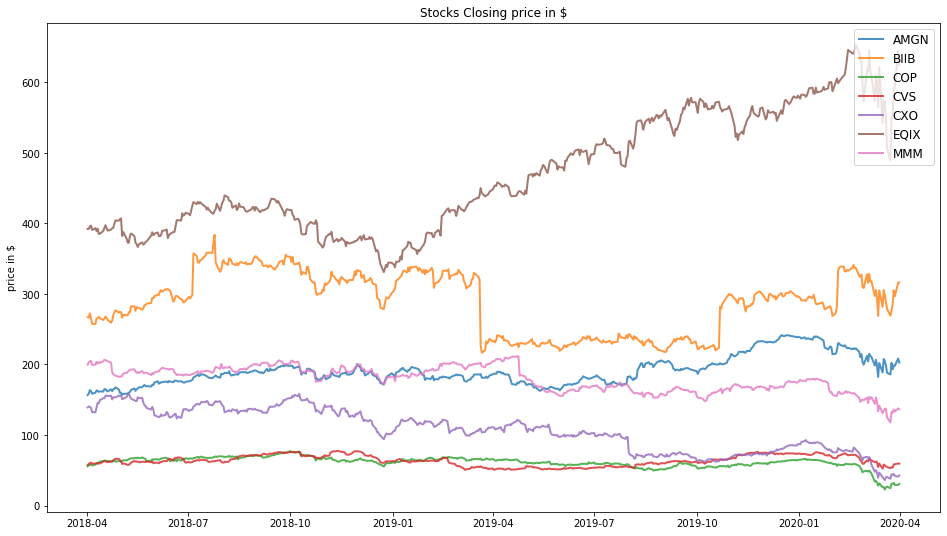

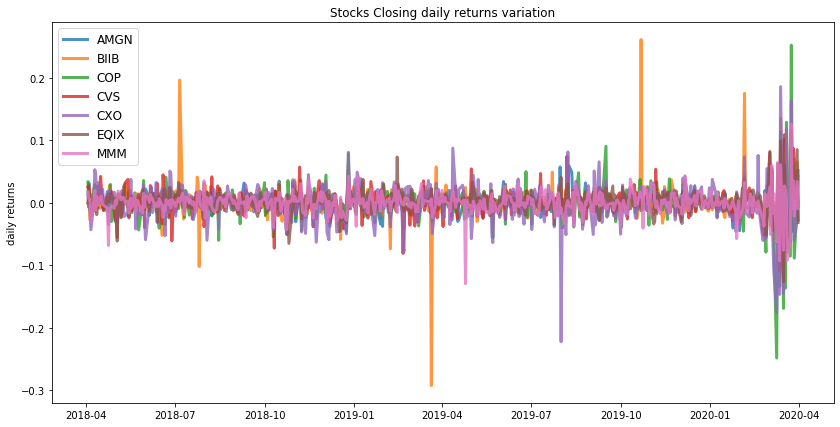

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.4


            AMGN  BIIB  COP  CVS  CXO   EQIX  MMM
allocation  3.13  9.03  0.0  0.0  0.0  87.84  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.19
Annualised Volatility: 0.34


             AMGN  BIIB  COP    CVS  CXO   EQIX    MMM
allocation  23.31   3.6  0.0  14.85  0.0  29.25  28.98


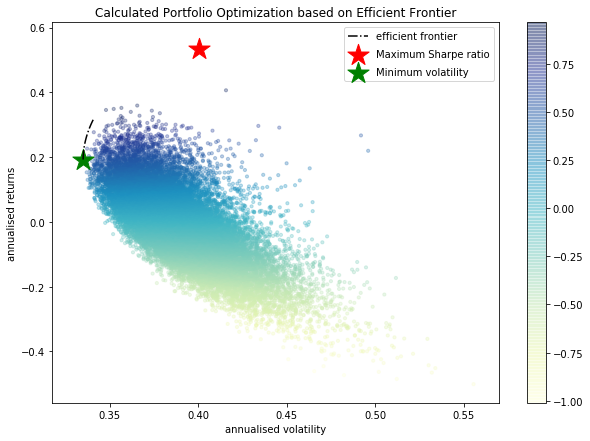

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
COP : annuaised return -0.38 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


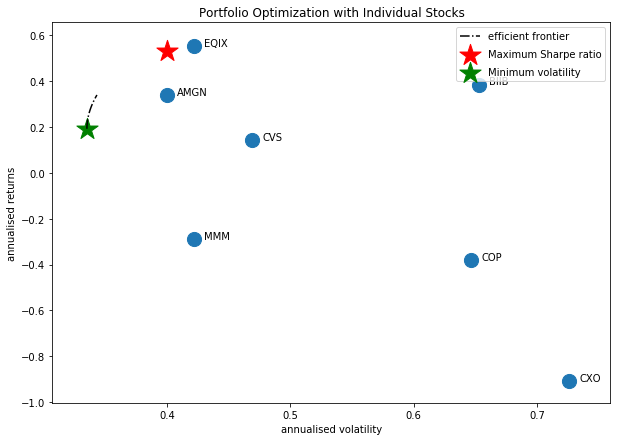

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['CXO', 'SHW', 'EQIX', 'AMGN', 'BIIB', 'MMM', 'ECL', 'CVS']


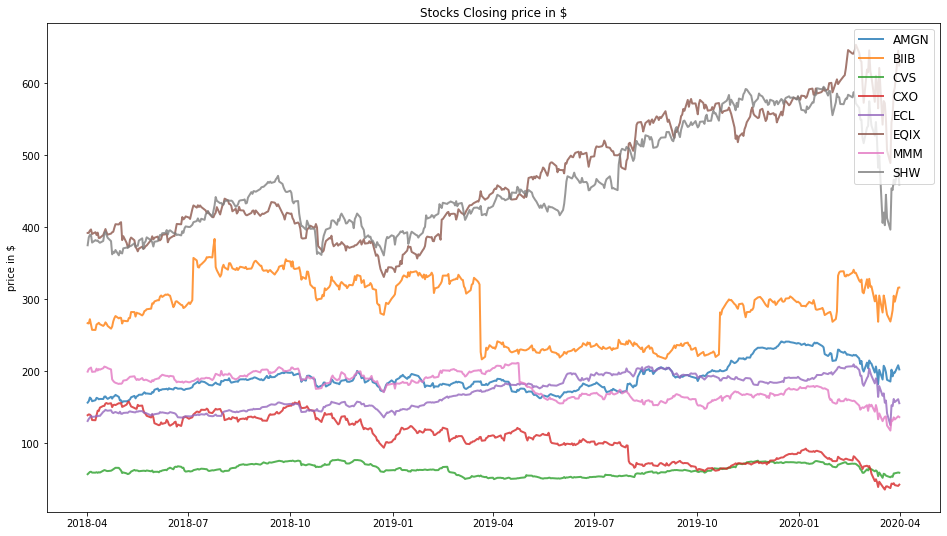

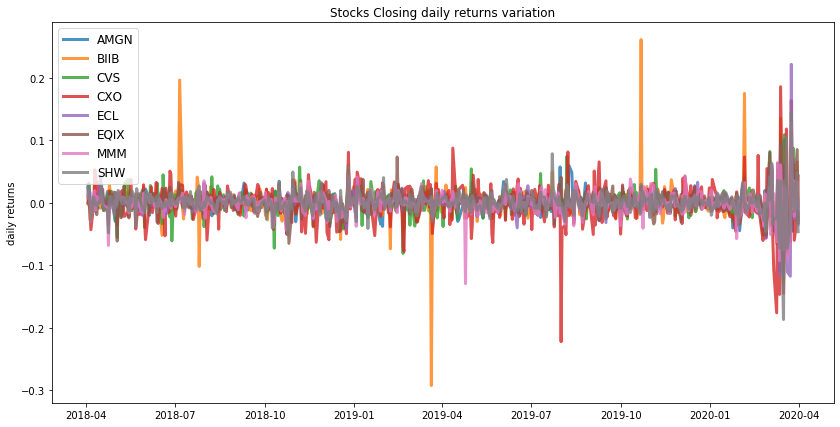

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 0.53
Annualised Volatility: 0.4


            AMGN  BIIB  CVS  CXO  ECL   EQIX  MMM  SHW
allocation  3.32  9.02  0.0  0.0  0.0  87.66  0.0  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.21
Annualised Volatility: 0.33


            AMGN  BIIB   CVS  CXO  ECL   EQIX    MMM    SHW
allocation  21.7   3.4  13.8  0.0  1.1  25.34  24.27  10.39


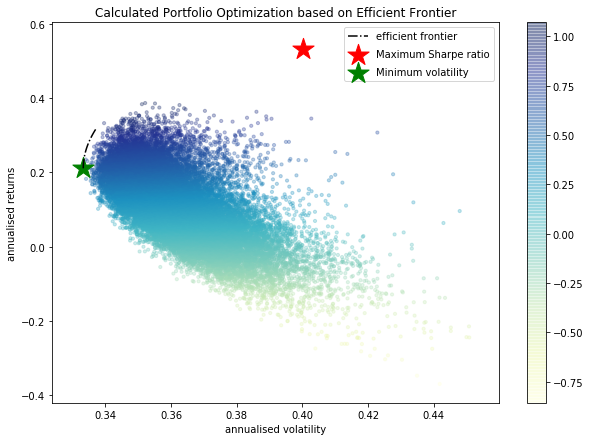

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMGN : annuaised return 0.34 , annualised volatility: 0.4
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
CXO : annuaised return -0.91 , annualised volatility: 0.73
ECL : annuaised return 0.27 , annualised volatility: 0.44
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
SHW : annuaised return 0.3 , annualised volatility: 0.44
--------------------------------------------------------------------------------


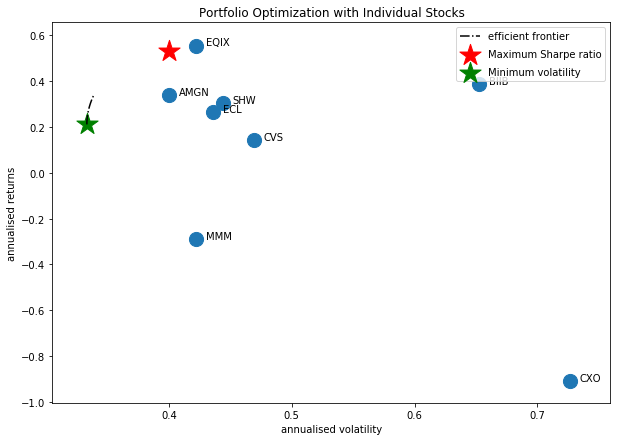

perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AZO', 'AMD', 'EQIX', 'AMGN', 'BIIB', 'MMM', 'ANTM', 'CVS']


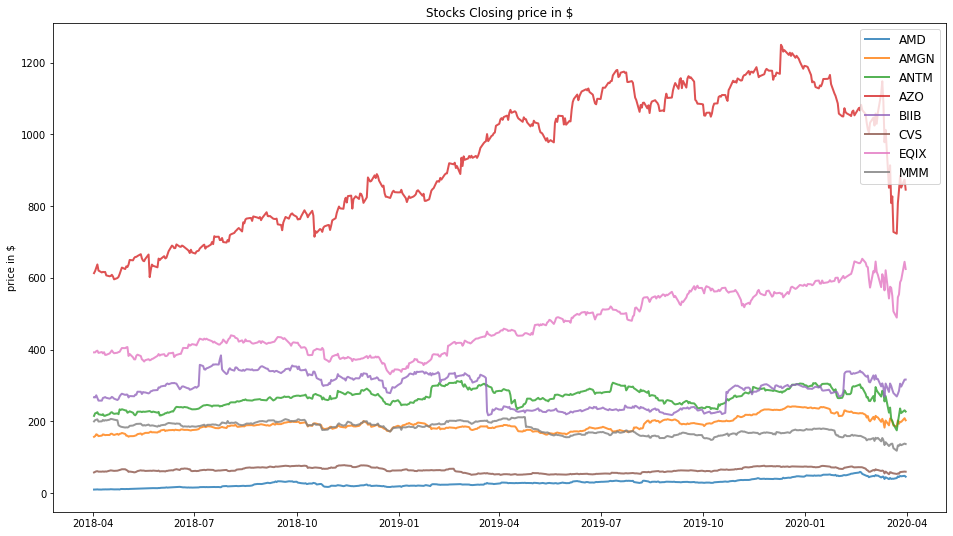

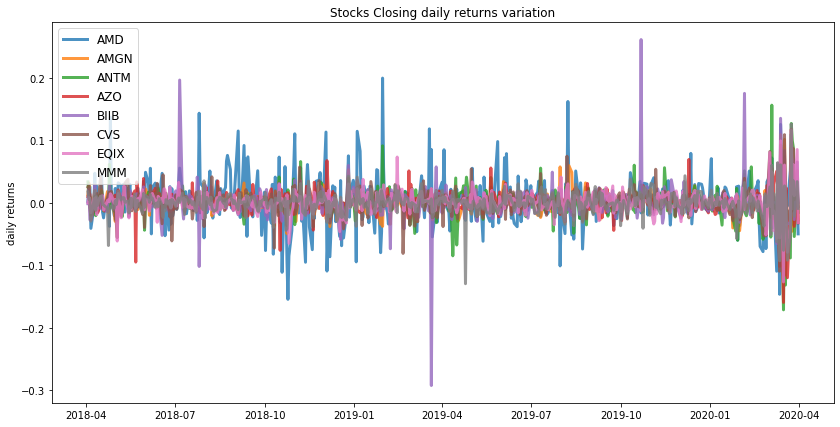

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.37
Annualised Volatility: 0.6


              AMD  AMGN  ANTM   AZO  BIIB  CVS   EQIX  MMM
allocation  58.68   0.0   0.0  9.14  0.23  0.0  31.94  0.0
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.25
Annualised Volatility: 0.32


            AMD   AMGN  ANTM    AZO  BIIB    CVS   EQIX    MMM
allocation  0.0  21.81   0.0  23.03  2.93  10.55  20.55  21.12


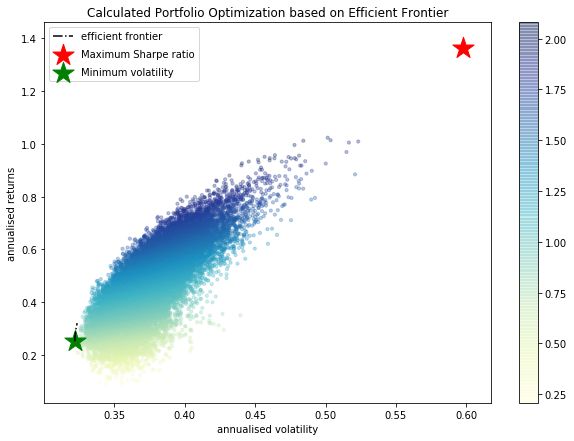

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AMGN : annuaised return 0.34 , annualised volatility: 0.4
ANTM : annuaised return 0.21 , annualised volatility: 0.55
AZO : annuaised return 0.43 , annualised volatility: 0.45
BIIB : annuaised return 0.39 , annualised volatility: 0.65
CVS : annuaised return 0.14 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
MMM : annuaised return -0.29 , annualised volatility: 0.42
--------------------------------------------------------------------------------


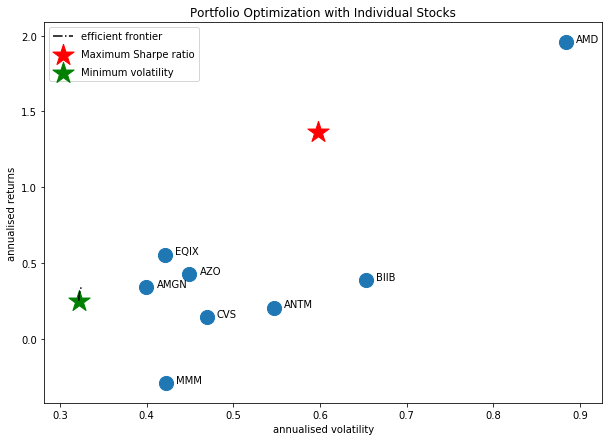

In [28]:
returns_sharpe_company_list = []
start_date = "2018-04-01"
end_date = "2020-04-01"
risk_free_rate = 0.0095
#generate the stocks pairs which are uncorrelated and having covariance less than mean covariance 
stocks_pair = get_portfolio_pairs(portfolio_list)
#print(stocks_pair)
for stock_list in stocks_pair:
    print("perform efficient_frontier_stock_portfolio Pairs of the companies we got {}".format(stock_list))
    pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights = efficient_frontier_stock_portfolio(stock_list, len(stock_list), risk_free_rate, start_date, end_date)
    returns_sharpe_company_list.append([pos_sharpe, Annualised_Return, Annualised_Volatility, stock_list, allocation_weights])

In [29]:
shortlisted_portfolio_df = pd.DataFrame(returns_sharpe_company_list)

In [31]:
shortlisted_portfolio_df.columns = ["Sharpe Ratio", "Portfolio Annualised Return", "Portfolio Annualised_Volatility", "Stock Portfolio", "Stocks Weight Allocation"]

In [32]:
shortlisted_portfolio_df

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation
0,1.292807,0.56,0.42,"[BA, EQIX, CVS, ABC]","[[0.0, 0.0, 0.0, 100.0]]"
1,1.308302,0.53,0.40,"[BA, EQIX, AMGN, BIIB, MMM, CVS]","[[3.24, 0.0, 9.02, 0.0, 87.74, 0.0]]"
2,1.297576,0.53,0.40,"[BA, EQIX, AMGN, CVS, ABC]","[[0.0, 10.47, 0.0, 0.0, 89.53]]"
3,0.882328,0.38,0.42,"[BA, APD]","[[100.0, 0.0]]"
4,-0.660500,-0.47,0.72,"[BA, HST]","[[100.0, 0.0]]"
...,...,...,...,...,...
63,1.308302,0.53,0.40,"[CXO, EQIX, AMGN, BIIB, MMM, ECL, CVS]","[[3.29, 9.0, 0.0, 0.0, 0.0, 87.71, 0.0]]"
64,1.379985,0.48,0.34,"[EQIX, AMGN, BIIB, MMM, CVS, NEM]","[[0.0, 8.46, 0.0, 67.34, 0.0, 24.2]]"
65,1.308302,0.53,0.40,"[CXO, EQIX, AMGN, BIIB, MMM, CVS, COP]","[[3.13, 9.03, 0.0, 0.0, 0.0, 87.84, 0.0]]"
66,1.308302,0.53,0.40,"[CXO, SHW, EQIX, AMGN, BIIB, MMM, ECL, CVS]","[[3.32, 9.02, 0.0, 0.0, 0.0, 87.66, 0.0, 0.0]]"


In [33]:
# creating a blank series 
Portfolio_Tag = pd.Series([]) 

for row in range(len(shortlisted_portfolio_df)):
    if (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 3):
        Portfolio_Tag[row] = "Excellent"
    elif (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 2 and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 3)):
        Portfolio_Tag[row] = "Very Good"
    elif ((shortlisted_portfolio_df["Sharpe Ratio"][row] >= 1)  and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 2)):
        Portfolio_Tag[row] = "Good"
    else:
        Portfolio_Tag[row] = "Bad"
        
# inserting new column with values of list made above         
shortlisted_portfolio_df.insert(5, "Portfolio Tag", Portfolio_Tag) 

In [34]:
shortlisted_portfolio_df

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
0,1.292807,0.56,0.42,"[BA, EQIX, CVS, ABC]","[[0.0, 0.0, 0.0, 100.0]]",Good
1,1.308302,0.53,0.40,"[BA, EQIX, AMGN, BIIB, MMM, CVS]","[[3.24, 0.0, 9.02, 0.0, 87.74, 0.0]]",Good
2,1.297576,0.53,0.40,"[BA, EQIX, AMGN, CVS, ABC]","[[0.0, 10.47, 0.0, 0.0, 89.53]]",Good
3,0.882328,0.38,0.42,"[BA, APD]","[[100.0, 0.0]]",Bad
4,-0.660500,-0.47,0.72,"[BA, HST]","[[100.0, 0.0]]",Bad
...,...,...,...,...,...,...
63,1.308302,0.53,0.40,"[CXO, EQIX, AMGN, BIIB, MMM, ECL, CVS]","[[3.29, 9.0, 0.0, 0.0, 0.0, 87.71, 0.0]]",Good
64,1.379985,0.48,0.34,"[EQIX, AMGN, BIIB, MMM, CVS, NEM]","[[0.0, 8.46, 0.0, 67.34, 0.0, 24.2]]",Good
65,1.308302,0.53,0.40,"[CXO, EQIX, AMGN, BIIB, MMM, CVS, COP]","[[3.13, 9.03, 0.0, 0.0, 0.0, 87.84, 0.0]]",Good
66,1.308302,0.53,0.40,"[CXO, SHW, EQIX, AMGN, BIIB, MMM, ECL, CVS]","[[3.32, 9.02, 0.0, 0.0, 0.0, 87.66, 0.0, 0.0]]",Good


In [35]:
shortlisted_portfolio = shortlisted_portfolio_df[(shortlisted_portfolio_df["Portfolio Tag"] == "Excellent") | (shortlisted_portfolio_df["Portfolio Tag"] == "Very Good") |
                                                    (shortlisted_portfolio_df["Portfolio Tag"] == "Good")]

In [36]:
shortlisted_portfolio = shortlisted_portfolio.sort_values(by="Sharpe Ratio", ascending=False)

In [37]:
shortlisted_portfolio

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
62,2.269017,1.37,0.60,"[AZO, AMD, EQIX, AMGN, BIIB, ANTM, CVS, ABC]","[[0.0, 58.68, 0.0, 0.0, 9.12, 0.26, 0.0, 31.94]]",Very Good
67,2.269017,1.37,0.60,"[AZO, AMD, EQIX, AMGN, BIIB, MMM, ANTM, CVS]","[[58.68, 0.0, 0.0, 9.14, 0.23, 0.0, 31.94, 0.0]]",Very Good
46,2.269016,1.37,0.60,"[AZO, AMD, EQIX, AMGN, BIIB, MMM, CVS, ABC]","[[0.0, 58.7, 0.0, 9.13, 0.21, 0.0, 31.97, 0.0]]",Very Good
11,2.269016,1.37,0.60,"[AZO, AMD, CXO, SHW, EQIX, AMGN, BIIB, MMM, CV...","[[0.0, 58.72, 0.0, 9.16, 0.2, 0.0, 0.0, 31.92,...",Very Good
59,2.264755,1.42,0.62,"[AMD, CXO, SHW, EQIX, AMGN, BIIB, MMM, CVS]","[[62.14, 0.0, 0.88, 0.0, 0.0, 36.98, 0.0, 0.0]]",Very Good
8,2.226706,1.55,0.69,"[AZO, AMD, CXO, AMGN, BIIB, MMM, CVS, ABC]","[[0.0, 73.36, 0.0, 21.92, 4.72, 0.0, 0.0, 0.0]]",Very Good
5,2.226706,1.55,0.69,"[AZO, AMD, BIIB, ANTM, CVS]","[[73.36, 0.0, 21.92, 4.73, 0.0]]",Very Good
15,2.226706,1.55,0.69,"[AZO, AMD, BIIB, CVS, BAC]","[[73.36, 21.92, 0.0, 4.73, 0.0]]",Very Good
16,2.226706,1.55,0.69,"[AZO, AMD, BIIB, CVS, GOOG]","[[73.36, 21.92, 4.71, 0.0, 0.0]]",Very Good
17,2.226706,1.55,0.69,"[APD, AZO, AMD, BIIB, CVS]","[[73.37, 0.0, 21.92, 4.72, 0.0]]",Very Good


## Top 5 portfolios generated for the shortlisted companies for overall 2 yr period

In [38]:
shortlisted_portfolio[:5]

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
62,2.269017,1.37,0.60,"[AZO, AMD, EQIX, AMGN, BIIB, ANTM, CVS, ABC]","[[0.0, 58.68, 0.0, 0.0, 9.12, 0.26, 0.0, 31.94]]",Very Good
67,2.269017,1.37,0.60,"[AZO, AMD, EQIX, AMGN, BIIB, MMM, ANTM, CVS]","[[58.68, 0.0, 0.0, 9.14, 0.23, 0.0, 31.94, 0.0]]",Very Good
46,2.269016,1.37,0.60,"[AZO, AMD, EQIX, AMGN, BIIB, MMM, CVS, ABC]","[[0.0, 58.7, 0.0, 9.13, 0.21, 0.0, 31.97, 0.0]]",Very Good
11,2.269016,1.37,0.60,"[AZO, AMD, CXO, SHW, EQIX, AMGN, BIIB, MMM, CV...","[[0.0, 58.72, 0.0, 9.16, 0.2, 0.0, 0.0, 31.92,...",Very Good
59,2.264755,1.42,0.62,"[AMD, CXO, SHW, EQIX, AMGN, BIIB, MMM, CVS]","[[62.14, 0.0, 0.88, 0.0, 0.0, 36.98, 0.0, 0.0]]",Very Good


## Min - Max reduction technique to identify the portfolio's Goodness

In [39]:
new_df = new_df.drop(["Unnamed: 0"], axis=1)
new_df_group = new_df.groupby("symbol").count().reset_index()

In [40]:
portfolio_list=new_df["symbol"]

portfolio_count = portfolio_list.value_counts()

min_occurences = min(portfolio_count)

max_occurences = max(portfolio_count)

middle = (min_occurences + max_occurences)/2

#print all the companies whose no of occurences have been higher than the (min+max)/2 no. of times.
stock_portfolio_df = new_df_group[new_df_group["start_date"] > middle]

#make the list of the companies in this portfolio.
stock_portfolio_list = list(stock_portfolio_df["symbol"])

print("Reduced portfolio list for the period of 2 years:")
print(stock_portfolio_list)

Reduced portfolio list for the period of 2 years:
['AMD', 'AMZN', 'AZO', 'BKNG', 'EQIX']


perform efficient_frontier_stock_portfolio Pairs of the companies we got ['AMD', 'AMZN', 'AZO', 'BKNG', 'EQIX']


/home/abhishek/anaconda3/anaconda/lib/python3.7/site-packages/ipykernel_launcher.py:184: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



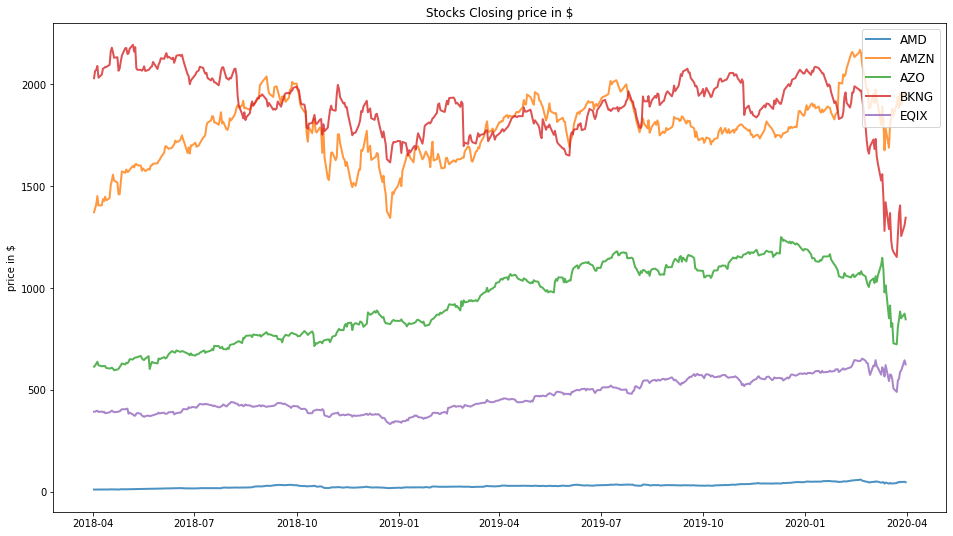

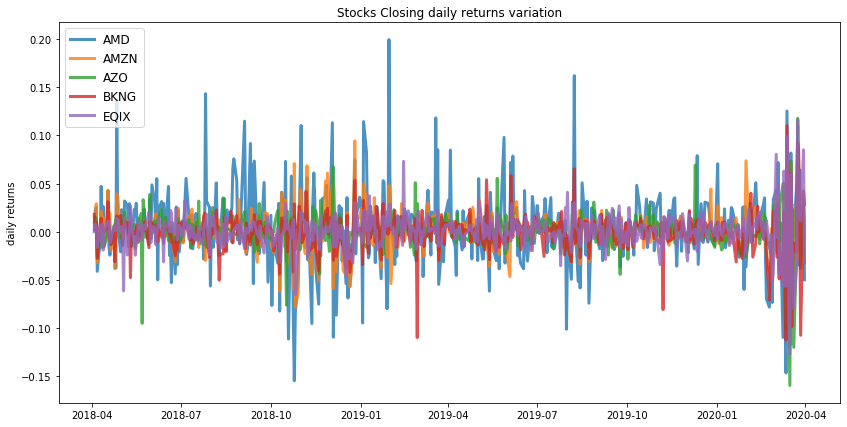

--------------------------------------------------------------------------------
Maximum Sharpe Ratio Portfolio Allocation

Annualised Return: 1.37
Annualised Volatility: 0.6


              AMD  AMZN   AZO  BKNG   EQIX
allocation  58.76   0.0  9.16   0.0  32.08
--------------------------------------------------------------------------------
Minimum Volatility Portfolio Allocation

Annualised Return: 0.38
Annualised Volatility: 0.33


            AMD   AMZN   AZO  BKNG   EQIX
allocation  0.0  27.58  29.7  12.8  29.92


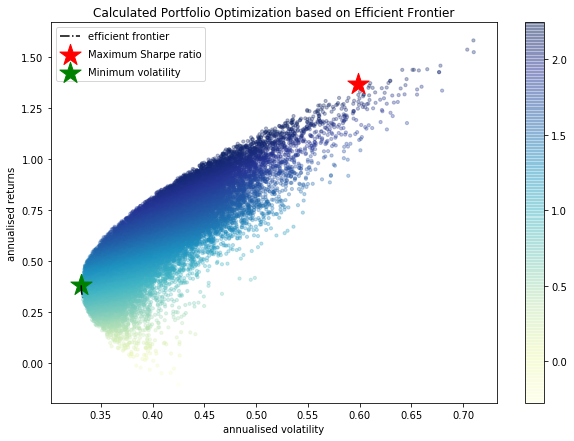

--------------------------------------------------------------------------------
Individual Stock Returns and Volatility

AMD : annuaised return 1.96 , annualised volatility: 0.88
AMZN : annuaised return 0.46 , annualised volatility: 0.45
AZO : annuaised return 0.43 , annualised volatility: 0.45
BKNG : annuaised return -0.3 , annualised volatility: 0.47
EQIX : annuaised return 0.56 , annualised volatility: 0.42
--------------------------------------------------------------------------------


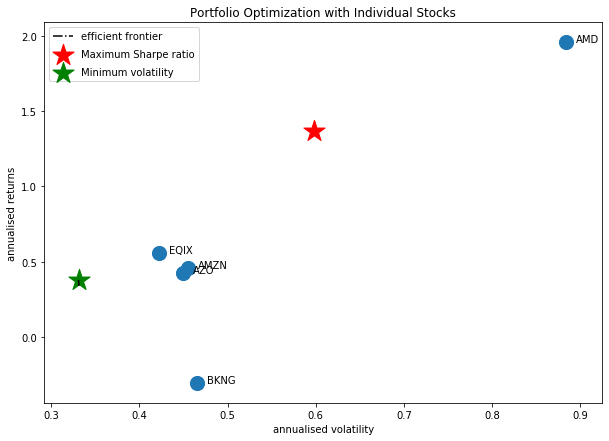

In [41]:
returns_sharpe_company_list = []
start_date = "2018-04-01"
end_date = "2020-04-01"
risk_free_rate = 0.0095
print("perform efficient_frontier_stock_portfolio Pairs of the companies we got {}".format(stock_portfolio_list))
pos_sharpe, Annualised_Return, Annualised_Volatility, allocation_weights = efficient_frontier_stock_portfolio(stock_portfolio_list, len(stock_portfolio_list), risk_free_rate, start_date, end_date)
returns_sharpe_company_list.append([pos_sharpe, Annualised_Return, Annualised_Volatility, stock_portfolio_list, allocation_weights])

In [42]:
shortlisted_portfolio_df = pd.DataFrame(returns_sharpe_company_list)

In [43]:
shortlisted_portfolio_df

,0,1,2,3,4
0,2.269009,1.37,0.6,"[AMD, AMZN, AZO, BKNG, EQIX]","[[58.76, 0.0, 9.16, 0.0, 32.08]]"


In [44]:
shortlisted_portfolio_df.columns = ["Sharpe Ratio", "Portfolio Annualised Return", "Portfolio Annualised_Volatility", "Stock Portfolio", "Stocks Weight Allocation"]

In [45]:
# creating a blank series 
Portfolio_Tag = pd.Series([]) 

for row in range(len(shortlisted_portfolio_df)):
    if (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 3):
        Portfolio_Tag[row] = "Excellent"
    elif (shortlisted_portfolio_df["Sharpe Ratio"][row] >= 2 and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 3)):
        Portfolio_Tag[row] = "Very Good"
    elif ((shortlisted_portfolio_df["Sharpe Ratio"][row] >= 1)  and (shortlisted_portfolio_df["Sharpe Ratio"][row] < 2)):
        Portfolio_Tag[row] = "Good"
    else:
        Portfolio_Tag[row] = "Bad"
        
# inserting new column with values of list made above         
shortlisted_portfolio_df.insert(5, "Portfolio Tag", Portfolio_Tag) 

In [46]:
shortlisted_portfolio_df

,Sharpe Ratio,Portfolio Annualised Return,Portfolio Annualised_Volatility,Stock Portfolio,Stocks Weight Allocation,Portfolio Tag
0,2.269009,1.37,0.6,"[AMD, AMZN, AZO, BKNG, EQIX]","[[58.76, 0.0, 9.16, 0.0, 32.08]]",Very Good
